In [1]:
import numpy  as np
import pandas as pd
import scipy.optimize  as sco
from utils.labelling_utils import add_hits_labels_MC
from labelling.MClabelling import labelling_MC
from utils.plotting_utils  import plot_3d_vox
from utils.histogram_utils import mcimg, container_creator, bin_creator
from invisible_cities.io   import dst_io as dio


import matplotlib.pyplot as plt
import matplotlib as mpl

# Veamos las distancias de hits vs energías

Vamos a sacar de la función add_hits_labels_MC las tracks con distancias para hacer algo con ellas... a ver el que

In [2]:
cutnum, num = '24', '6206'
directory   = '/Users/mperez/NEXT/bersh_prod/prod_example/Tl208_NEW_v1_03_01_nexus_v5_03_04_cut{cut}.beersheba_{num}.root.h5'.format(cut = cutnum, num = num)

total_size  = (440, 440, 552) 
voxel_size  = (5, 5, 4) #equivalent to step
start_bin   = (-220, -220, 0) #equivalent to x0

In [3]:
detector_frame = container_creator(total_size, voxel_size)
detector_bins  = bin_creator(detector_frame, steps = voxel_size, x0 = start_bin)

In [4]:
mcpart = dio.load_dst(directory, 'MC', 'particles') 
mchits = dio.load_dst(directory, 'MC', 'hits') 
    
labelled_hits = add_hits_labels_MC(mchits, mcpart, blob_ener_loss_th = 0.25) #aqui es indiferente el threshold 
#porque no estoy mirando segclass, lo que pasa es que era la forma más cómoda porque ya tengo columnas 
#dist_hits y cumdist que sí estoy usando, entonces no vuelvo a 

# Esta casilla es para añadir otro fichero a los hits...

In [5]:
cutnum2, num2 = '0', '6206'
directory2  = '/Users/mperez/NEXT/bersh_prod/prod_example/Tl208_NEW_v1_03_01_nexus_v5_03_04_cut{cut}.beersheba_{num}.root.h5'.format(cut = cutnum2, num = num2)
mcpart2 = dio.load_dst(directory2, 'MC', 'particles') 
mchits2 = dio.load_dst(directory2, 'MC', 'hits') 
labelled_hits = labelled_hits.append(add_hits_labels_MC(mchits2, mcpart2, blob_ener_loss_th = 0.25))

In [6]:
track_hits = labelled_hits.loc[(labelled_hits.particle_name.isin(['e-', 'e+'])) &(labelled_hits.segclass.isin([2, 3]))]

## Análisis con fichero grande

In [2]:
file = 'JA_files/merged_beersheba_label_4mm_50scut.h5'

In [3]:
mchits_total = dio.load_dst(file, 'DATASET', 'MCHits') 

In [4]:
track_hits = mchits_total.loc[(mchits_total.particle_name.isin(['e-', 'e+'])) &(mchits_total.segclass.isin([2, 3]))]


In [12]:
track_length = []
track_ener   = []
for event_id, df in track_hits.groupby(['dataset_id', 'particle_name']):
    track_length.append(sum(df.dist_hits))
    track_ener.append(sum(df.energy))

In [13]:
def lineal(x, m, x0):
    y = m * x + x0
    return y

def raiz(x, a):
    y = a * np.sqrt(x)
    return y

def mix_raiz_lineal(x, b, c, d):
    y = b * np.sqrt(x) + c * x + d
    return y

In [14]:
m, x0 = sco.curve_fit(lineal, track_length, track_ener)[0]

In [15]:
a     = sco.curve_fit(raiz, track_length, track_ener)[0]

In [16]:
b, c, d = sco.curve_fit(mix_raiz_lineal, track_length, track_ener)[0]

In [17]:
x1 = np.arange(min(track_length), max(track_length), 5)
y1 = lineal(x1, m, x0)
y2 = raiz(x1, a)
y3 = mix_raiz_lineal(x1, b, c, d)

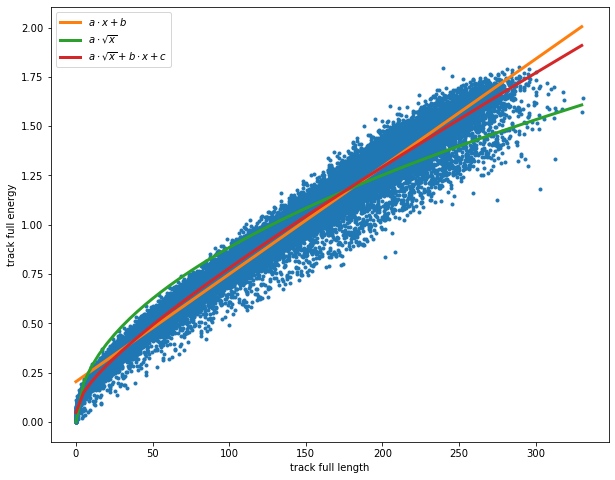

In [18]:
plt.figure(figsize=(10, 8))
plt.plot(track_length, track_ener, '.')
plt.plot(x1, y1, '-', linewidth = 3, label = r'$a \cdot x + b$')
plt.plot(x1, y2, '-', linewidth = 3, label = r'$a \cdot \sqrt{x} $')
plt.plot(x1, y3, '-', linewidth = 3, label = r'$a \cdot \sqrt{x} + b \cdot x + c$')
plt.xlabel('track full length')
plt.ylabel('track full energy')
plt.legend()
plt.show()

Vale, vemos que la distancia total de la traza es prácticamente lineal???? salvo por los valores al principio... puede que sea una cosa como a * raiz(x) + b * x + c... pero well... que tampoco me saca mucho las castañas del fuego 

## Histogramas con distancias de track divididas y energía depositada en cada tramo

Ploteando la distancia de traza vs la energía depositada no se ve muy claramente el aumento en la energía al final

(48000025, 'e-')


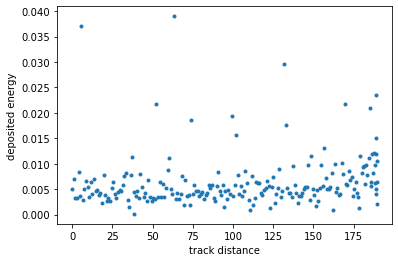

(48000026, 'e-')


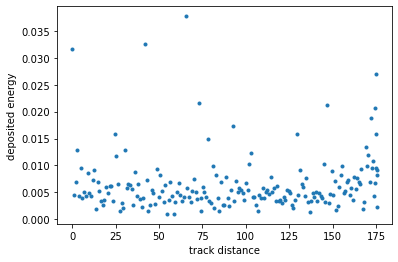

(48000027, 'e-')


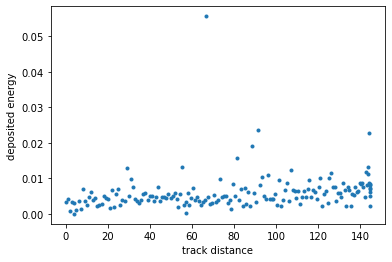

(48000028, 'e-')


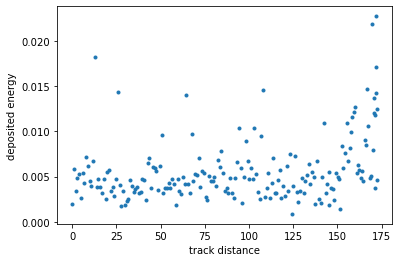

(48000030, 'e-')


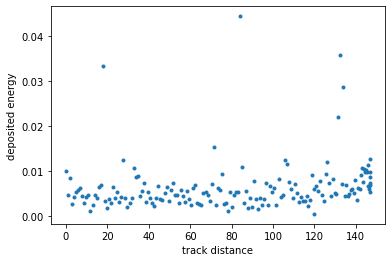

(48000031, 'e-')


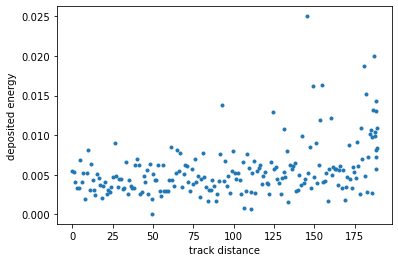

(48000032, 'e-')


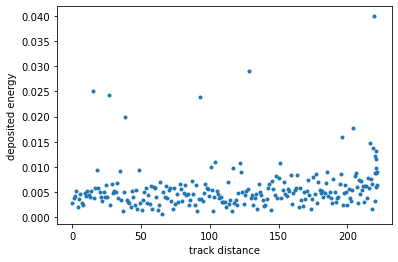

(48000033, 'e-')


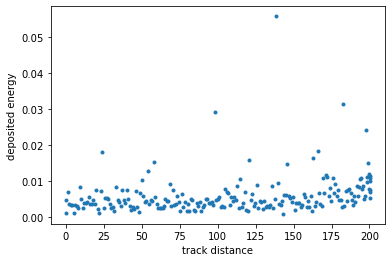

(48000034, 'e-')


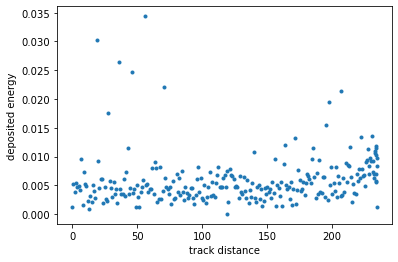

(48000035, 'e-')


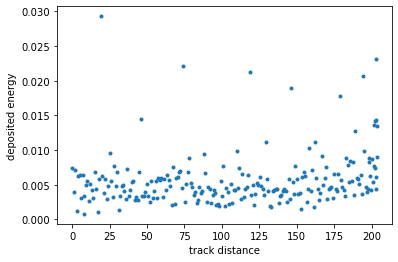

(48000036, 'e-')


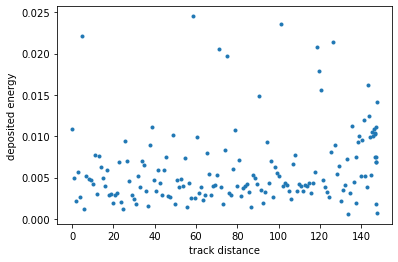

(48000037, 'e-')


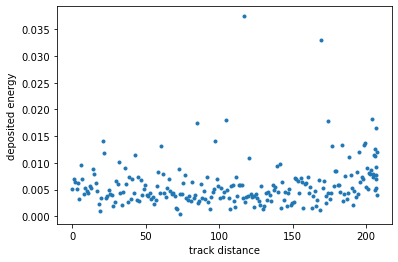

(48000038, 'e-')


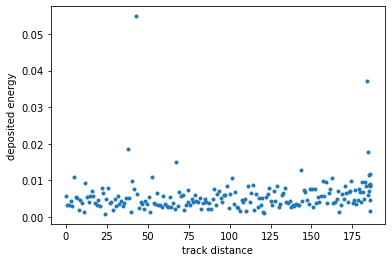

(48000039, 'e-')


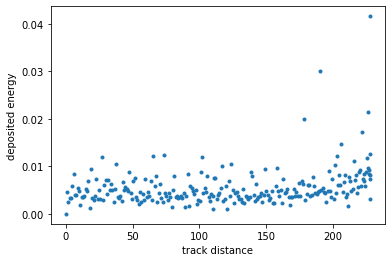

(48000040, 'e+')


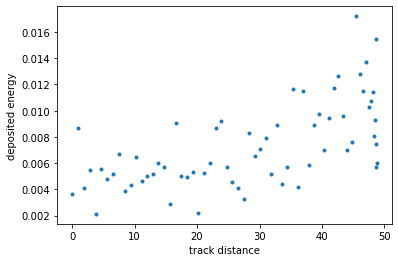

(48000040, 'e-')


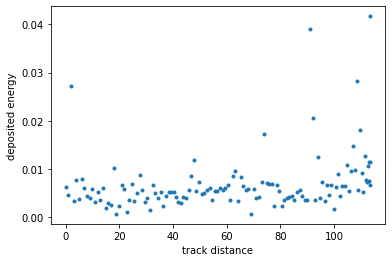

(48000041, 'e-')


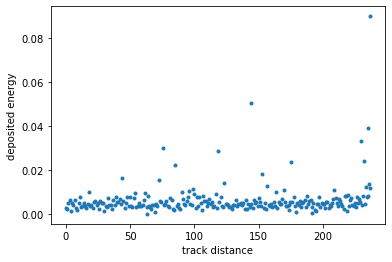

(48000042, 'e-')


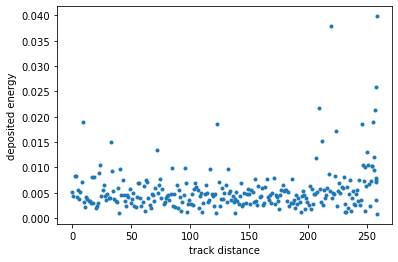

(48000043, 'e+')


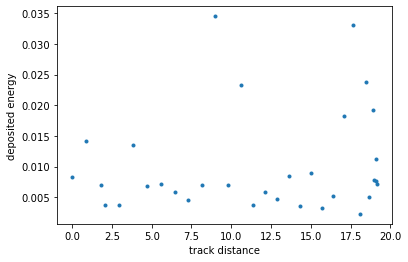

(48000043, 'e-')


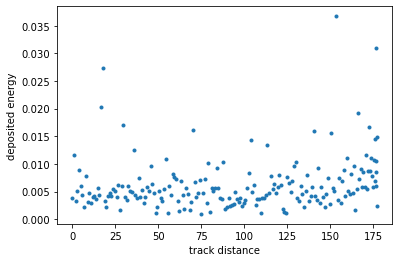

(48000044, 'e-')


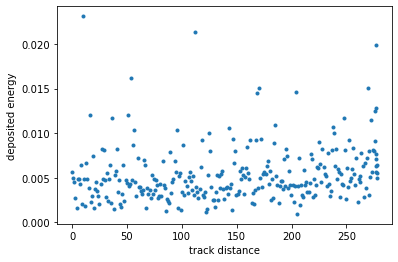

(48000045, 'e-')


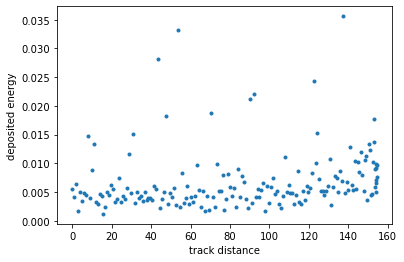

(48000046, 'e-')


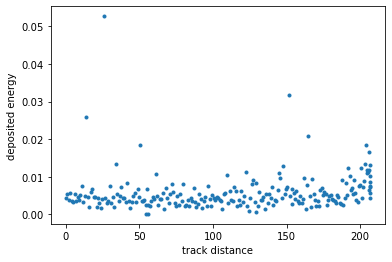

(48000047, 'e-')


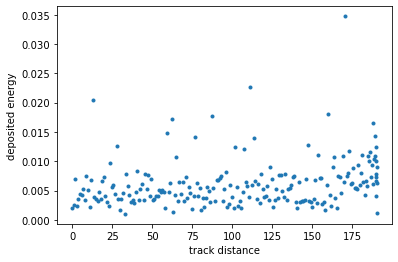

(48000048, 'e-')


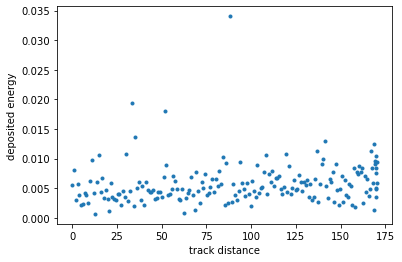

(48000049, 'e-')


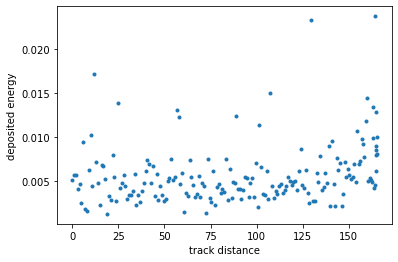

(48000050, 'e-')


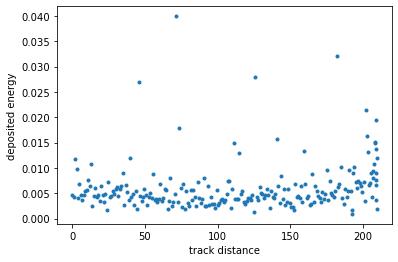

(48000051, 'e-')


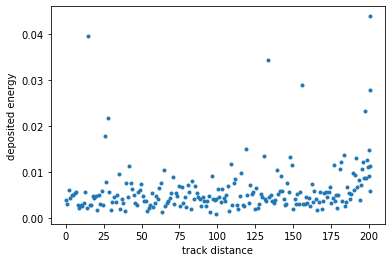

(48000052, 'e-')


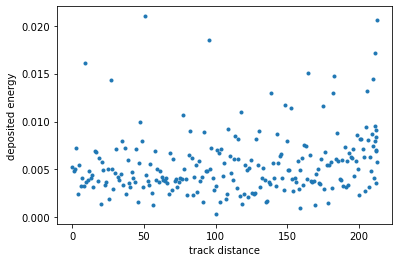

(48000053, 'e+')


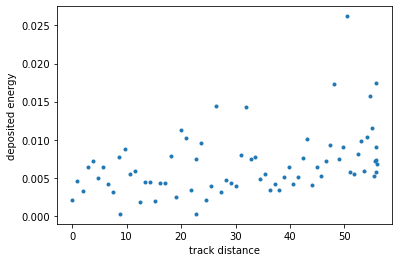

(48000053, 'e-')


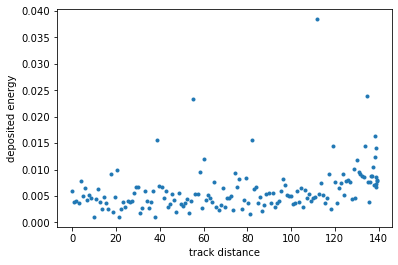

(48000054, 'e-')


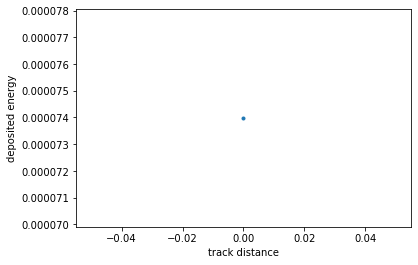

(48000055, 'e-')


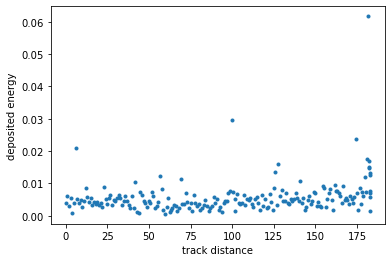

(48000056, 'e-')


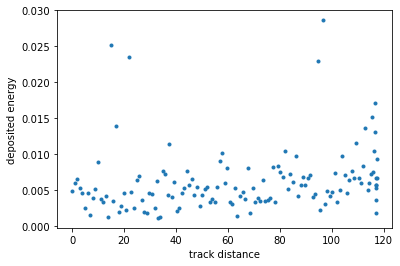

(48000057, 'e-')


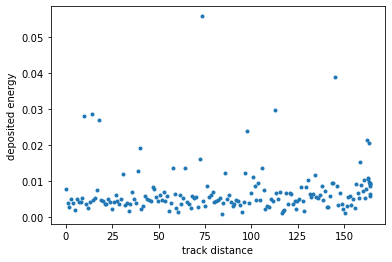

(48000058, 'e+')


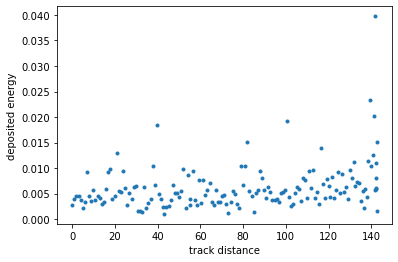

(48000058, 'e-')


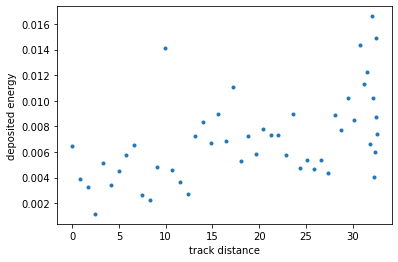

(48000059, 'e-')


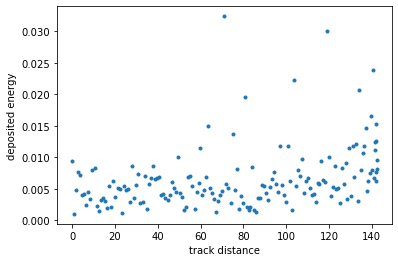

(48000060, 'e+')


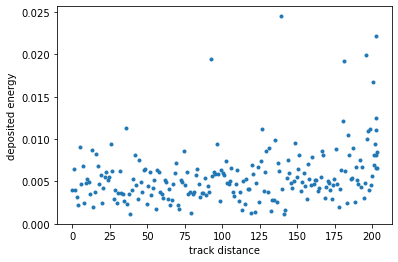

(48000060, 'e-')


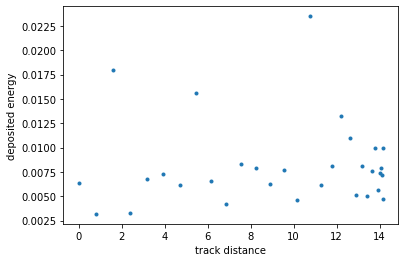

(48000061, 'e-')


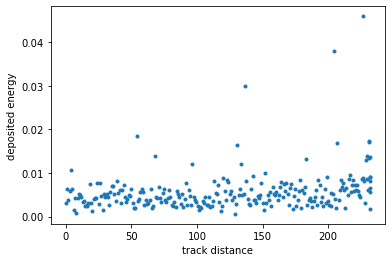

(48000062, 'e-')


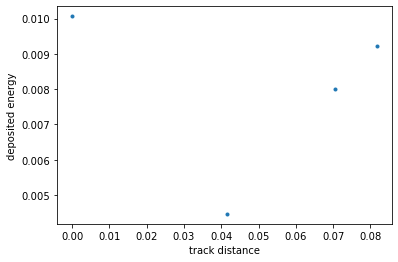

(48000063, 'e-')


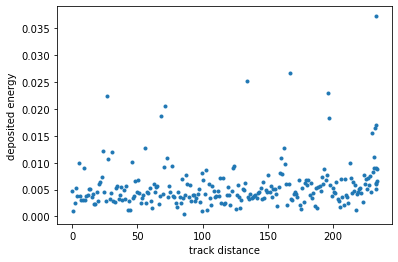

(48000064, 'e+')


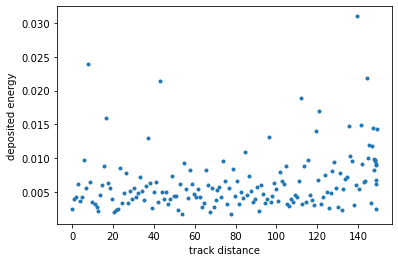

(48000064, 'e-')


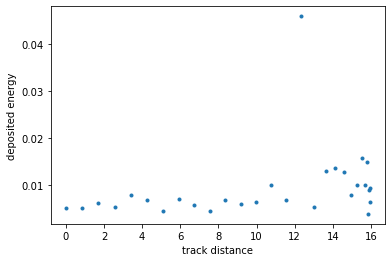

(48000066, 'e+')


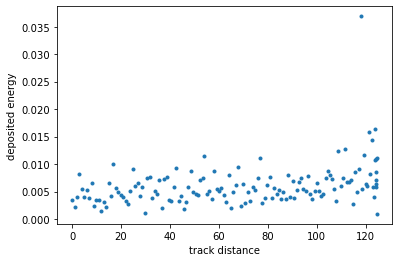

(48000066, 'e-')


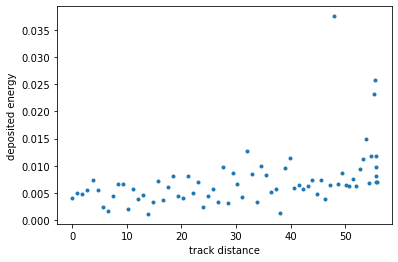

(48000067, 'e-')


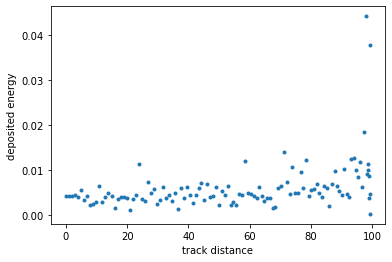

(48000068, 'e+')


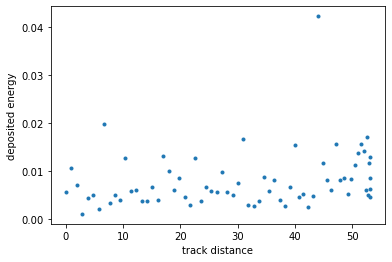

(48000068, 'e-')


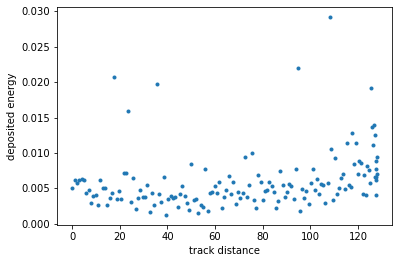

(48000069, 'e+')


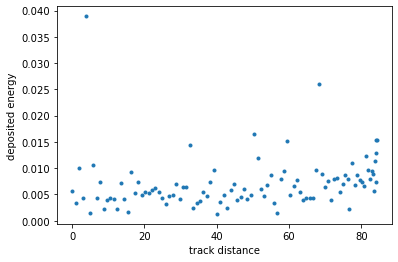

(48000069, 'e-')


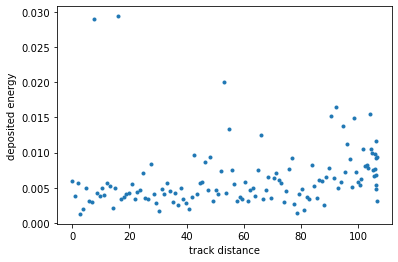

(48000070, 'e+')


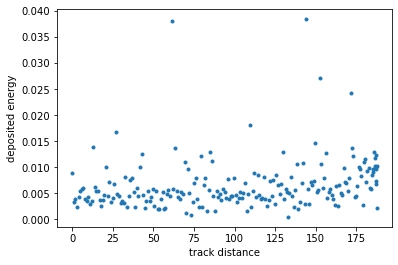

(48000070, 'e-')


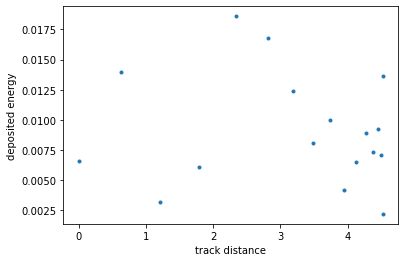

(48000071, 'e+')


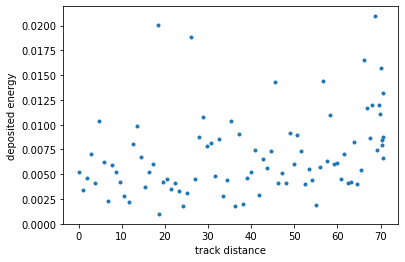

(48000071, 'e-')


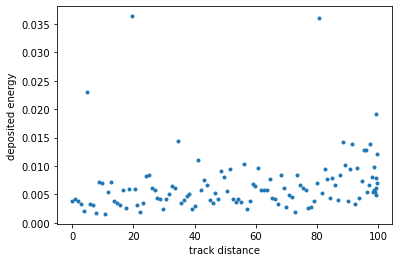

(48000073, 'e-')


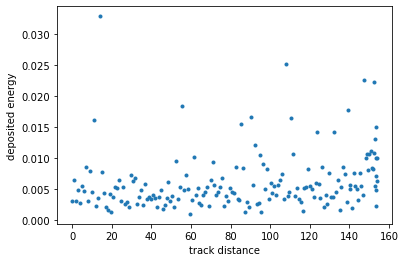

(48000074, 'e-')


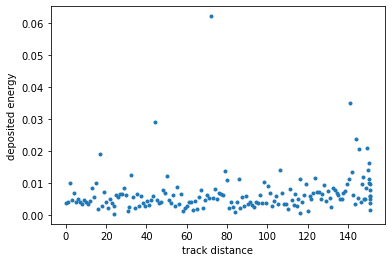

(48000075, 'e-')


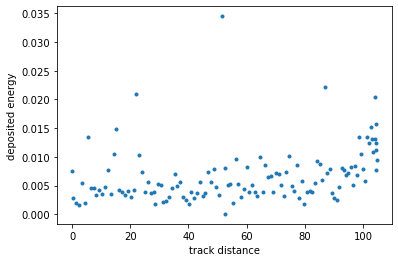

(48000076, 'e+')


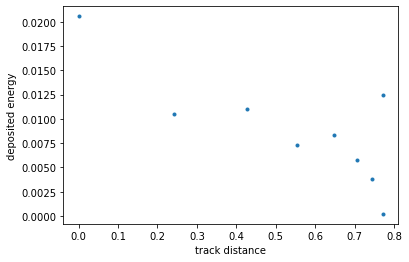

(48000076, 'e-')


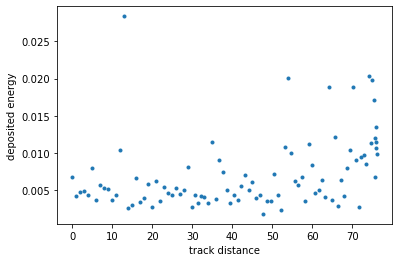

(48000077, 'e-')


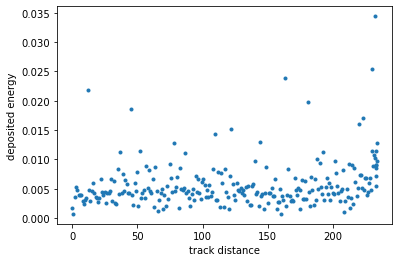

(48000078, 'e-')


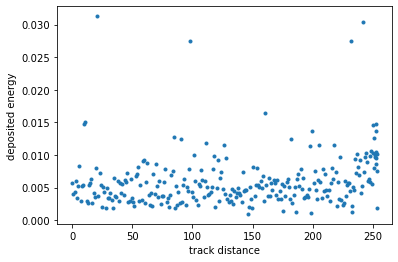

(48000079, 'e+')


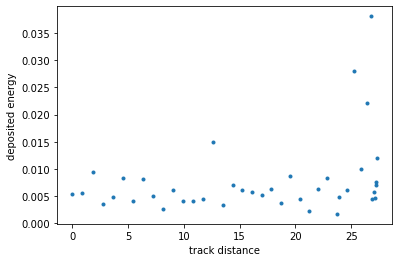

(48000079, 'e-')


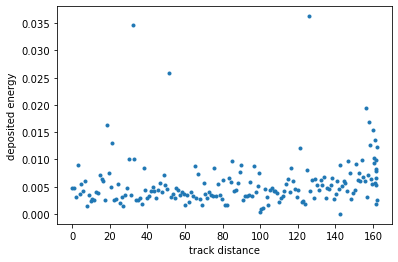

(48000080, 'e-')


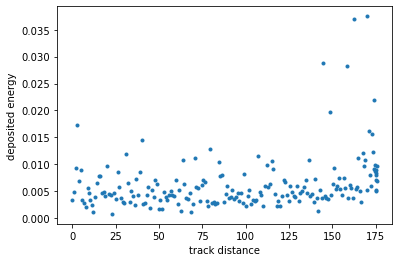

(48000081, 'e+')


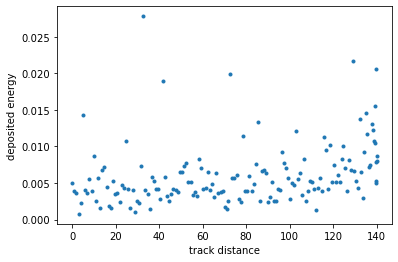

(48000081, 'e-')


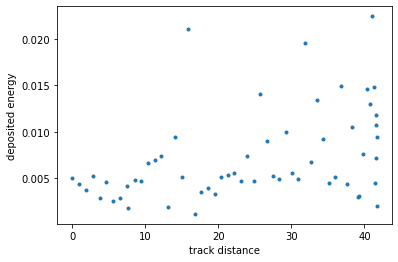

(48000082, 'e-')


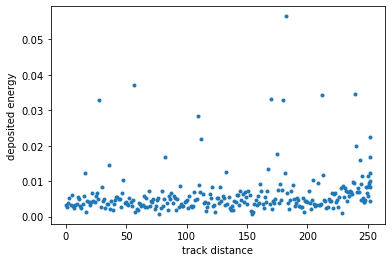

(48000083, 'e+')


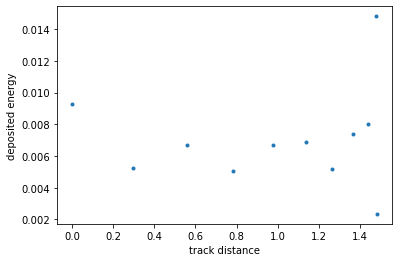

(48000083, 'e-')


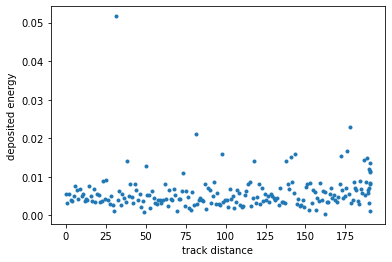

(48000084, 'e-')


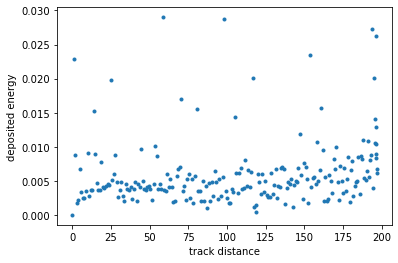

(48000085, 'e-')


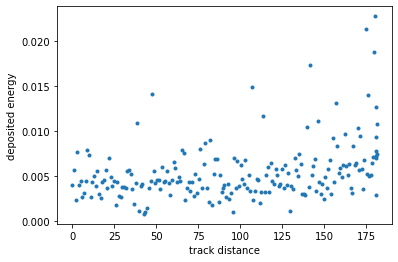

(48000086, 'e-')


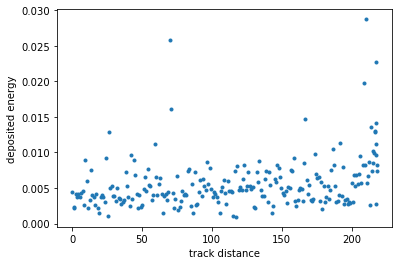

(48000087, 'e+')


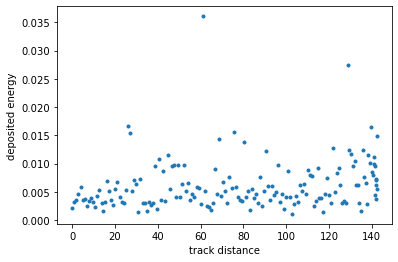

(48000087, 'e-')


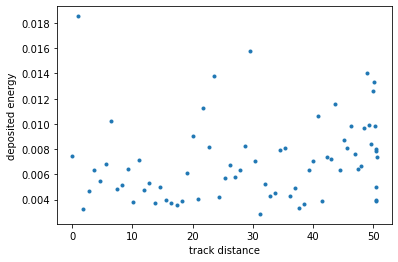

(48000088, 'e-')


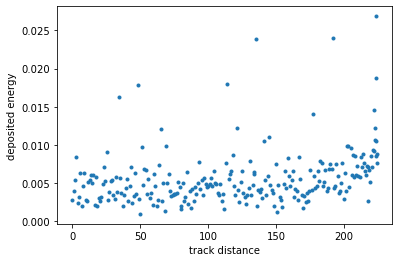

(48000089, 'e-')


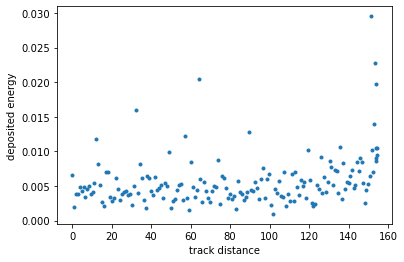

(48000090, 'e-')


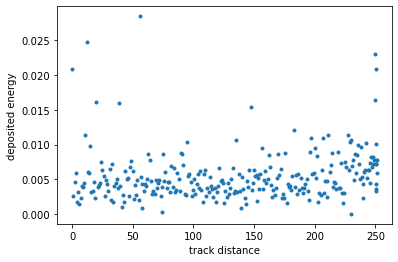

(48000091, 'e-')


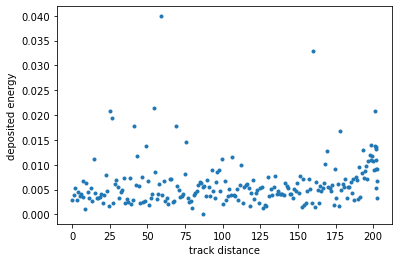

(48000092, 'e-')


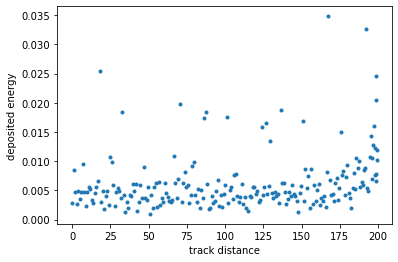

(48000093, 'e+')


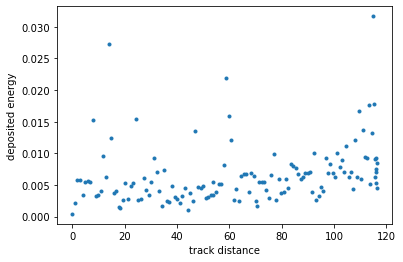

(48000093, 'e-')


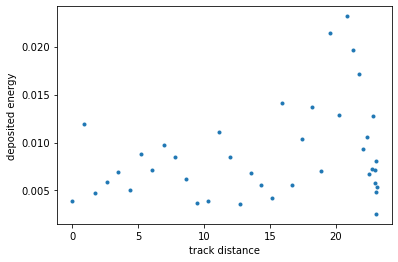

(48000094, 'e-')


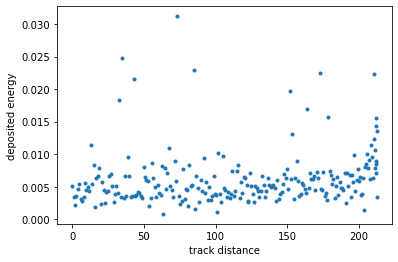

(48000096, 'e+')


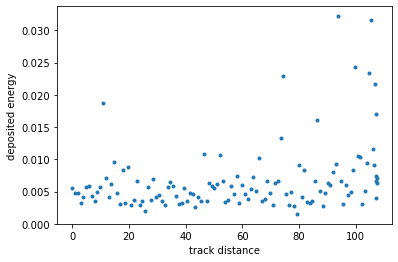

(48000096, 'e-')


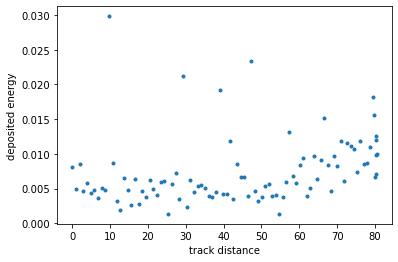

(48000097, 'e-')


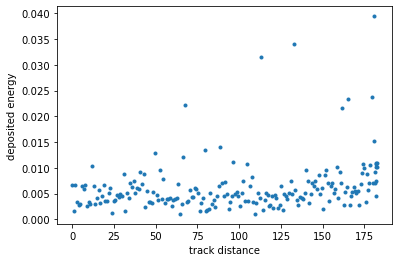

(48000098, 'e+')


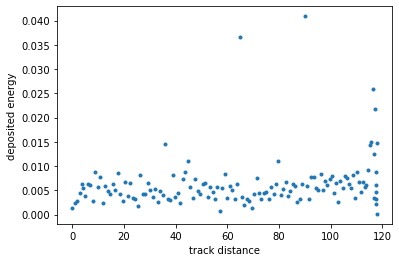

(48000098, 'e-')


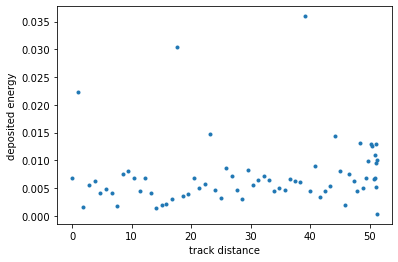

(48000099, 'e-')


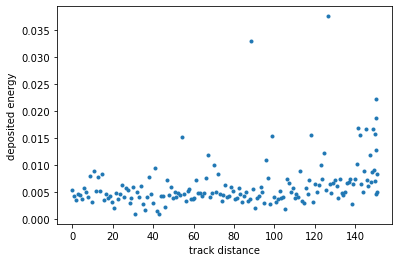

(48000101, 'e-')


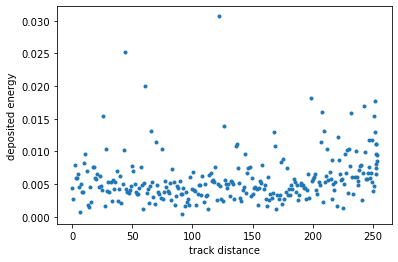

(48000102, 'e+')


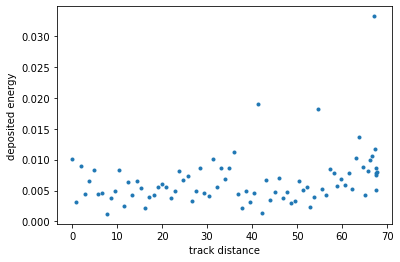

(48000102, 'e-')


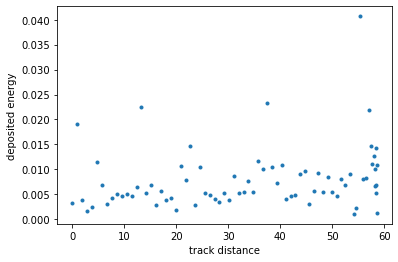

(48000103, 'e-')


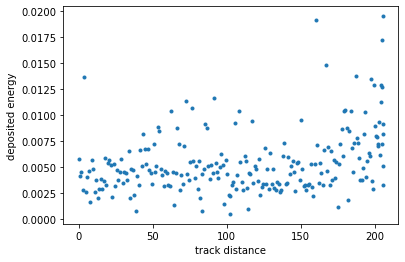

(48000104, 'e-')


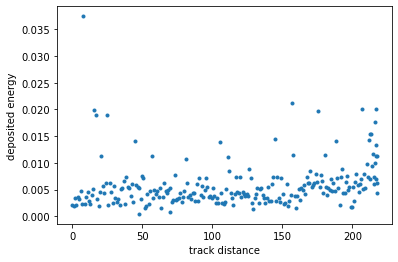

(48000106, 'e-')


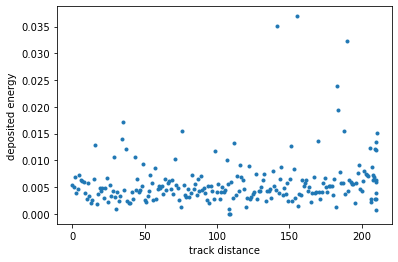

(48000107, 'e-')


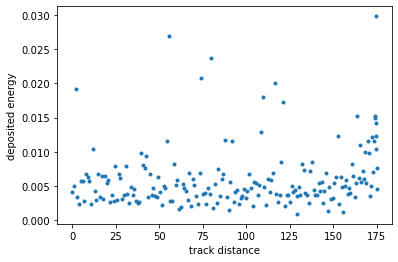

(48000108, 'e-')


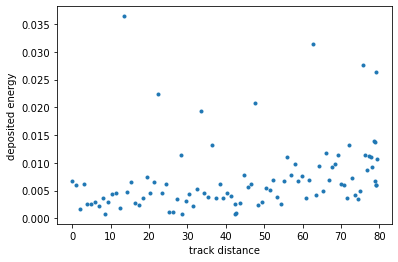

(48000109, 'e-')


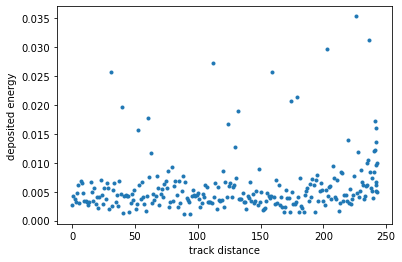

(48000110, 'e-')


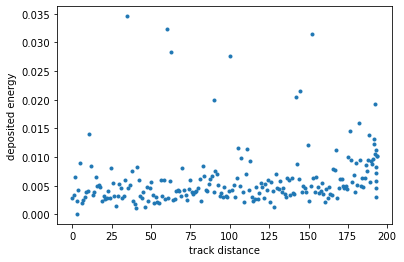

(48000111, 'e-')


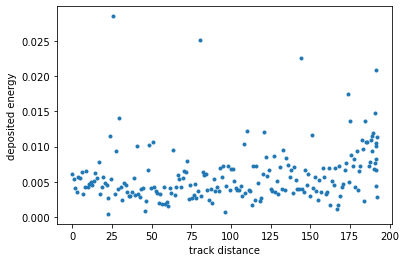

(48000112, 'e+')


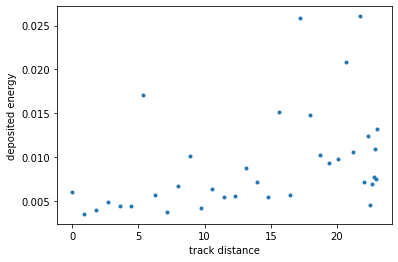

(48000112, 'e-')


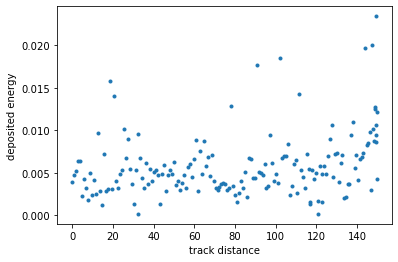

(48000113, 'e-')


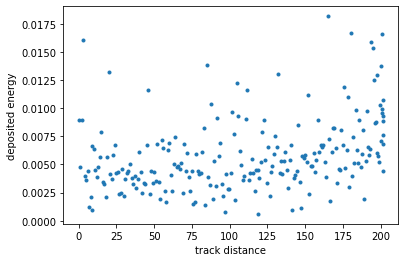

(48000114, 'e-')


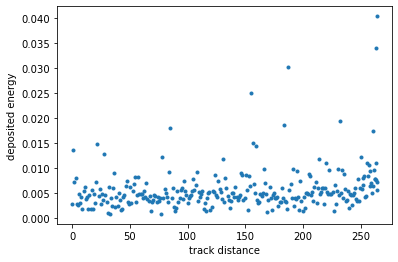

(48000115, 'e-')


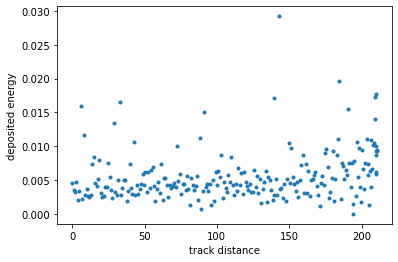

(48000116, 'e-')


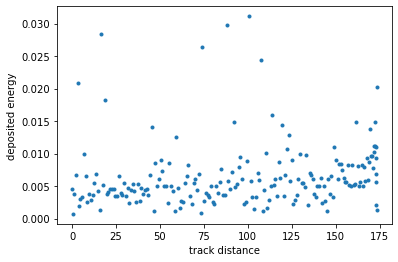

(48000117, 'e-')


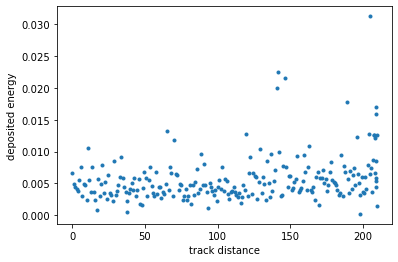

(48000118, 'e-')


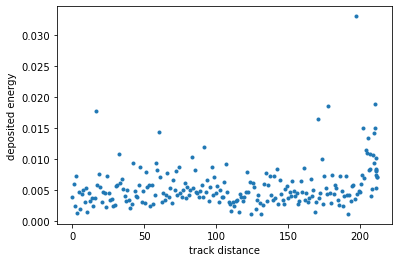

(48000119, 'e-')


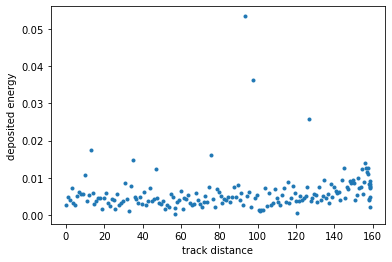

(48000120, 'e+')


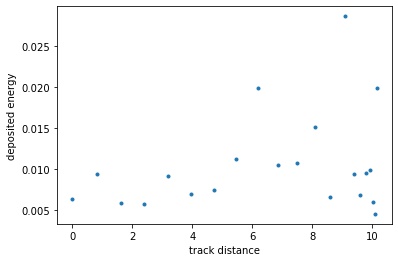

(48000120, 'e-')


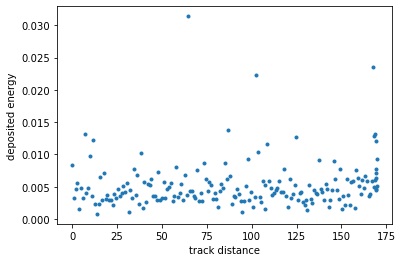

(48000121, 'e-')


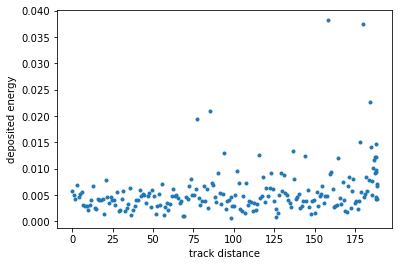

(48000122, 'e+')


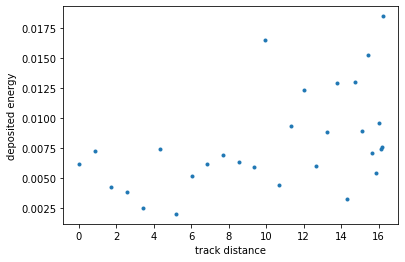

(48000122, 'e-')


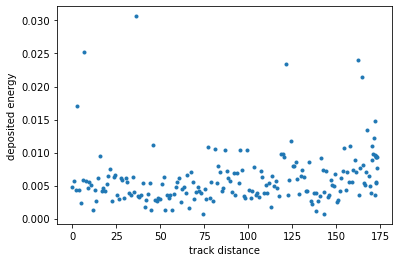

(48000123, 'e-')


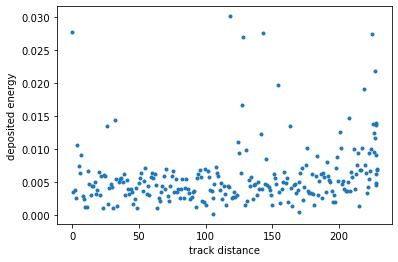

(48000124, 'e+')


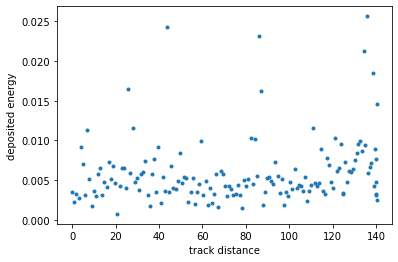

(48000124, 'e-')


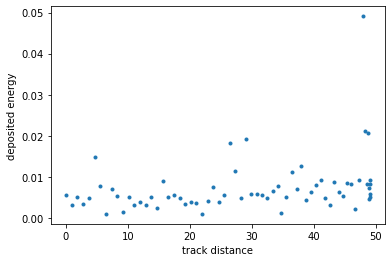

(48000125, 'e-')


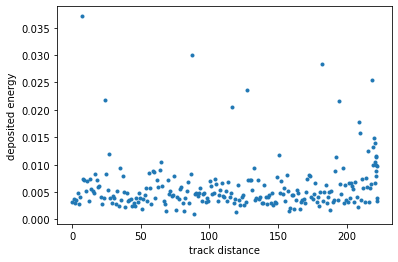

(48000126, 'e-')


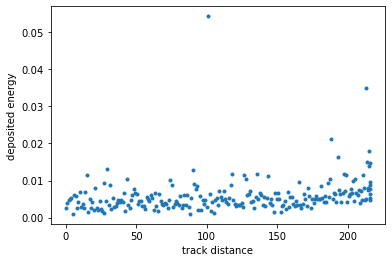

(48000127, 'e-')


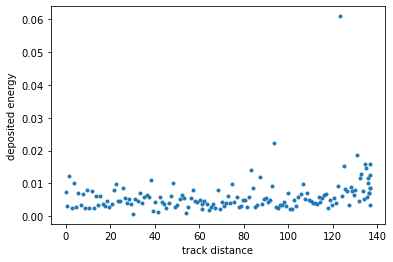

(48000128, 'e-')


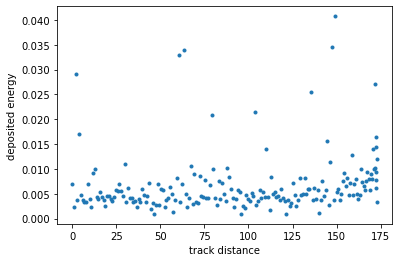

(48000129, 'e+')


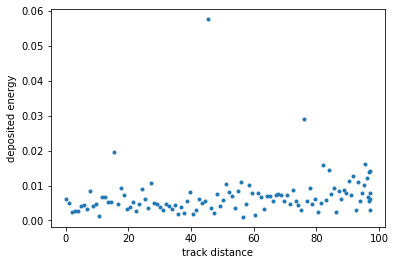

(48000129, 'e-')


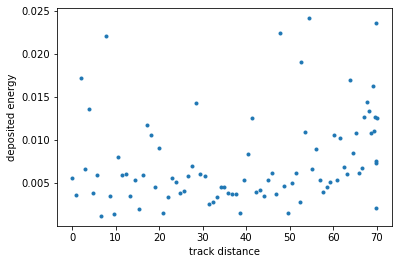

(48000130, 'e-')


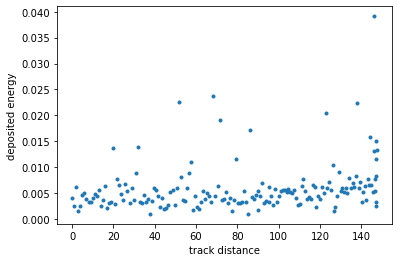

(48000131, 'e+')


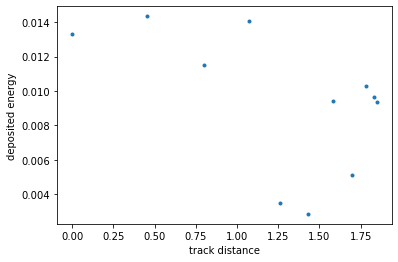

(48000131, 'e-')


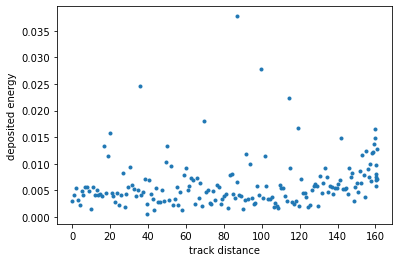

(48000132, 'e-')


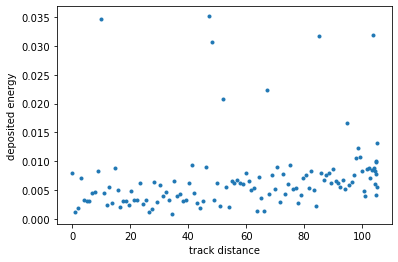

(48000133, 'e-')


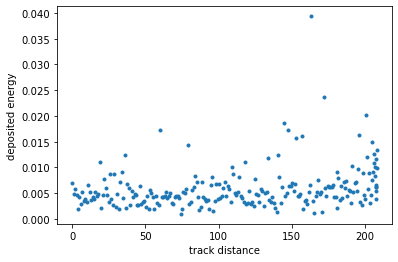

(48000134, 'e-')


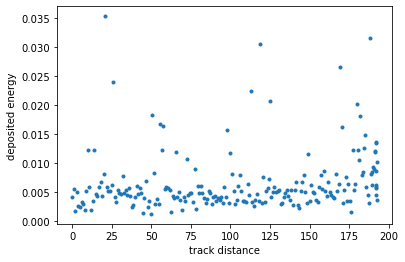

(48000135, 'e-')


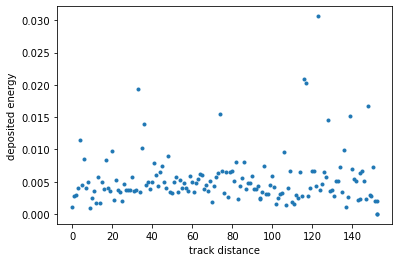

(48000136, 'e-')


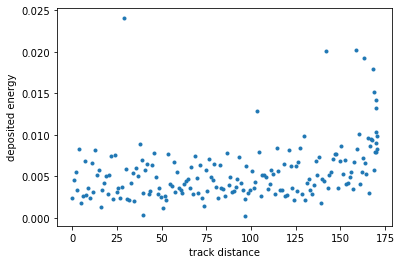

(48000137, 'e-')


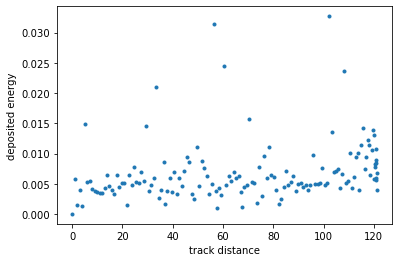

(48000138, 'e-')


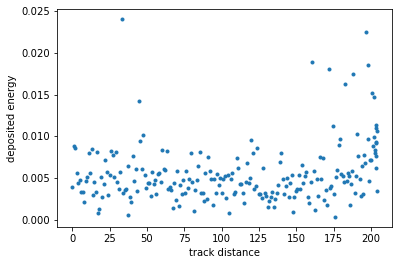

(48000139, 'e-')


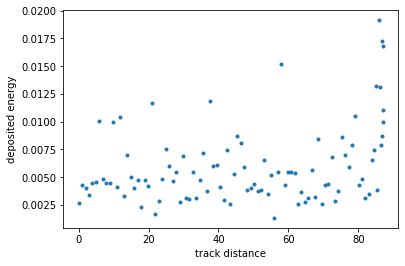

(48000140, 'e-')


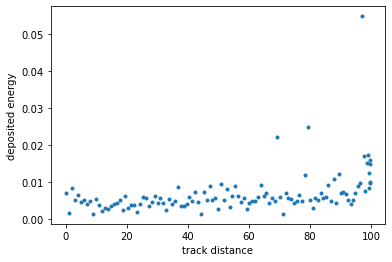

(48000141, 'e-')


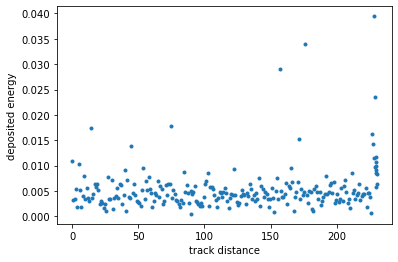

(48000142, 'e-')


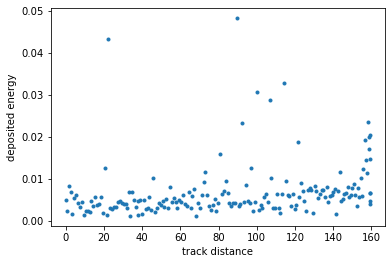

(48000143, 'e-')


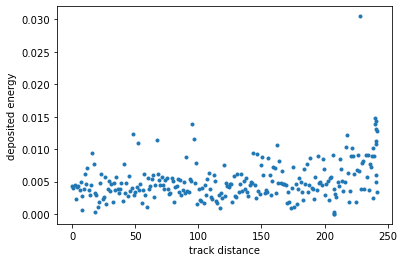

(48000144, 'e+')


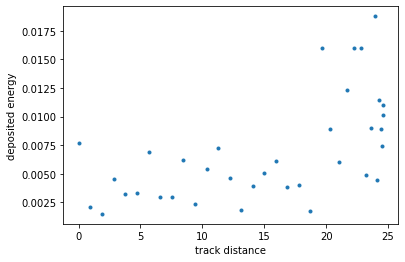

(48000144, 'e-')


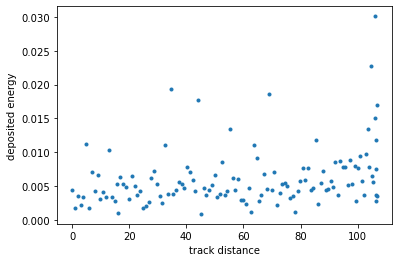

(48000145, 'e+')


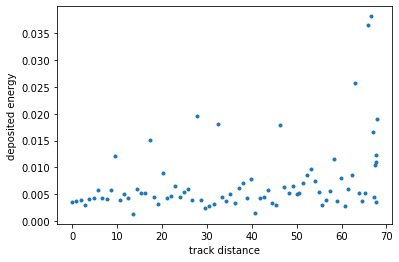

(48000145, 'e-')


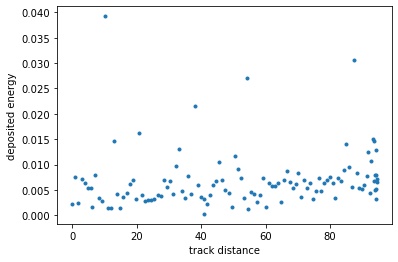

(48000146, 'e-')


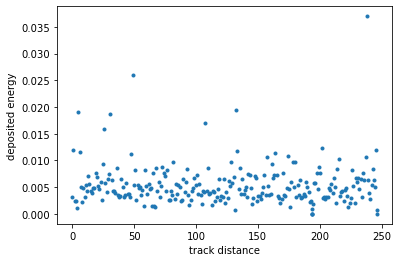

(48000147, 'e-')


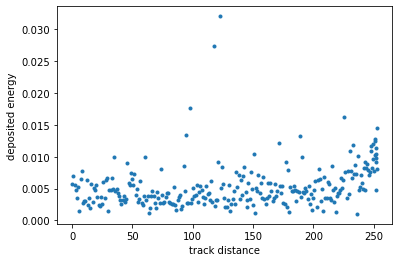

(48000148, 'e-')


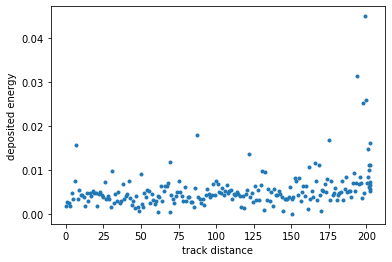

(48000149, 'e-')


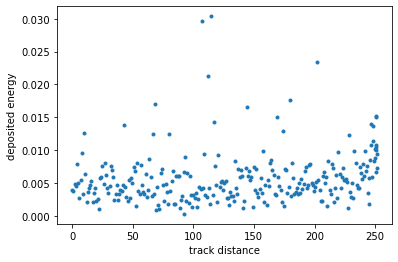

(48000150, 'e-')


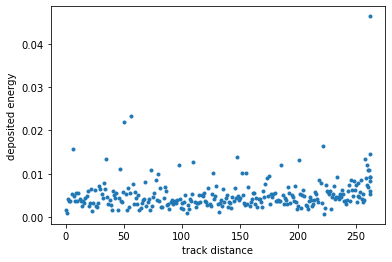

(48000151, 'e+')


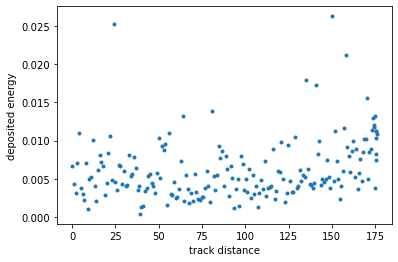

(48000151, 'e-')


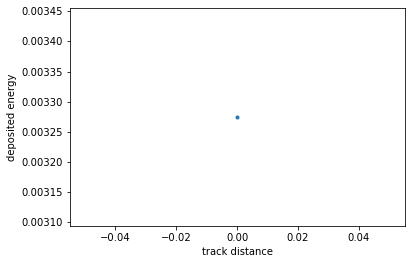

(48000152, 'e+')


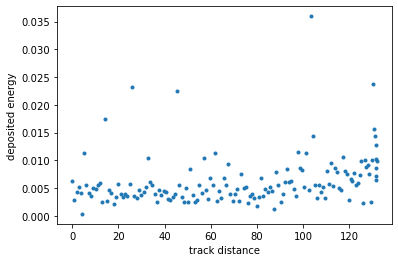

(48000152, 'e-')


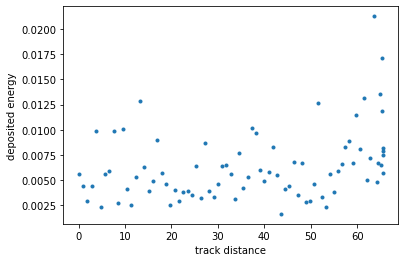

(48000153, 'e+')


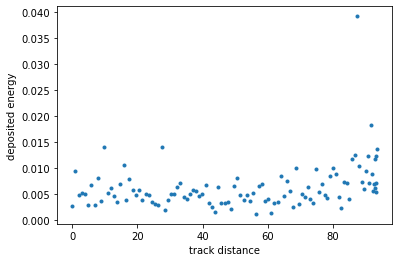

(48000153, 'e-')


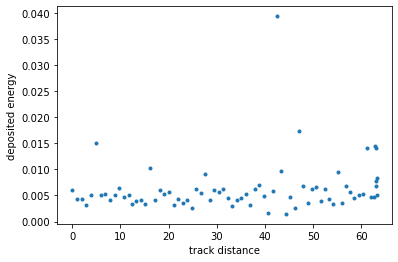

(48000154, 'e+')


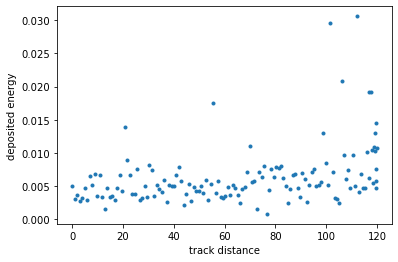

(48000154, 'e-')


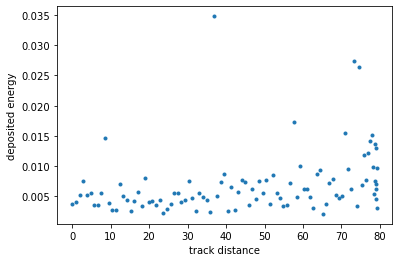

(48000155, 'e-')


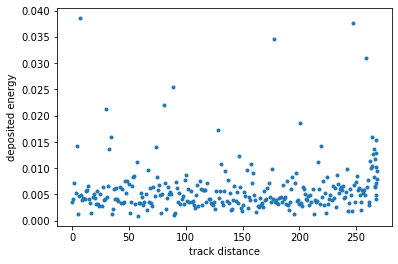

(48000156, 'e-')


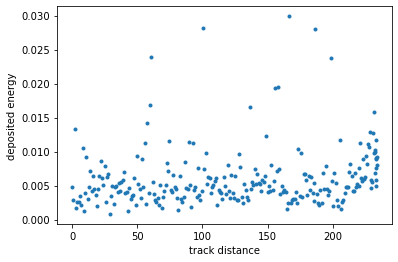

(48000157, 'e-')


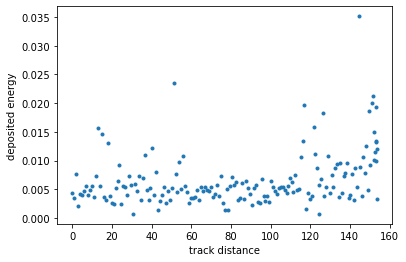

(48000158, 'e+')


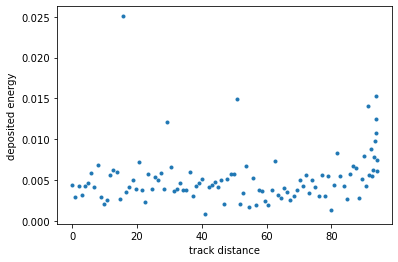

(48000158, 'e-')


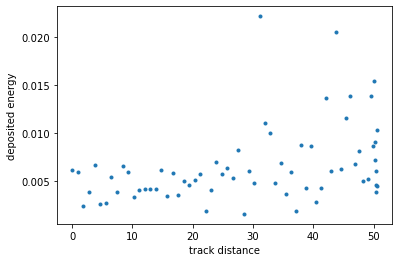

(48000159, 'e-')


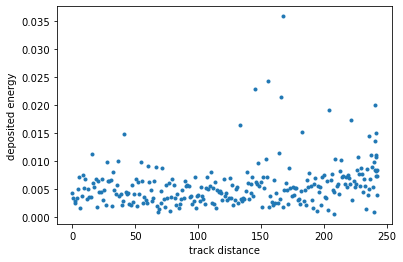

(48000160, 'e-')


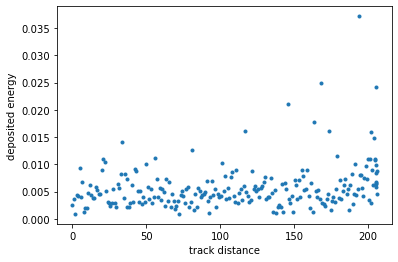

(48000161, 'e-')


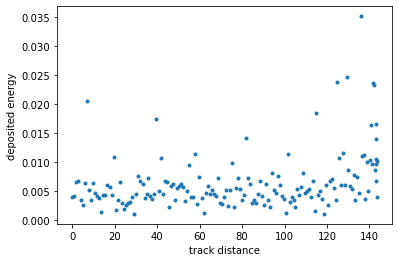

(48000162, 'e-')


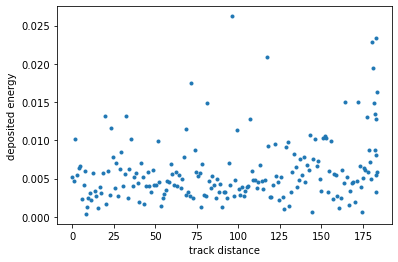

(48000163, 'e+')


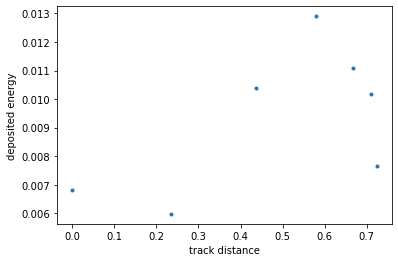

(48000163, 'e-')


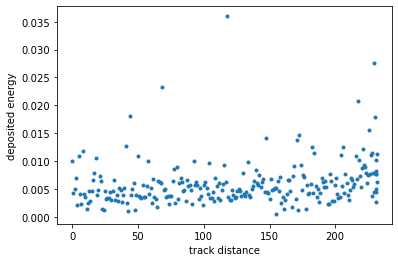

(48000164, 'e-')


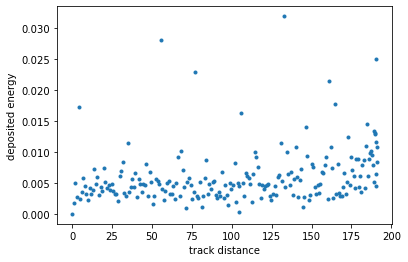

(48000165, 'e-')


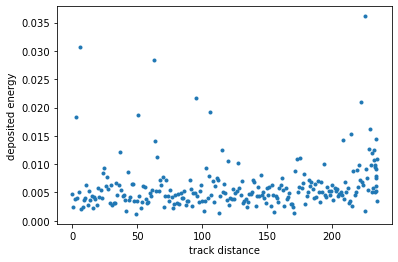

(48000166, 'e-')


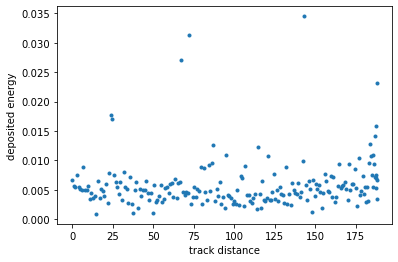

(48000167, 'e-')


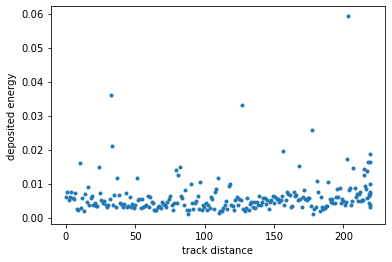

(48000168, 'e+')


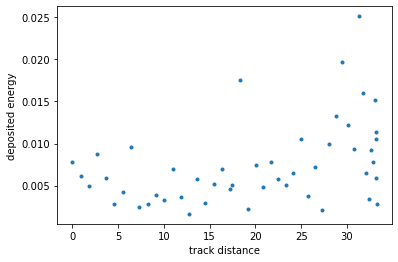

(48000168, 'e-')


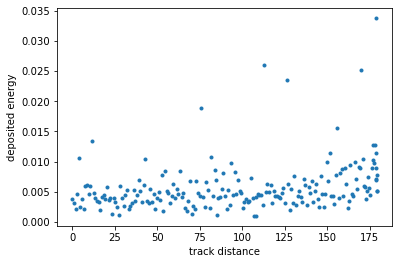

(48000169, 'e+')


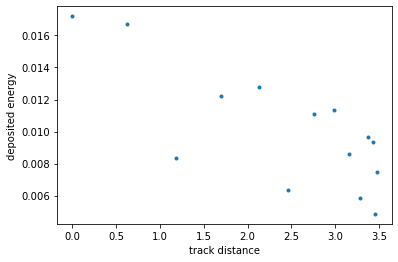

(48000169, 'e-')


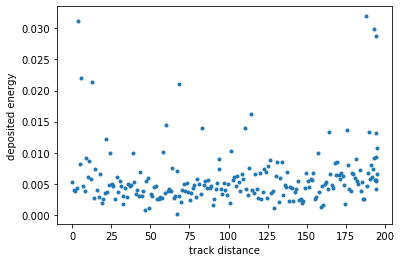

(48000170, 'e+')


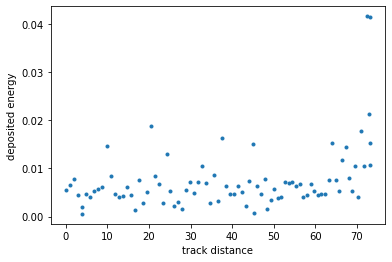

(48000170, 'e-')


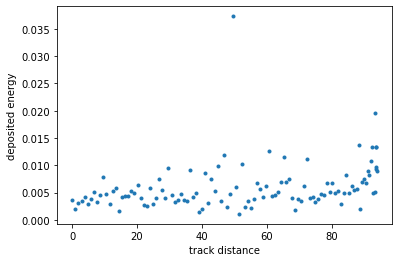

(48000171, 'e+')


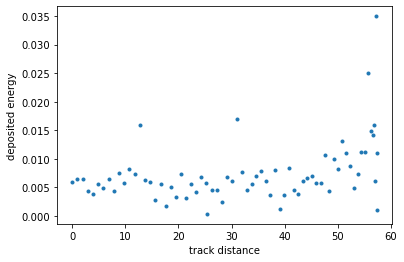

(48000171, 'e-')


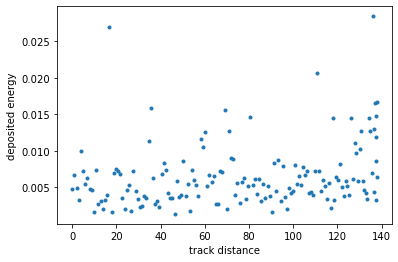

(48000172, 'e-')


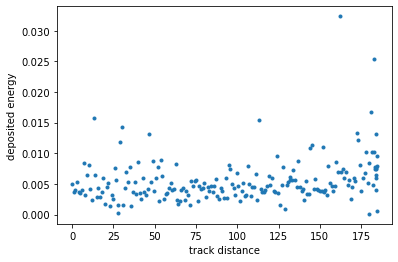

(48000173, 'e-')


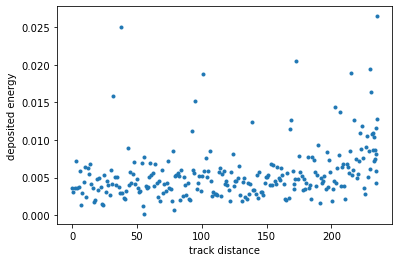

(48000174, 'e+')


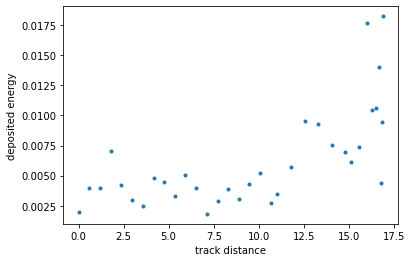

(48000174, 'e-')


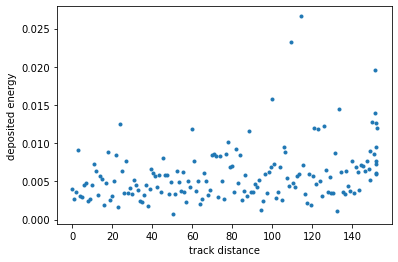

(48000175, 'e-')


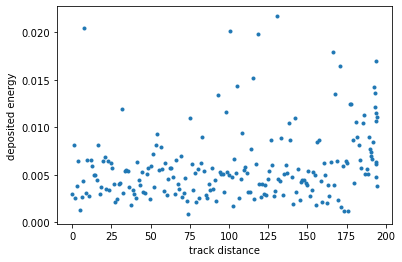

(48000176, 'e-')


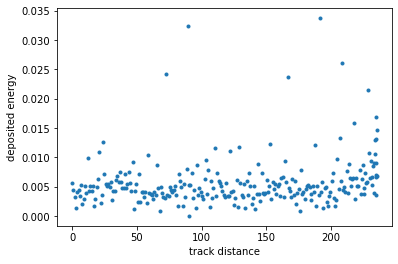

(48000177, 'e-')


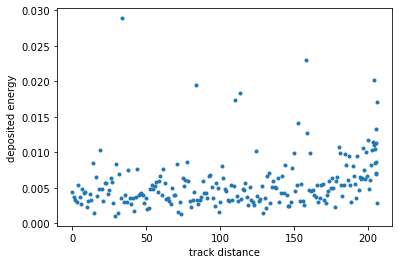

(48000178, 'e+')


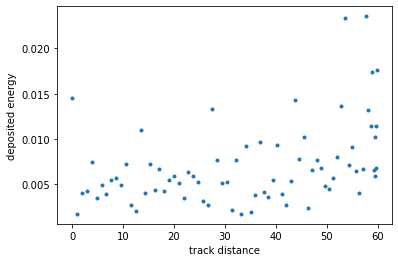

(48000178, 'e-')


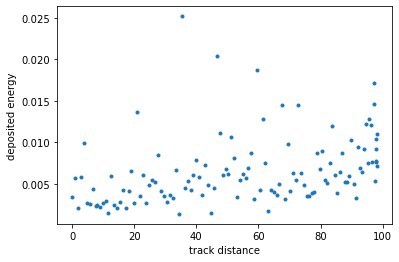

(48000179, 'e-')


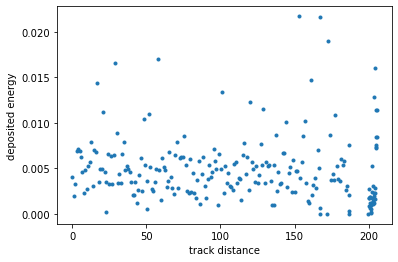

(48000180, 'e-')


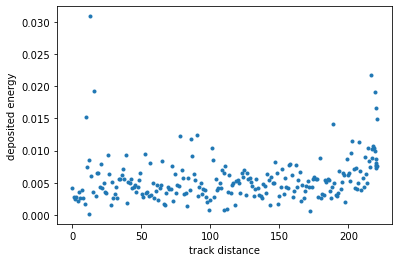

(48000181, 'e+')


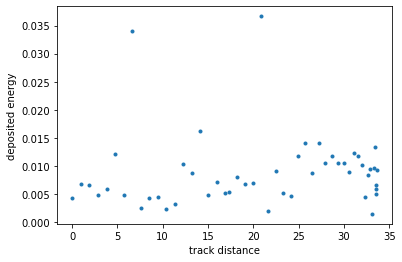

(48000181, 'e-')


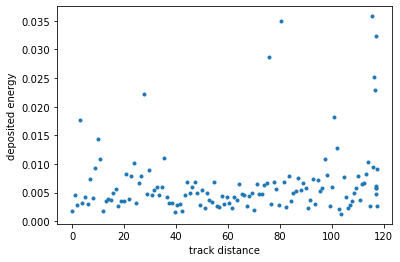

(48000182, 'e-')


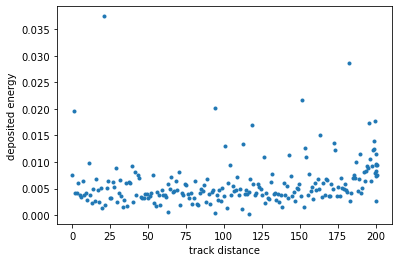

(48000183, 'e-')


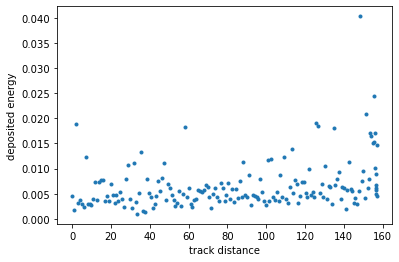

(48000184, 'e+')


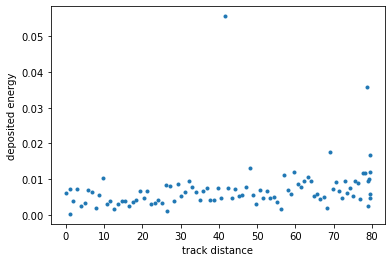

(48000184, 'e-')


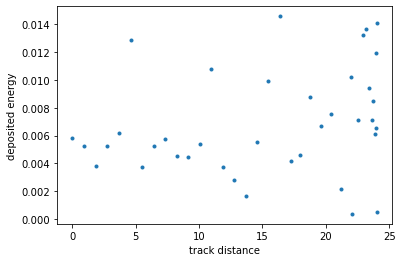

(48000185, 'e+')


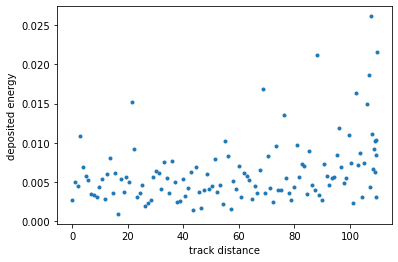

(48000185, 'e-')


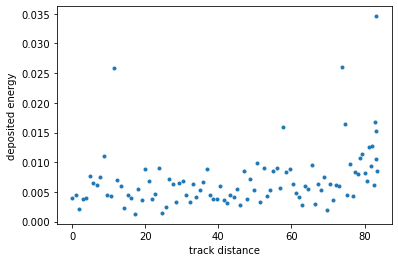

(48000186, 'e-')


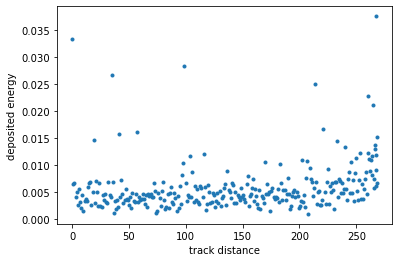

(48000187, 'e+')


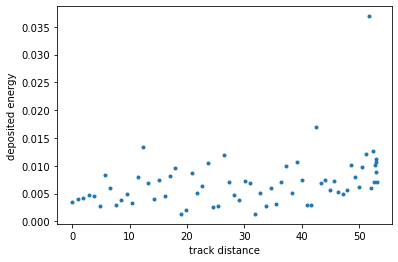

(48000187, 'e-')


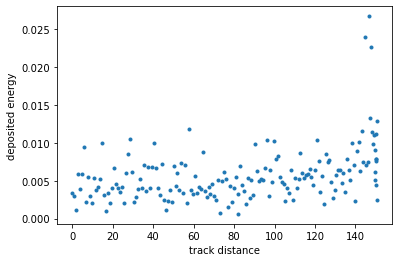

(48000188, 'e+')


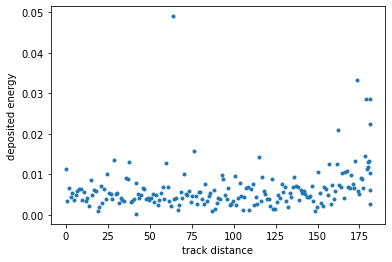

(48000188, 'e-')


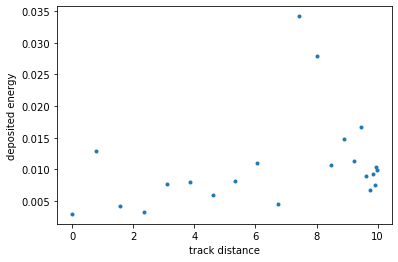

(48000189, 'e-')


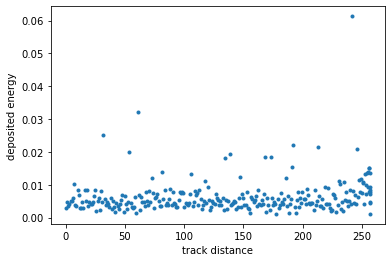

(48000190, 'e-')


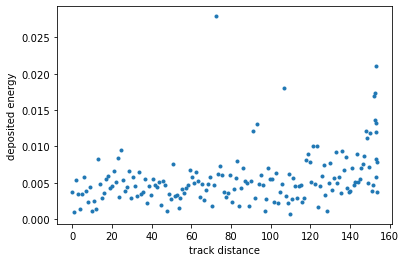

(48000191, 'e+')


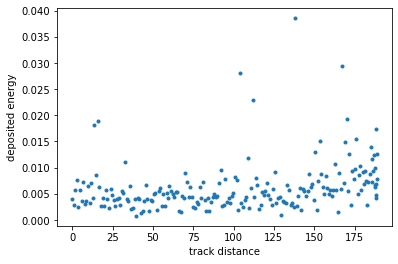

(48000191, 'e-')


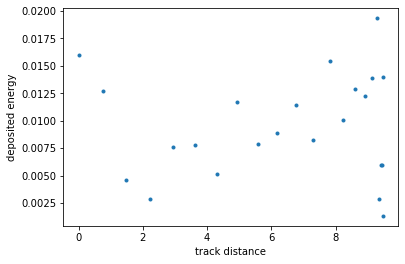

(48000192, 'e+')


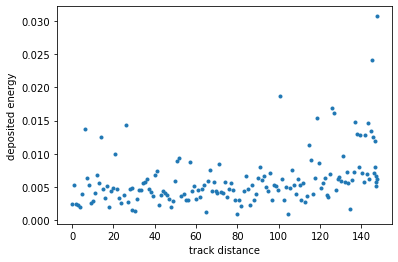

(48000192, 'e-')


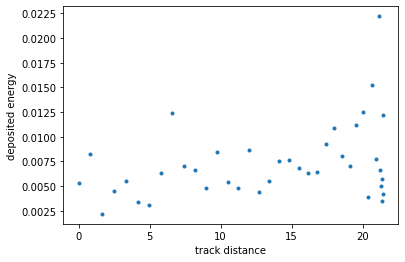

(48000193, 'e-')


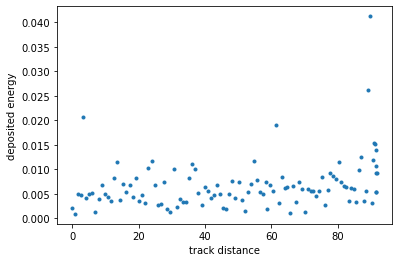

(48000194, 'e-')


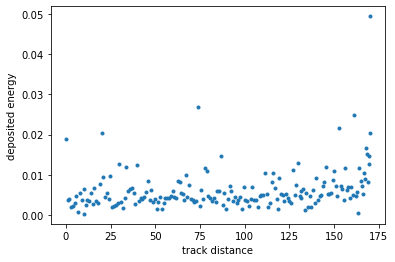

(48000195, 'e-')


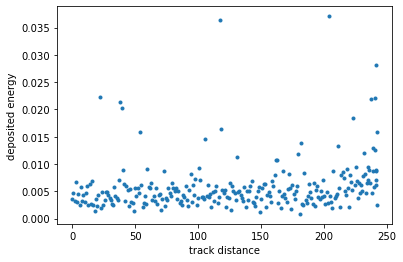

(48000196, 'e-')


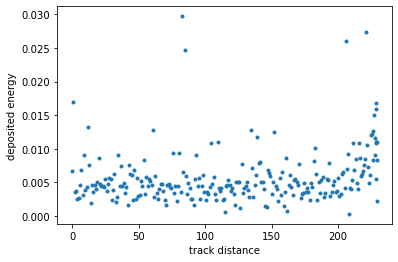

(48000197, 'e-')


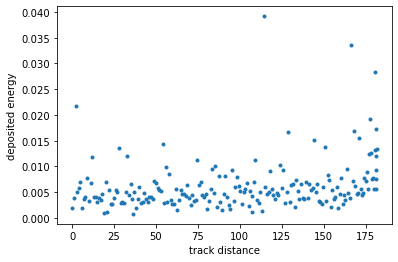

(48000198, 'e-')


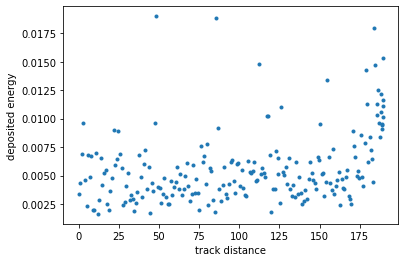

(48000199, 'e-')


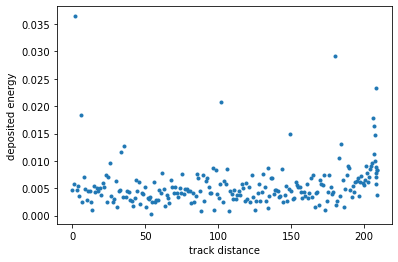

(48000200, 'e-')


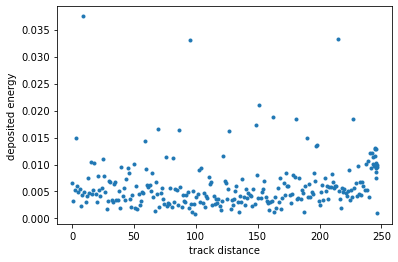

(48000202, 'e-')


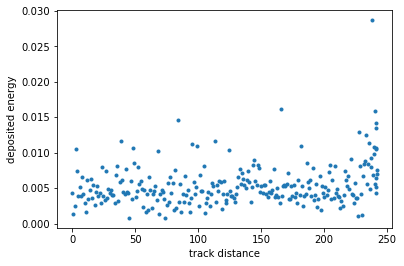

(48000203, 'e-')


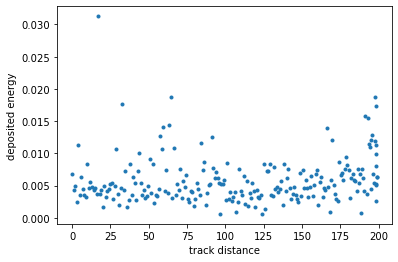

(48000204, 'e-')


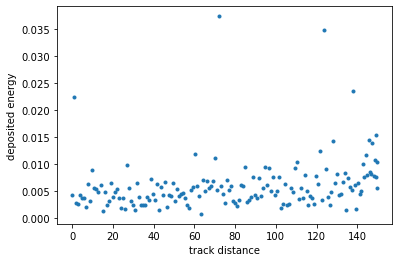

(48000205, 'e-')


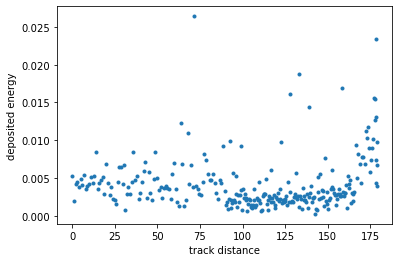

(48000206, 'e-')


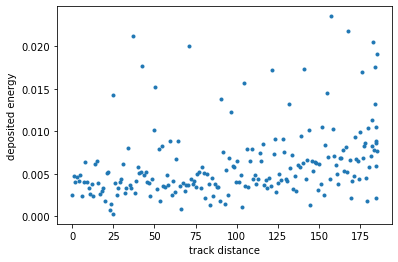

(48000207, 'e-')


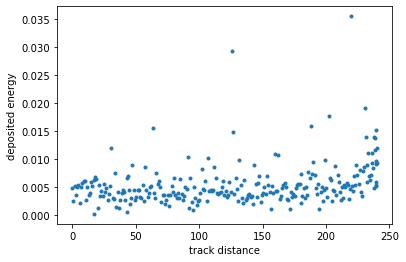

(48000208, 'e-')


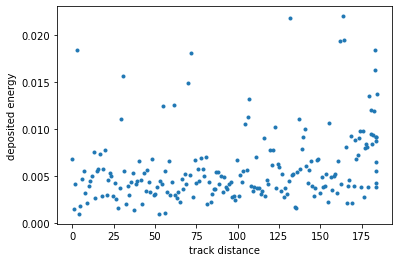

(48000209, 'e-')


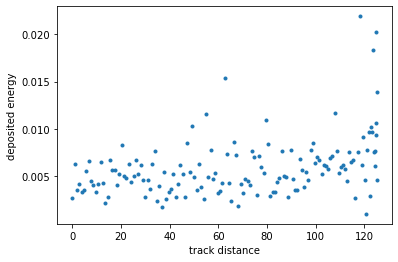

(48000210, 'e-')


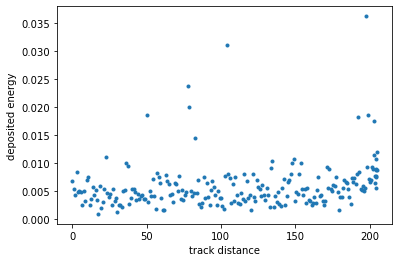

(48000211, 'e-')


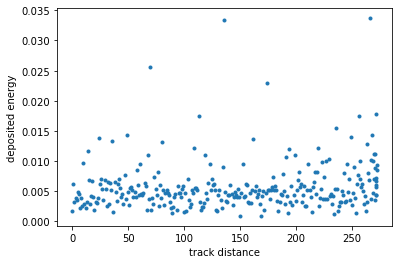

(48000212, 'e-')


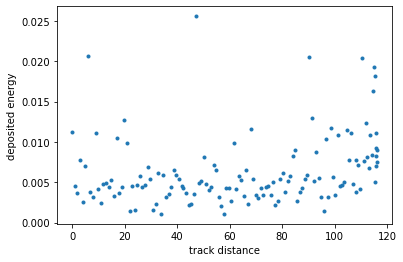

(48000213, 'e-')


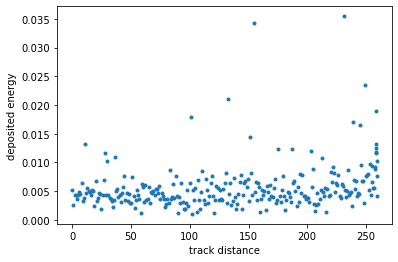

(48000214, 'e-')


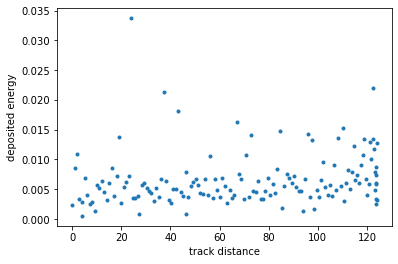

(48000215, 'e-')


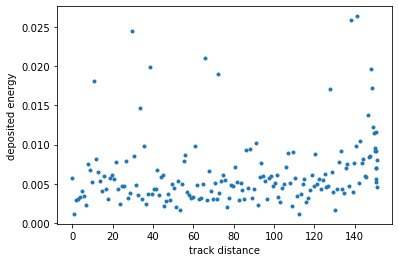

(48000216, 'e-')


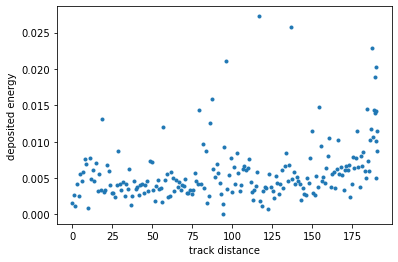

(48000217, 'e+')


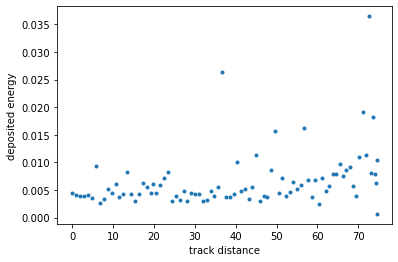

(48000217, 'e-')


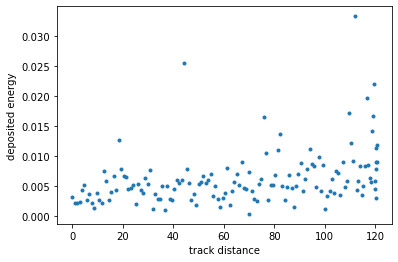

(48000218, 'e-')


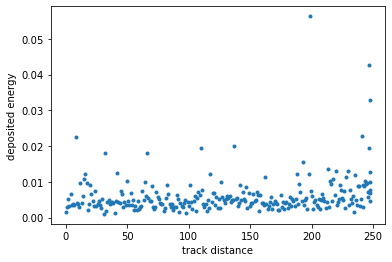

(48000219, 'e-')


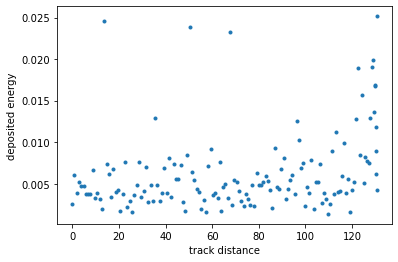

(48000220, 'e-')


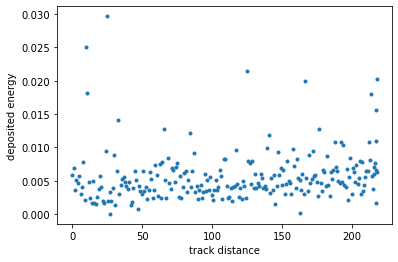

(48000221, 'e+')


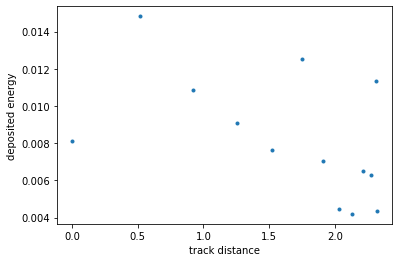

(48000221, 'e-')


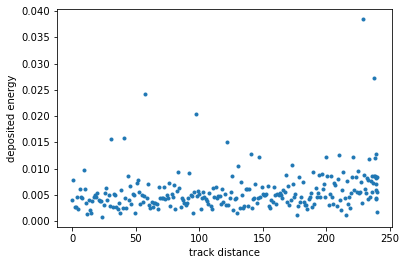

(48000222, 'e+')


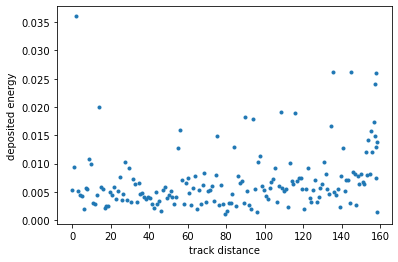

(48000222, 'e-')


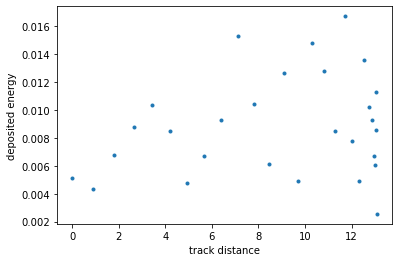

(48000223, 'e-')


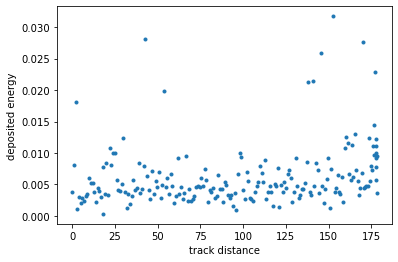

(48000224, 'e-')


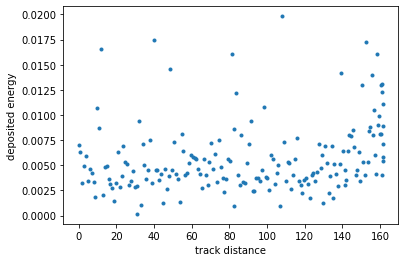

(48000225, 'e+')


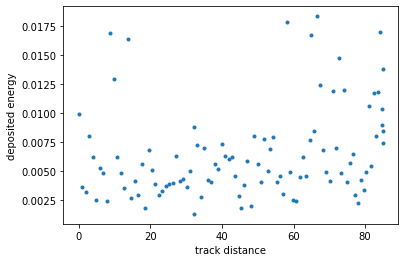

(48000225, 'e-')


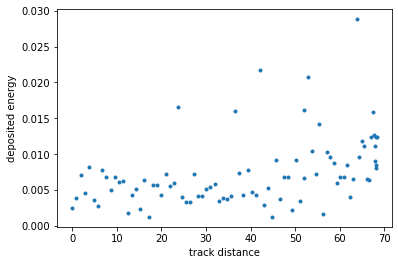

(48000226, 'e-')


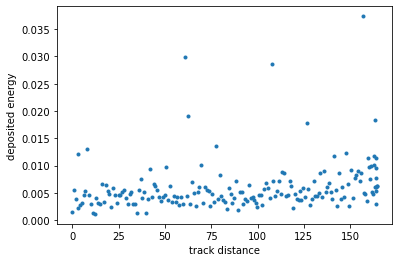

(48000228, 'e-')


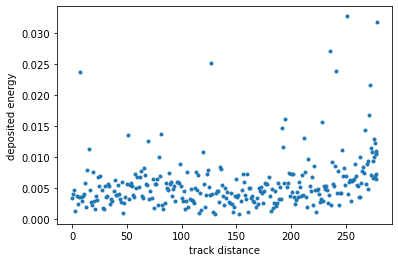

(48000229, 'e-')


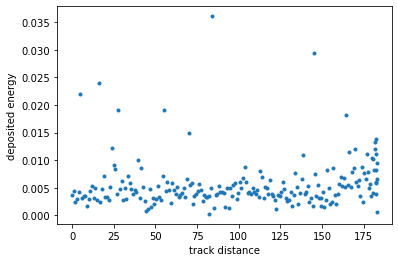

(48000230, 'e-')


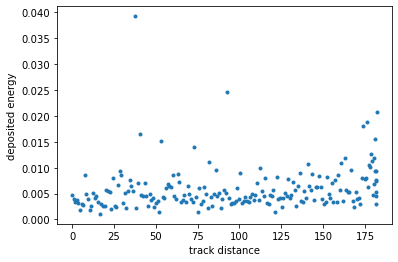

(48000231, 'e-')


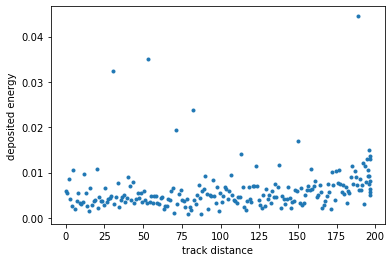

(48000232, 'e-')


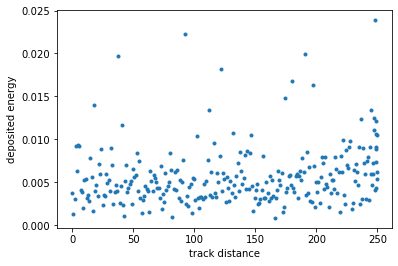

(48000233, 'e-')


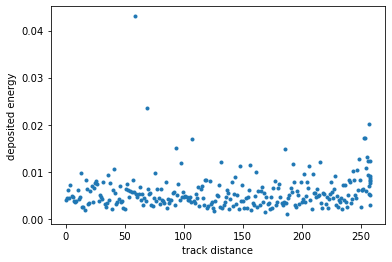

(48000234, 'e-')


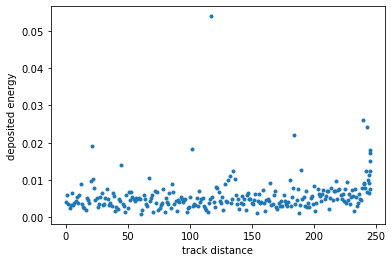

(48000235, 'e+')


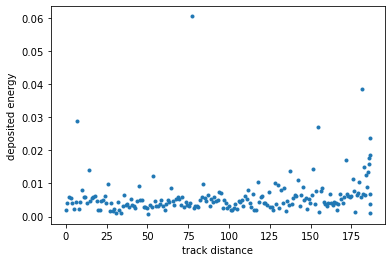

(48000235, 'e-')


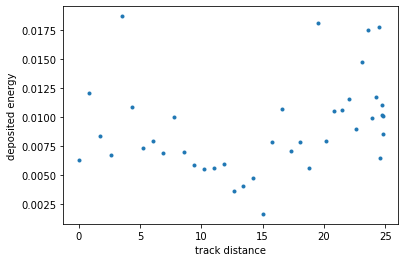

(48000236, 'e+')


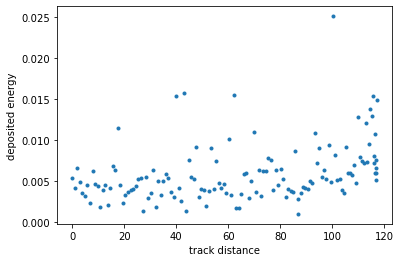

(48000236, 'e-')


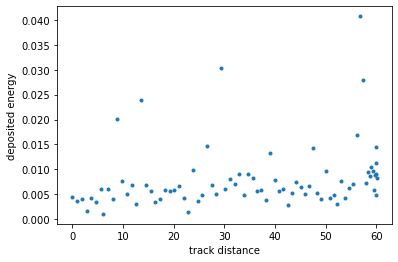

(48000237, 'e-')


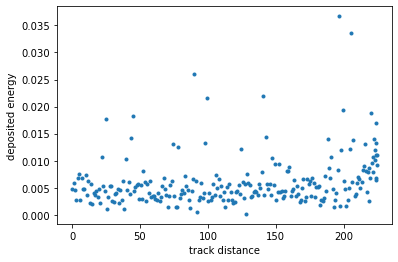

(48000238, 'e-')


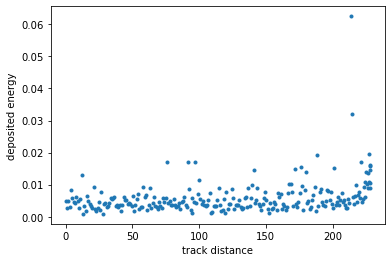

(48000239, 'e-')


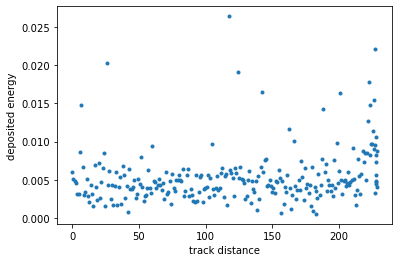

(48000240, 'e-')


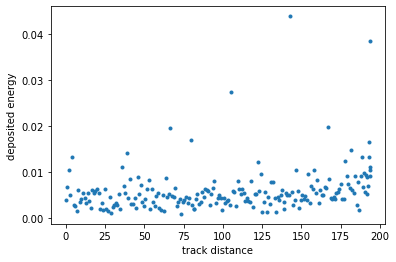

(48000241, 'e-')


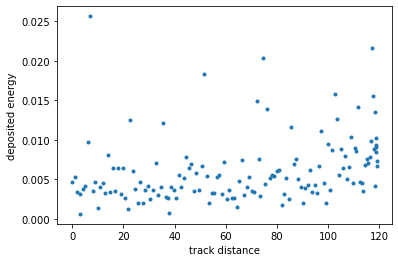

(48000242, 'e-')


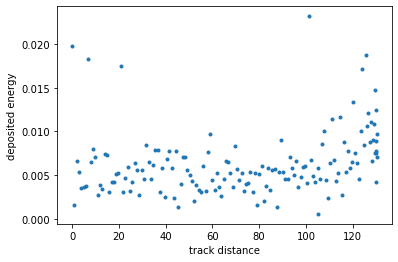

(48000243, 'e+')


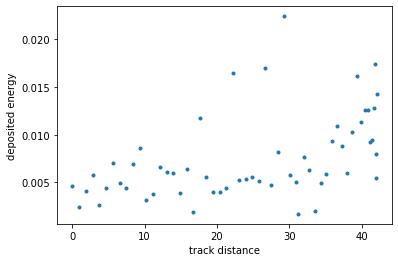

(48000243, 'e-')


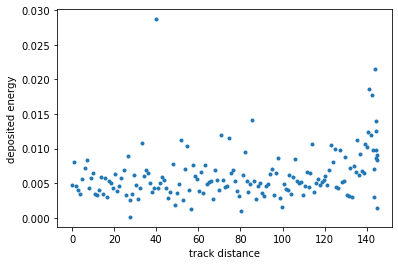

(48000244, 'e-')


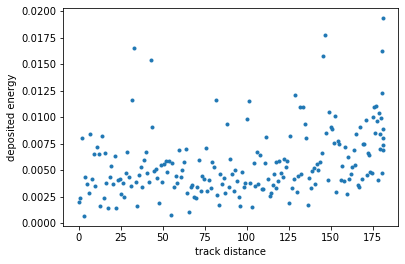

(48000245, 'e-')


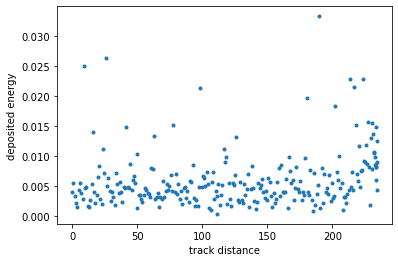

(48000246, 'e-')


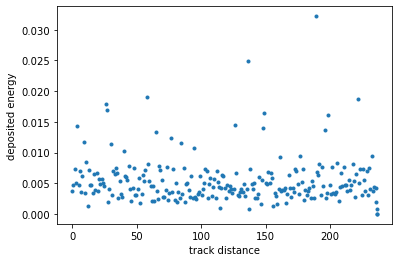

(48000247, 'e-')


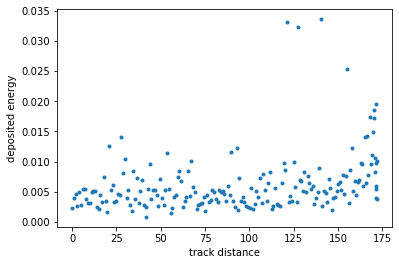

(48000248, 'e-')


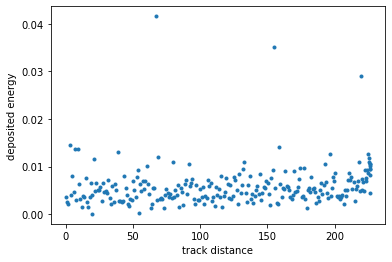

(48000249, 'e-')


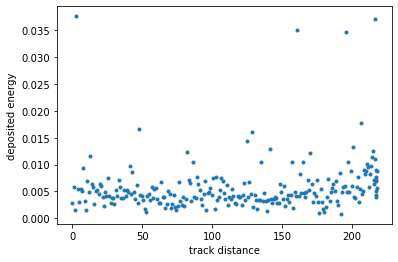

(48000250, 'e-')


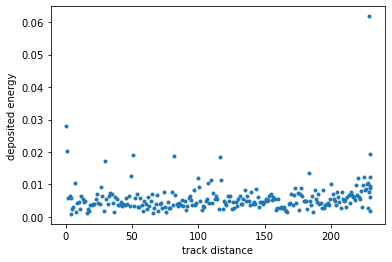

(48000251, 'e-')


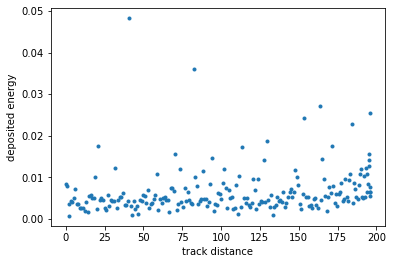

(48000252, 'e+')


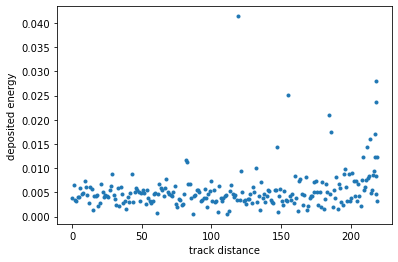

(48000252, 'e-')


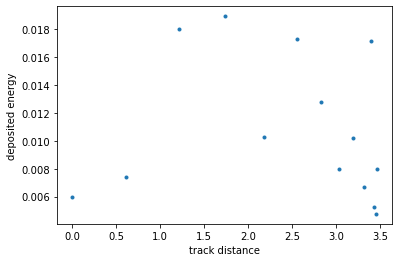

(48000253, 'e-')


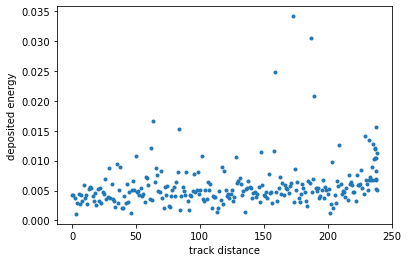

(48000254, 'e-')


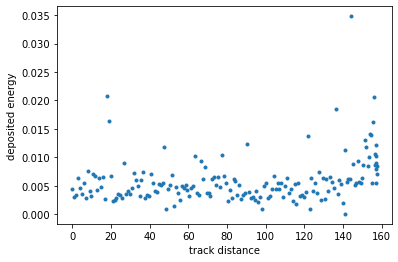

(48000255, 'e-')


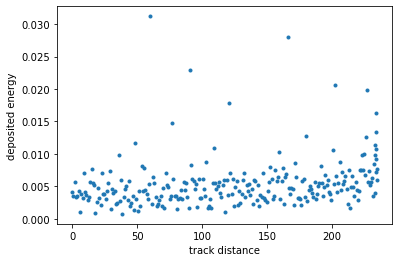

(48000256, 'e-')


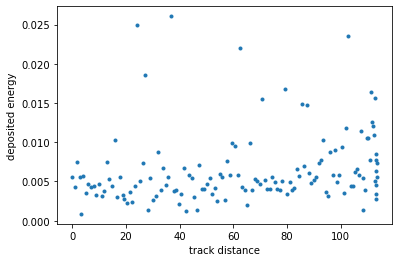

(48000257, 'e-')


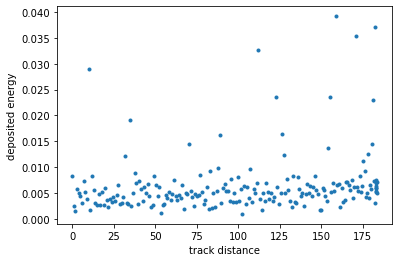

(48000258, 'e-')


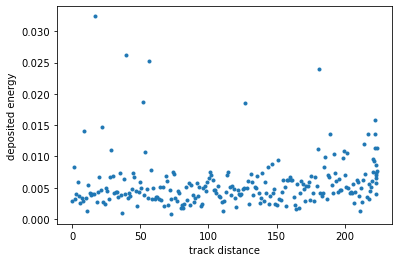

(48000259, 'e-')


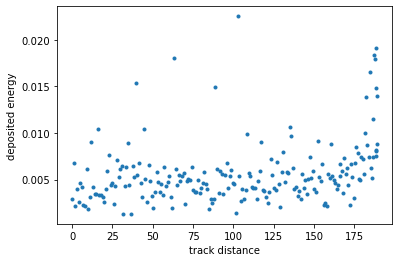

(48000260, 'e-')


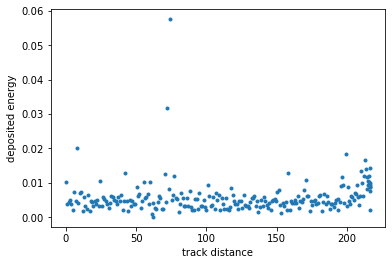

(48000261, 'e-')


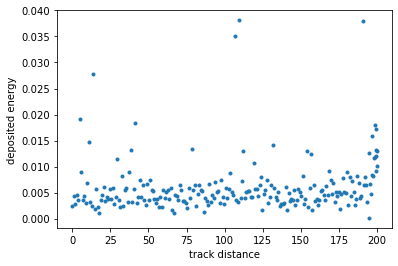

(48000262, 'e-')


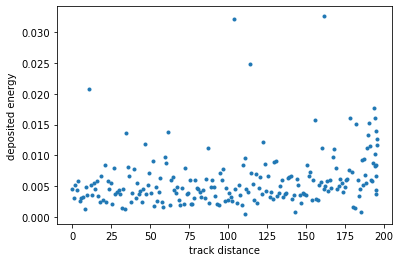

(48000263, 'e-')


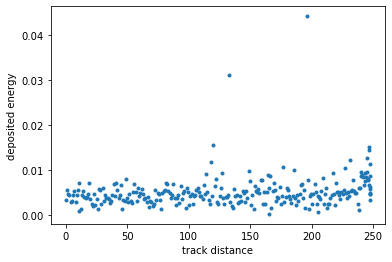

(48000264, 'e-')


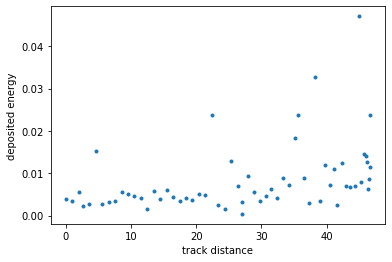

(48000265, 'e-')


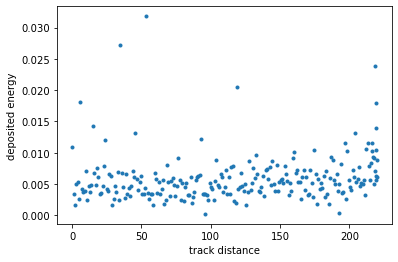

(48000266, 'e-')


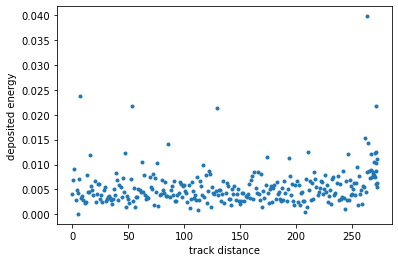

(48000267, 'e+')


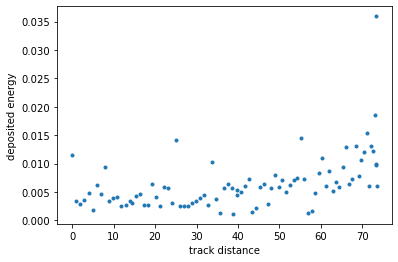

(48000267, 'e-')


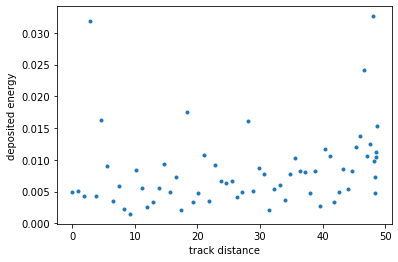

(48000268, 'e-')


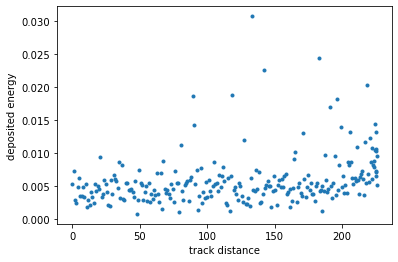

(48000269, 'e-')


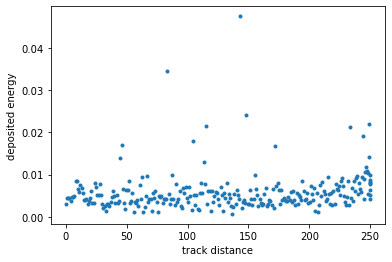

(48000270, 'e+')


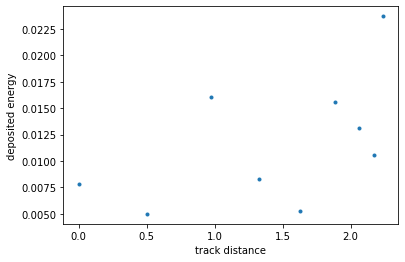

(48000270, 'e-')


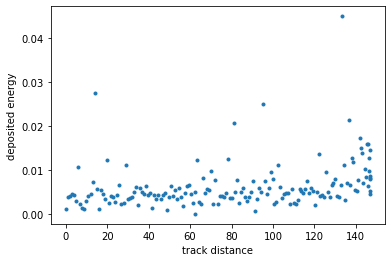

(48000271, 'e-')


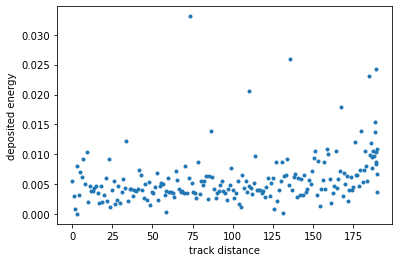

(48000272, 'e+')


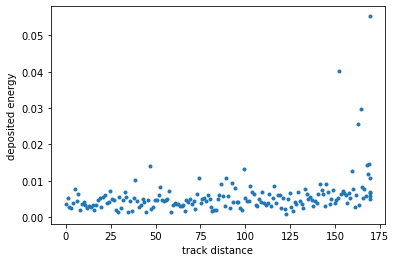

(48000272, 'e-')


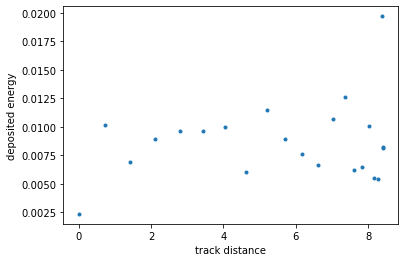

(48000273, 'e-')


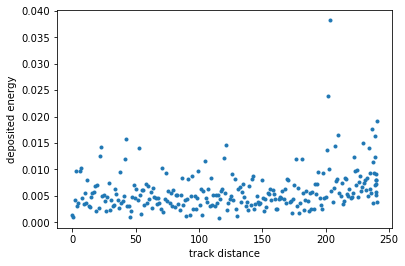

(48000274, 'e-')


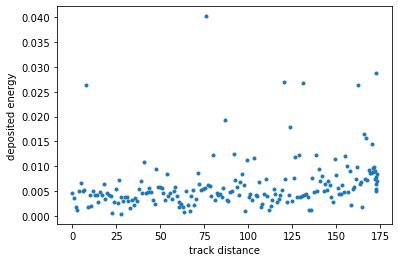

(48000275, 'e+')


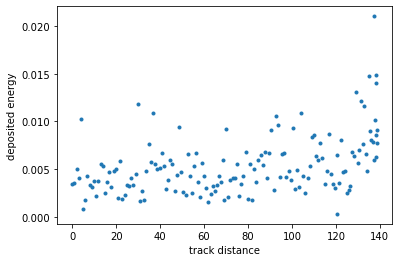

(48000275, 'e-')


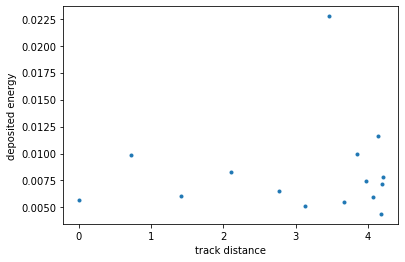

(48000276, 'e-')


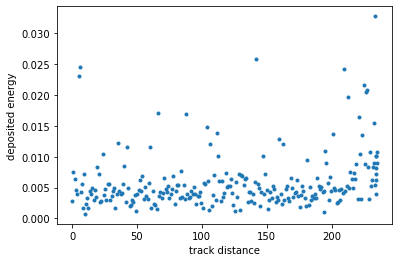

(48000277, 'e-')


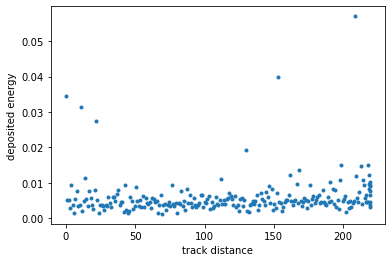

(48000278, 'e-')


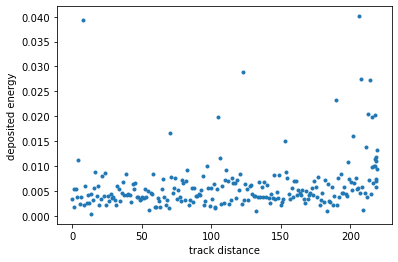

(48000279, 'e+')


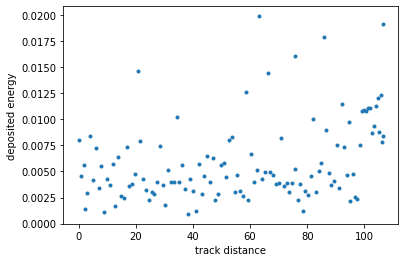

(48000279, 'e-')


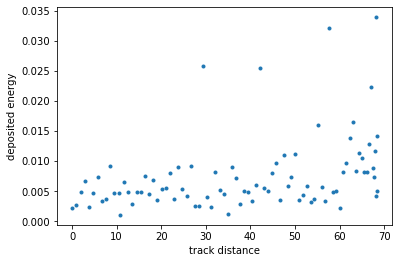

(48000280, 'e-')


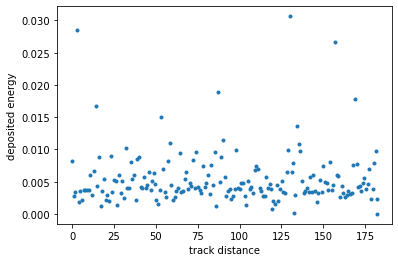

(48000281, 'e-')


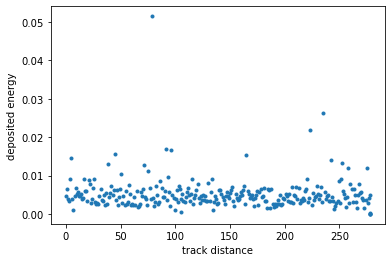

(48000282, 'e-')


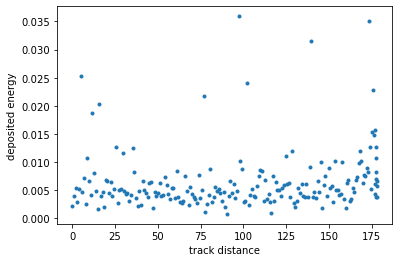

(48000283, 'e-')


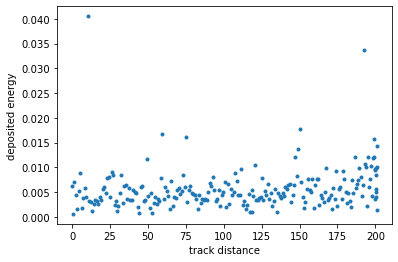

(48000285, 'e-')


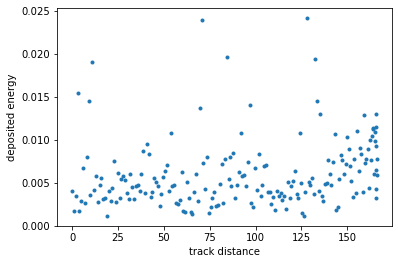

(48000286, 'e-')


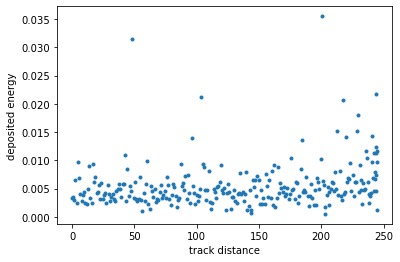

(48000287, 'e-')


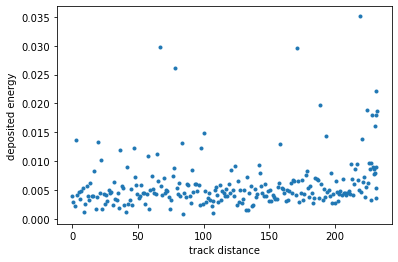

(48000288, 'e-')


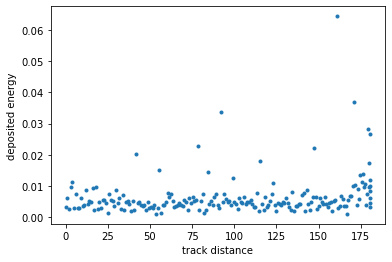

(48000289, 'e+')


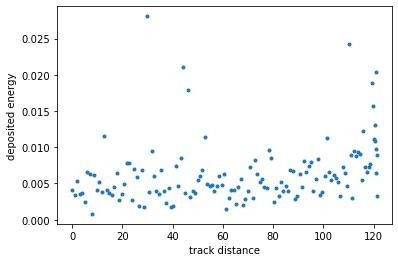

(48000289, 'e-')


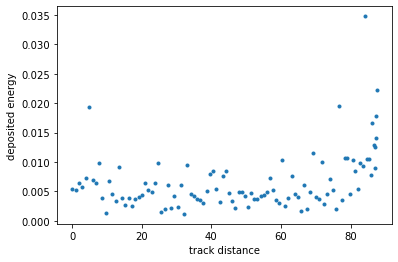

(48000290, 'e-')


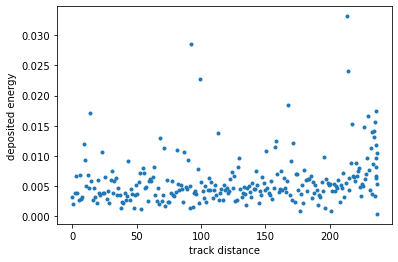

(48000291, 'e-')


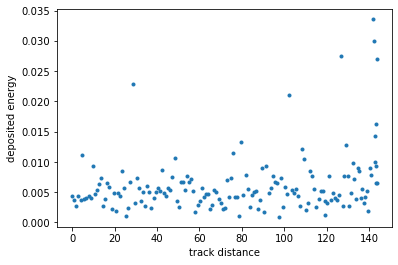

(48000292, 'e-')


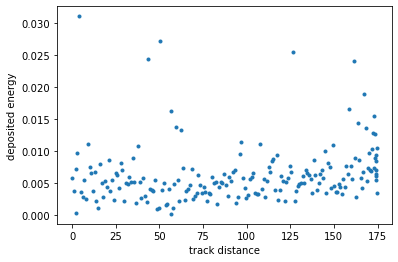

(48000293, 'e-')


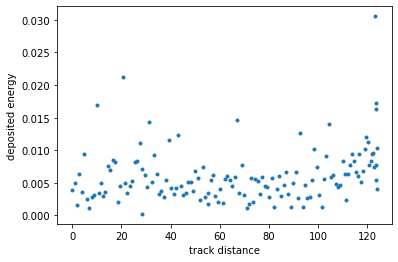

(48000294, 'e+')


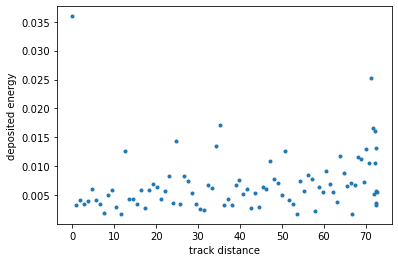

(48000294, 'e-')


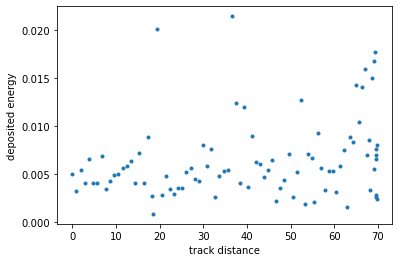

(48000295, 'e-')


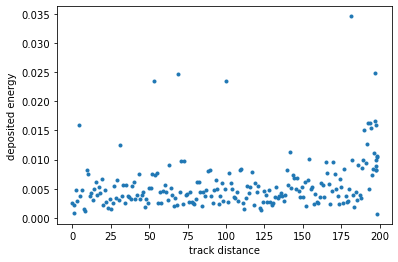

(48000296, 'e-')


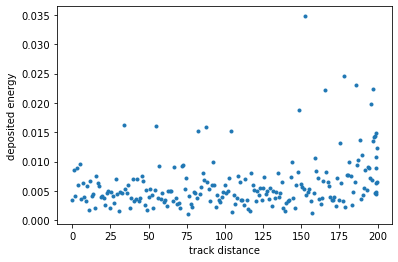

(48000297, 'e+')


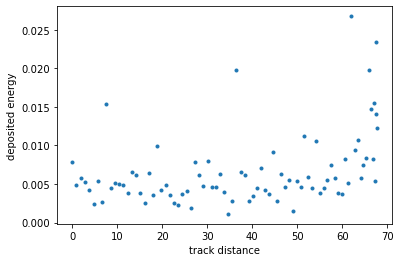

(48000297, 'e-')


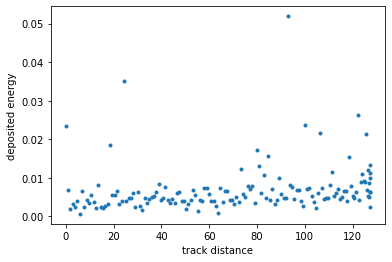

(48000298, 'e-')


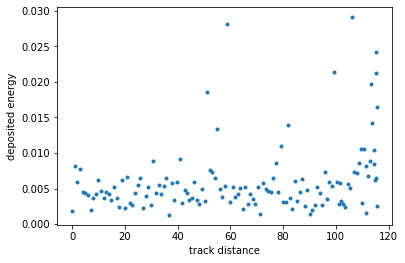

(48000299, 'e-')


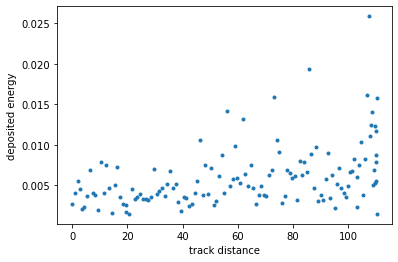

(48000300, 'e+')


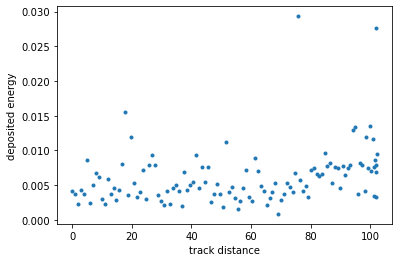

(48000300, 'e-')


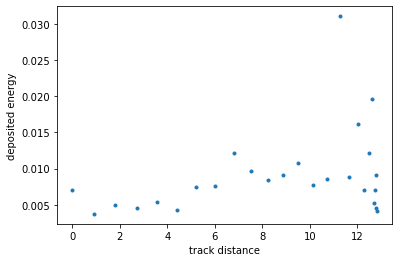

(48000301, 'e-')


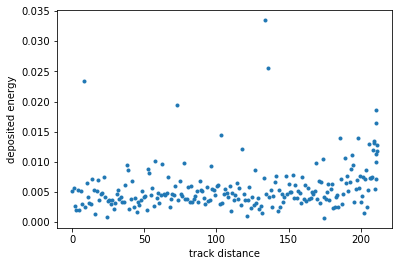

(48000302, 'e-')


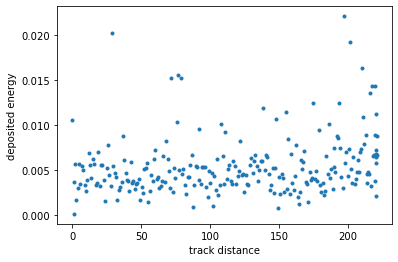

(48000303, 'e-')


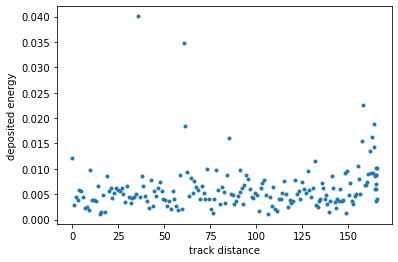

(48000304, 'e+')


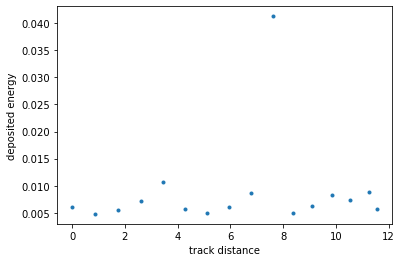

(48000304, 'e-')


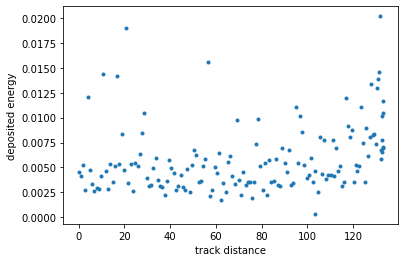

(48000305, 'e-')


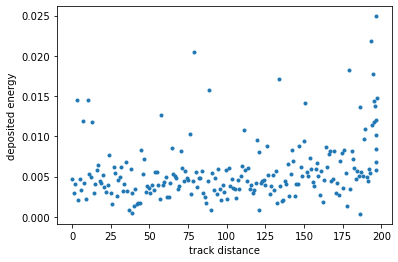

(48000306, 'e-')


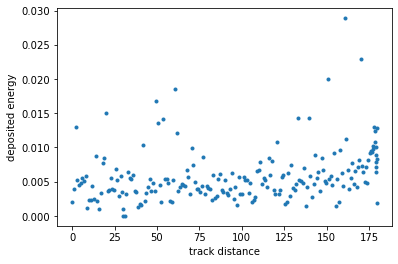

(48000307, 'e-')


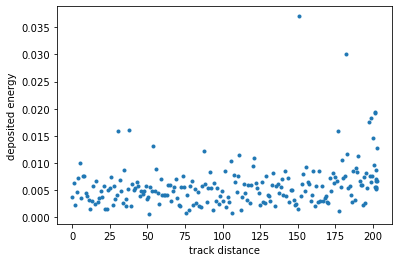

(48000308, 'e-')


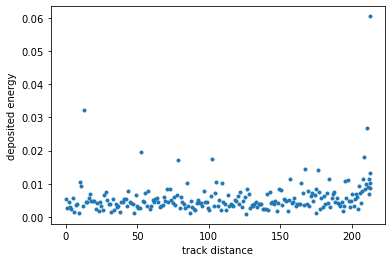

(48000309, 'e-')


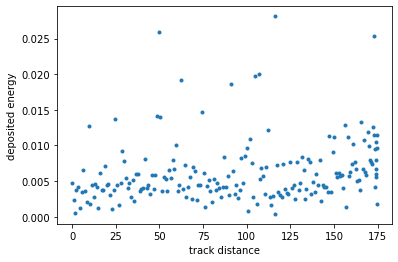

(48000310, 'e-')


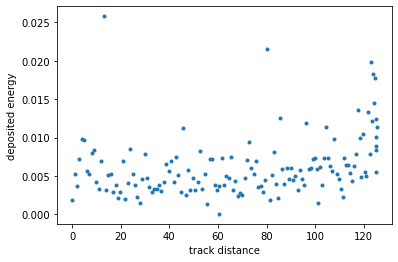

(48000311, 'e+')


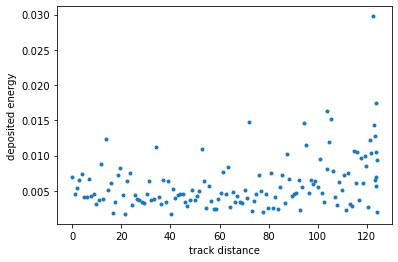

(48000311, 'e-')


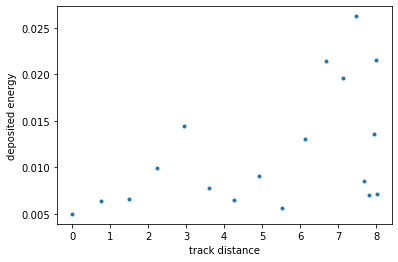

(48000312, 'e-')


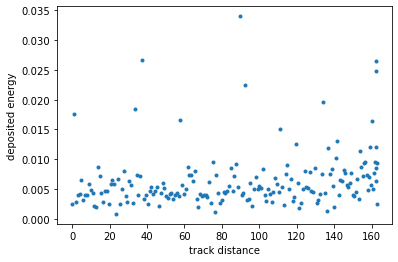

(48000313, 'e-')


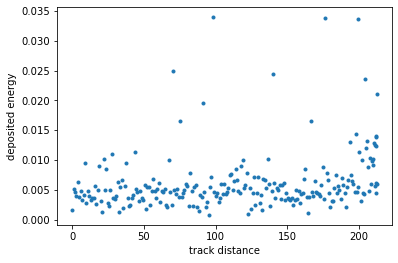

(48000314, 'e-')


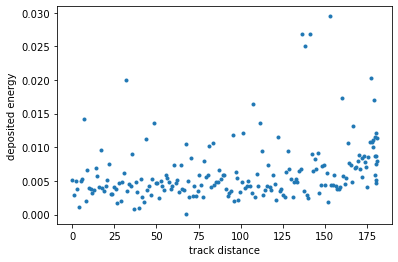

(48000315, 'e-')


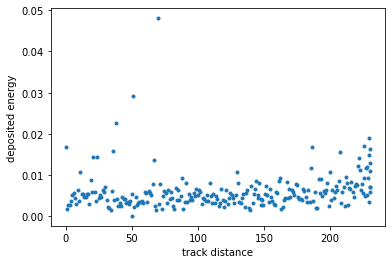

(48000316, 'e-')


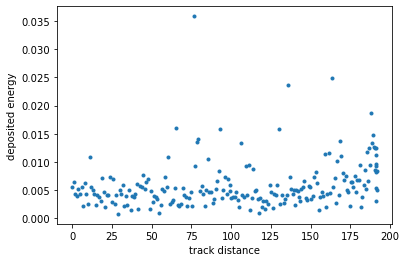

(48000317, 'e-')


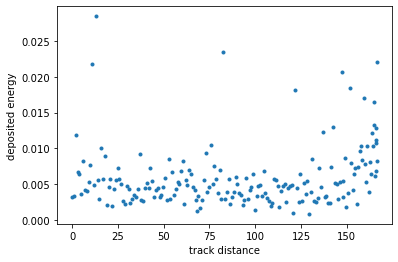

(48000318, 'e+')


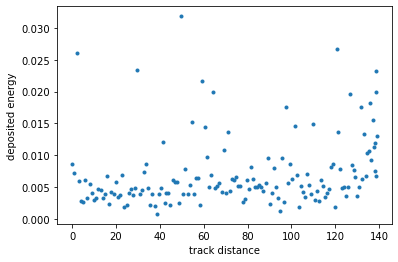

(48000318, 'e-')


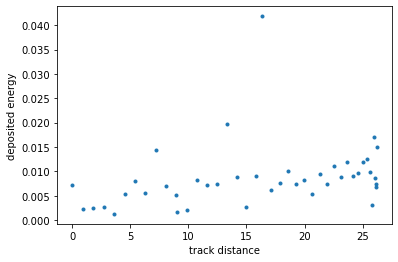

(48000319, 'e-')


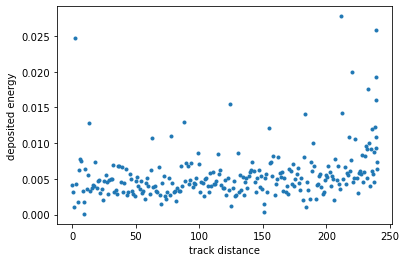

(48000320, 'e-')


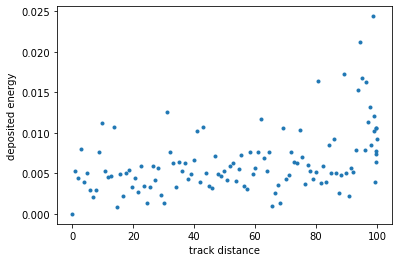

(48000321, 'e-')


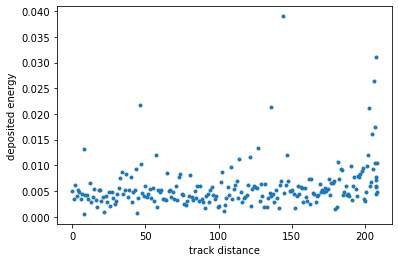

(48000322, 'e+')


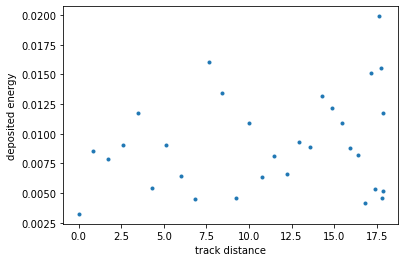

(48000322, 'e-')


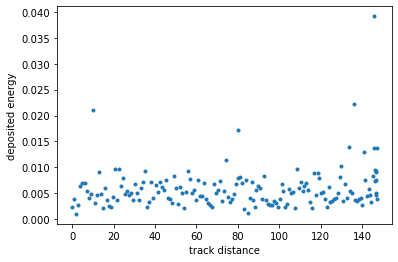

(48000323, 'e-')


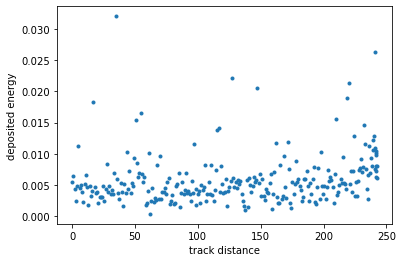

(48000324, 'e-')


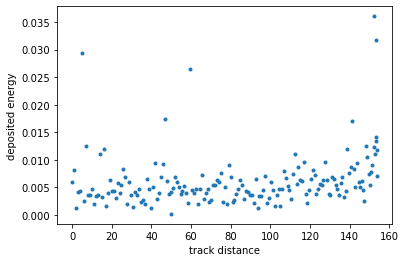

(48000325, 'e+')


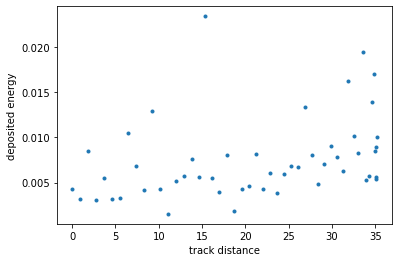

(48000325, 'e-')


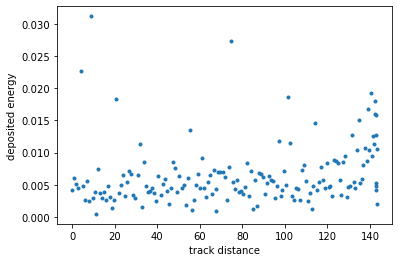

(48000326, 'e-')


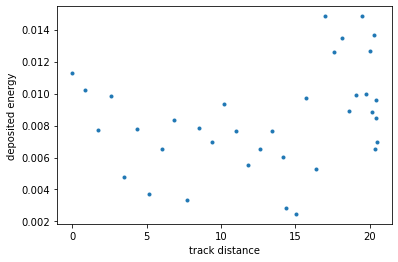

(48000327, 'e-')


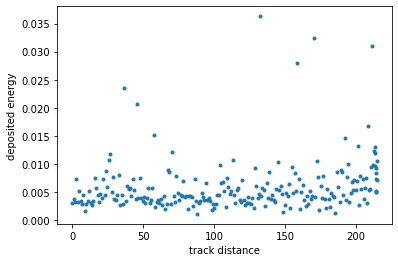

(48000328, 'e-')


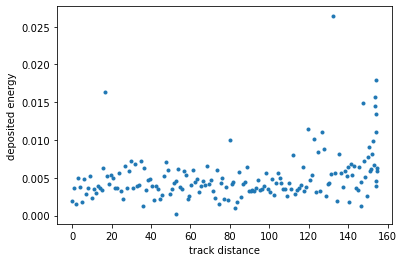

(48000329, 'e+')


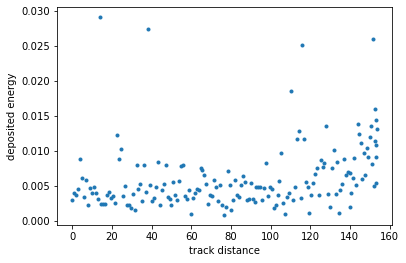

(48000329, 'e-')


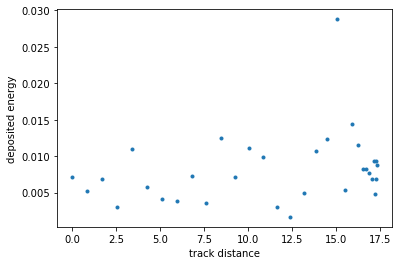

(48000331, 'e+')


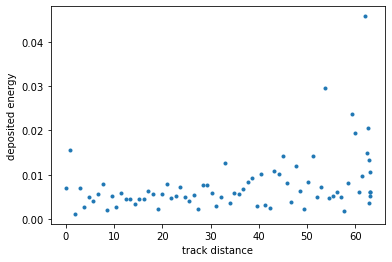

(48000331, 'e-')


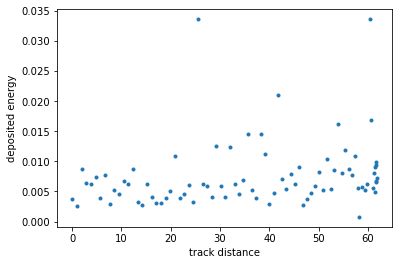

(48000332, 'e-')


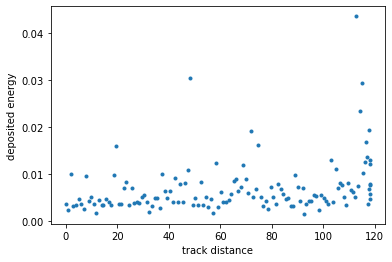

(48000333, 'e-')


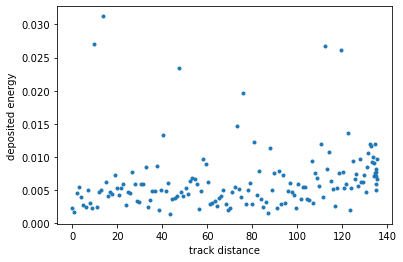

(48000334, 'e-')


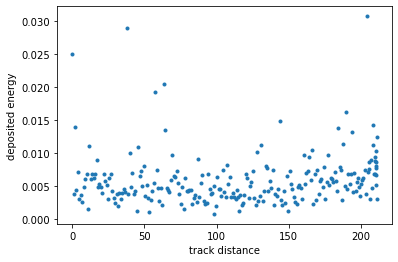

(48000335, 'e-')


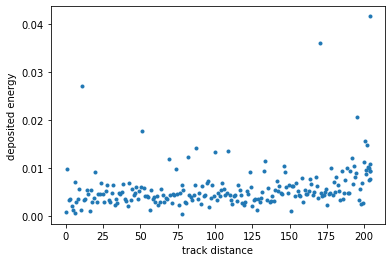

(48000336, 'e-')


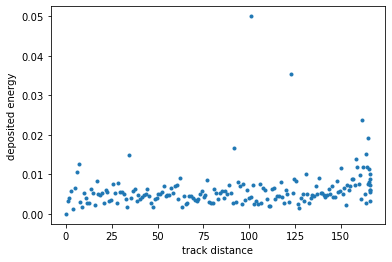

(48000337, 'e-')


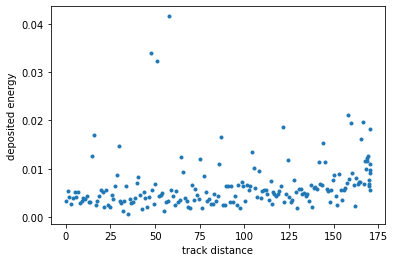

(48000338, 'e-')


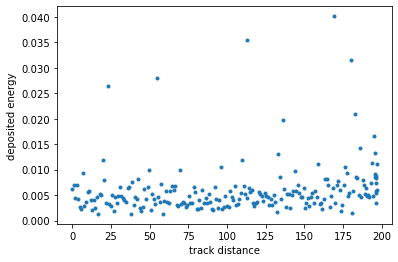

(48000339, 'e-')


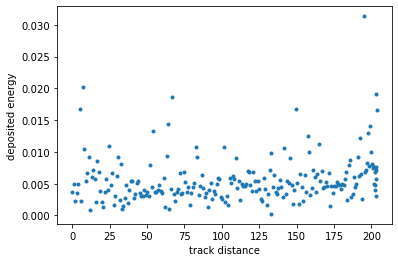

(48000340, 'e-')


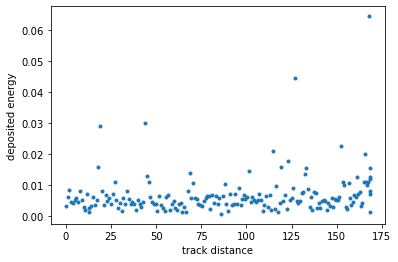

(48000341, 'e+')


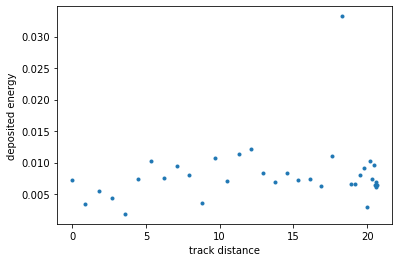

(48000341, 'e-')


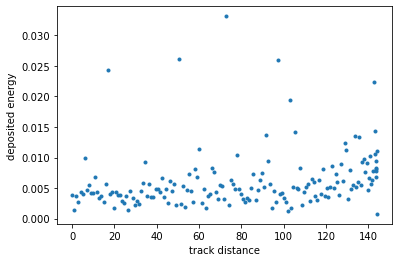

(48000342, 'e-')


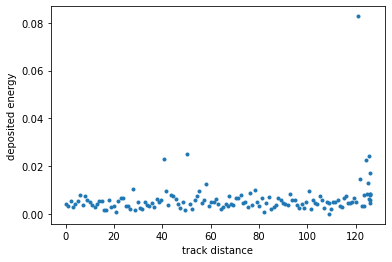

(48000343, 'e-')


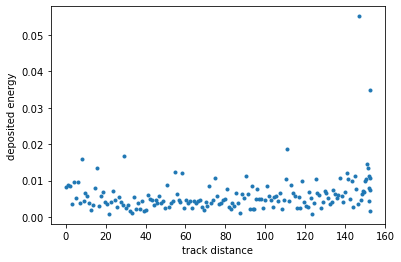

(48000344, 'e+')


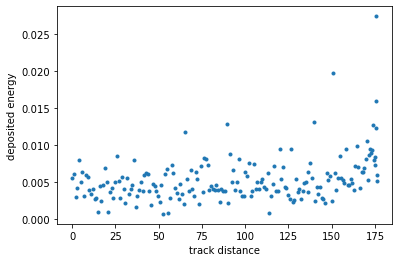

(48000344, 'e-')


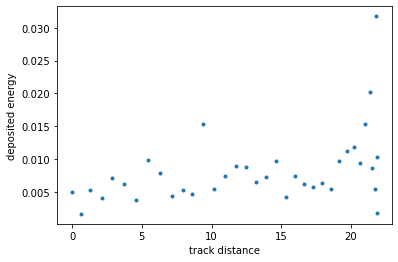

(48000345, 'e-')


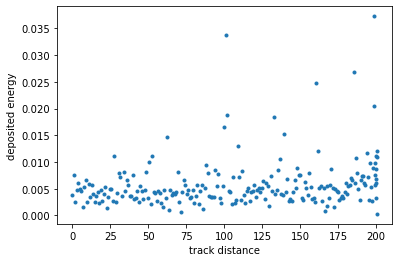

(48000347, 'e-')


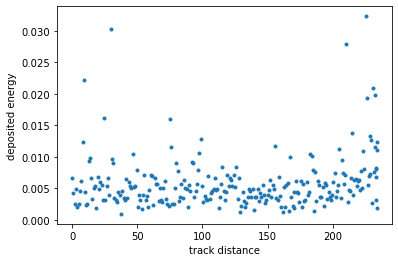

(48000348, 'e-')


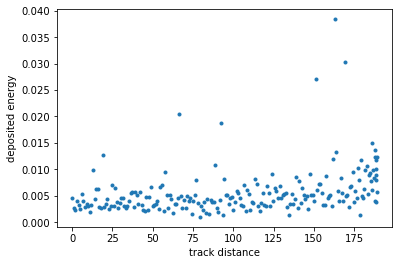

(48000349, 'e-')


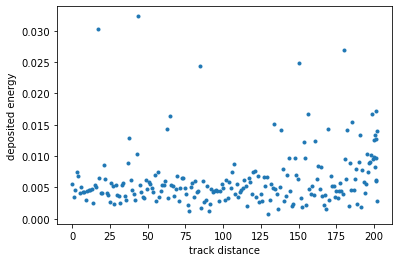

(48000350, 'e-')


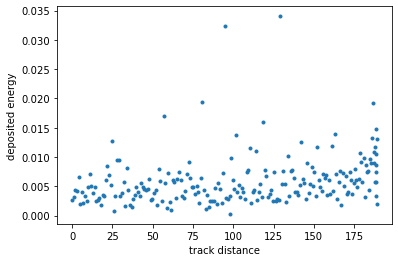

(48000351, 'e+')


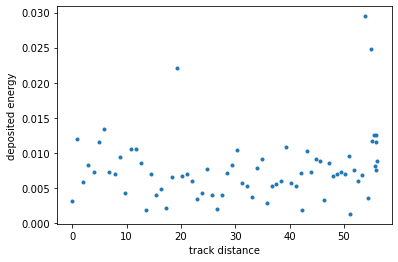

(48000351, 'e-')


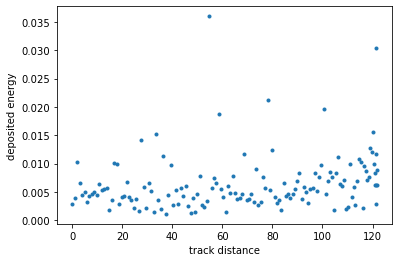

(48000352, 'e-')


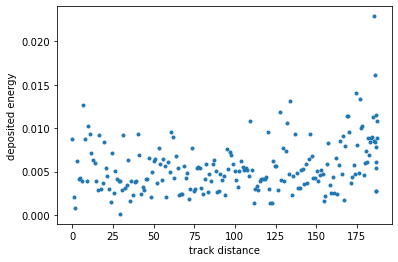

(48000353, 'e-')


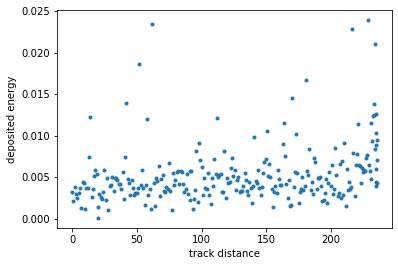

(48000354, 'e-')


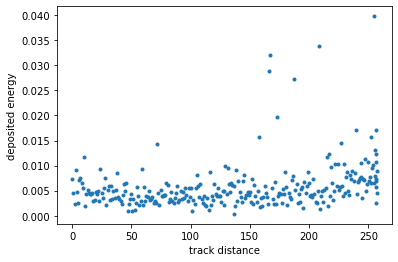

(48000355, 'e-')


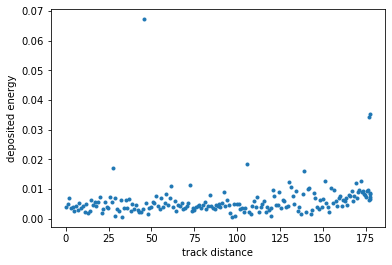

(48000356, 'e-')


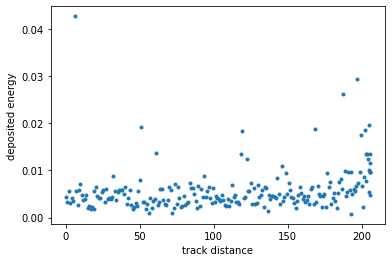

(48000357, 'e+')


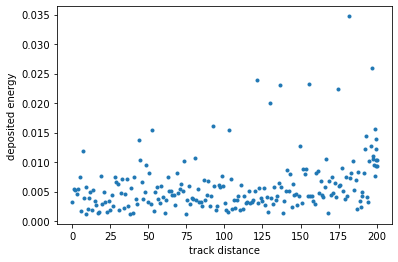

(48000357, 'e-')


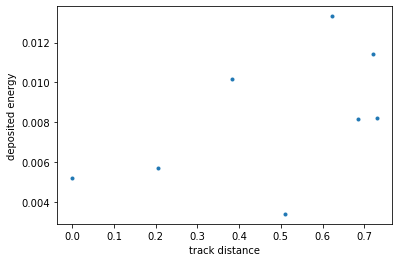

(48000358, 'e-')


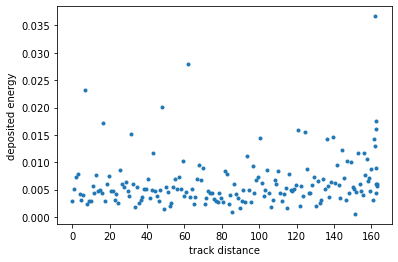

(48000359, 'e-')


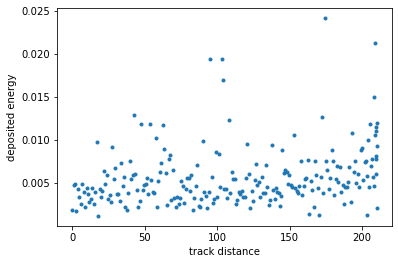

(48000360, 'e+')


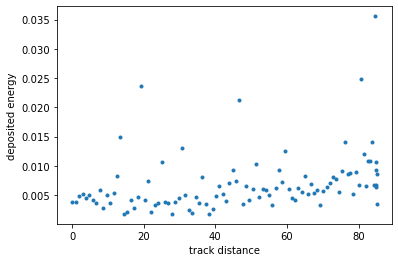

(48000360, 'e-')


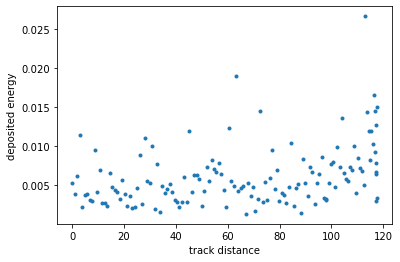

(48000361, 'e-')


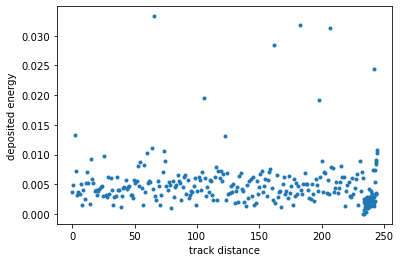

(48000362, 'e-')


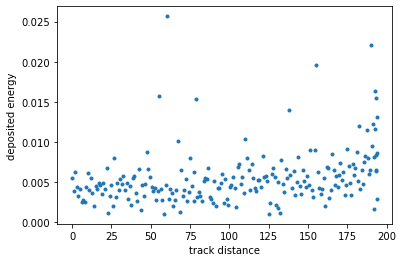

(48000363, 'e+')


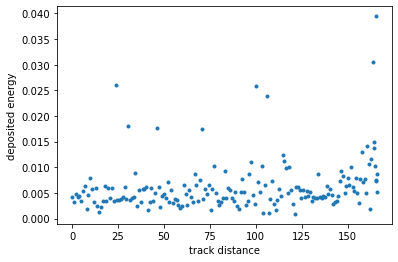

(48000363, 'e-')


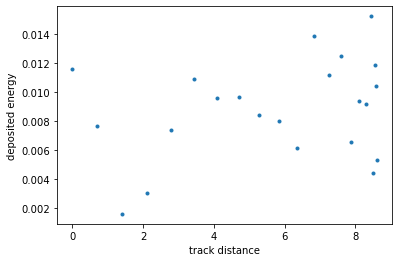

(48000364, 'e-')


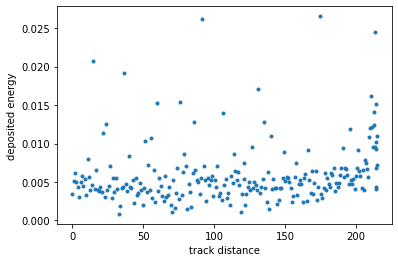

(48000365, 'e-')


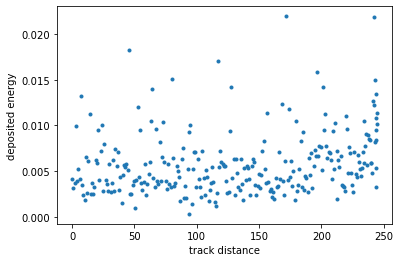

(48000366, 'e-')


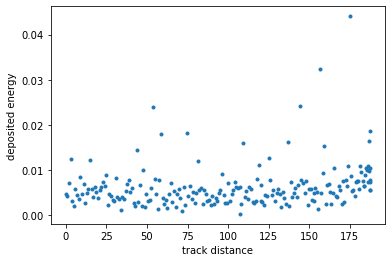

(48000367, 'e-')


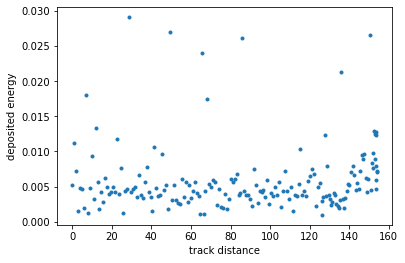

(48000368, 'e-')


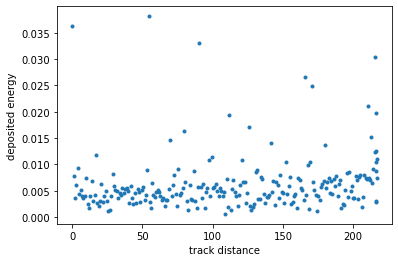

(48000369, 'e-')


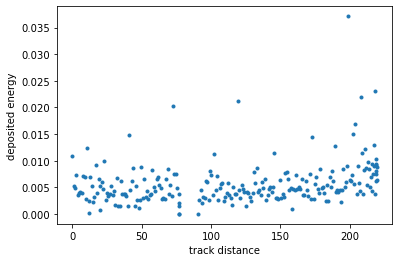

(48000370, 'e+')


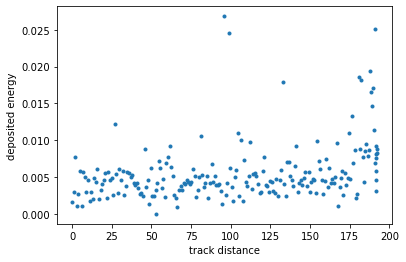

(48000370, 'e-')


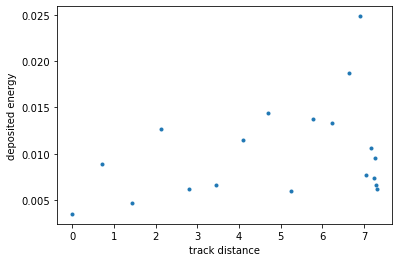

(48000371, 'e+')


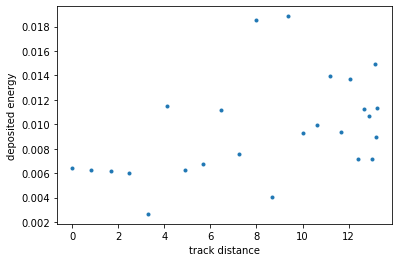

(48000371, 'e-')


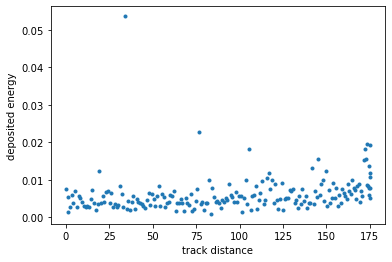

(48000372, 'e-')


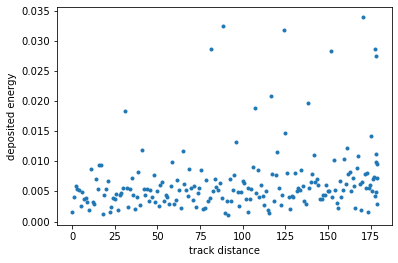

(48000373, 'e-')


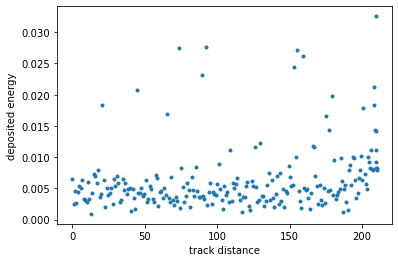

(48000374, 'e-')


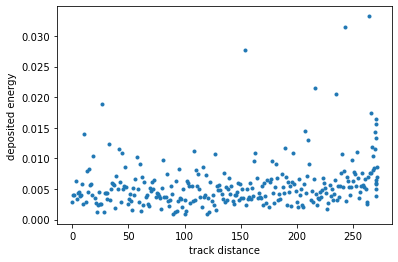

(48000375, 'e+')


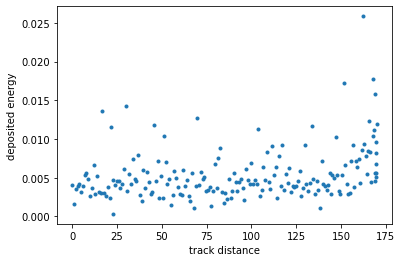

(48000375, 'e-')


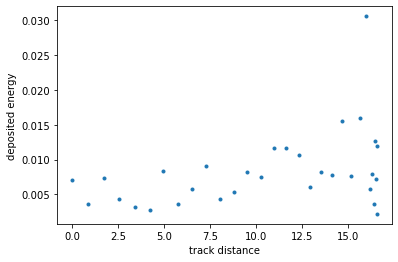

(48000376, 'e+')


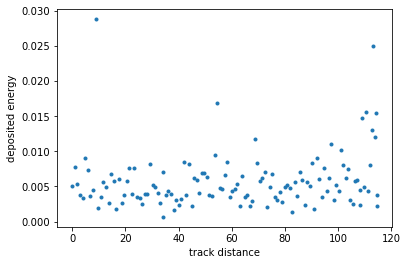

(48000376, 'e-')


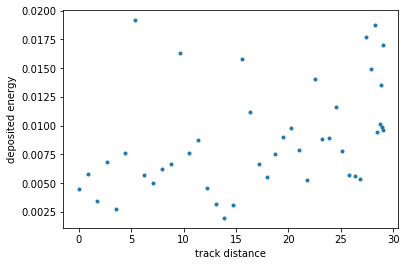

(48000377, 'e-')


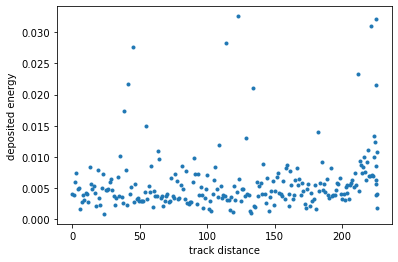

(48000378, 'e-')


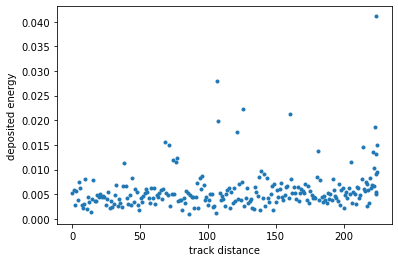

(48000379, 'e+')


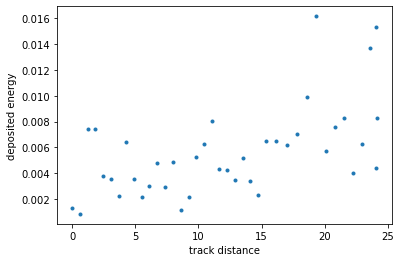

(48000379, 'e-')


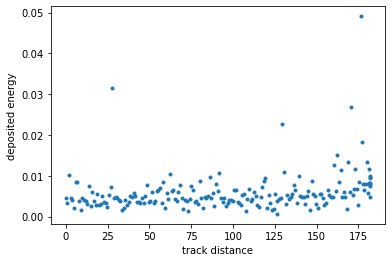

(48000381, 'e-')


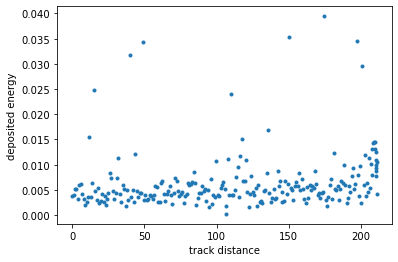

(48000382, 'e-')


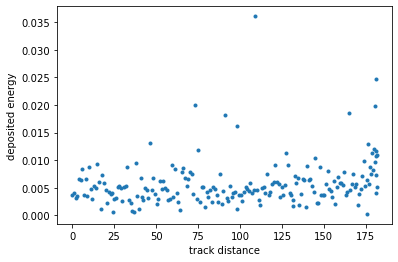

(48000383, 'e-')


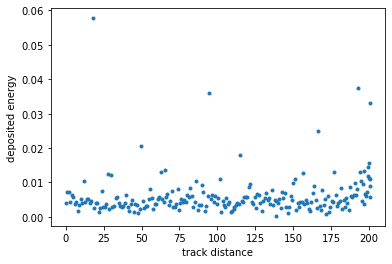

(48000384, 'e-')


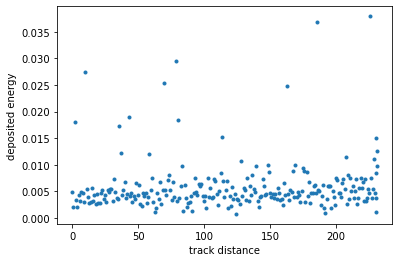

(48000385, 'e-')


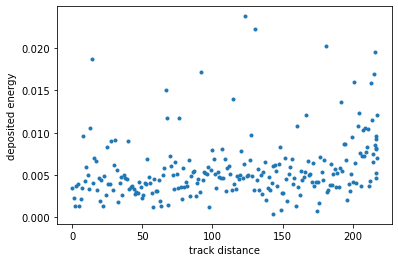

(48000386, 'e-')


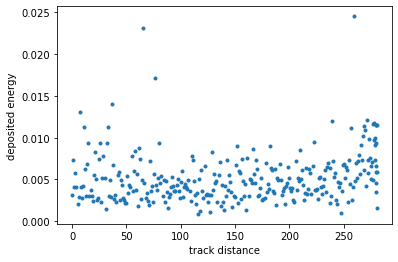

(48000387, 'e-')


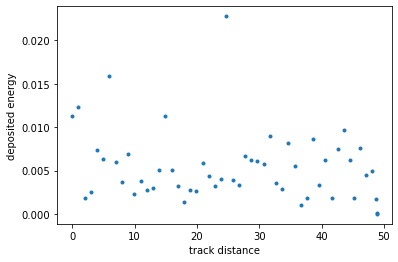

(48000388, 'e+')


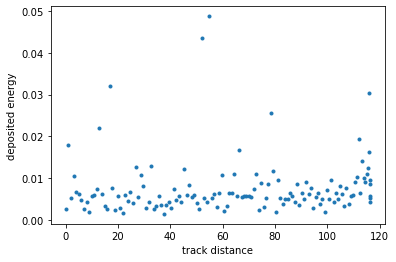

(48000388, 'e-')


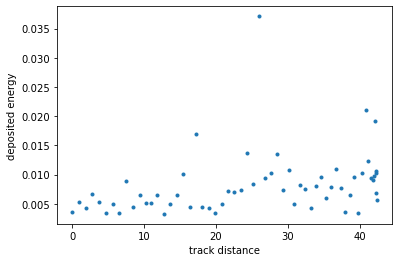

(48000389, 'e-')


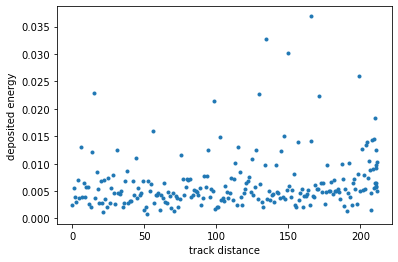

(48000390, 'e-')


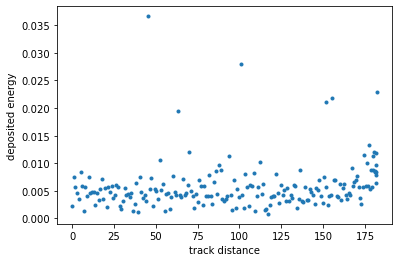

(48000391, 'e-')


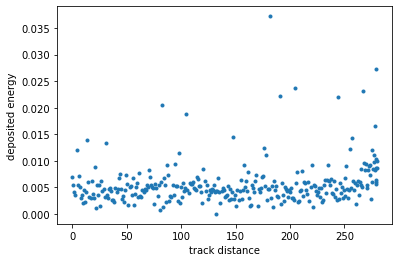

(48000392, 'e+')


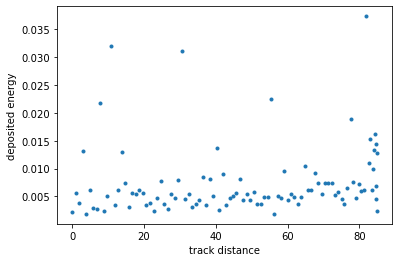

(48000392, 'e-')


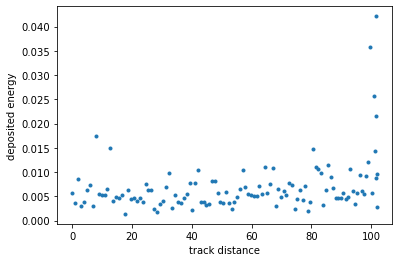

(48000393, 'e-')


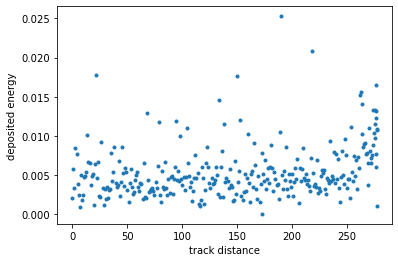

(48000394, 'e-')


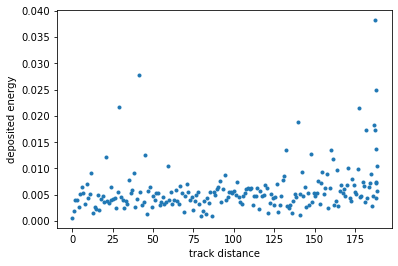

(48000395, 'e-')


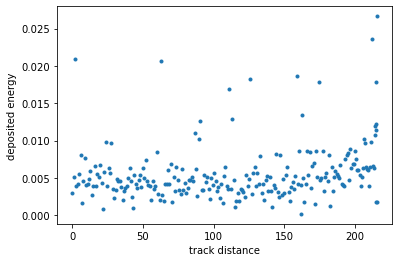

(48000396, 'e+')


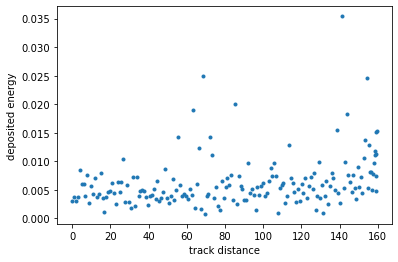

(48000396, 'e-')


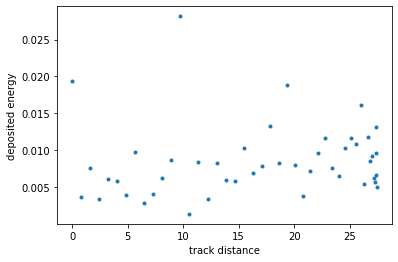

(48000397, 'e+')


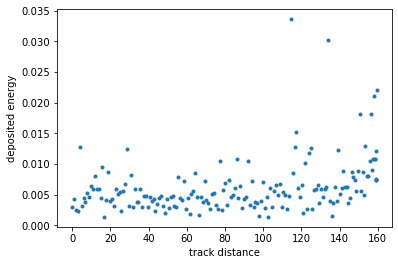

(48000397, 'e-')


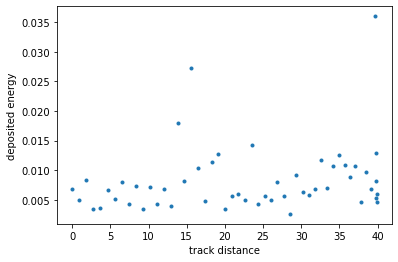

(48000398, 'e-')


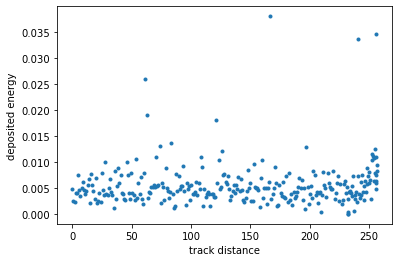

(48000399, 'e-')


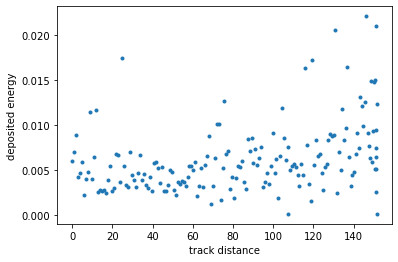

(48000400, 'e-')


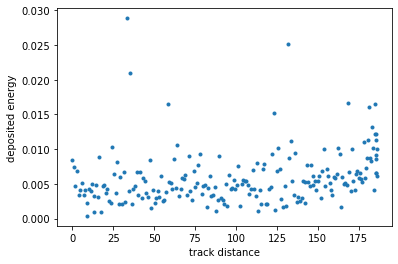

(48000401, 'e+')


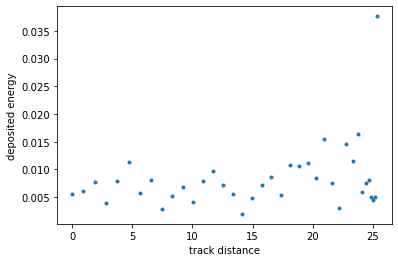

(48000401, 'e-')


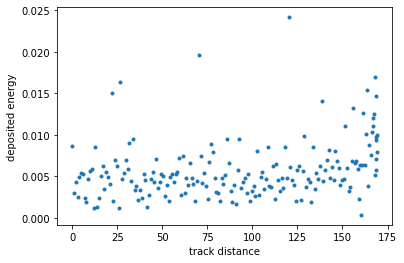

(48000402, 'e-')


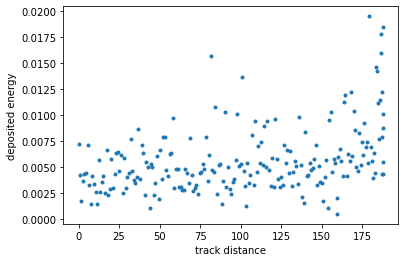

(48000403, 'e+')


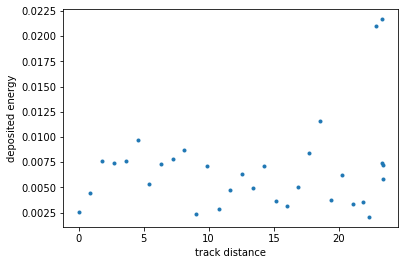

(48000403, 'e-')


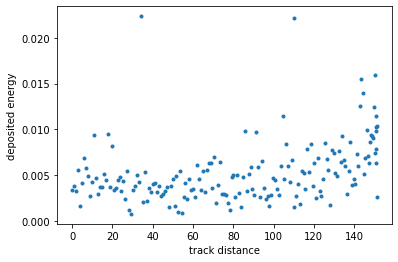

(48000404, 'e+')


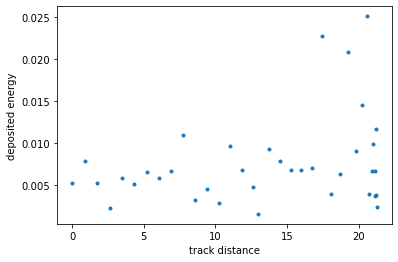

(48000404, 'e-')


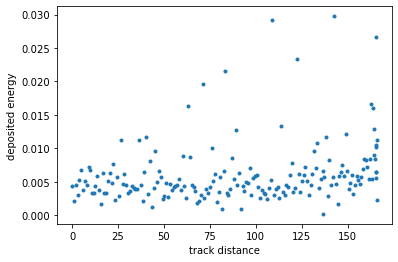

(48000405, 'e+')


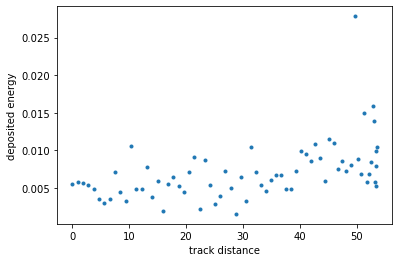

(48000405, 'e-')


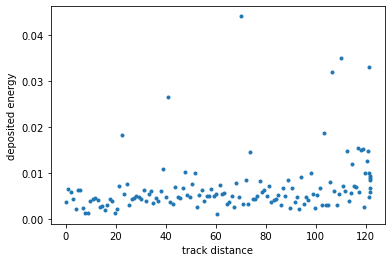

(48000406, 'e+')


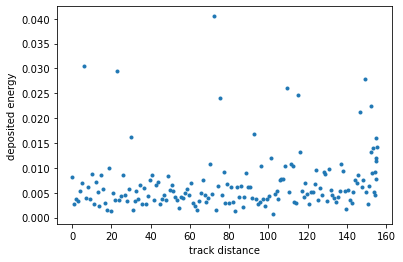

(48000406, 'e-')


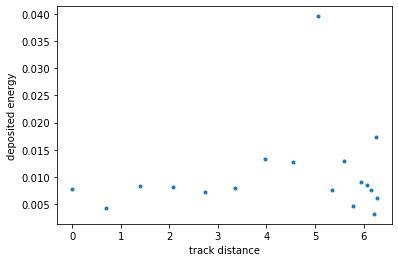

(48000407, 'e-')


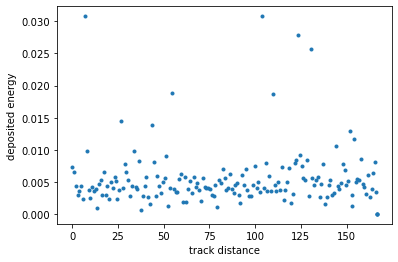

(48000408, 'e-')


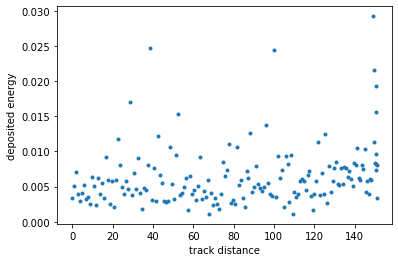

(48000409, 'e+')


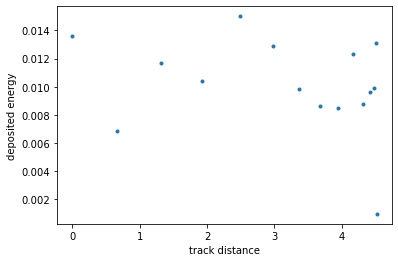

(48000409, 'e-')


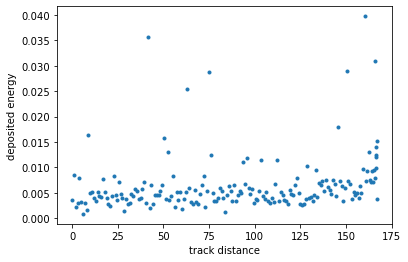

(48000410, 'e-')


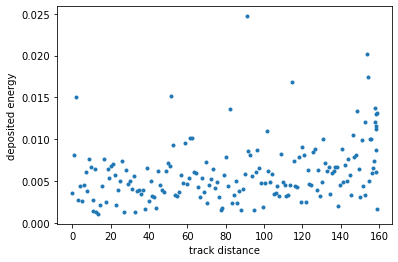

(48000411, 'e-')


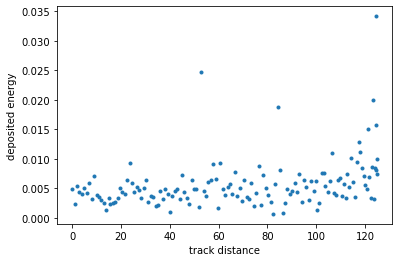

(48000412, 'e-')


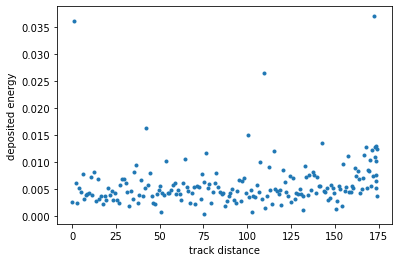

(48000413, 'e-')


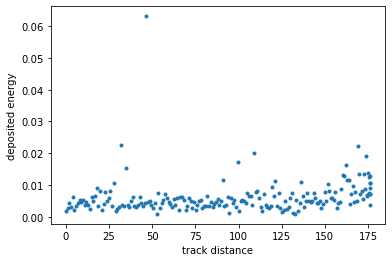

(48000414, 'e-')


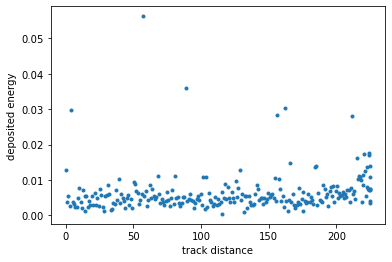

(48000415, 'e-')


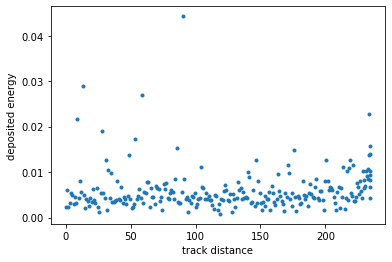

(48000416, 'e+')


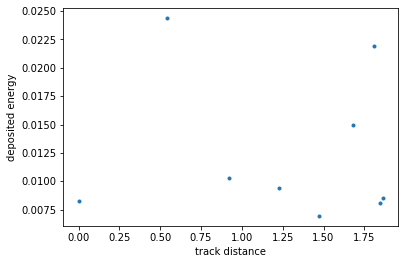

(48000416, 'e-')


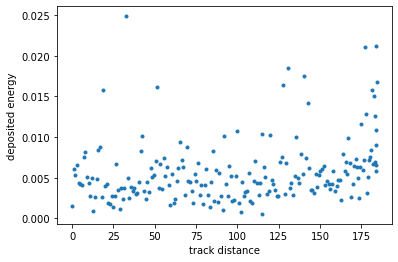

(48000417, 'e-')


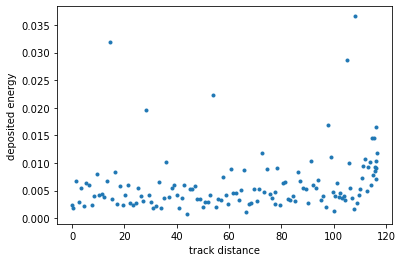

(48000418, 'e-')


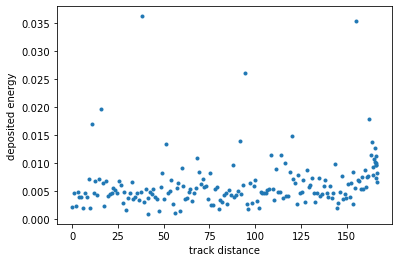

(48000419, 'e-')


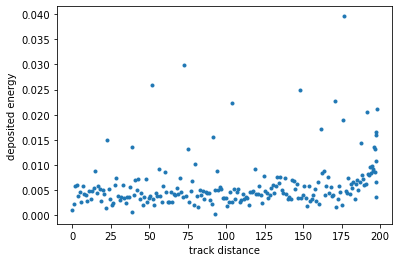

(48000420, 'e-')


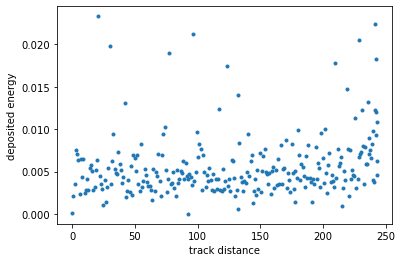

(48000421, 'e-')


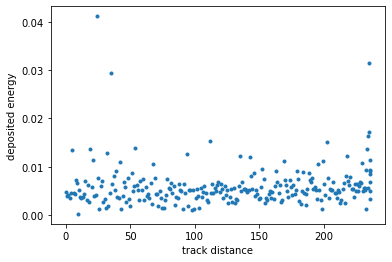

(48000422, 'e-')


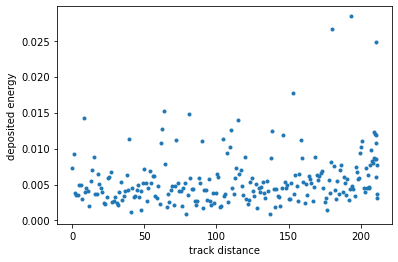

(48000423, 'e-')


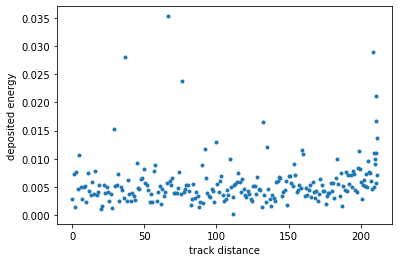

(48000424, 'e-')


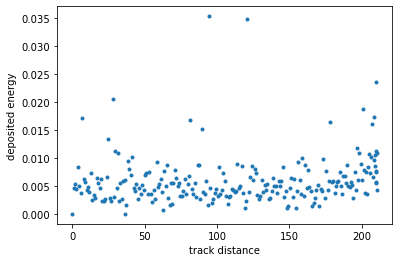

(48000425, 'e-')


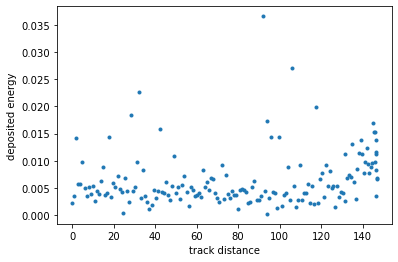

(48000426, 'e+')


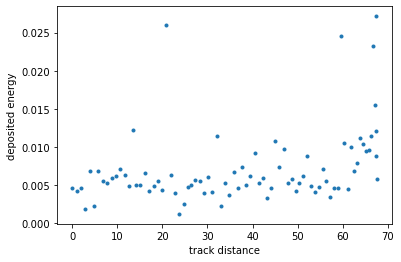

(48000426, 'e-')


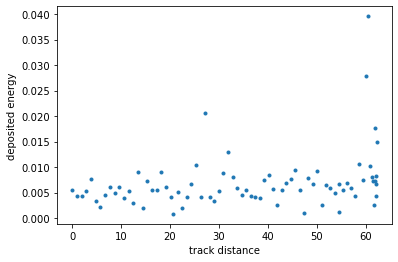

(48000427, 'e-')


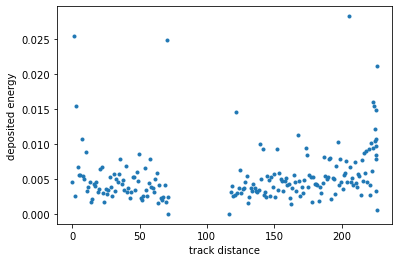

(48000428, 'e-')


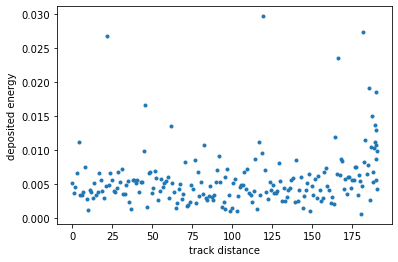

(48000429, 'e-')


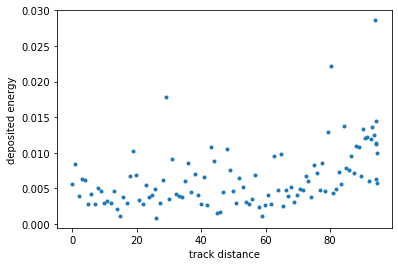

(48000430, 'e-')


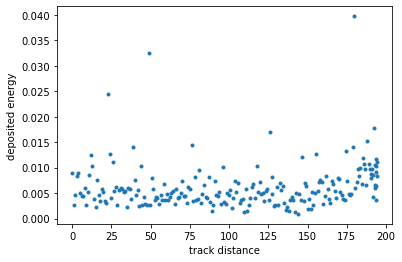

(48000431, 'e-')


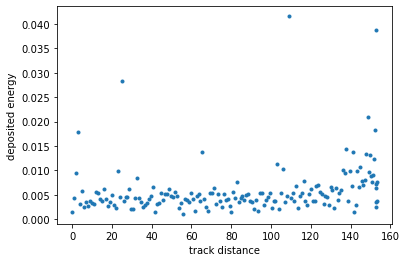

(48000432, 'e-')


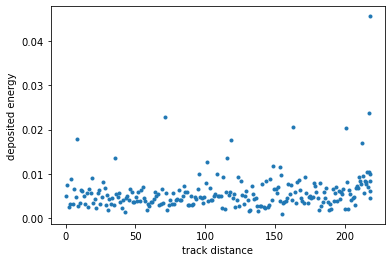

(48000433, 'e+')


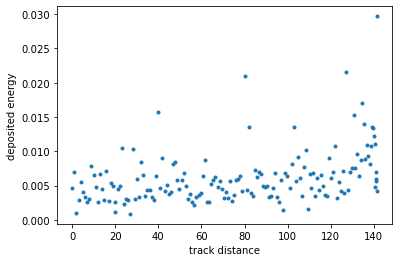

(48000433, 'e-')


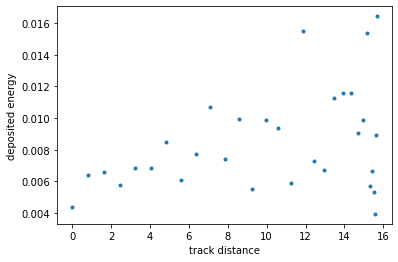

(48000434, 'e-')


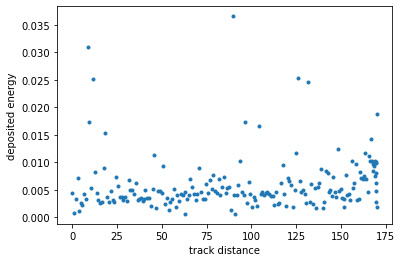

(48000435, 'e-')


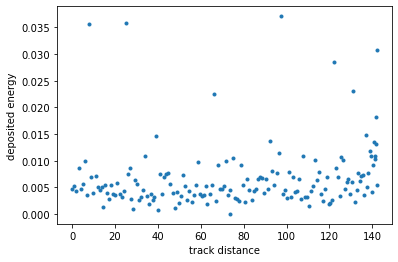

(48000436, 'e-')


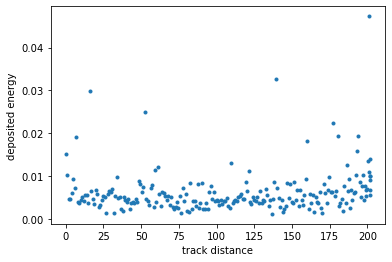

(48000437, 'e-')


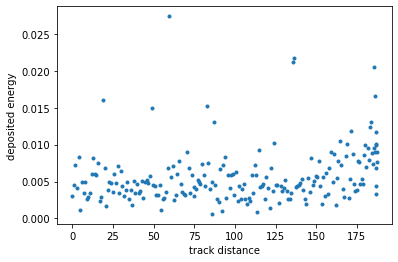

(48000439, 'e-')


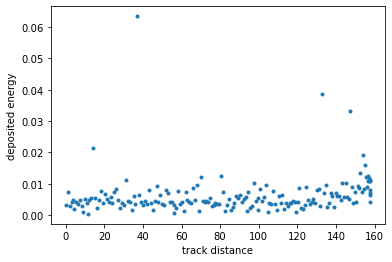

(48000440, 'e-')


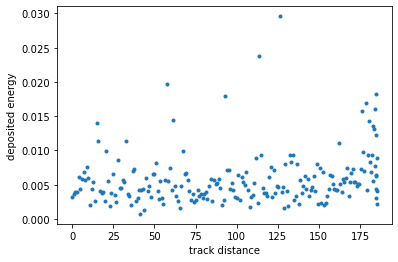

(48000441, 'e-')


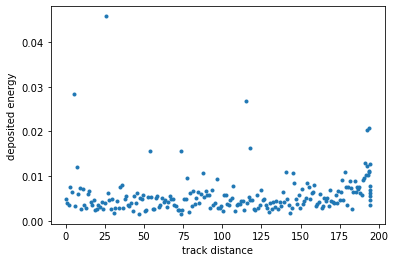

(48000442, 'e-')


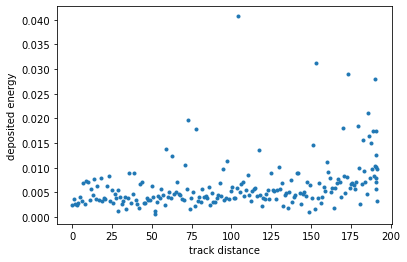

(48000443, 'e+')


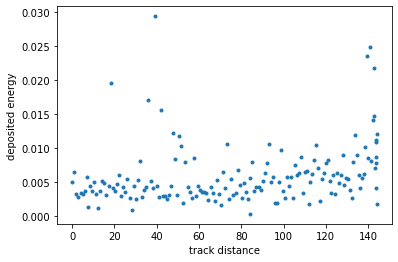

(48000443, 'e-')


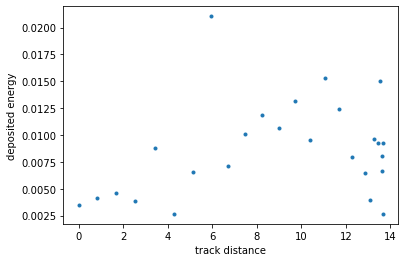

(48000444, 'e+')


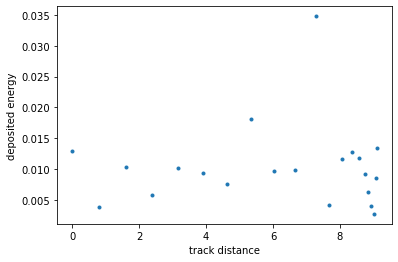

(48000444, 'e-')


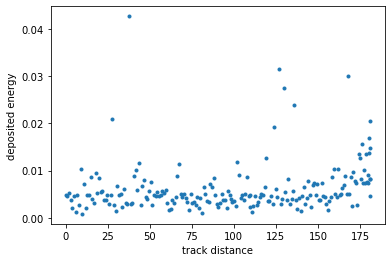

(48000445, 'e-')


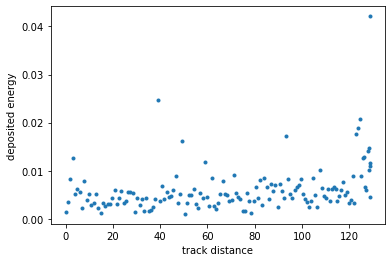

(48000446, 'e-')


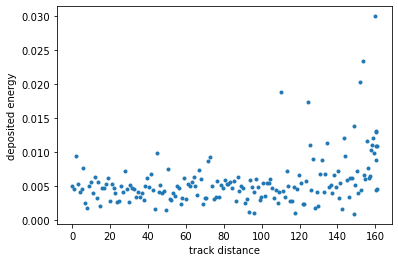

(48000447, 'e-')


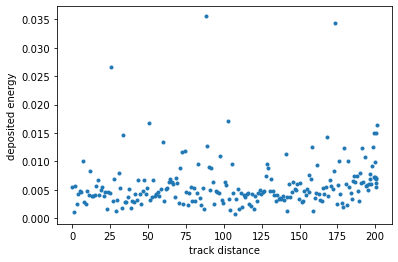

(48000448, 'e-')


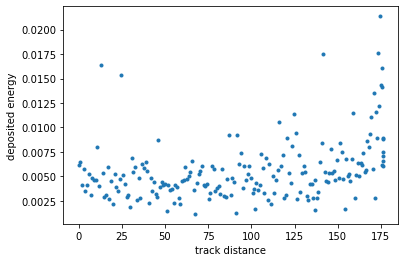

(48000449, 'e-')


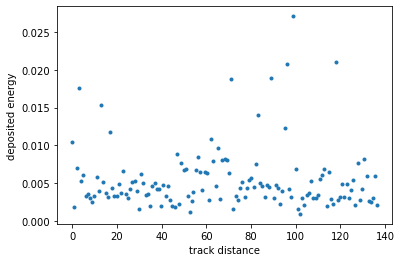

(48000450, 'e+')


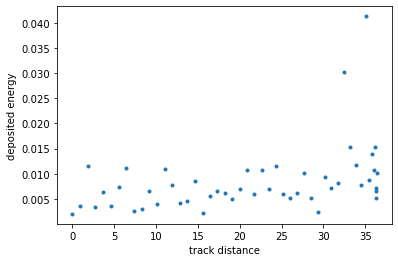

(48000450, 'e-')


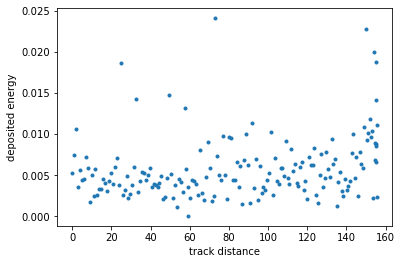

(48000451, 'e+')


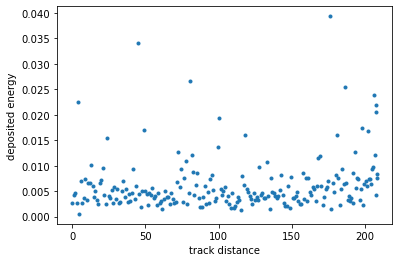

(48000451, 'e-')


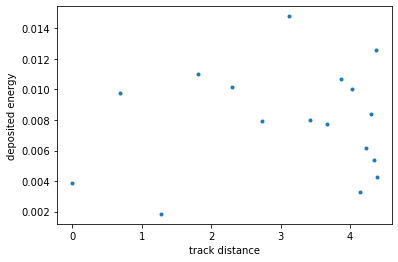

(48000452, 'e-')


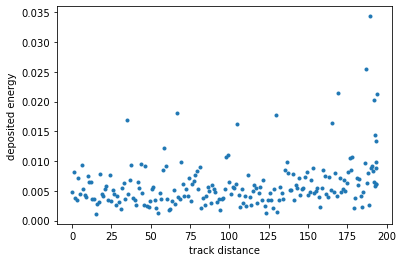

(48000453, 'e+')


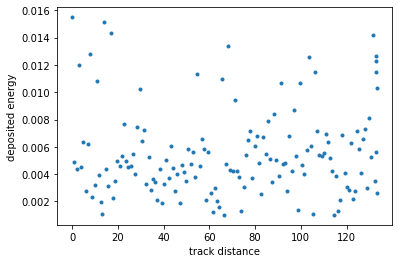

(48000453, 'e-')


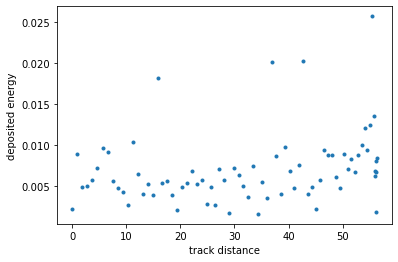

(48000454, 'e+')


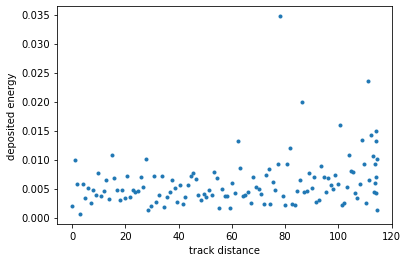

(48000454, 'e-')


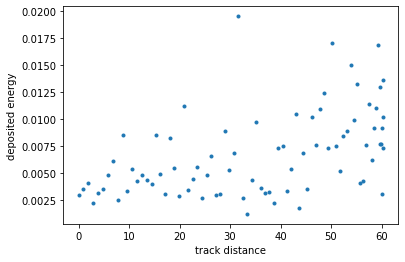

(48000455, 'e+')


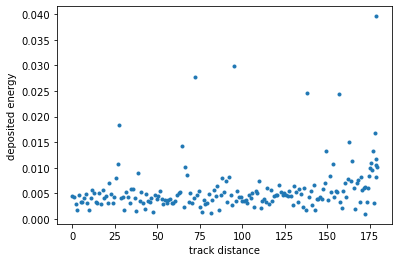

(48000455, 'e-')


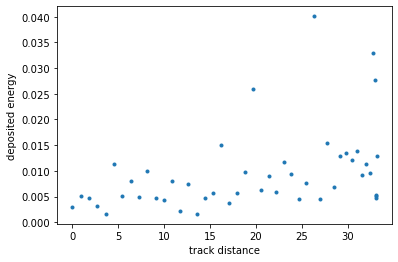

(48000457, 'e-')


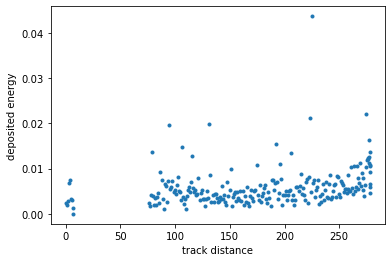

(48000458, 'e-')


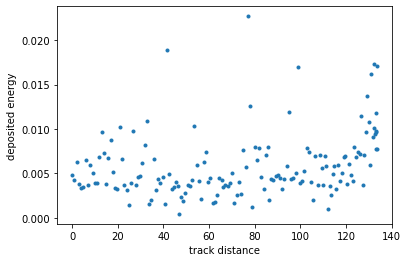

(48000459, 'e-')


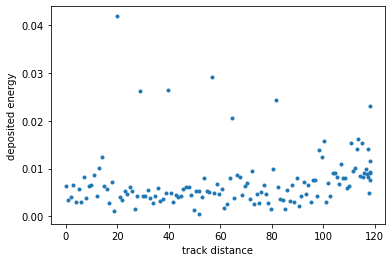

(48000460, 'e+')


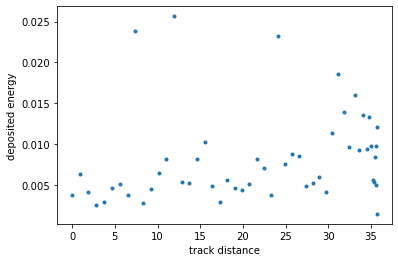

(48000460, 'e-')


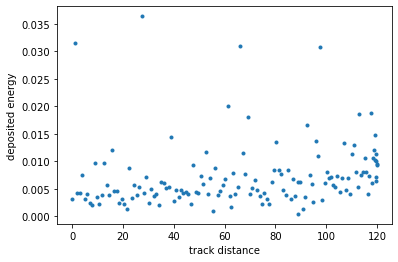

(48000461, 'e-')


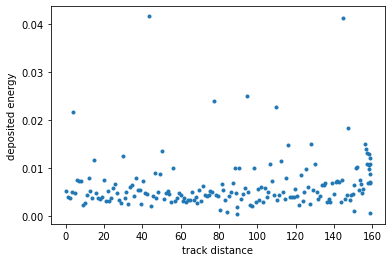

(48000462, 'e+')


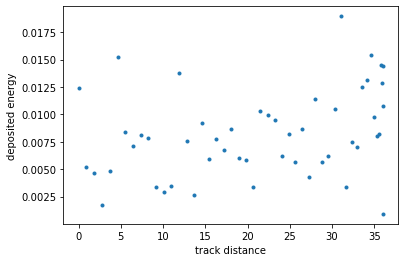

(48000462, 'e-')


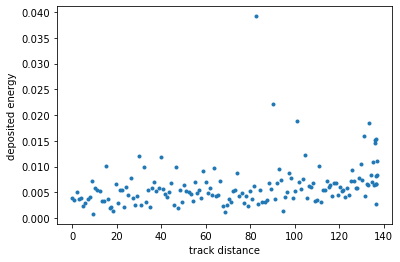

(48000464, 'e+')


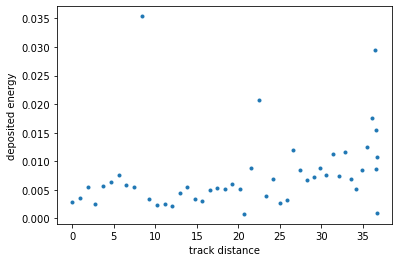

(48000464, 'e-')


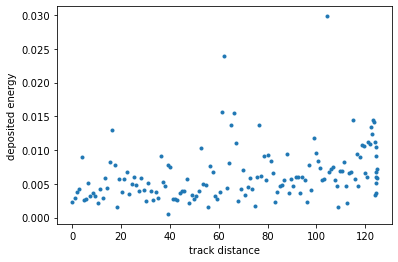

(48000465, 'e-')


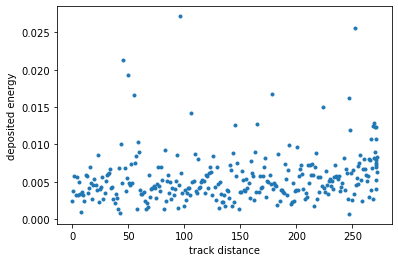

(48000466, 'e-')


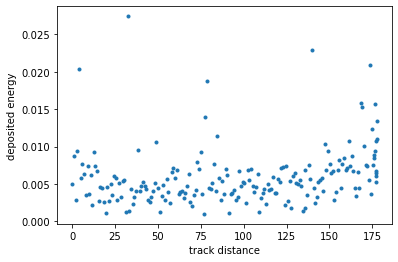

(48000467, 'e-')


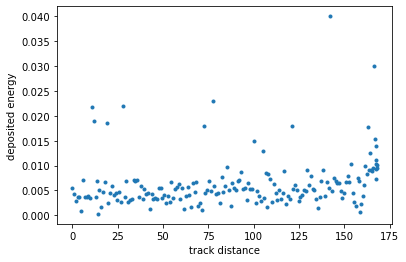

(48000468, 'e-')


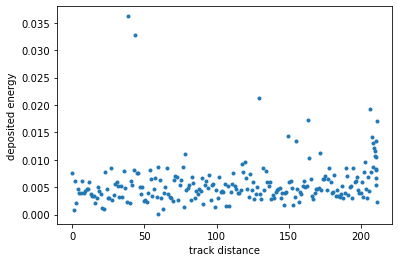

(48000469, 'e+')


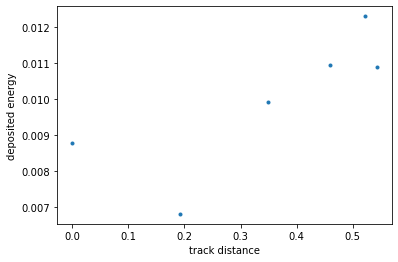

(48000469, 'e-')


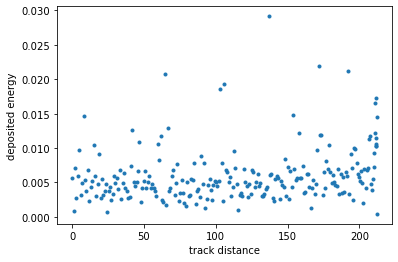

(48000470, 'e+')


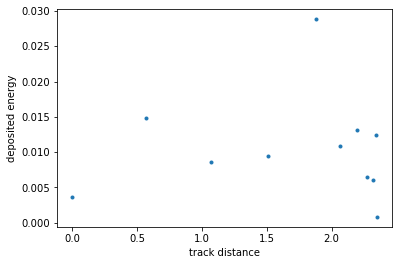

(48000470, 'e-')


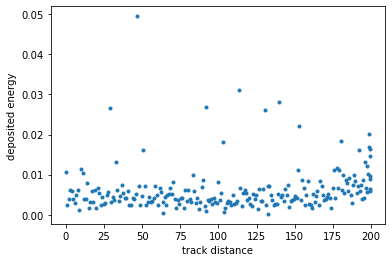

(48000471, 'e+')


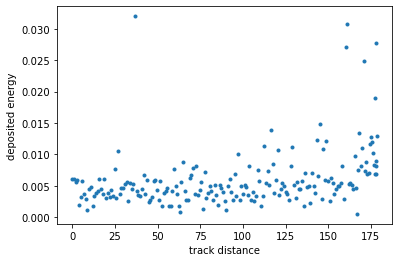

(48000471, 'e-')


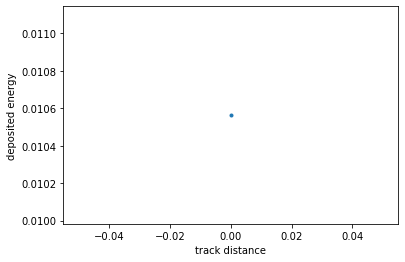

(48000472, 'e+')


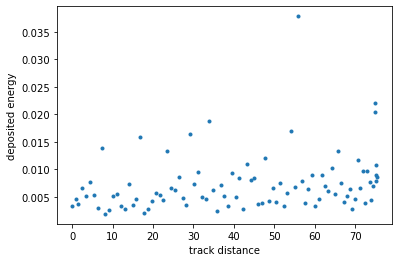

(48000472, 'e-')


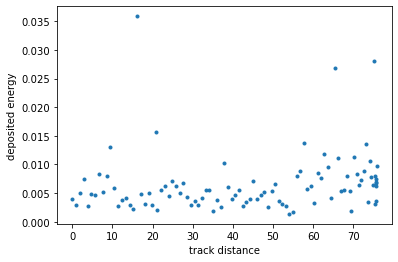

(48000473, 'e-')


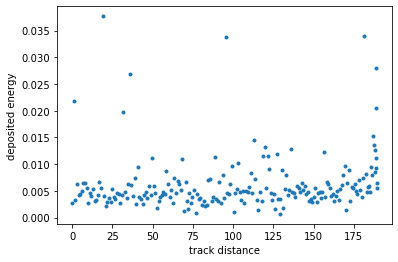

(48000474, 'e+')


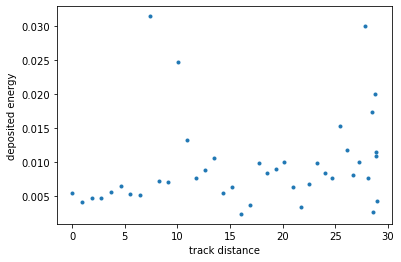

(48000474, 'e-')


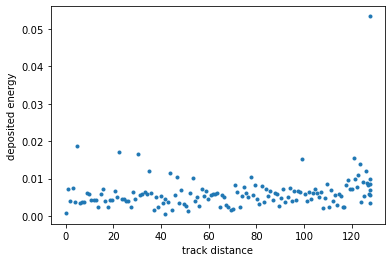

(48000475, 'e-')


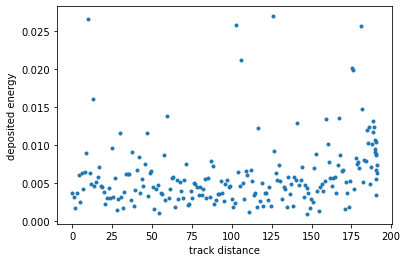

(48000476, 'e-')


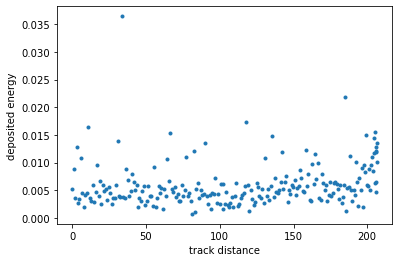

(48000477, 'e+')


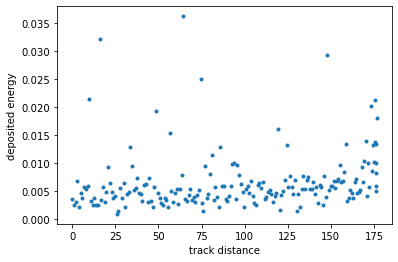

(48000477, 'e-')


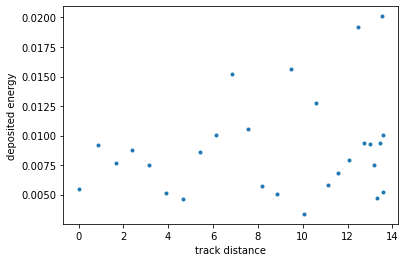

(48000478, 'e-')


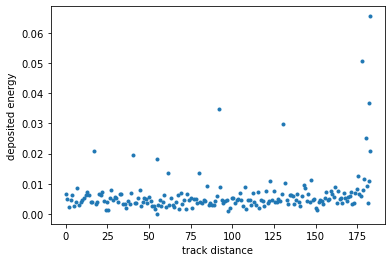

(48000479, 'e-')


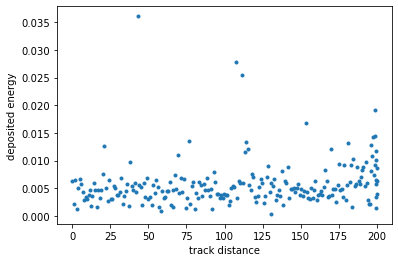

(48000480, 'e-')


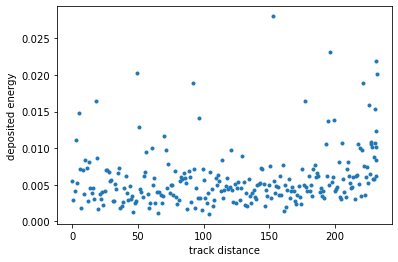

(48000481, 'e-')


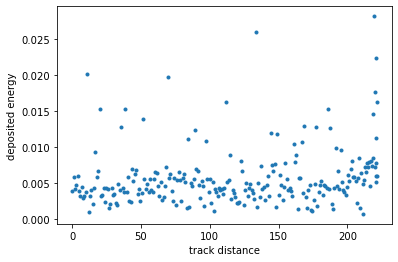

(48000482, 'e+')


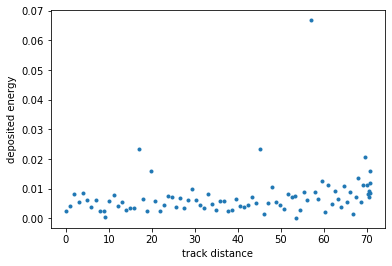

(48000482, 'e-')


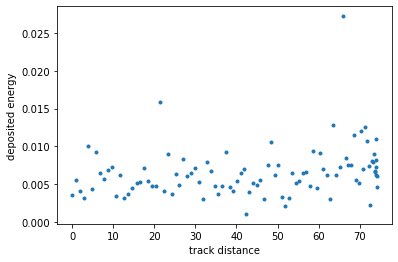

(48000483, 'e+')


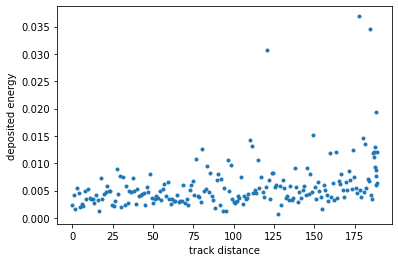

(48000483, 'e-')


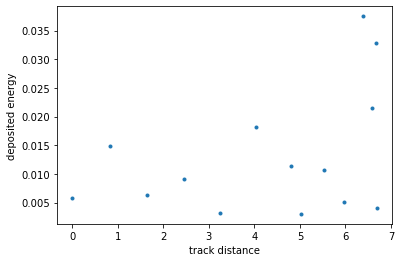

(48000484, 'e-')


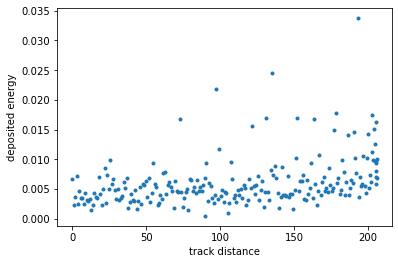

(48000485, 'e-')


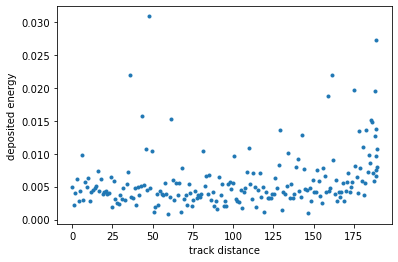

(48000486, 'e-')


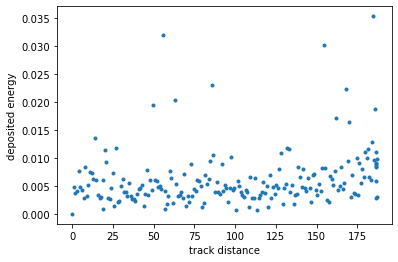

(48000487, 'e-')


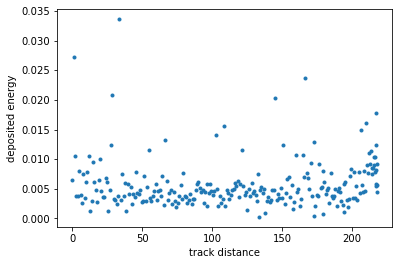

(48000488, 'e-')


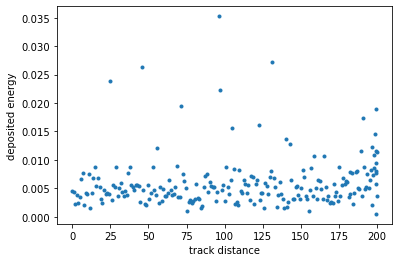

(48000489, 'e+')


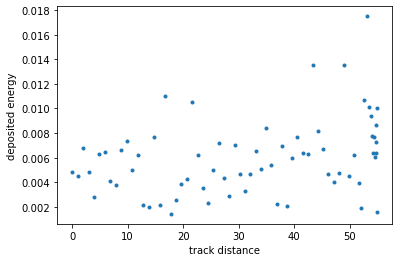

(48000489, 'e-')


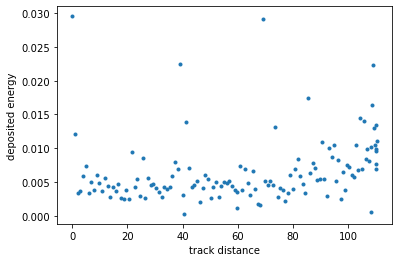

(48000490, 'e-')


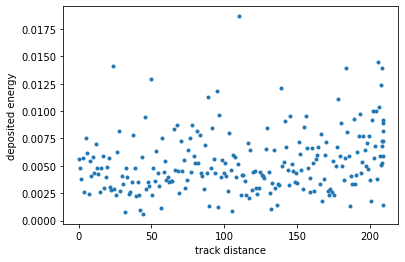

(48000491, 'e-')


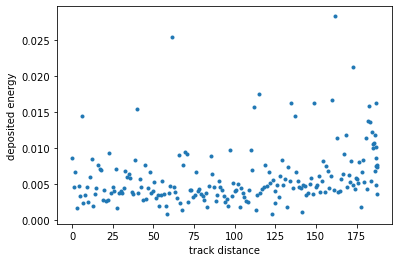

(48000492, 'e-')


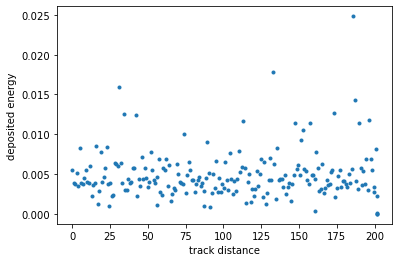

(48000493, 'e-')


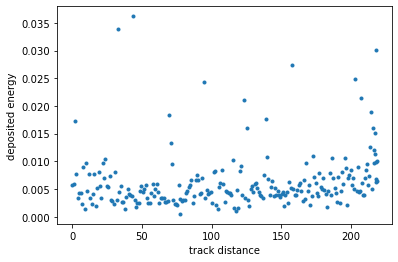

(48000494, 'e+')


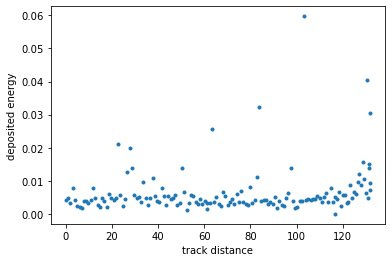

(48000494, 'e-')


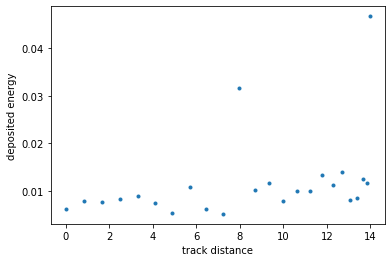

(48000495, 'e-')


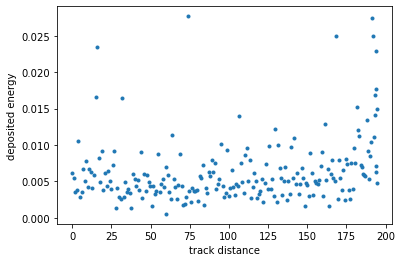

(48000496, 'e-')


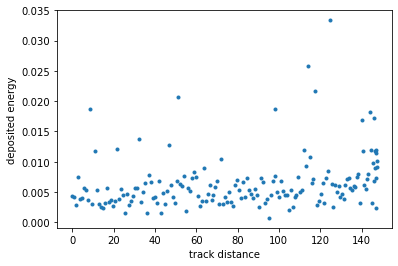

(48000497, 'e-')


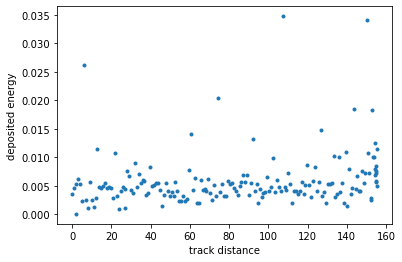

(48000498, 'e-')


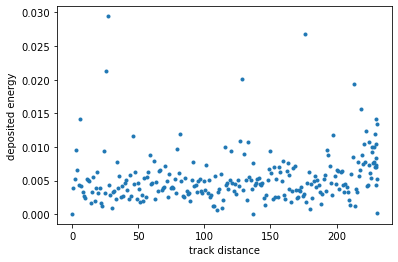

(48000499, 'e-')


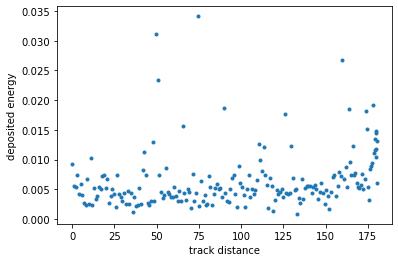

(48000500, 'e-')


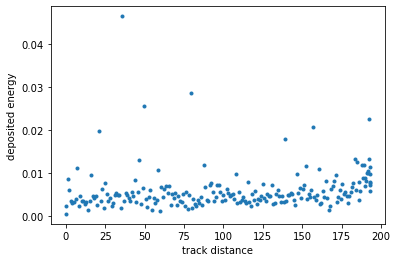

(48000501, 'e+')


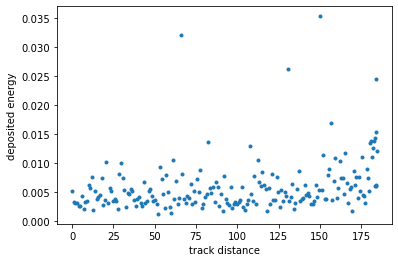

(48000501, 'e-')


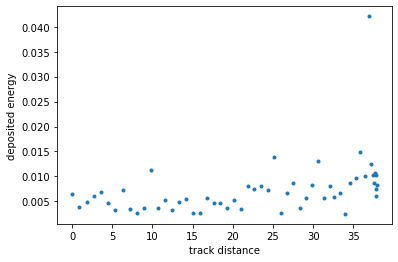

(48000502, 'e-')


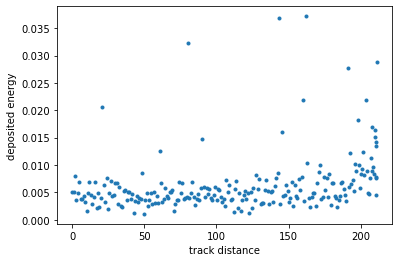

(48000503, 'e-')


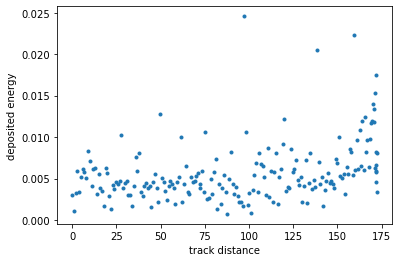

(48000504, 'e-')


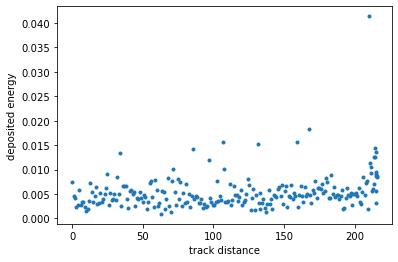

(48000505, 'e-')


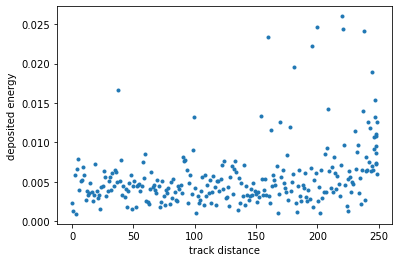

(48000506, 'e-')


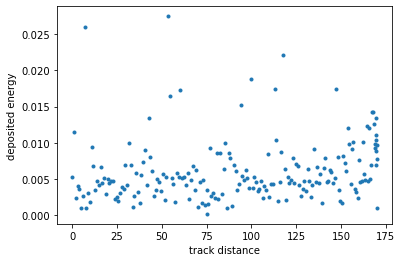

(48000507, 'e-')


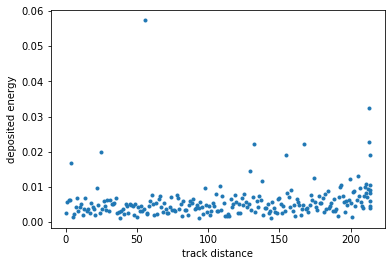

(48000508, 'e+')


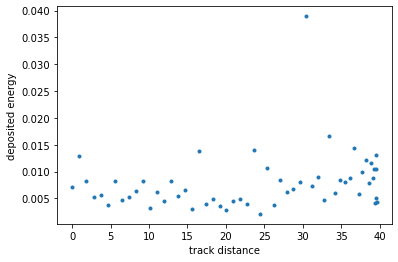

(48000508, 'e-')


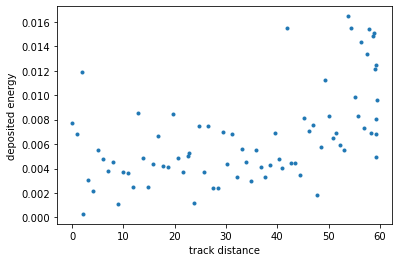

(48000509, 'e+')


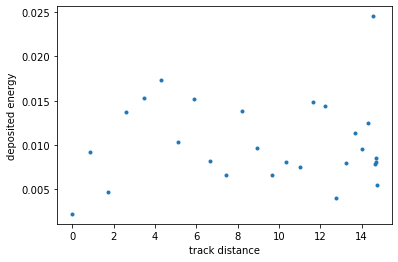

(48000509, 'e-')


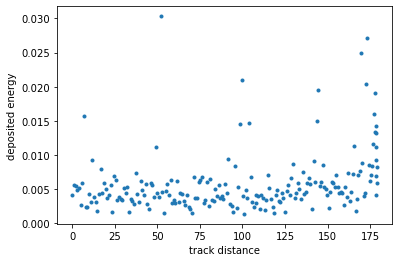

(48000510, 'e+')


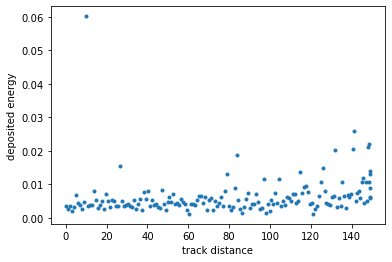

(48000510, 'e-')


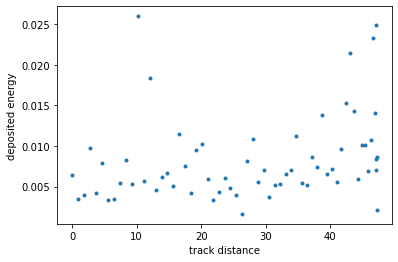

(48000511, 'e-')


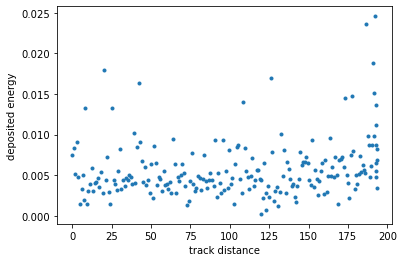

(48000512, 'e-')


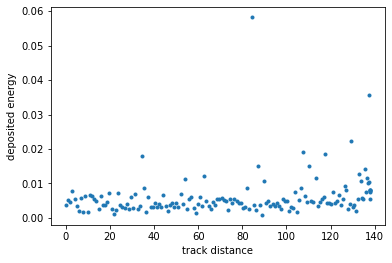

(48000513, 'e-')


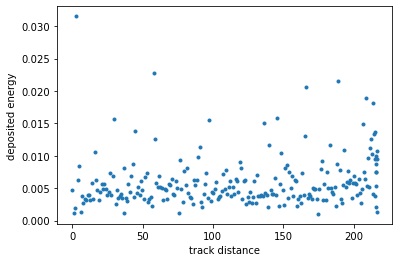

(48000514, 'e-')


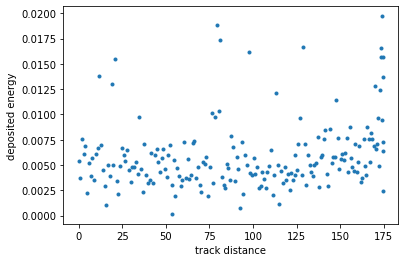

(48000515, 'e-')


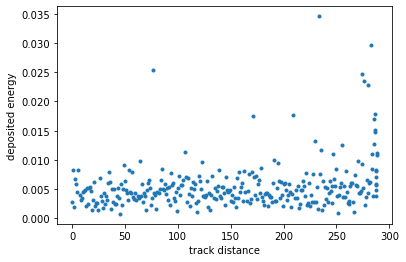

(48000516, 'e-')


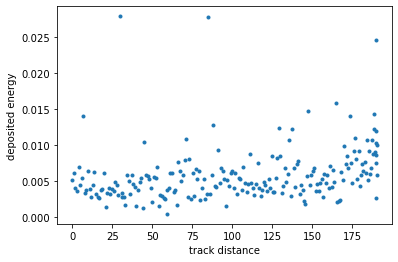

(48000517, 'e-')


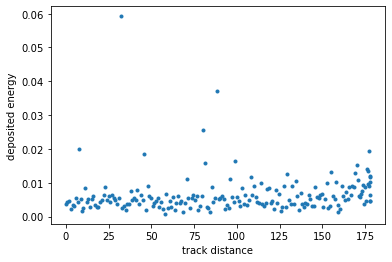

(48000518, 'e-')


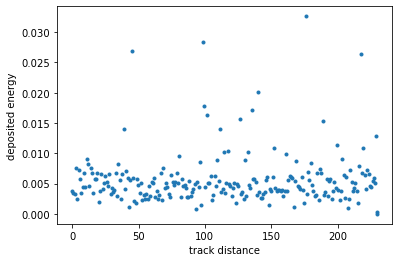

(48000519, 'e-')


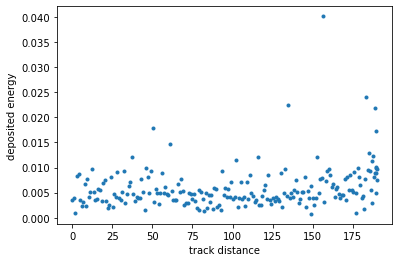

(48000520, 'e-')


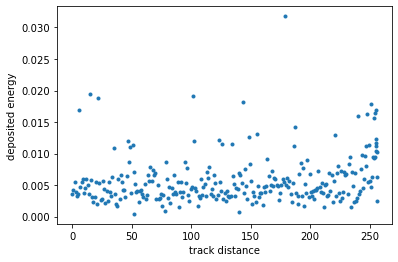

(48000521, 'e-')


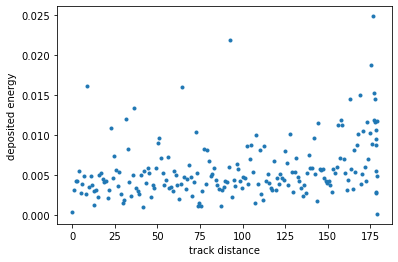

(48000522, 'e-')


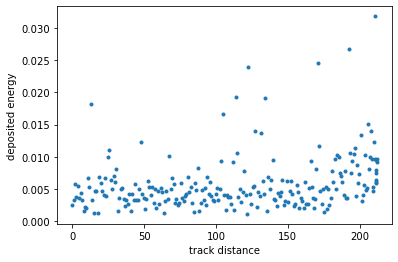

(48000523, 'e-')


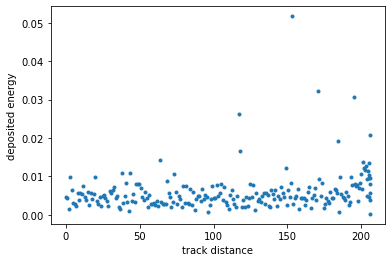

(48000524, 'e+')


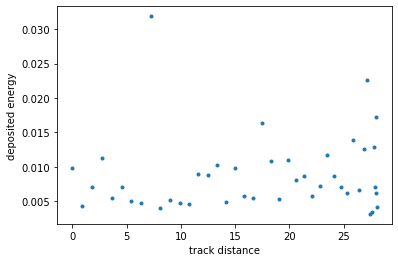

(48000524, 'e-')


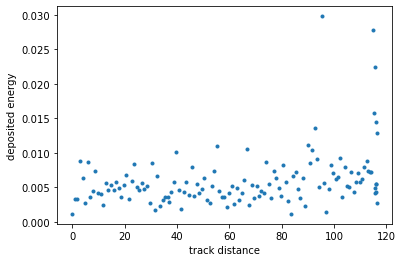

(48000525, 'e+')


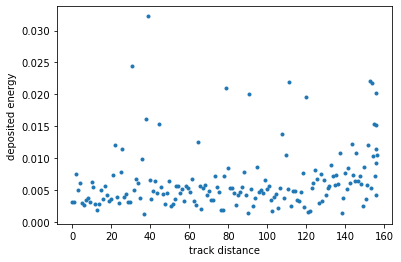

(48000525, 'e-')


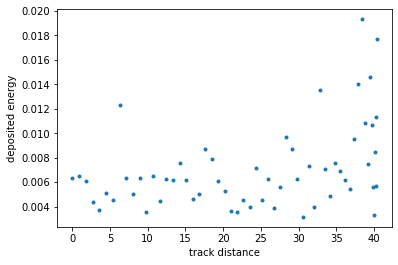

(48000526, 'e+')


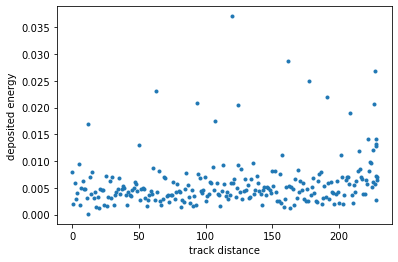

(48000526, 'e-')


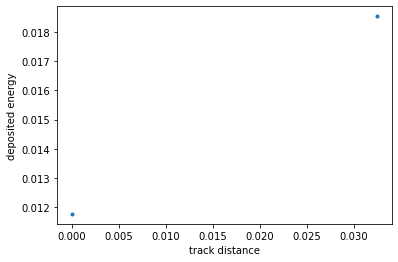

(48000527, 'e-')


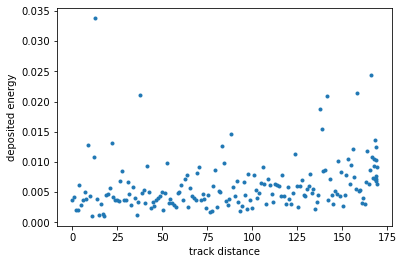

(48000528, 'e+')


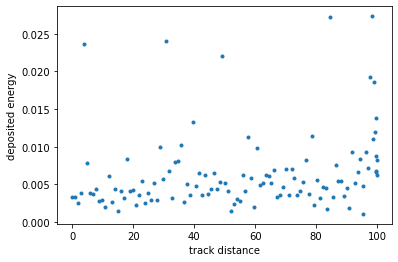

(48000528, 'e-')


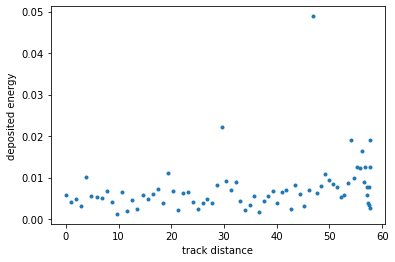

(48000529, 'e-')


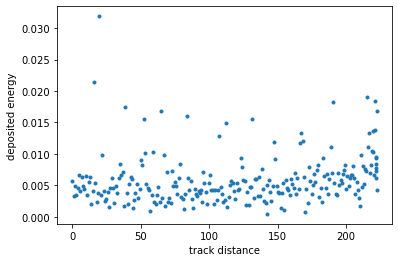

(48000530, 'e-')


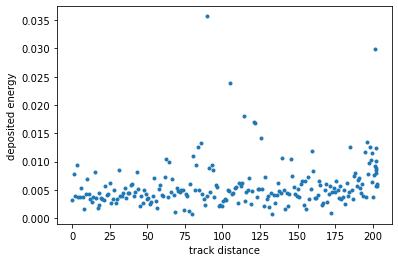

(48000531, 'e-')


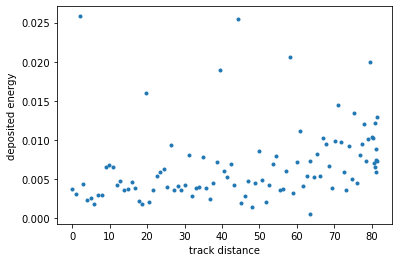

(48000532, 'e-')


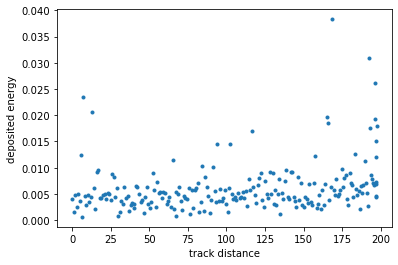

(48000533, 'e-')


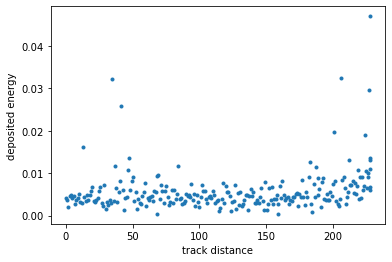

(48000535, 'e-')


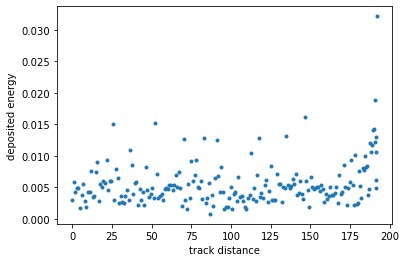

(48000536, 'e-')


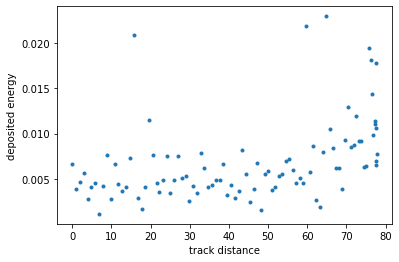

(48000537, 'e-')


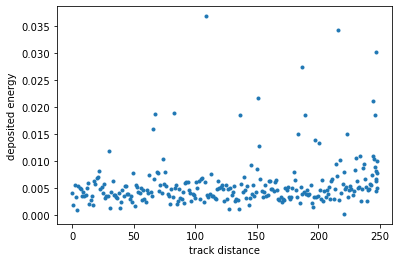

(48000538, 'e+')


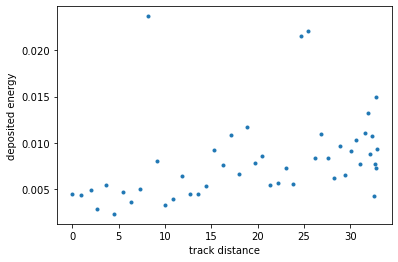

(48000538, 'e-')


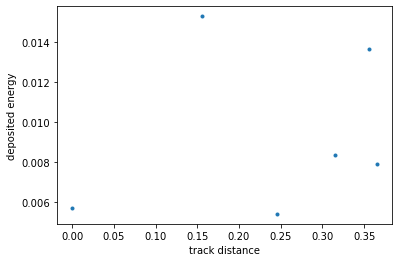

(48000539, 'e-')


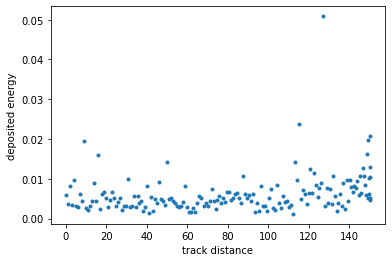

(48000540, 'e-')


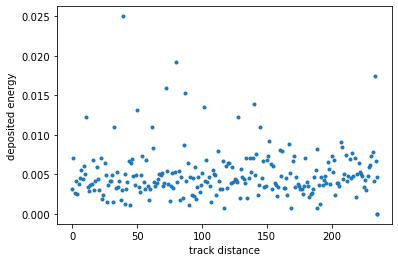

(48000541, 'e-')


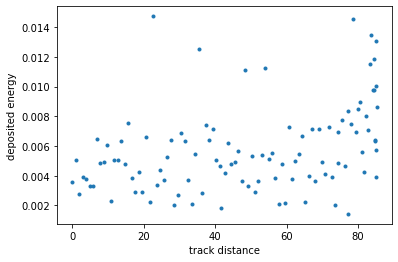

(48000542, 'e-')


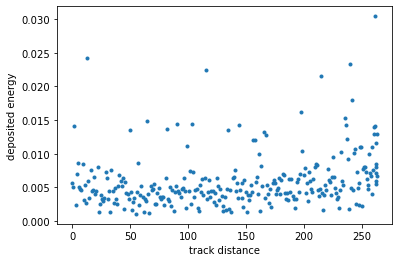

(48000543, 'e-')


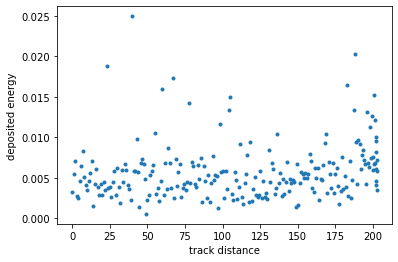

(48000544, 'e+')


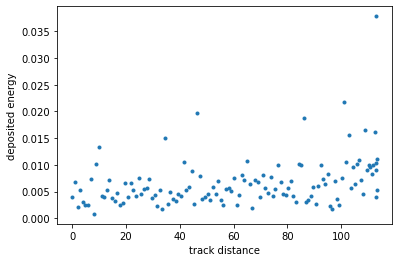

(48000544, 'e-')


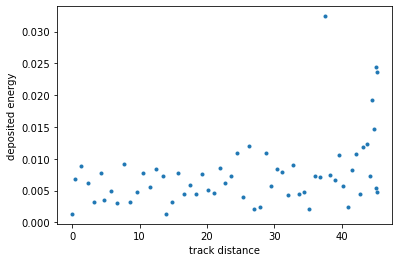

(48000545, 'e+')


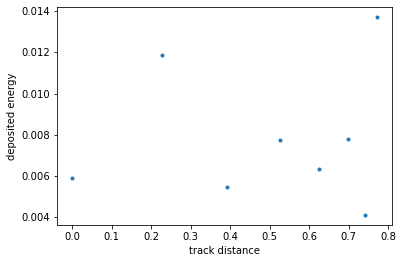

(48000545, 'e-')


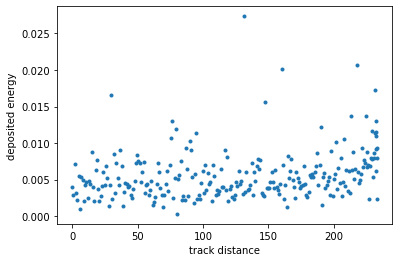

(48000546, 'e-')


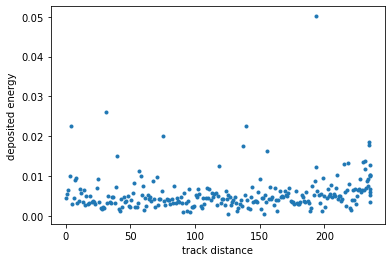

(48000547, 'e-')


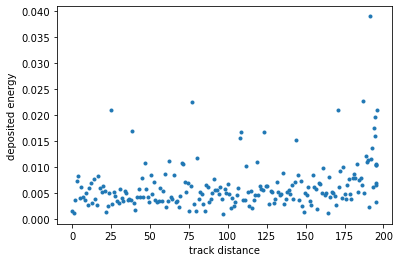

(48000548, 'e+')


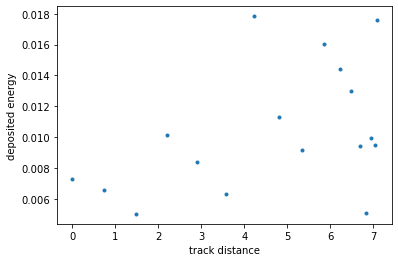

(48000548, 'e-')


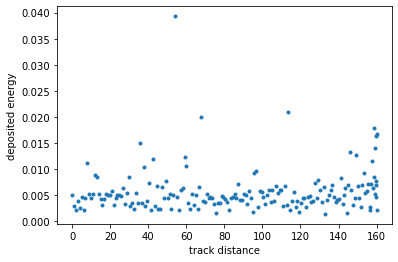

(48000549, 'e+')


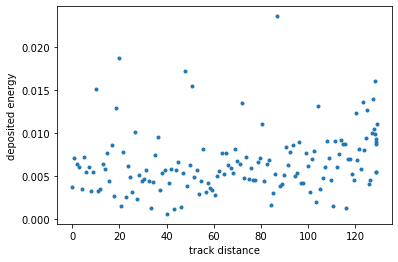

(48000549, 'e-')


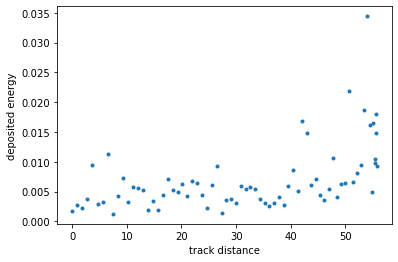

(48000550, 'e-')


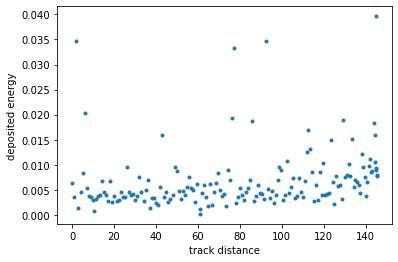

(48000551, 'e+')


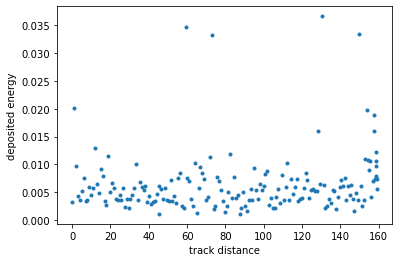

(48000551, 'e-')


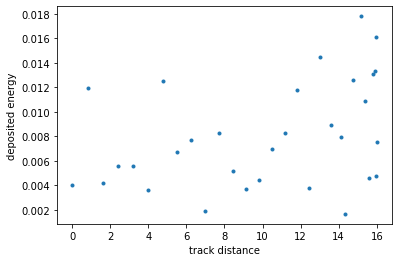

(48000552, 'e+')


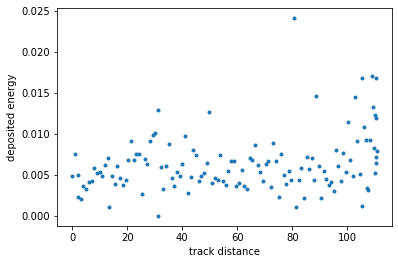

(48000552, 'e-')


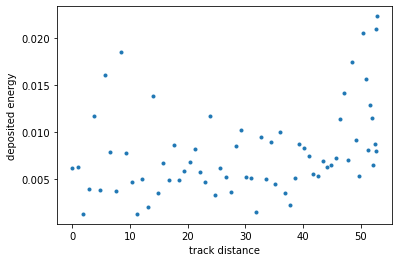

(48000553, 'e+')


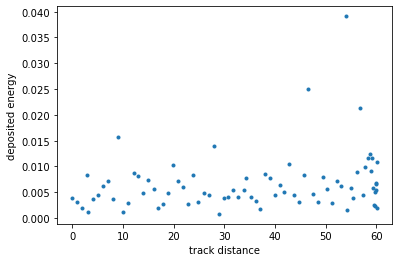

(48000553, 'e-')


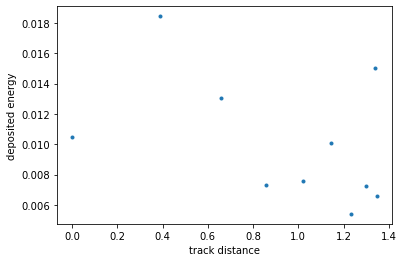

(48000554, 'e-')


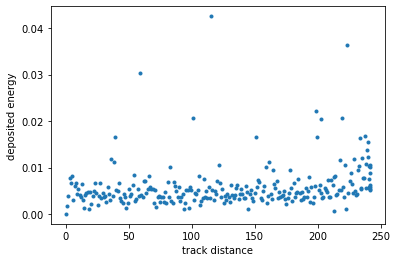

(48000555, 'e+')


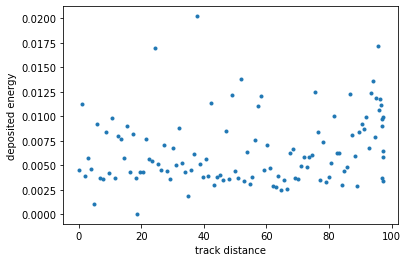

(48000555, 'e-')


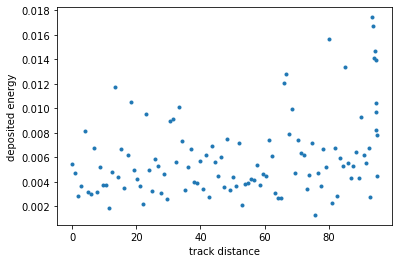

(48000556, 'e-')


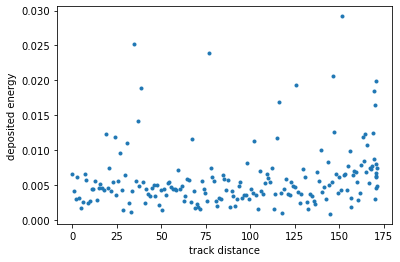

(48000557, 'e-')


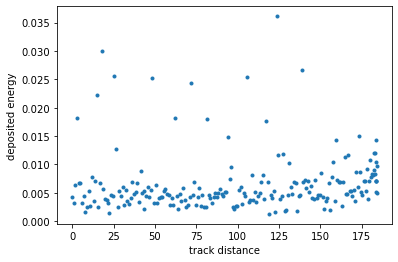

(48000558, 'e-')


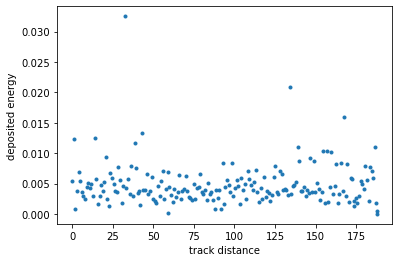

(48000559, 'e+')


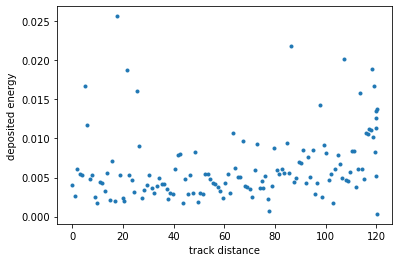

(48000559, 'e-')


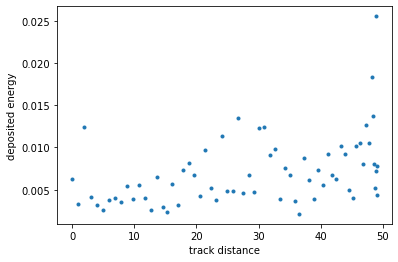

(48000560, 'e-')


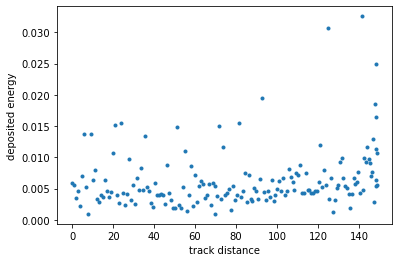

(48000561, 'e+')


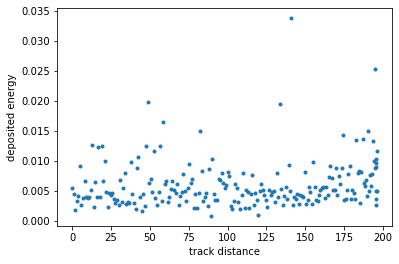

(48000561, 'e-')


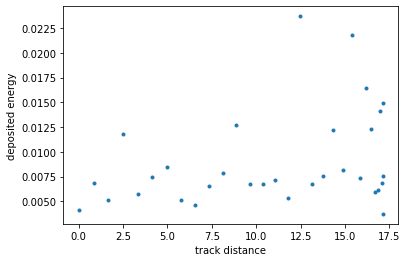

(48000562, 'e-')


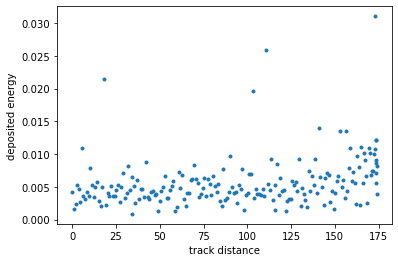

(48000563, 'e+')


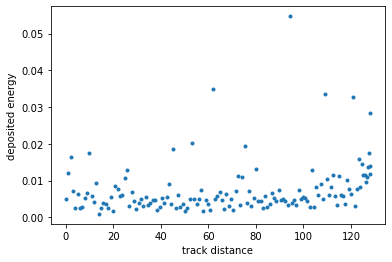

(48000563, 'e-')


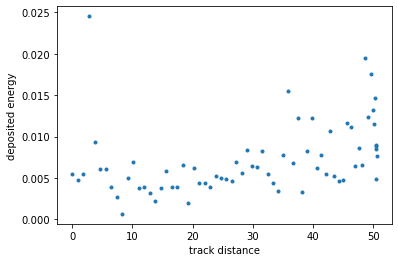

(48000564, 'e+')


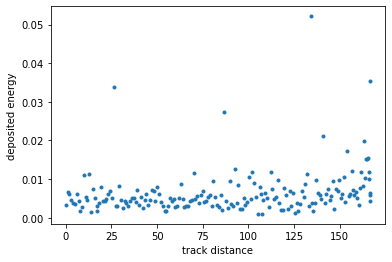

(48000564, 'e-')


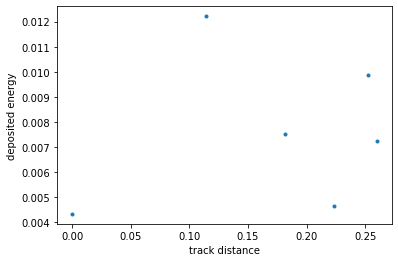

(48000565, 'e-')


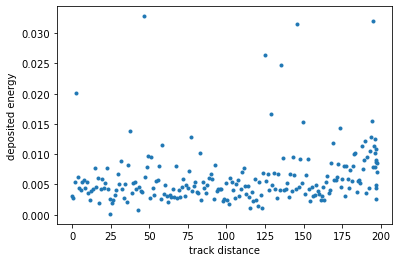

(48000566, 'e+')


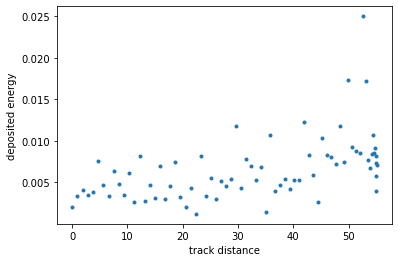

(48000566, 'e-')


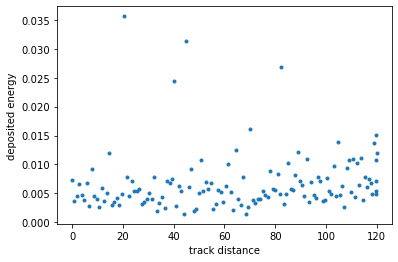

(48000568, 'e-')


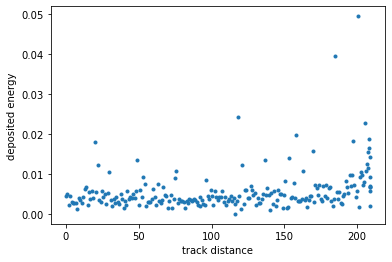

(48000569, 'e-')


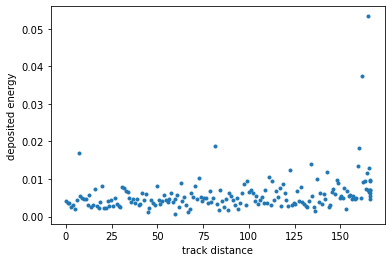

(48000570, 'e-')


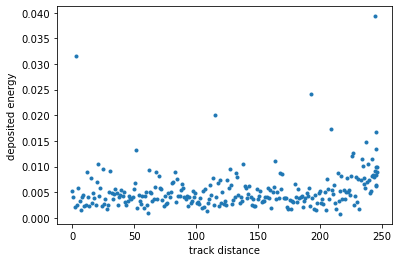

(48000571, 'e-')


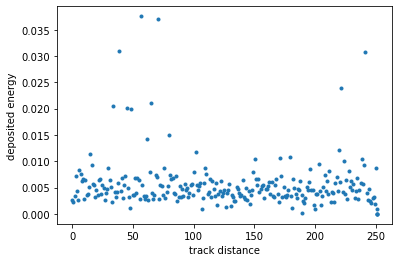

(48000572, 'e-')


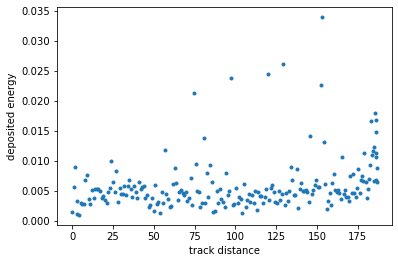

(48000573, 'e+')


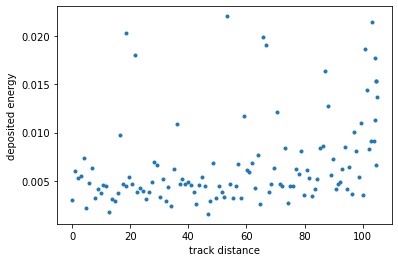

(48000573, 'e-')


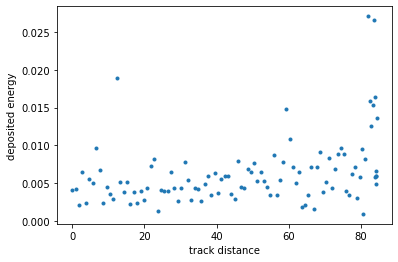

(48000574, 'e+')


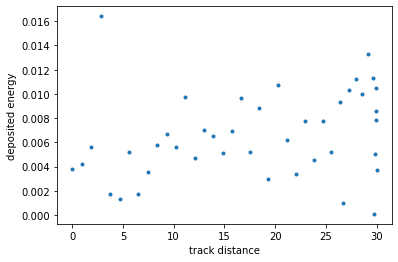

(48000574, 'e-')


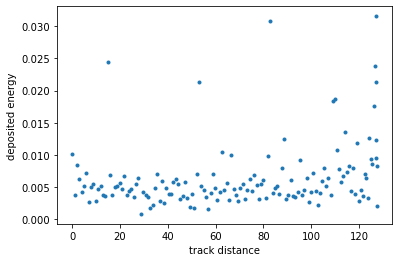

(48000575, 'e-')


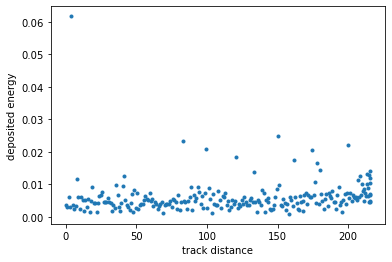

(48000576, 'e-')


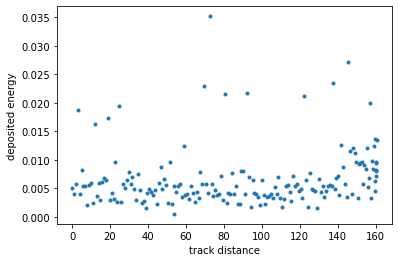

(48000577, 'e-')


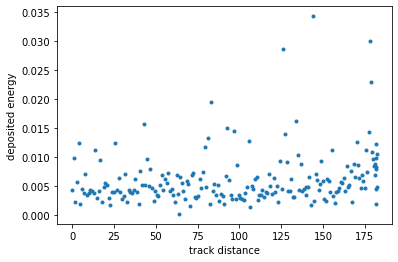

(48000578, 'e+')


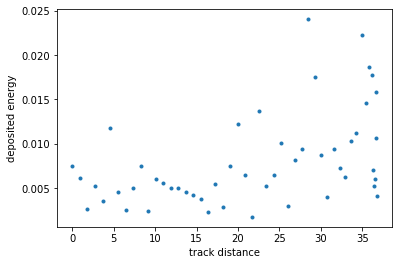

(48000578, 'e-')


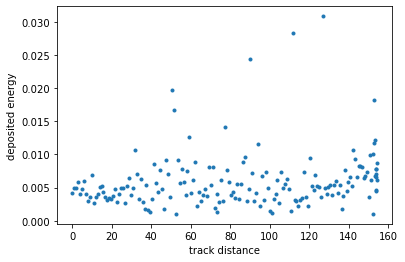

(48000579, 'e-')


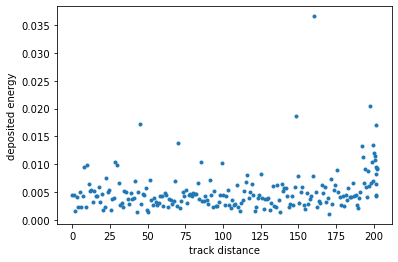

(48000580, 'e-')


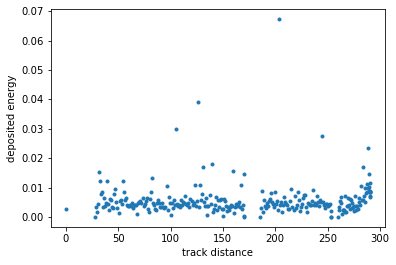

(48000581, 'e-')


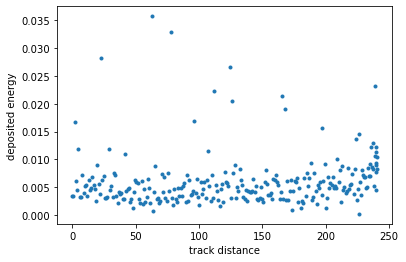

(48000582, 'e-')


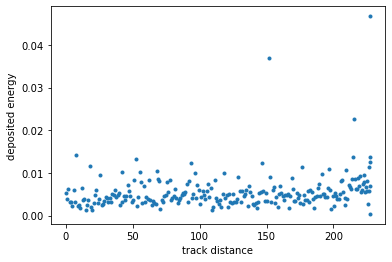

(48000583, 'e+')


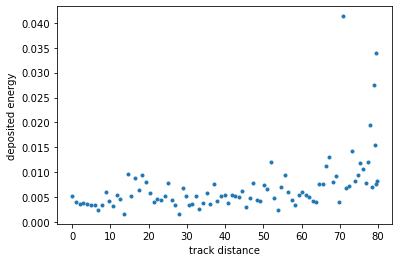

(48000583, 'e-')


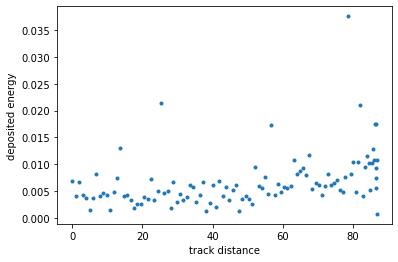

(48000584, 'e-')


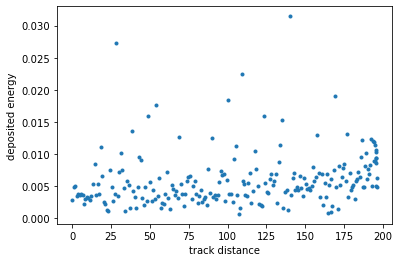

(48000585, 'e-')


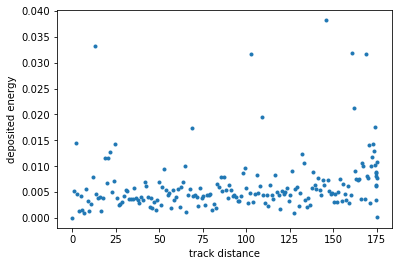

(48000586, 'e-')


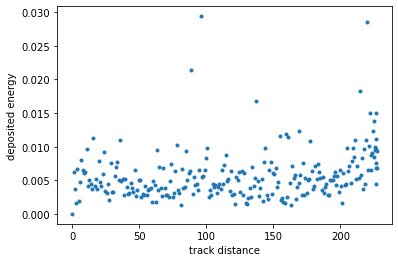

(48000587, 'e+')


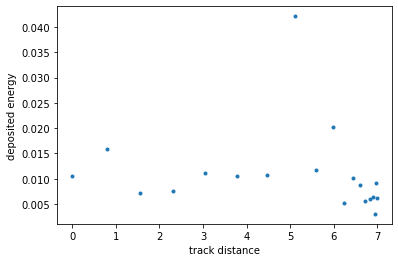

(48000587, 'e-')


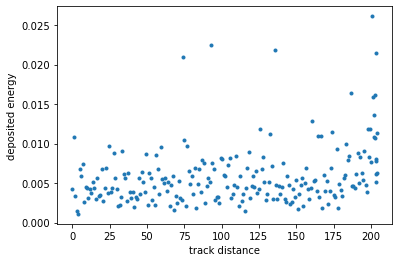

(48000588, 'e-')


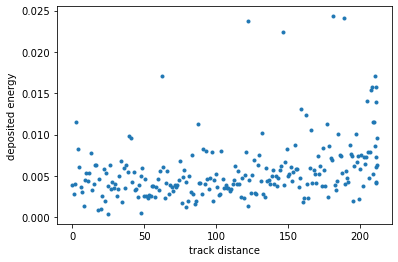

(48000590, 'e-')


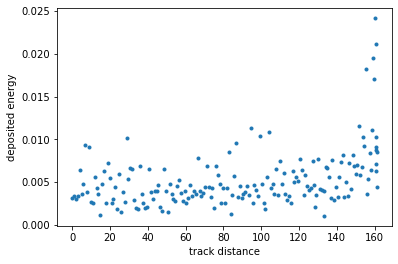

(48000591, 'e-')


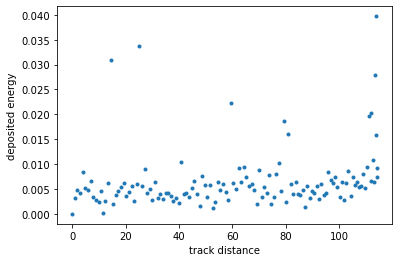

(48000592, 'e+')


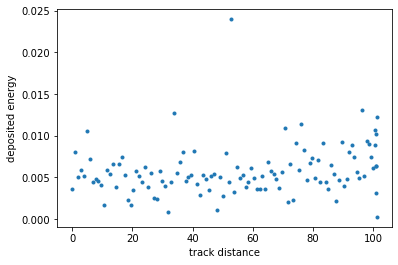

(48000592, 'e-')


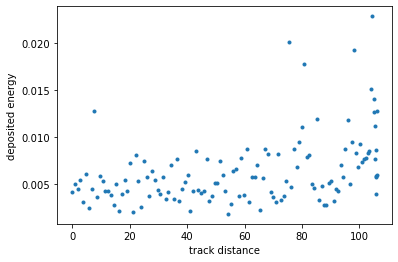

(48000593, 'e-')


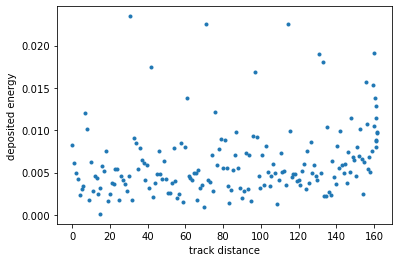

(48000595, 'e+')


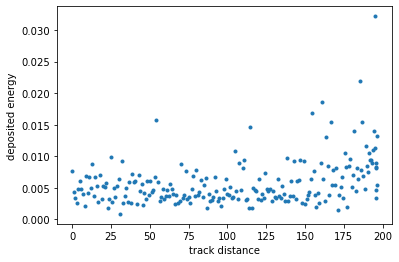

(48000595, 'e-')


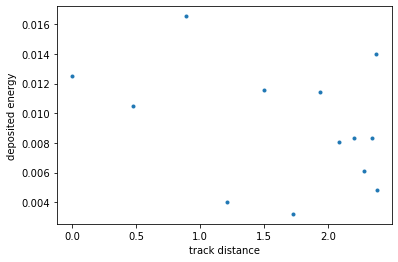

(48000596, 'e-')


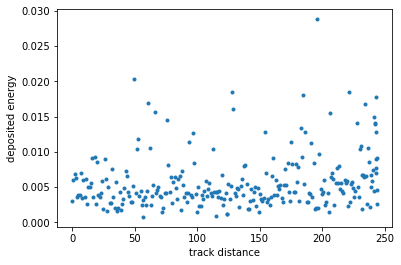

(48000597, 'e-')


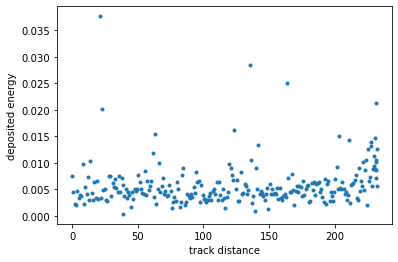

In [17]:
for event_id, df in track_hits.groupby(['event_id', 'particle_name']):
    print(event_id)

    distances, energies = df.cumdist, df.energy
    plt.plot(distances, energies, '.') 
    plt.xlabel('track distance')
    plt.ylabel('deposited energy')
    plt.show()

Sin embargo, histogramando se puede apreciar cierta diferencia

Vamos a dividir las trazas en el mismo número de porciones (indep de la longitud de trazas) para ver que se comportan como se comportan!!! y de acá lo siguiente...

(48000025, 'e-')


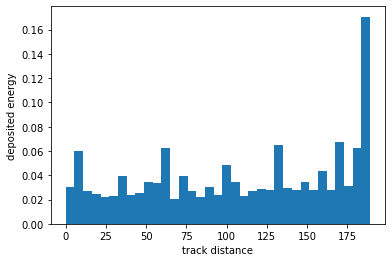

(48000026, 'e-')


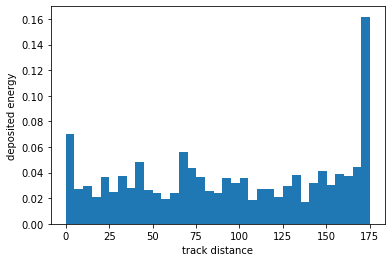

(48000027, 'e-')


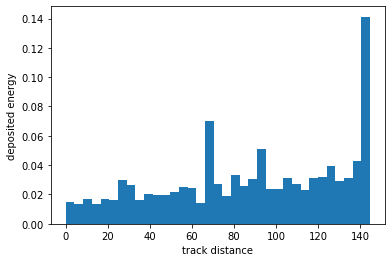

(48000028, 'e-')


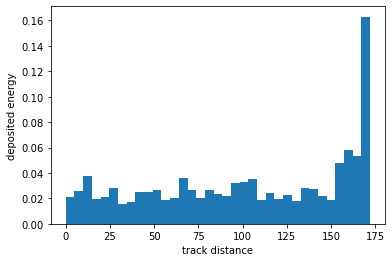

(48000030, 'e-')


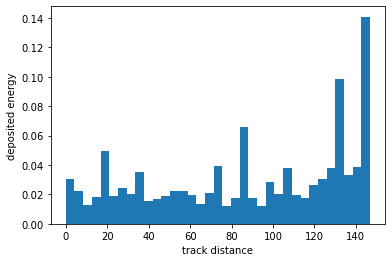

(48000031, 'e-')


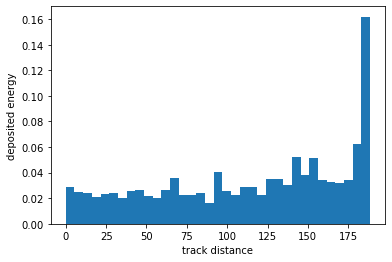

(48000032, 'e-')


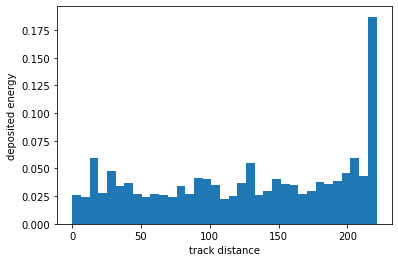

(48000033, 'e-')


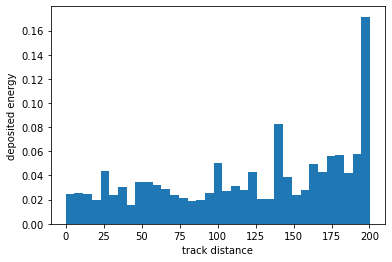

(48000034, 'e-')


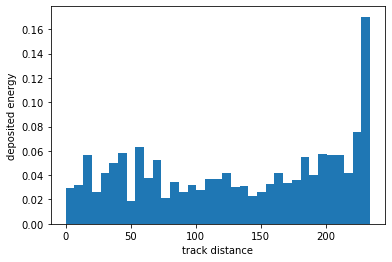

(48000035, 'e-')


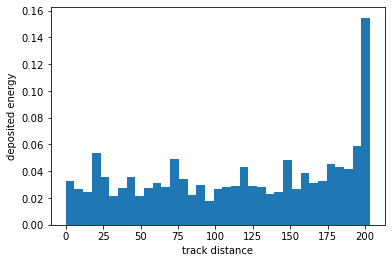

(48000036, 'e-')


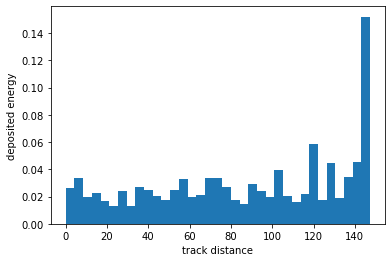

(48000037, 'e-')


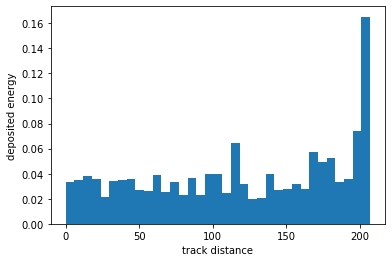

(48000038, 'e-')


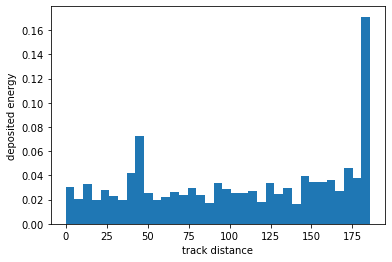

(48000039, 'e-')


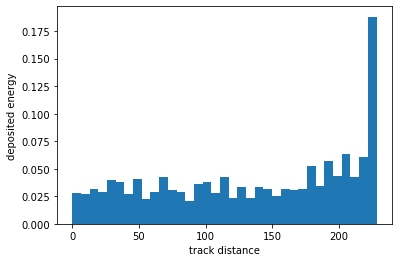

(48000040, 'e+')


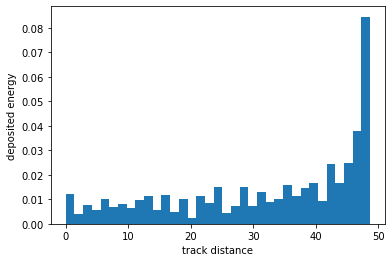

(48000040, 'e-')


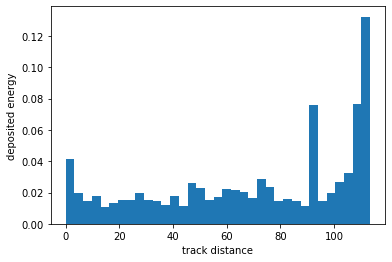

(48000041, 'e-')


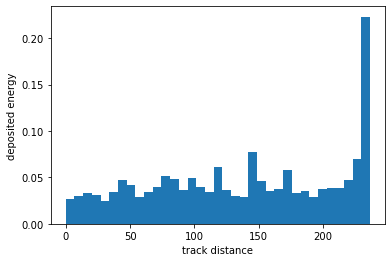

(48000042, 'e-')


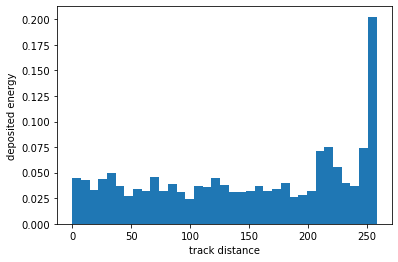

(48000043, 'e+')


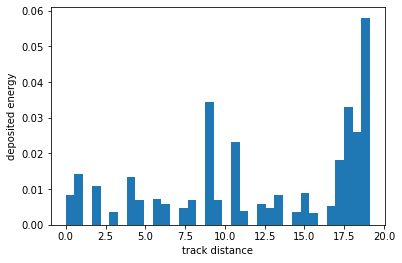

(48000043, 'e-')


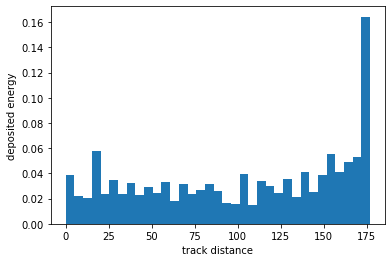

(48000044, 'e-')


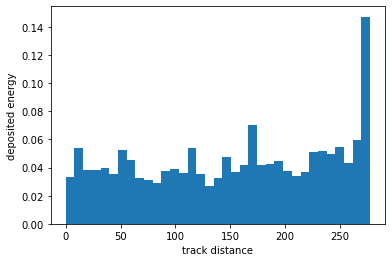

(48000045, 'e-')


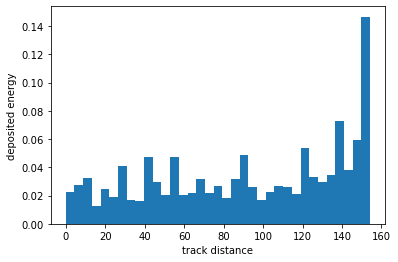

(48000046, 'e-')


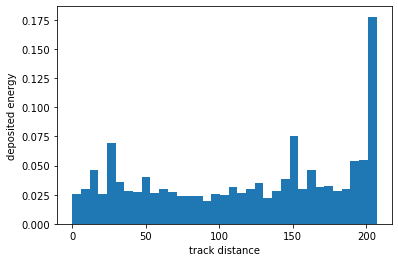

(48000047, 'e-')


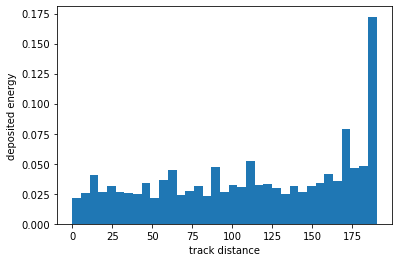

(48000048, 'e-')


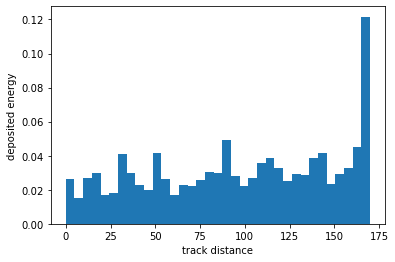

(48000049, 'e-')


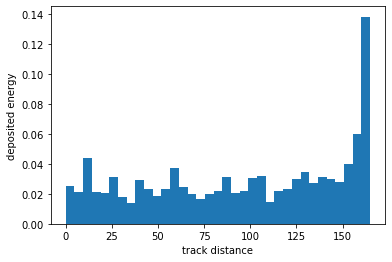

(48000050, 'e-')


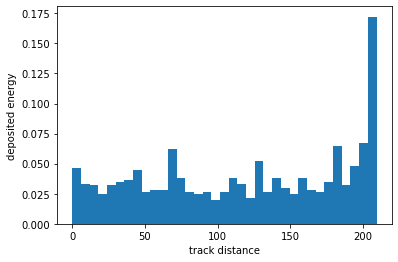

(48000051, 'e-')


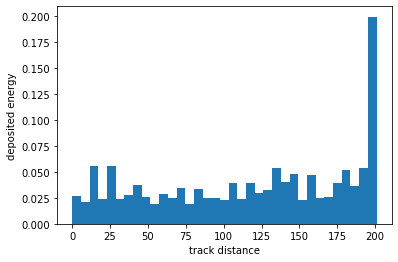

(48000052, 'e-')


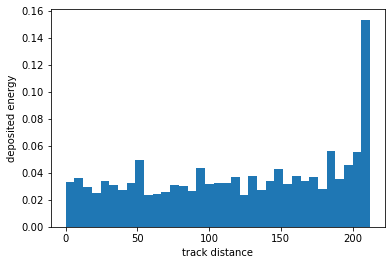

(48000053, 'e+')


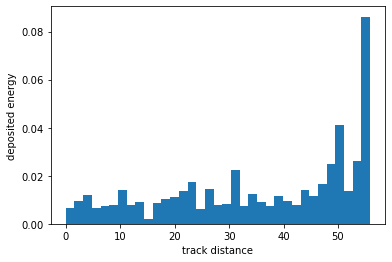

(48000053, 'e-')


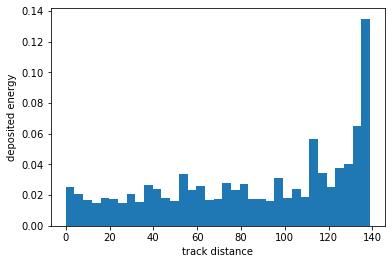

(48000054, 'e-')


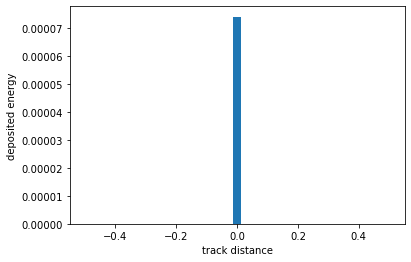

(48000055, 'e-')


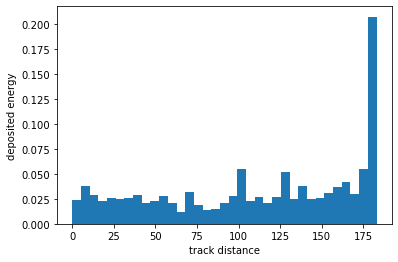

(48000056, 'e-')


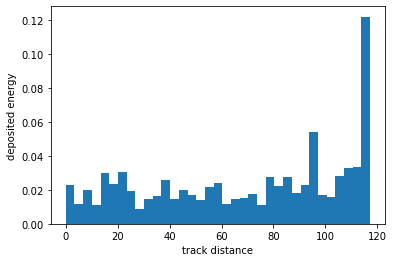

(48000057, 'e-')


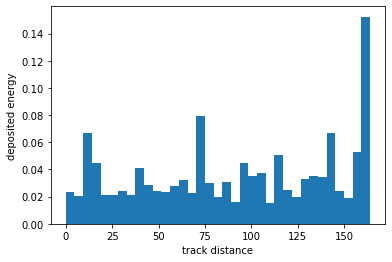

(48000058, 'e+')


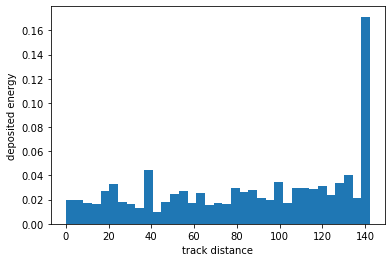

(48000058, 'e-')


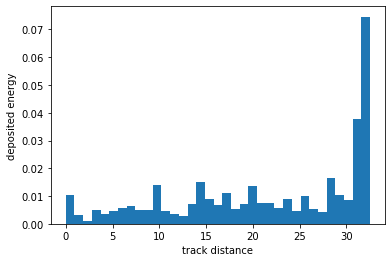

(48000059, 'e-')


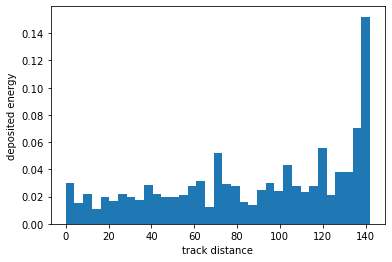

(48000060, 'e+')


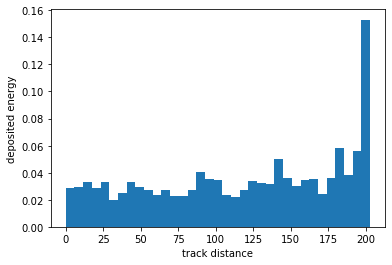

(48000060, 'e-')


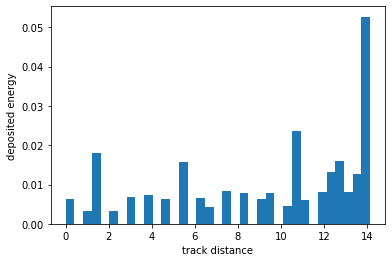

(48000061, 'e-')


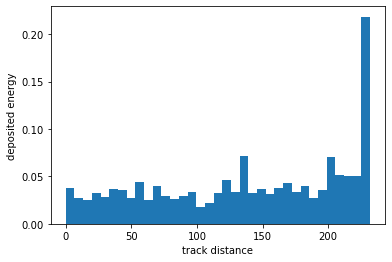

(48000062, 'e-')


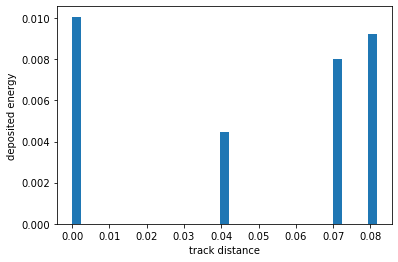

(48000063, 'e-')


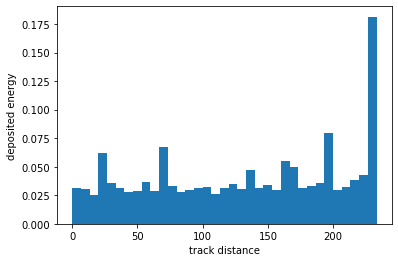

(48000064, 'e+')


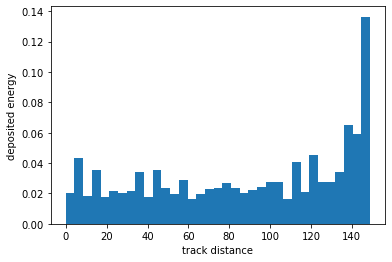

(48000064, 'e-')


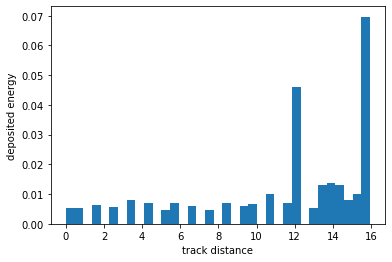

(48000066, 'e+')


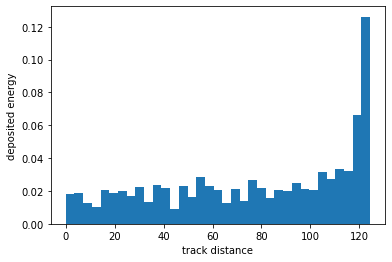

(48000066, 'e-')


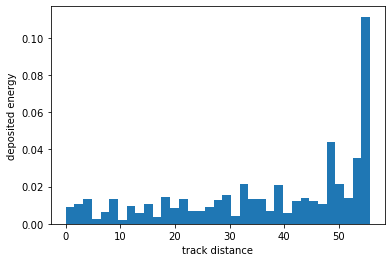

(48000067, 'e-')


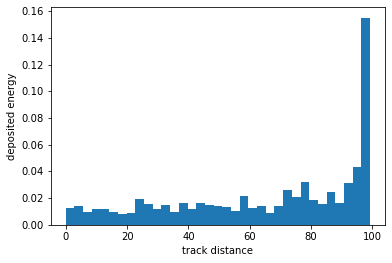

(48000068, 'e+')


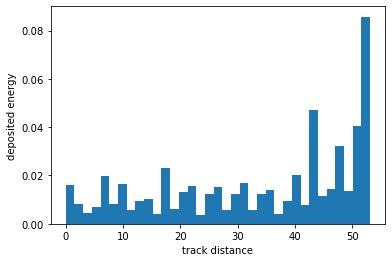

(48000068, 'e-')


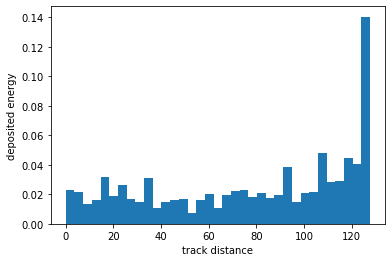

(48000069, 'e+')


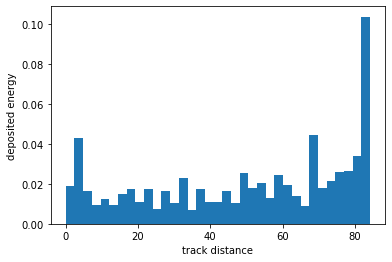

(48000069, 'e-')


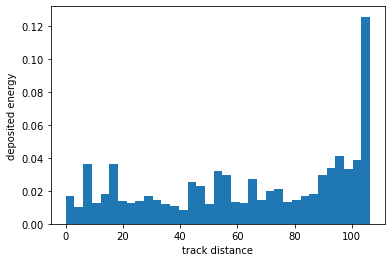

(48000070, 'e+')


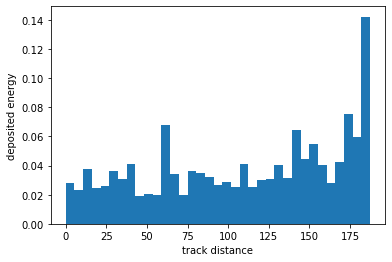

(48000070, 'e-')


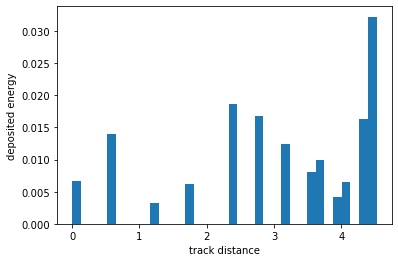

(48000071, 'e+')


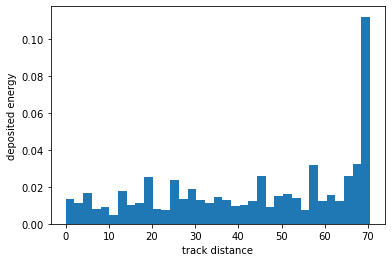

(48000071, 'e-')


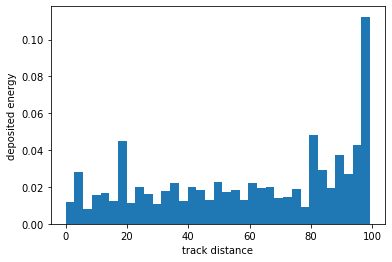

(48000073, 'e-')


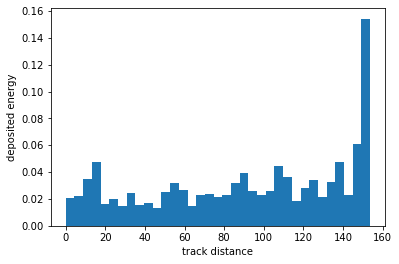

(48000074, 'e-')


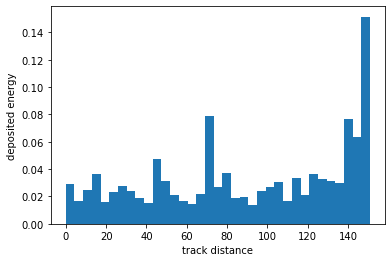

(48000075, 'e-')


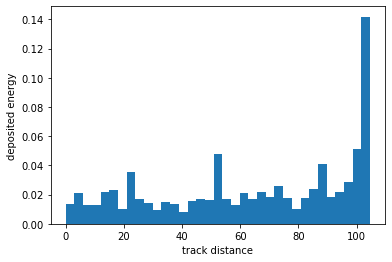

(48000076, 'e+')


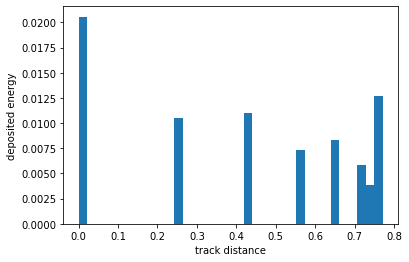

(48000076, 'e-')


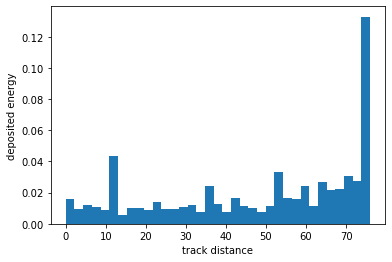

(48000077, 'e-')


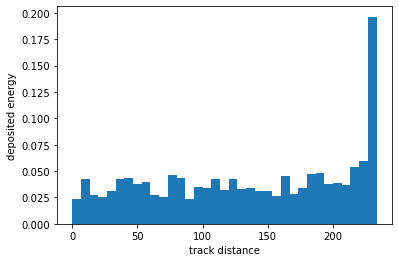

(48000078, 'e-')


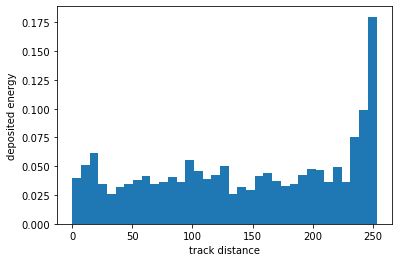

(48000079, 'e+')


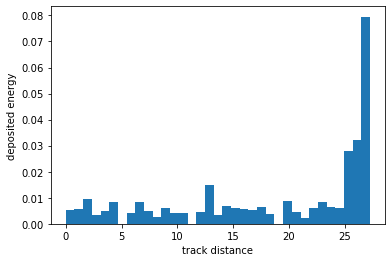

(48000079, 'e-')


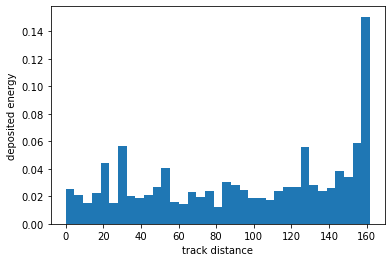

(48000080, 'e-')


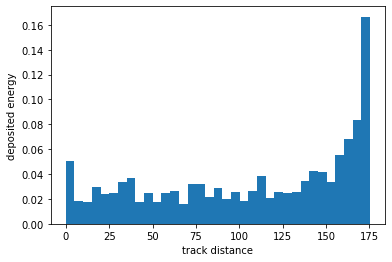

(48000081, 'e+')


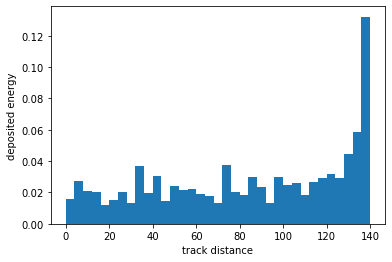

(48000081, 'e-')


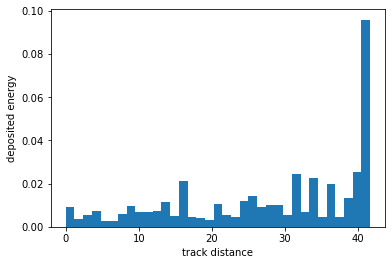

(48000082, 'e-')


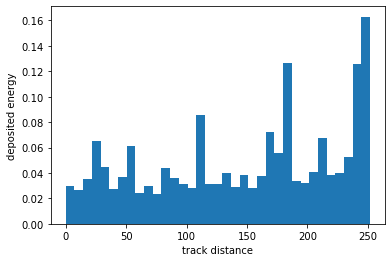

(48000083, 'e+')


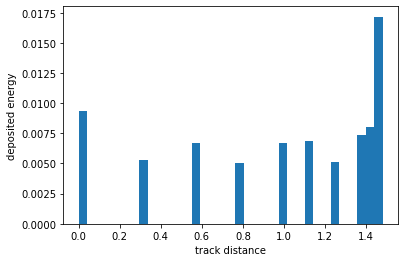

(48000083, 'e-')


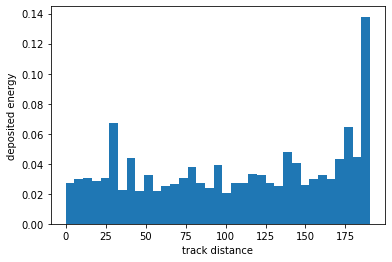

(48000084, 'e-')


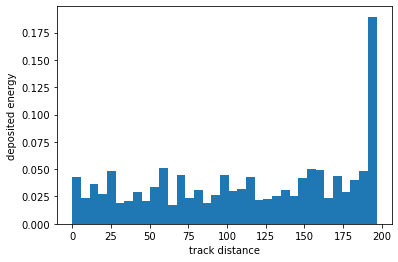

(48000085, 'e-')


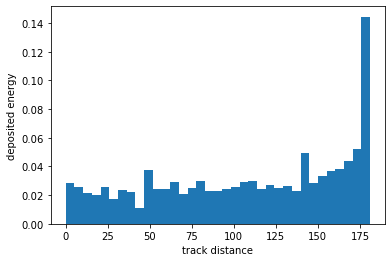

(48000086, 'e-')


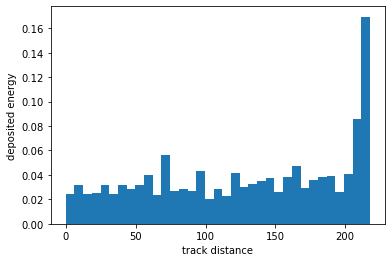

(48000087, 'e+')


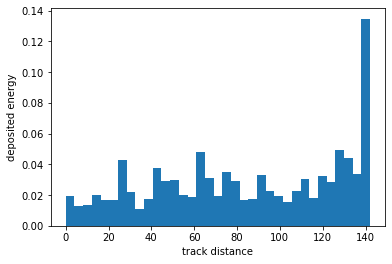

(48000087, 'e-')


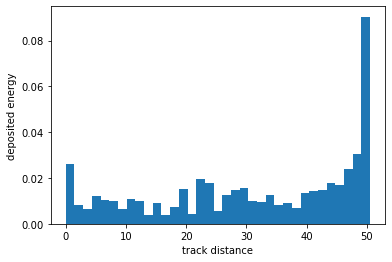

(48000088, 'e-')


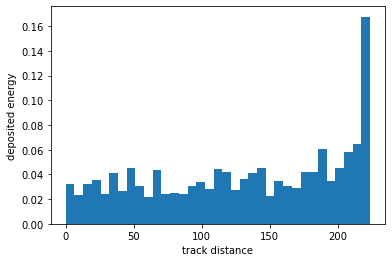

(48000089, 'e-')


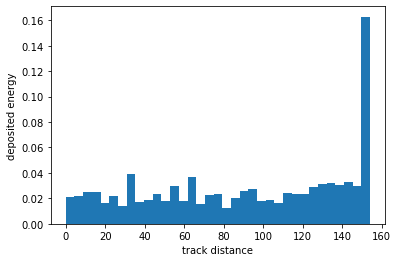

(48000090, 'e-')


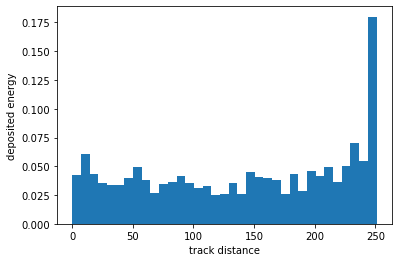

(48000091, 'e-')


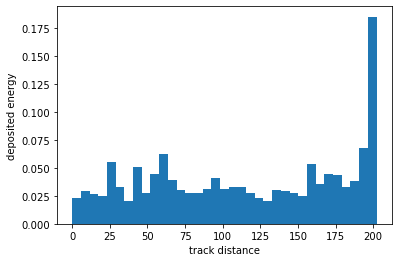

(48000092, 'e-')


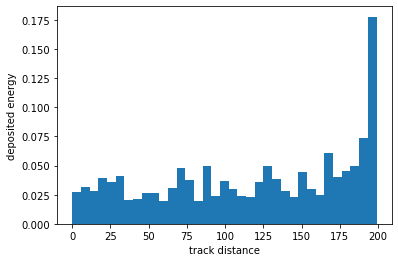

(48000093, 'e+')


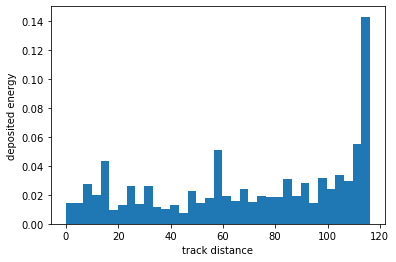

(48000093, 'e-')


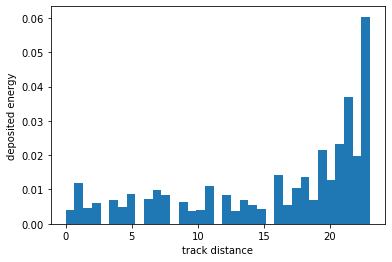

(48000094, 'e-')


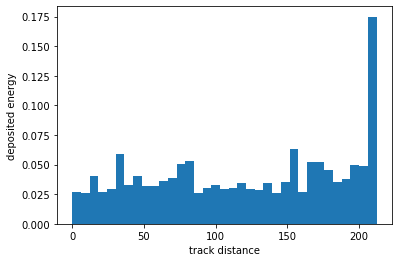

(48000096, 'e+')


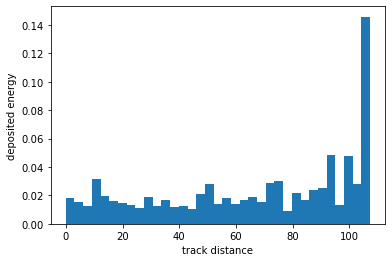

(48000096, 'e-')


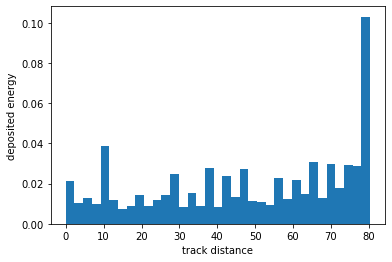

(48000097, 'e-')


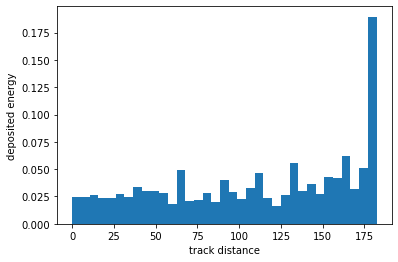

(48000098, 'e+')


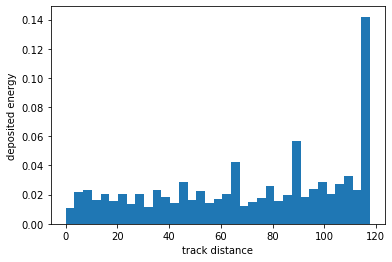

(48000098, 'e-')


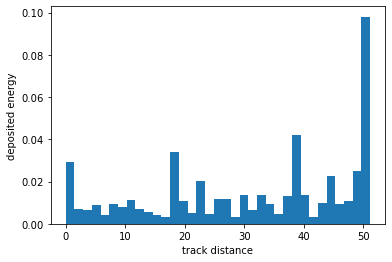

(48000099, 'e-')


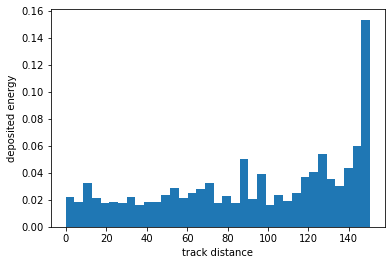

(48000101, 'e-')


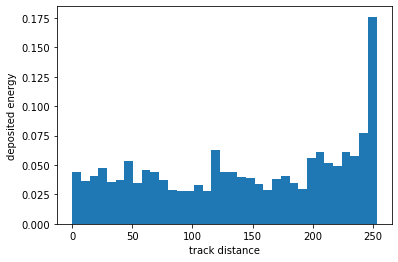

(48000102, 'e+')


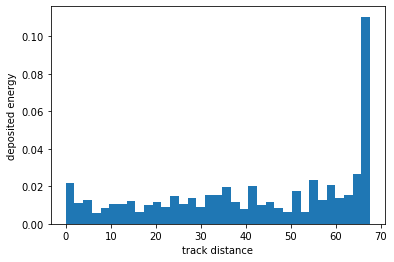

(48000102, 'e-')


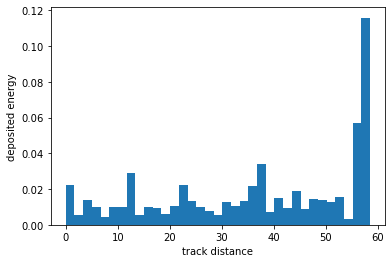

(48000103, 'e-')


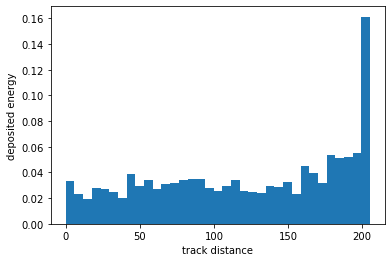

(48000104, 'e-')


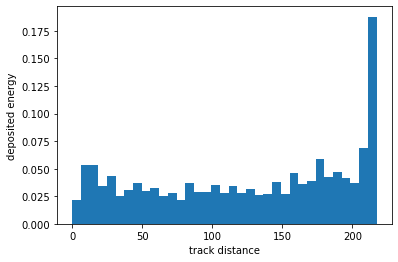

(48000106, 'e-')


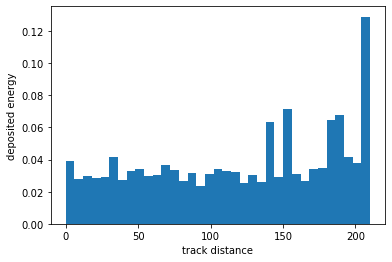

(48000107, 'e-')


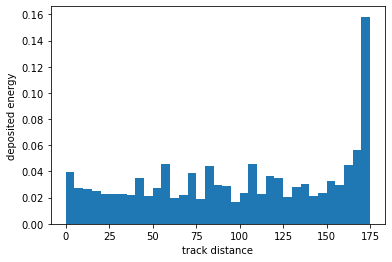

(48000108, 'e-')


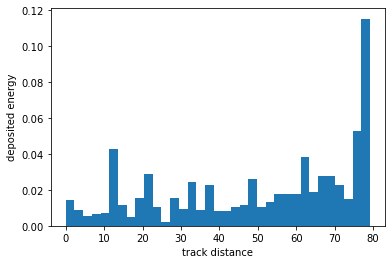

(48000109, 'e-')


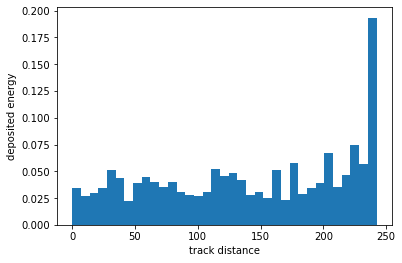

(48000110, 'e-')


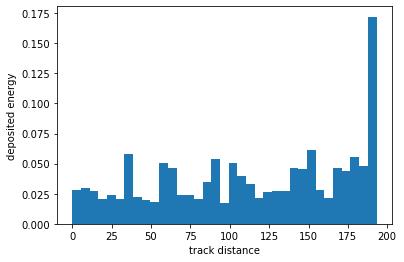

(48000111, 'e-')


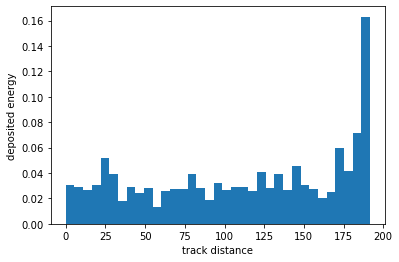

(48000112, 'e+')


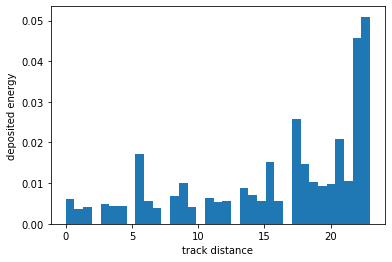

(48000112, 'e-')


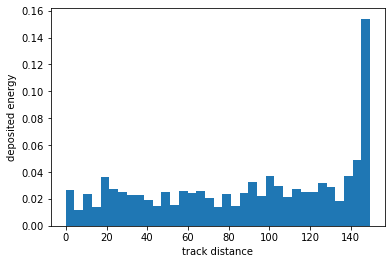

(48000113, 'e-')


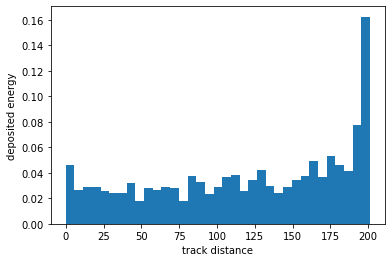

(48000114, 'e-')


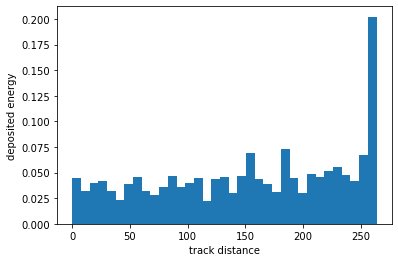

(48000115, 'e-')


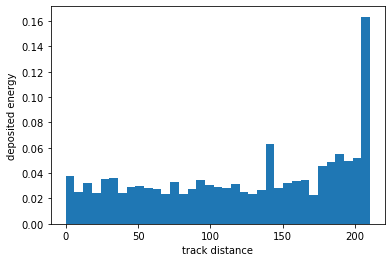

(48000116, 'e-')


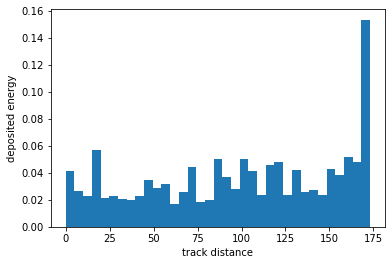

(48000117, 'e-')


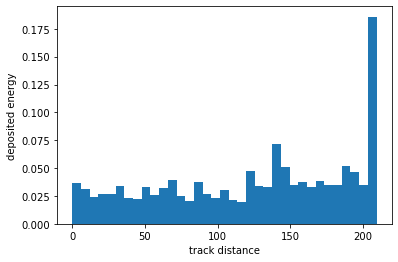

(48000118, 'e-')


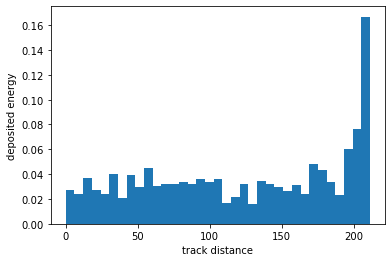

(48000119, 'e-')


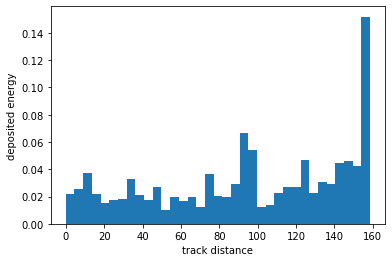

(48000120, 'e+')


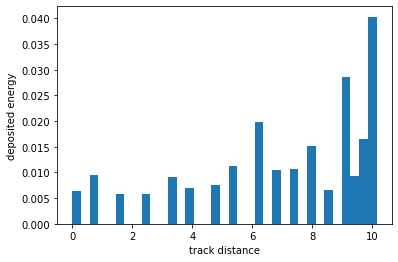

(48000120, 'e-')


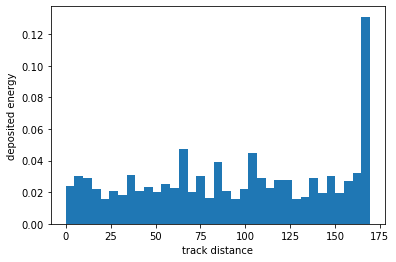

(48000121, 'e-')


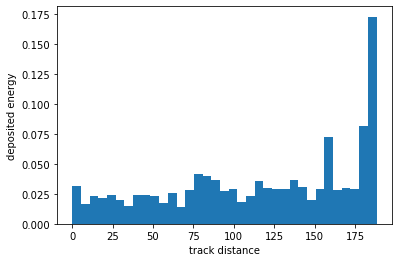

(48000122, 'e+')


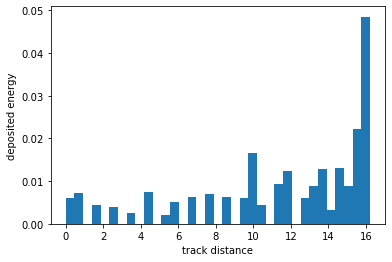

(48000122, 'e-')


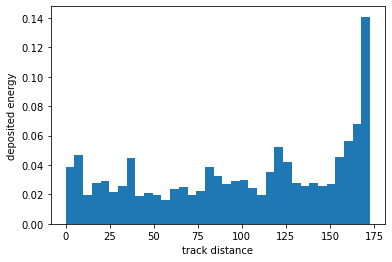

(48000123, 'e-')


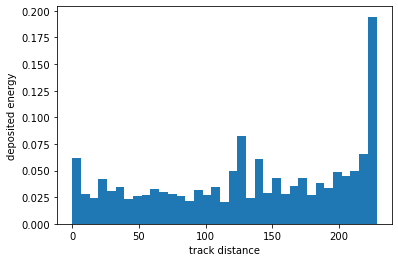

(48000124, 'e+')


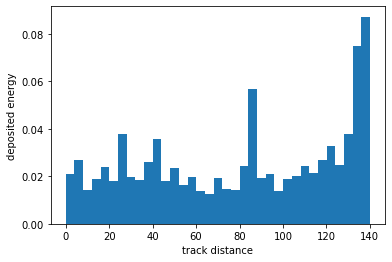

(48000124, 'e-')


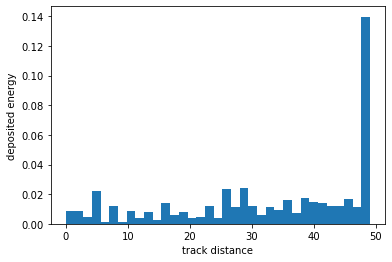

(48000125, 'e-')


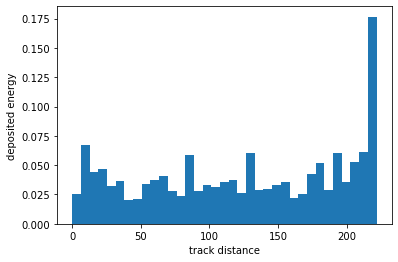

(48000126, 'e-')


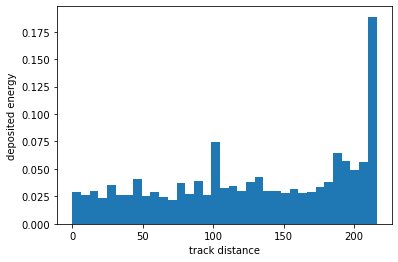

(48000127, 'e-')


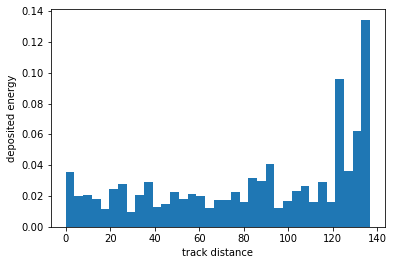

(48000128, 'e-')


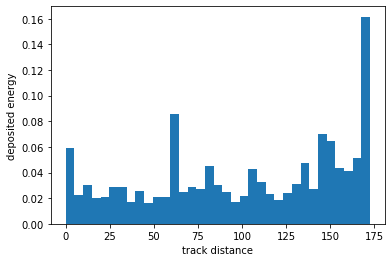

(48000129, 'e+')


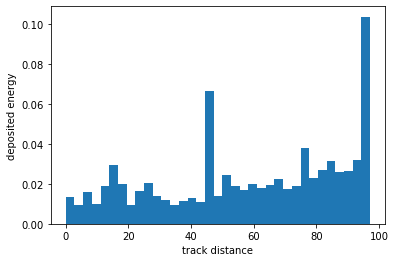

(48000129, 'e-')


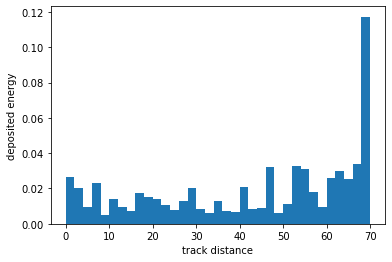

(48000130, 'e-')


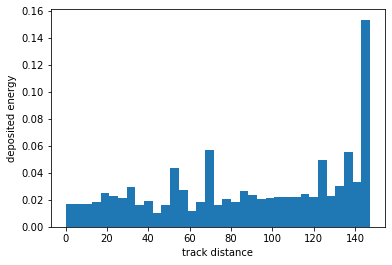

(48000131, 'e+')


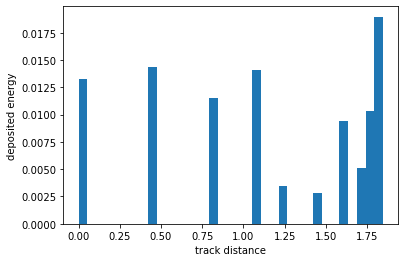

(48000131, 'e-')


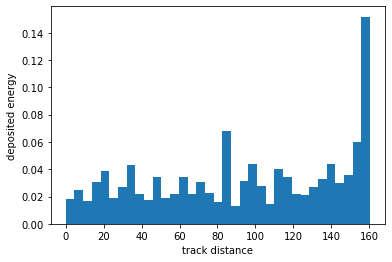

(48000132, 'e-')


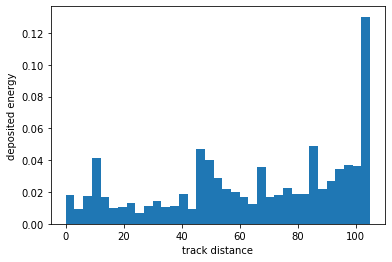

(48000133, 'e-')


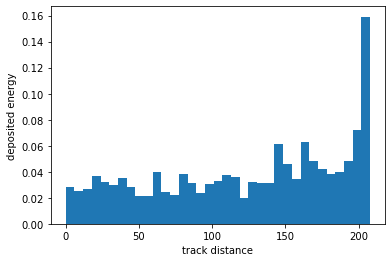

(48000134, 'e-')


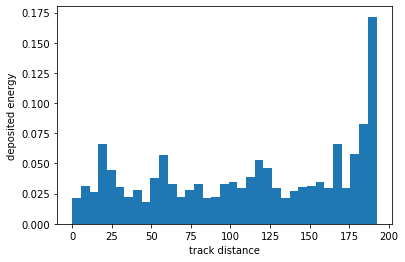

(48000135, 'e-')


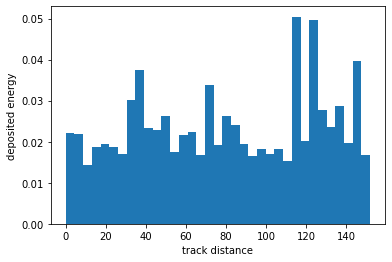

(48000136, 'e-')


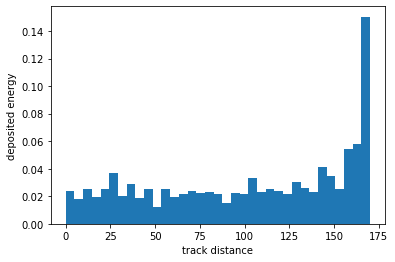

(48000137, 'e-')


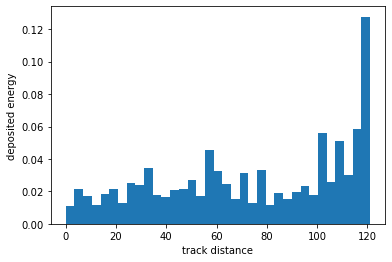

(48000138, 'e-')


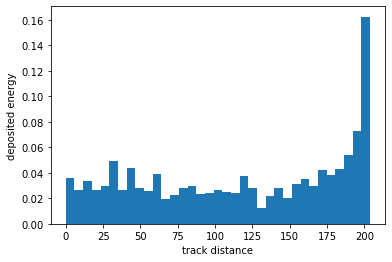

(48000139, 'e-')


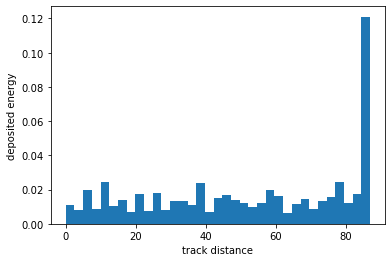

(48000140, 'e-')


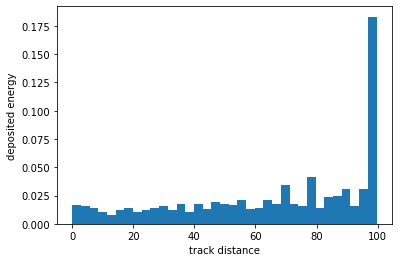

(48000141, 'e-')


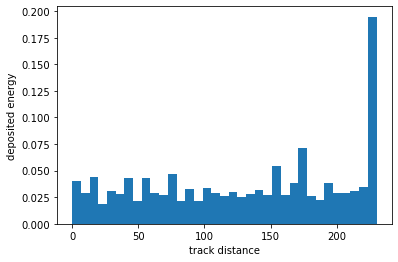

(48000142, 'e-')


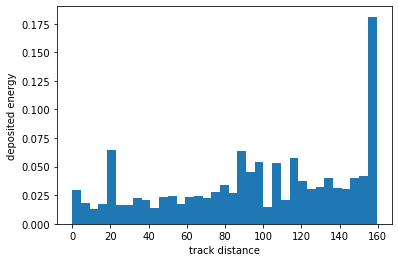

(48000143, 'e-')


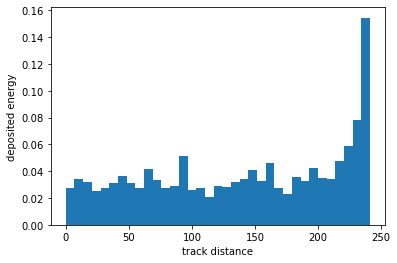

(48000144, 'e+')


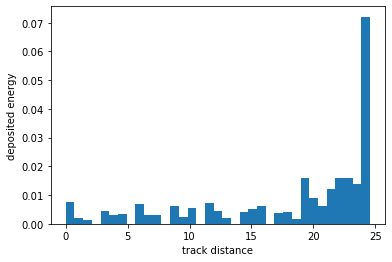

(48000144, 'e-')


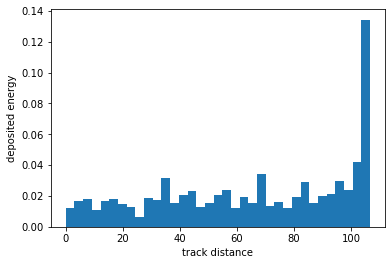

(48000145, 'e+')


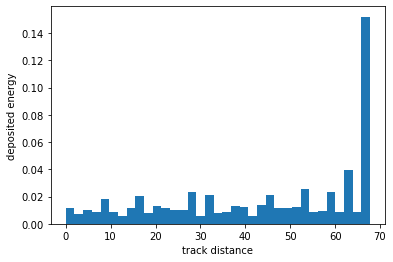

(48000145, 'e-')


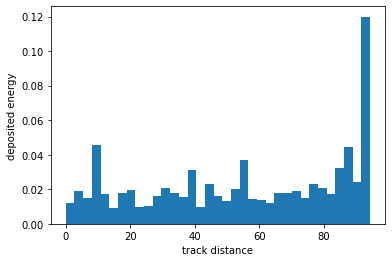

(48000146, 'e-')


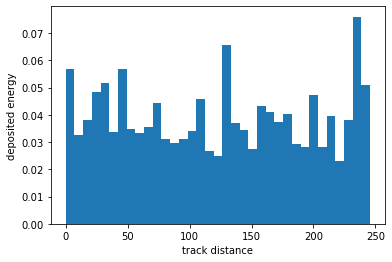

(48000147, 'e-')


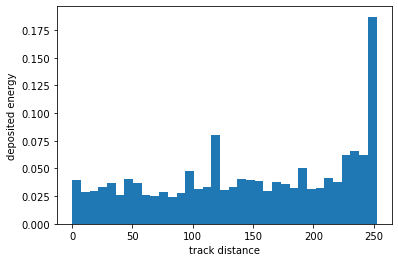

(48000148, 'e-')


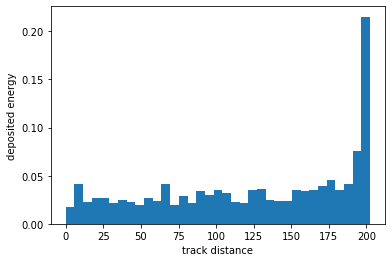

(48000149, 'e-')


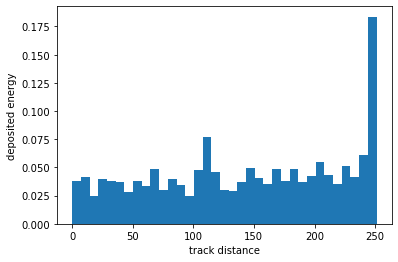

(48000150, 'e-')


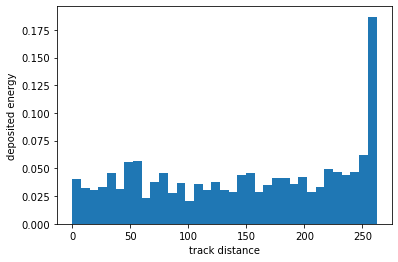

(48000151, 'e+')


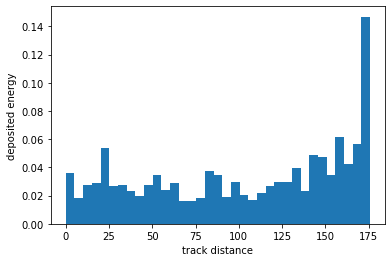

(48000151, 'e-')


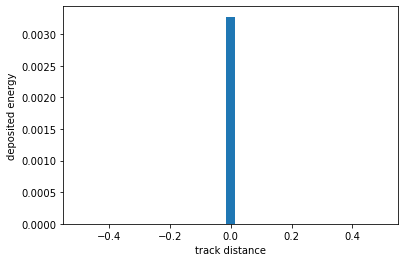

(48000152, 'e+')


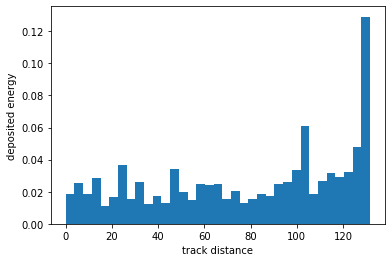

(48000152, 'e-')


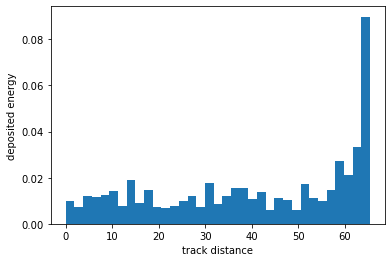

(48000153, 'e+')


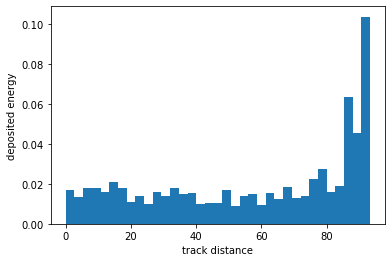

(48000153, 'e-')


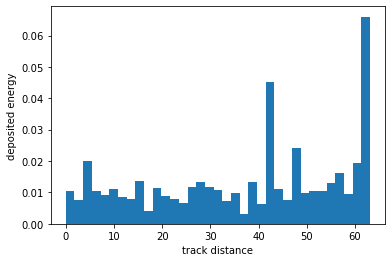

(48000154, 'e+')


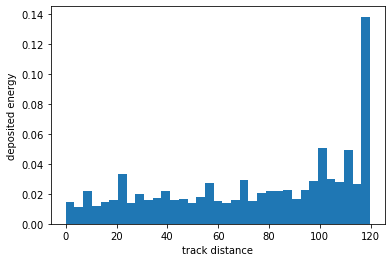

(48000154, 'e-')


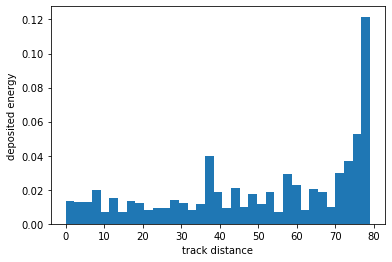

(48000155, 'e-')


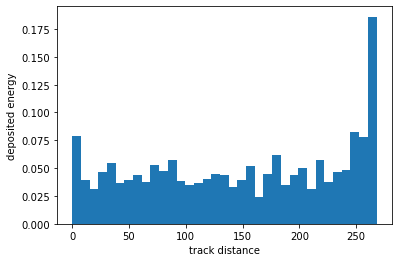

(48000156, 'e-')


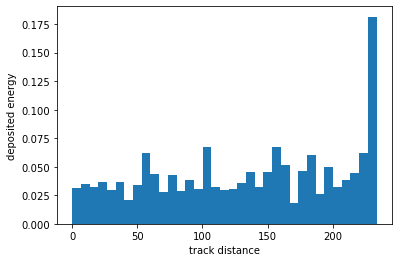

(48000157, 'e-')


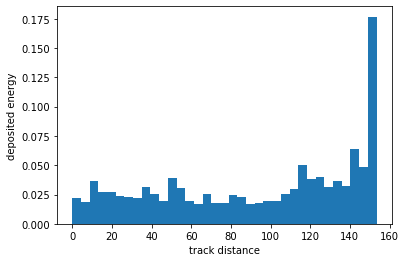

(48000158, 'e+')


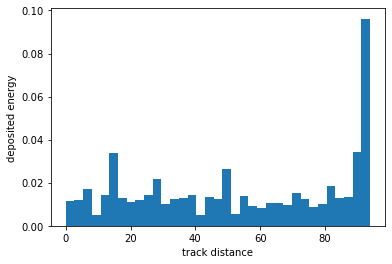

(48000158, 'e-')


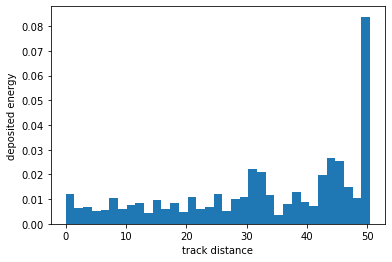

(48000159, 'e-')


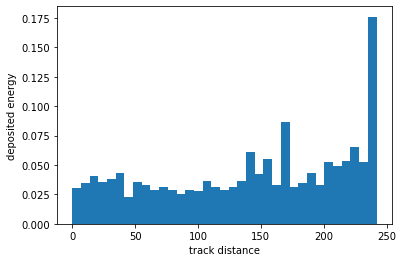

(48000160, 'e-')


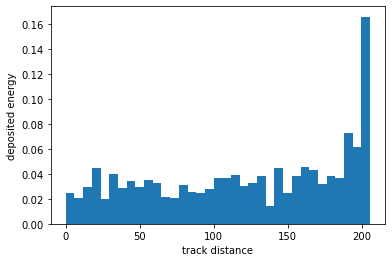

(48000161, 'e-')


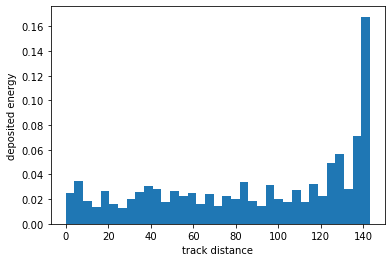

(48000162, 'e-')


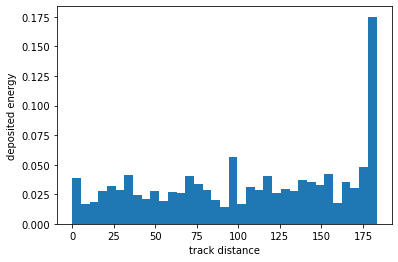

(48000163, 'e+')


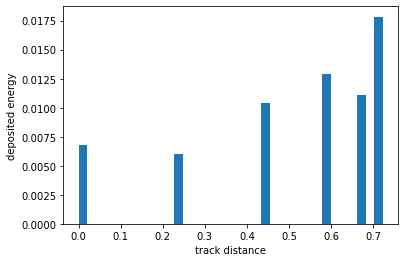

(48000163, 'e-')


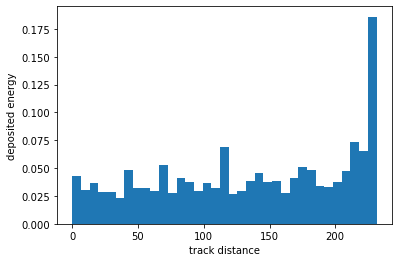

(48000164, 'e-')


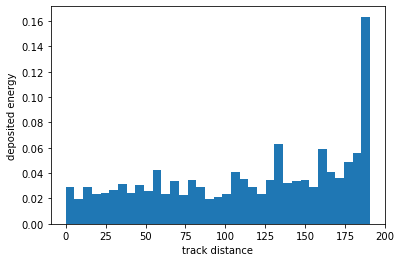

(48000165, 'e-')


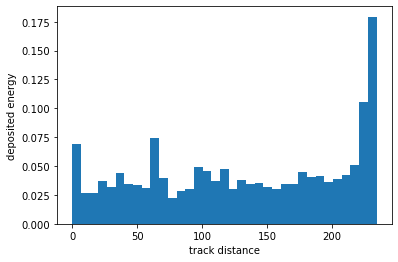

(48000166, 'e-')


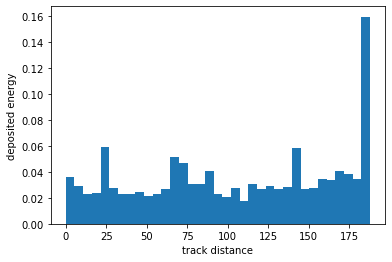

(48000167, 'e-')


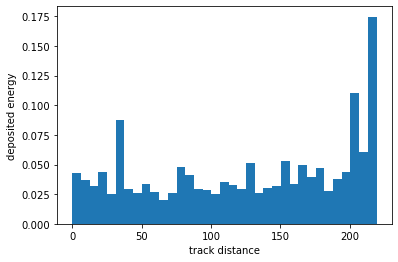

(48000168, 'e+')


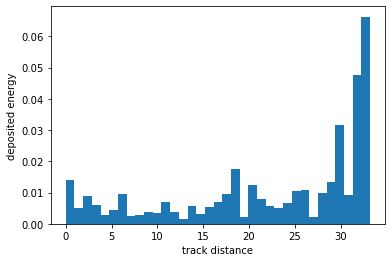

(48000168, 'e-')


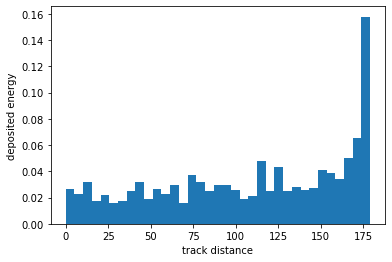

(48000169, 'e+')


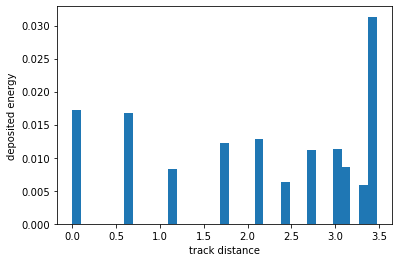

(48000169, 'e-')


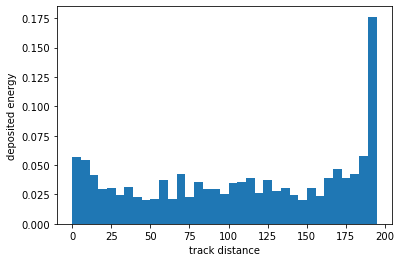

(48000170, 'e+')


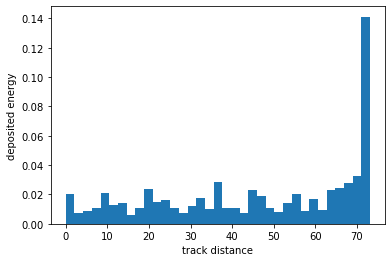

(48000170, 'e-')


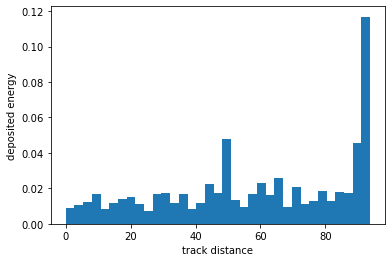

(48000171, 'e+')


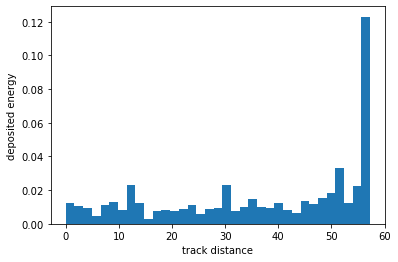

(48000171, 'e-')


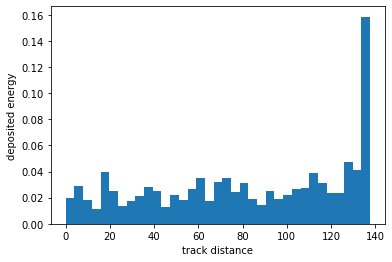

(48000172, 'e-')


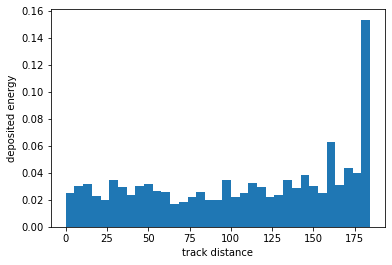

(48000173, 'e-')


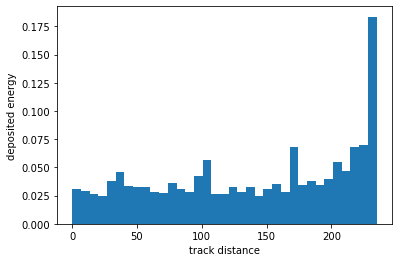

(48000174, 'e+')


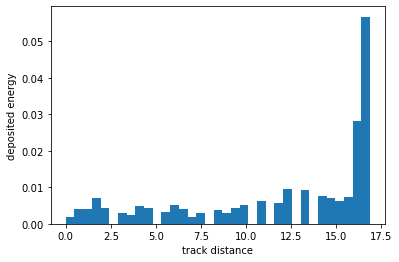

(48000174, 'e-')


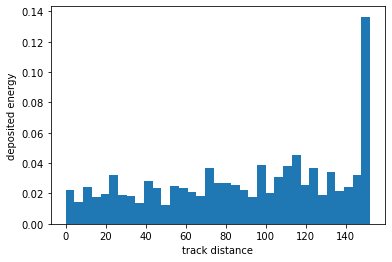

(48000175, 'e-')


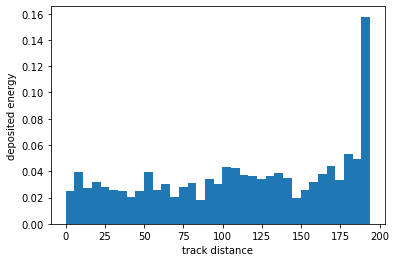

(48000176, 'e-')


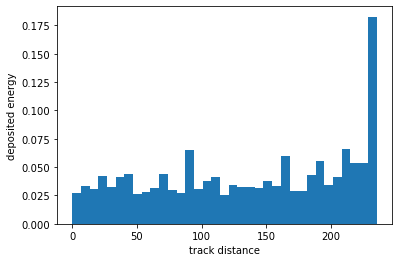

(48000177, 'e-')


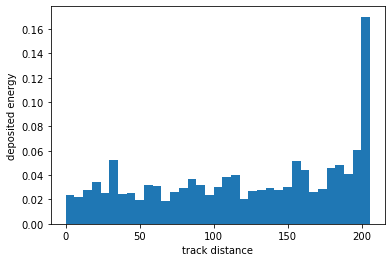

(48000178, 'e+')


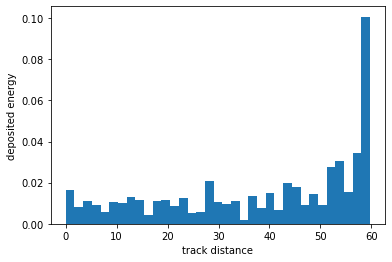

(48000178, 'e-')


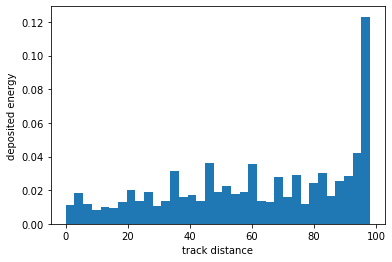

(48000179, 'e-')


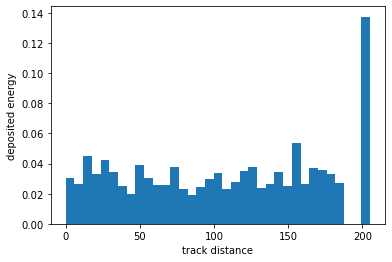

(48000180, 'e-')


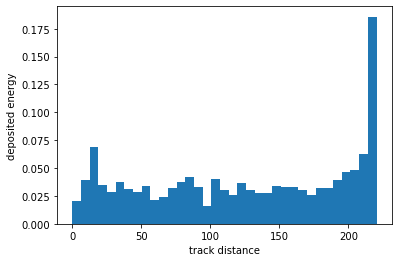

(48000181, 'e+')


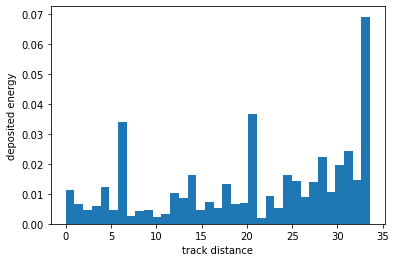

(48000181, 'e-')


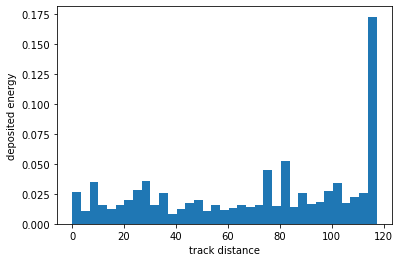

(48000182, 'e-')


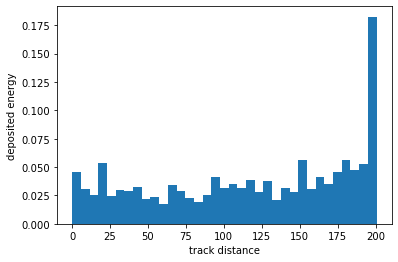

(48000183, 'e-')


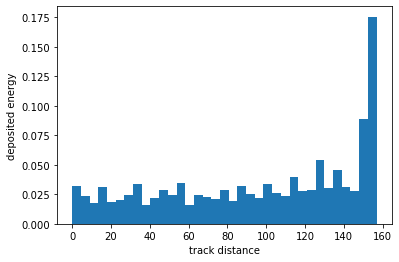

(48000184, 'e+')


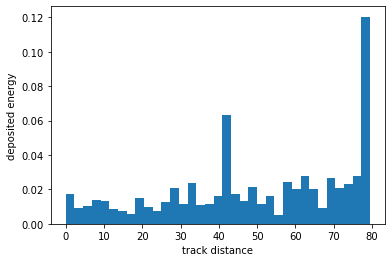

(48000184, 'e-')


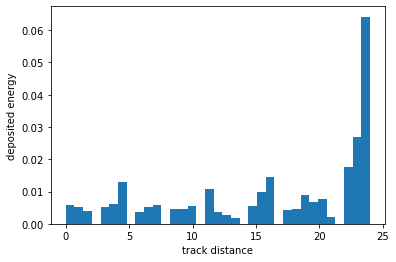

(48000185, 'e+')


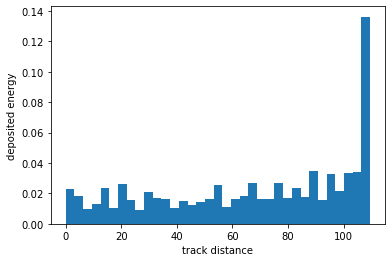

(48000185, 'e-')


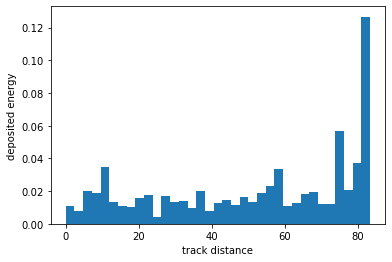

(48000186, 'e-')


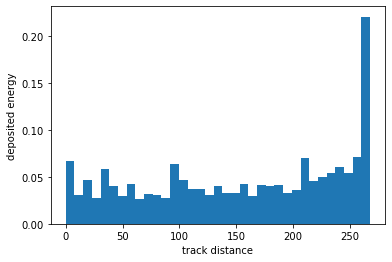

(48000187, 'e+')


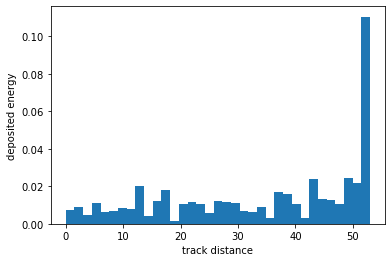

(48000187, 'e-')


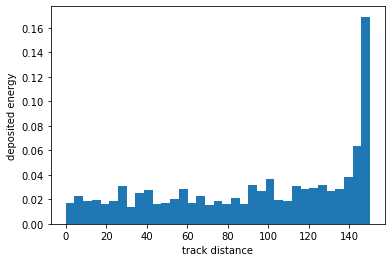

(48000188, 'e+')


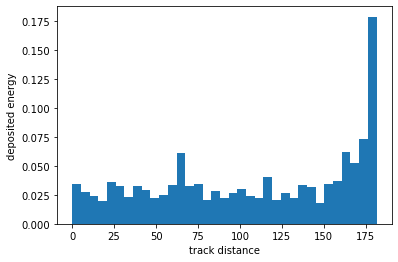

(48000188, 'e-')


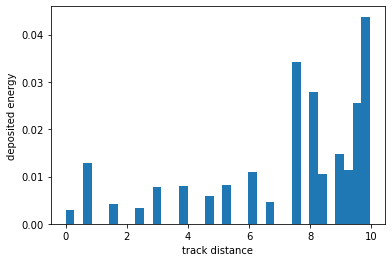

(48000189, 'e-')


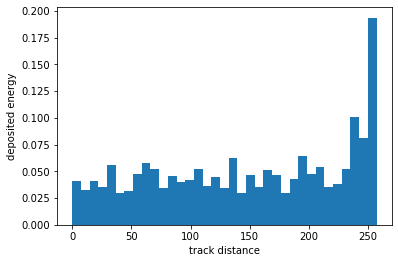

(48000190, 'e-')


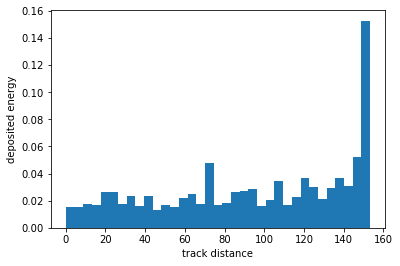

(48000191, 'e+')


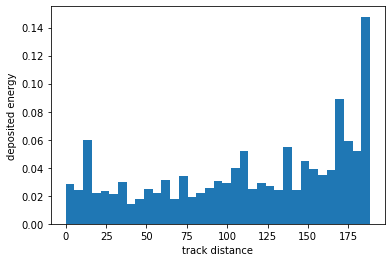

(48000191, 'e-')


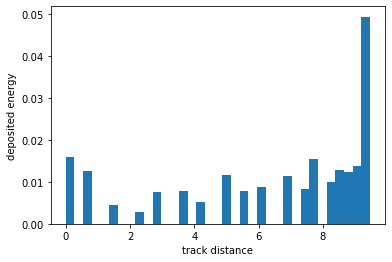

(48000192, 'e+')


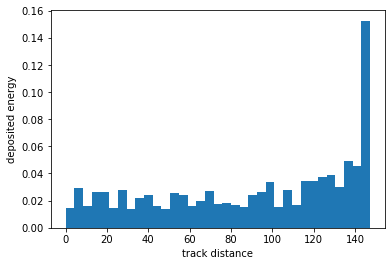

(48000192, 'e-')


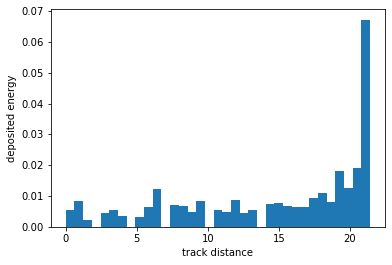

(48000193, 'e-')


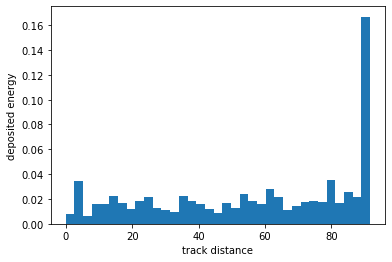

(48000194, 'e-')


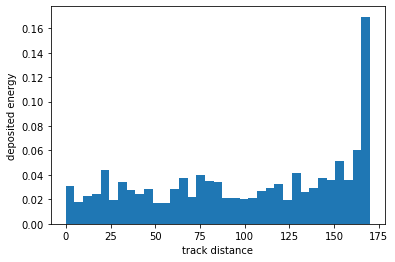

(48000195, 'e-')


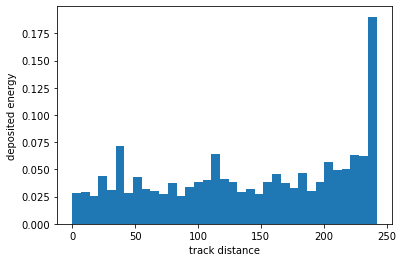

(48000196, 'e-')


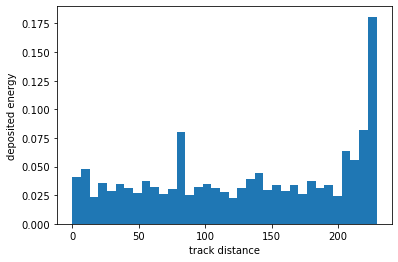

(48000197, 'e-')


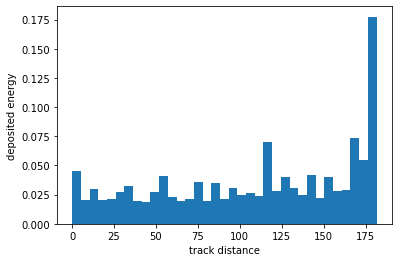

(48000198, 'e-')


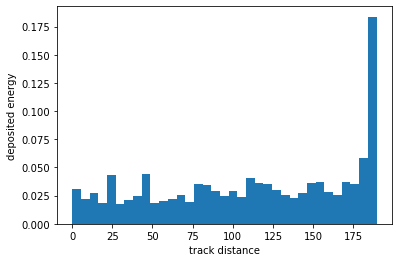

(48000199, 'e-')


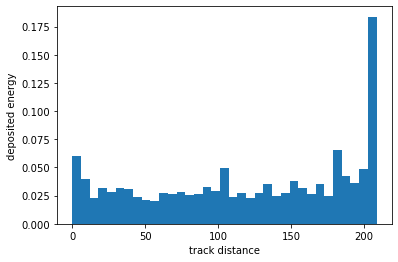

(48000200, 'e-')


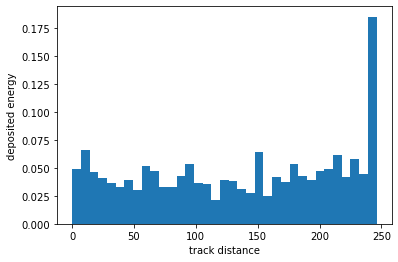

(48000202, 'e-')


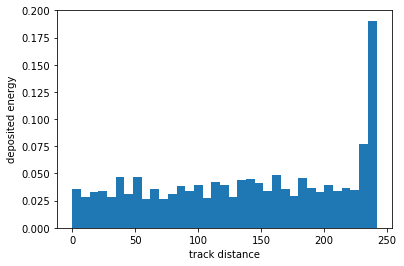

(48000203, 'e-')


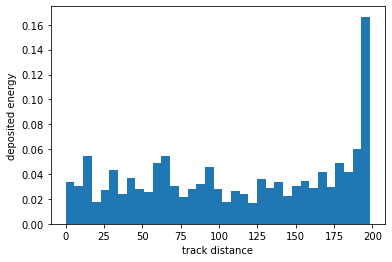

(48000204, 'e-')


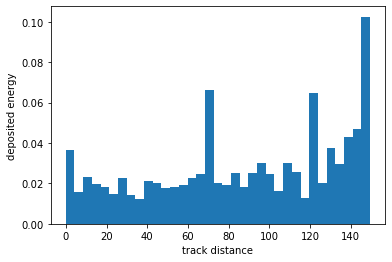

(48000205, 'e-')


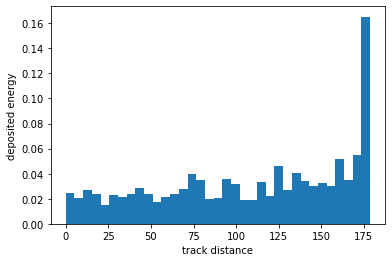

(48000206, 'e-')


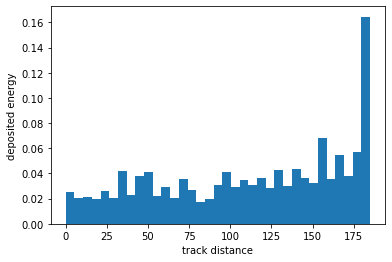

(48000207, 'e-')


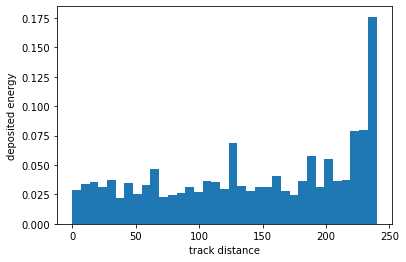

(48000208, 'e-')


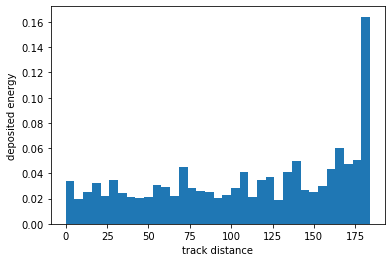

(48000209, 'e-')


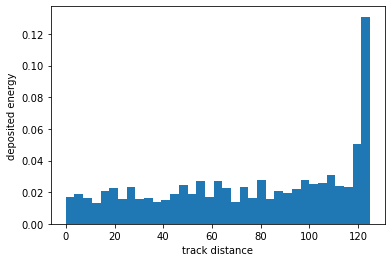

(48000210, 'e-')


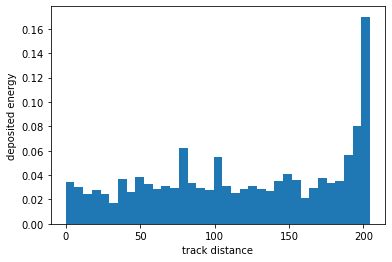

(48000211, 'e-')


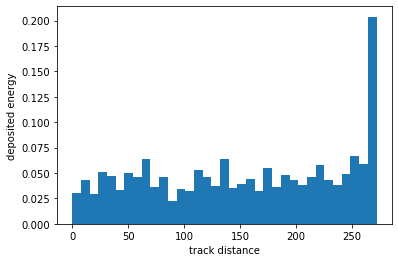

(48000212, 'e-')


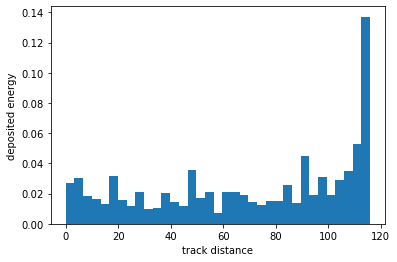

(48000213, 'e-')


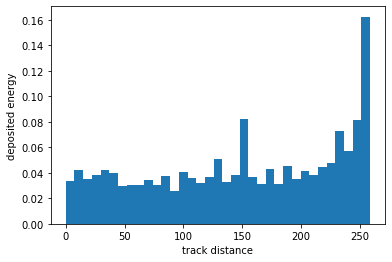

(48000214, 'e-')


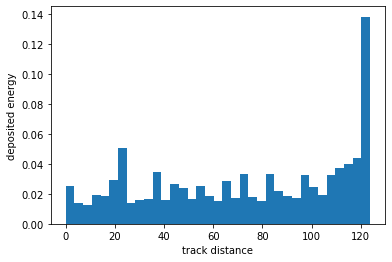

(48000215, 'e-')


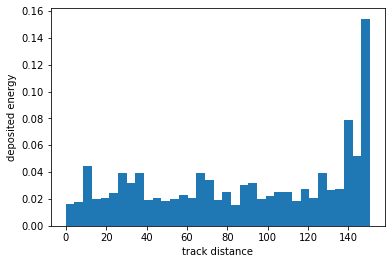

(48000216, 'e-')


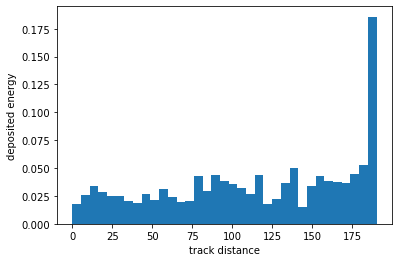

(48000217, 'e+')


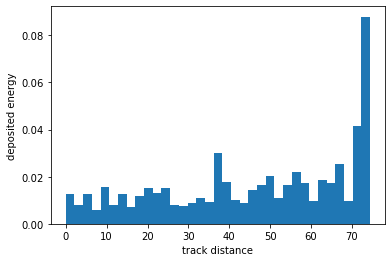

(48000217, 'e-')


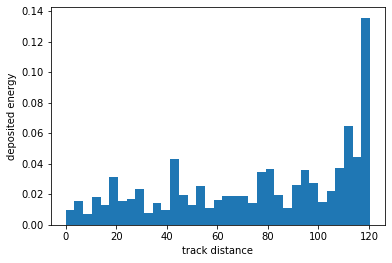

(48000218, 'e-')


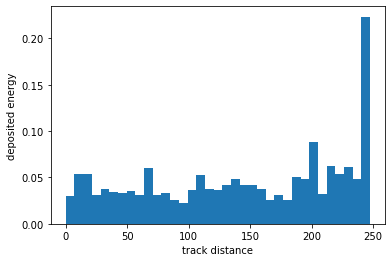

(48000219, 'e-')


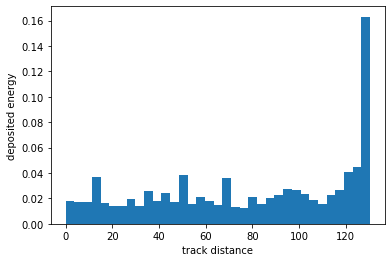

(48000220, 'e-')


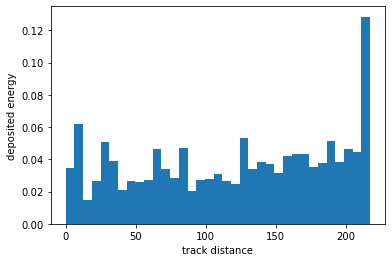

(48000221, 'e+')


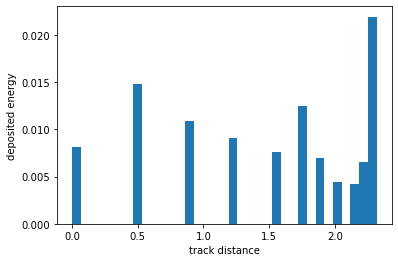

(48000221, 'e-')


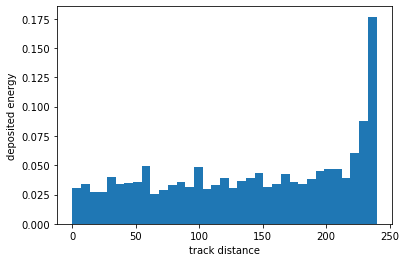

(48000222, 'e+')


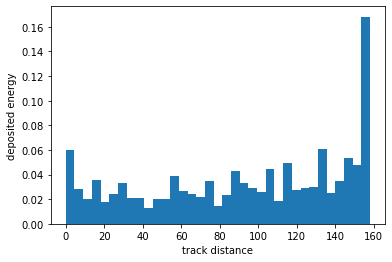

(48000222, 'e-')


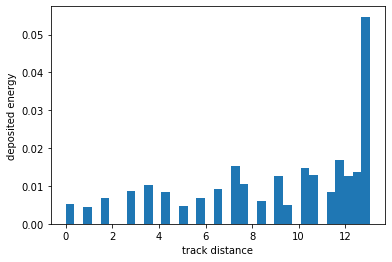

(48000223, 'e-')


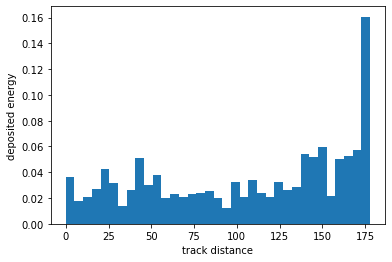

(48000224, 'e-')


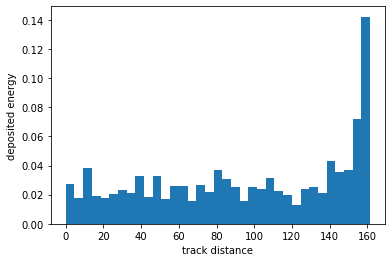

(48000225, 'e+')


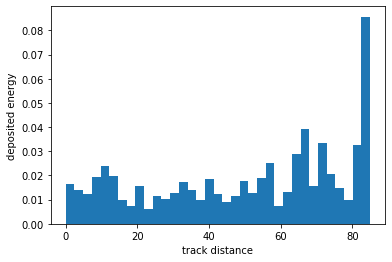

(48000225, 'e-')


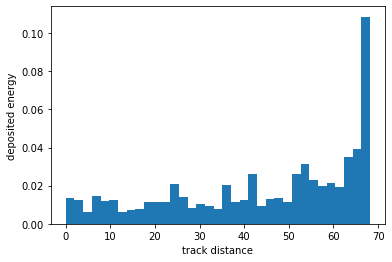

(48000226, 'e-')


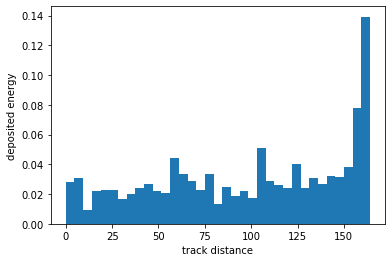

(48000228, 'e-')


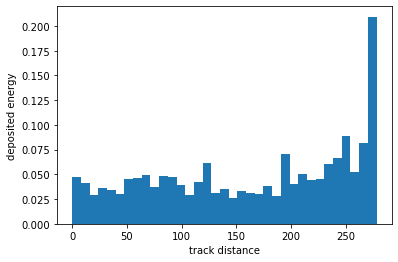

(48000229, 'e-')


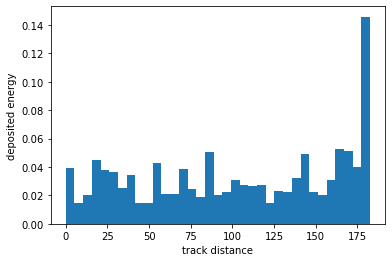

(48000230, 'e-')


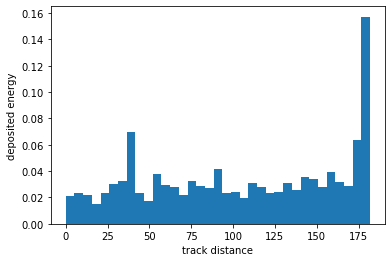

(48000231, 'e-')


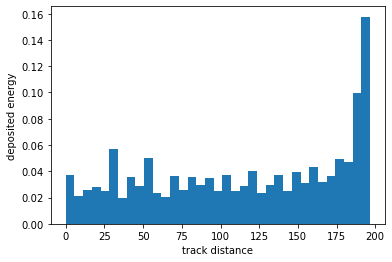

(48000232, 'e-')


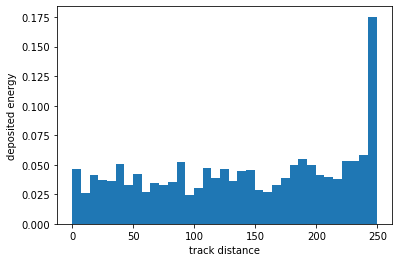

(48000233, 'e-')


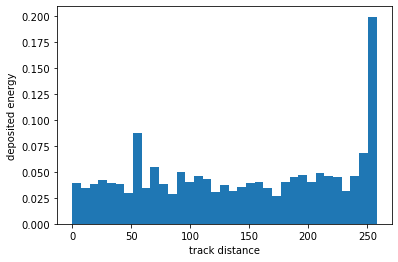

(48000234, 'e-')


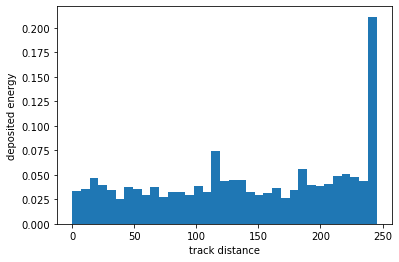

(48000235, 'e+')


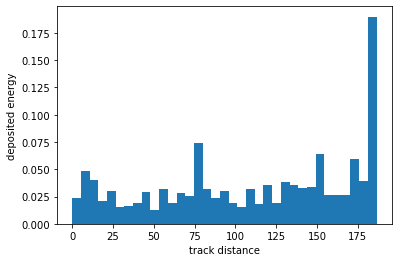

(48000235, 'e-')


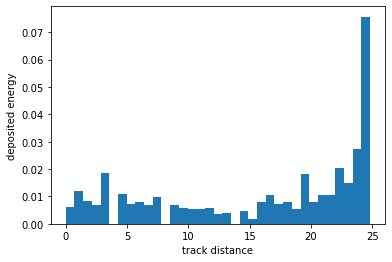

(48000236, 'e+')


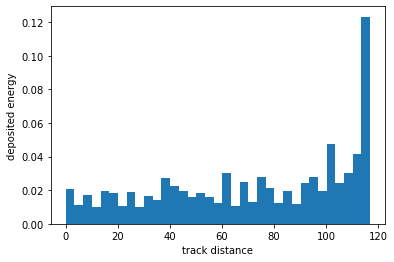

(48000236, 'e-')


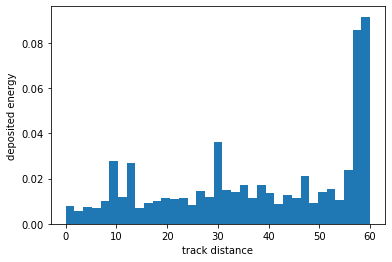

(48000237, 'e-')


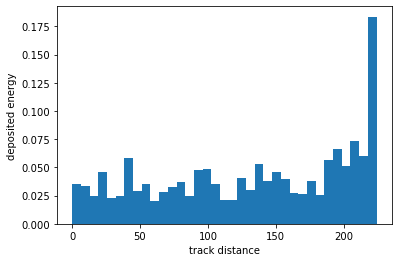

(48000238, 'e-')


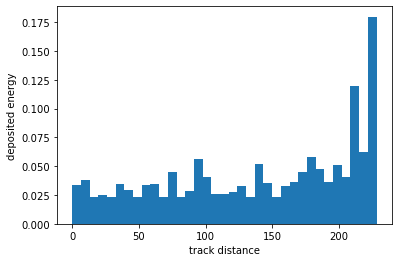

(48000239, 'e-')


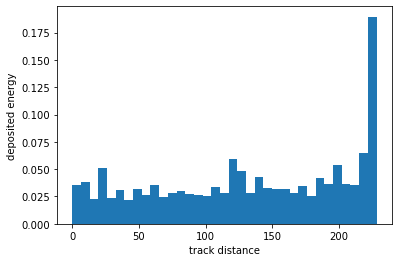

(48000240, 'e-')


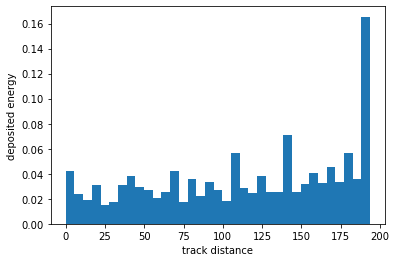

(48000241, 'e-')


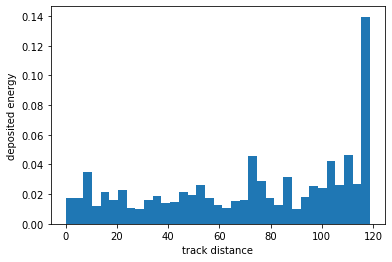

(48000242, 'e-')


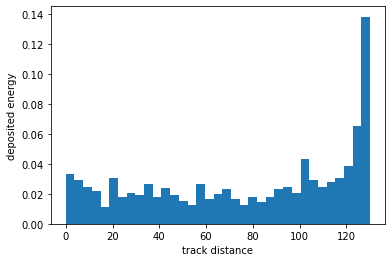

(48000243, 'e+')


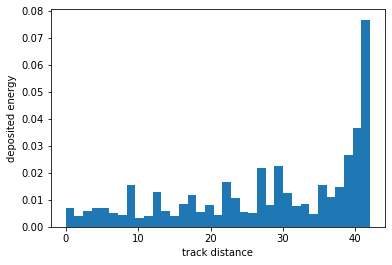

(48000243, 'e-')


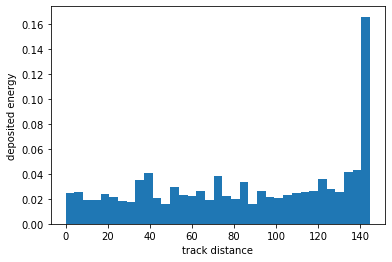

(48000244, 'e-')


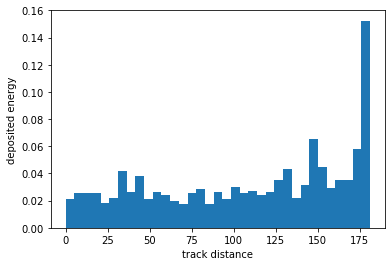

(48000245, 'e-')


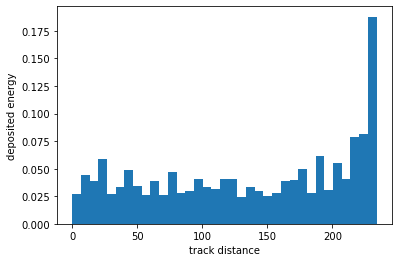

(48000246, 'e-')


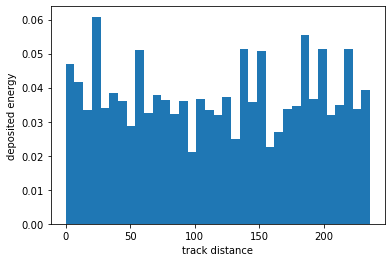

(48000247, 'e-')


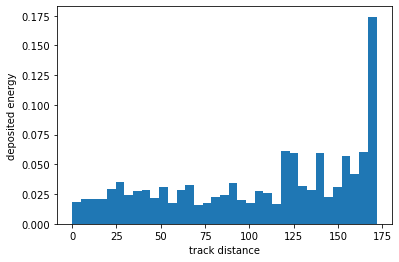

(48000248, 'e-')


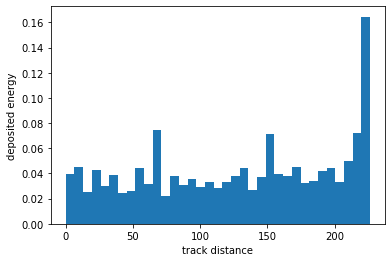

(48000249, 'e-')


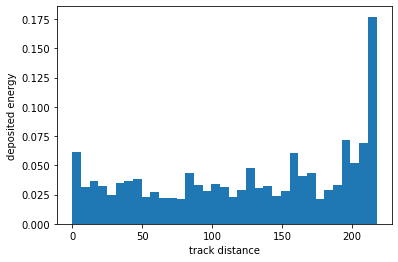

(48000250, 'e-')


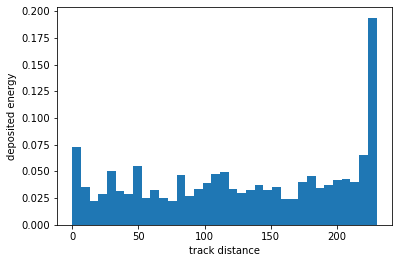

(48000251, 'e-')


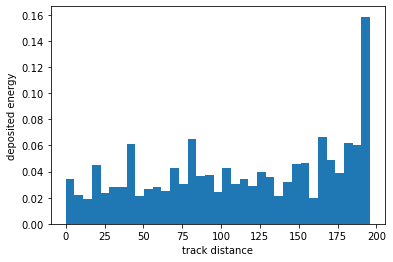

(48000252, 'e+')


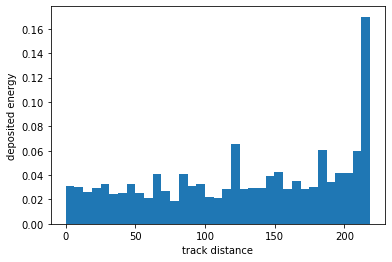

(48000252, 'e-')


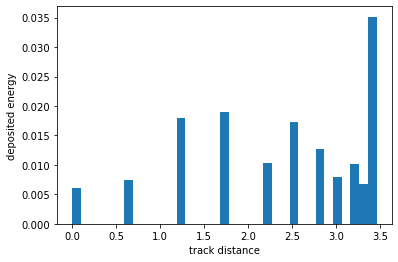

(48000253, 'e-')


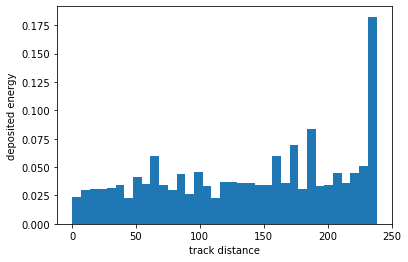

(48000254, 'e-')


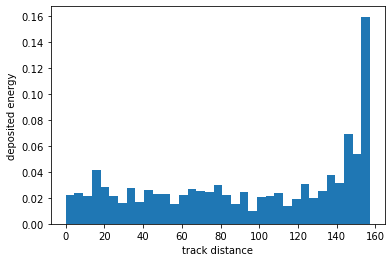

(48000255, 'e-')


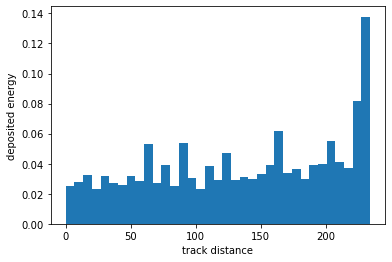

(48000256, 'e-')


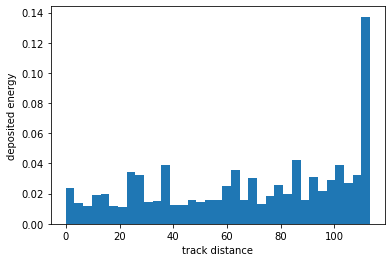

(48000257, 'e-')


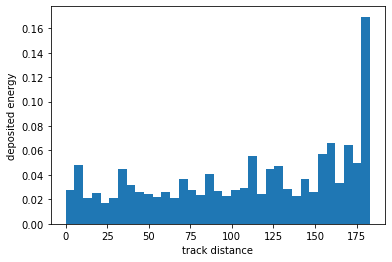

(48000258, 'e-')


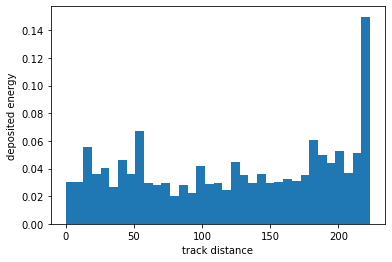

(48000259, 'e-')


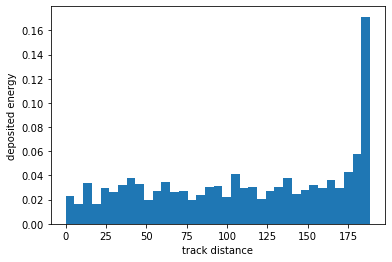

(48000260, 'e-')


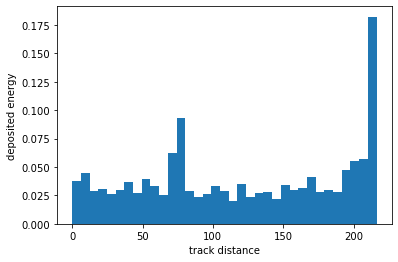

(48000261, 'e-')


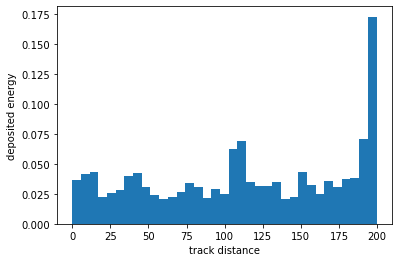

(48000262, 'e-')


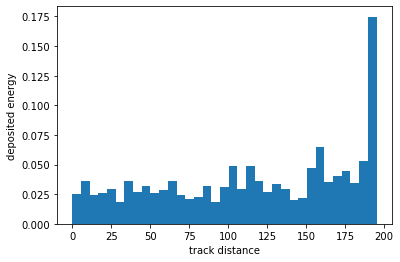

(48000263, 'e-')


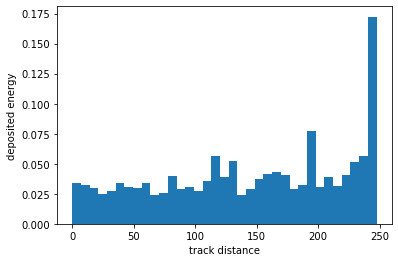

(48000264, 'e-')


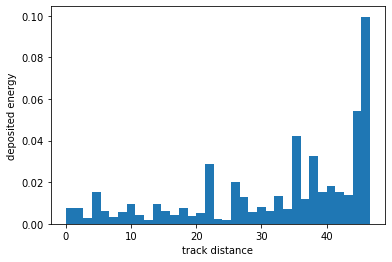

(48000265, 'e-')


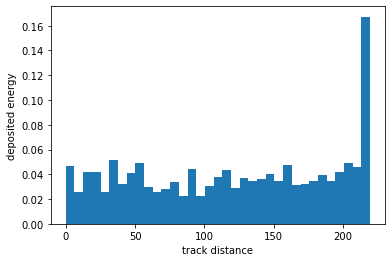

(48000266, 'e-')


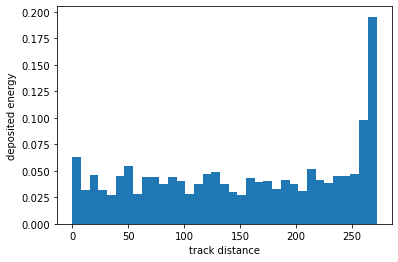

(48000267, 'e+')


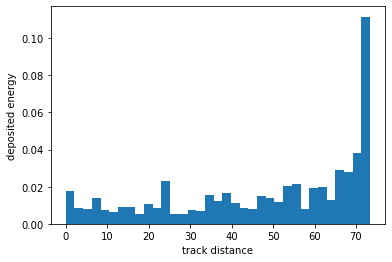

(48000267, 'e-')


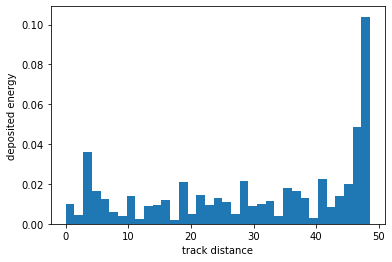

(48000268, 'e-')


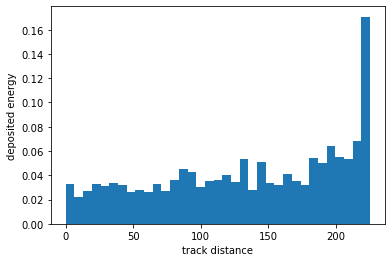

(48000269, 'e-')


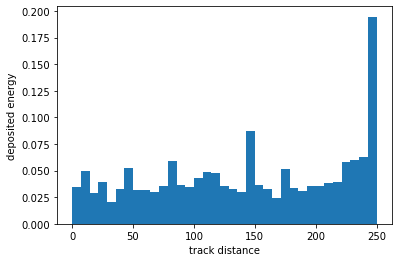

(48000270, 'e+')


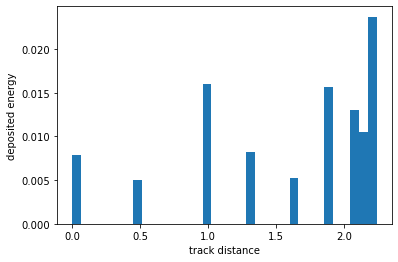

(48000270, 'e-')


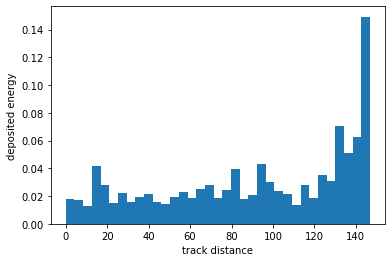

(48000271, 'e-')


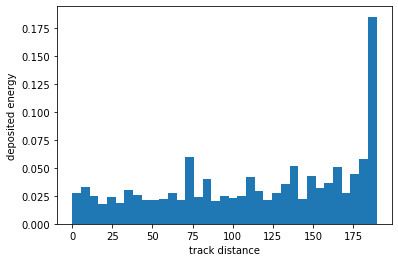

(48000272, 'e+')


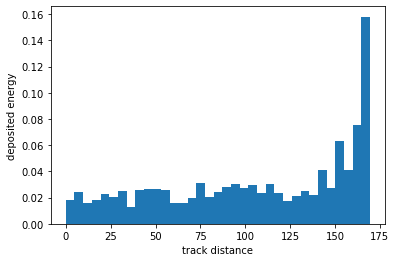

(48000272, 'e-')


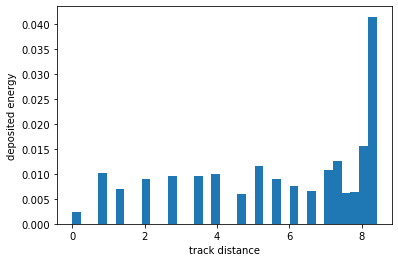

(48000273, 'e-')


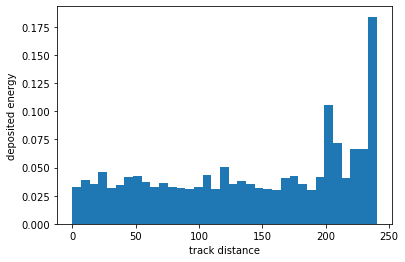

(48000274, 'e-')


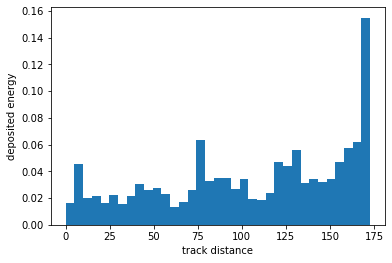

(48000275, 'e+')


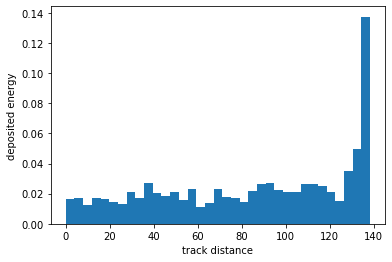

(48000275, 'e-')


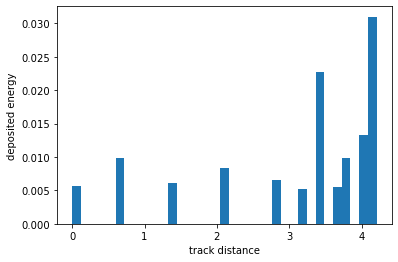

(48000276, 'e-')


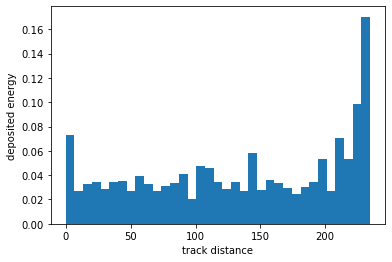

(48000277, 'e-')


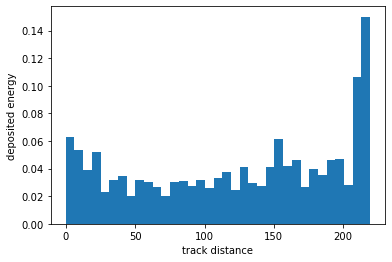

(48000278, 'e-')


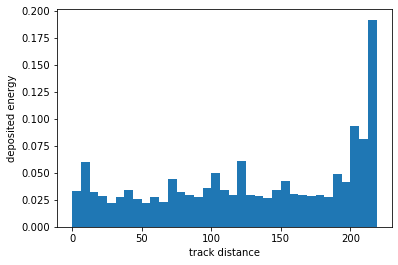

(48000279, 'e+')


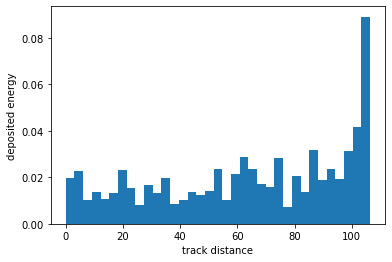

(48000279, 'e-')


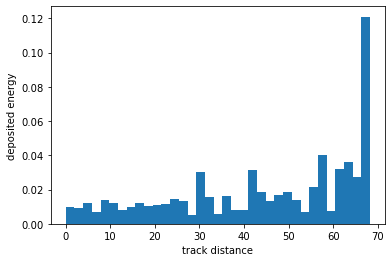

(48000280, 'e-')


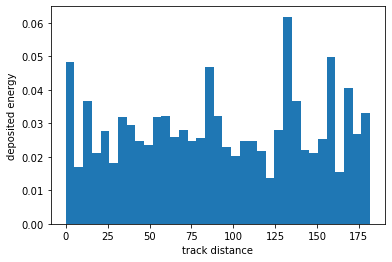

(48000281, 'e-')


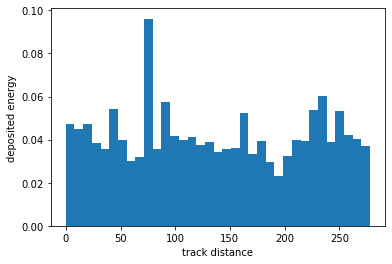

(48000282, 'e-')


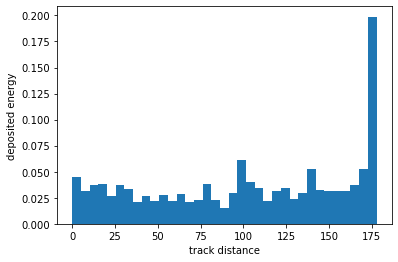

(48000283, 'e-')


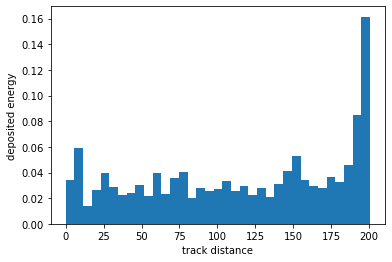

(48000285, 'e-')


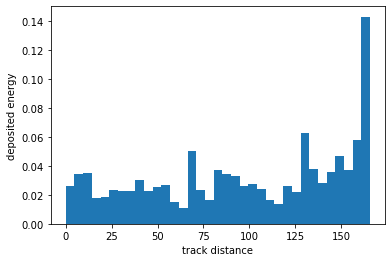

(48000286, 'e-')


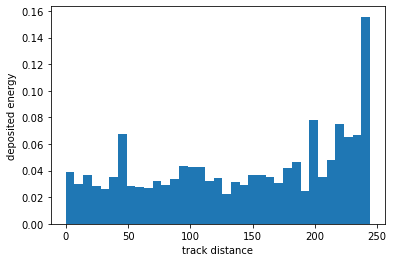

(48000287, 'e-')


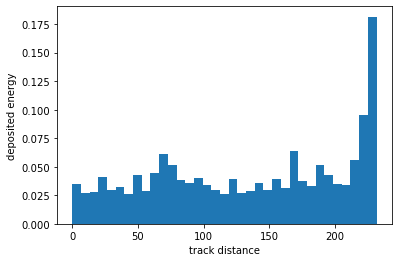

(48000288, 'e-')


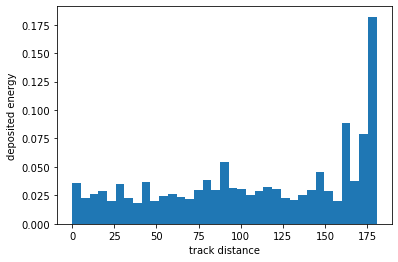

(48000289, 'e+')


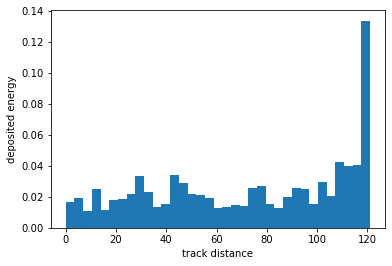

(48000289, 'e-')


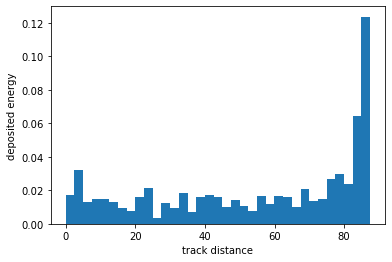

(48000290, 'e-')


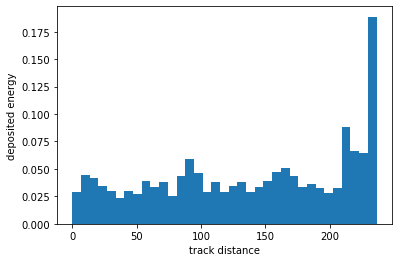

(48000291, 'e-')


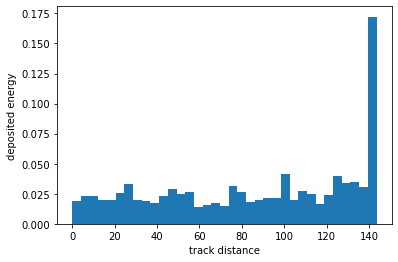

(48000292, 'e-')


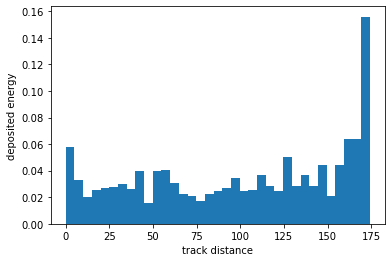

(48000293, 'e-')


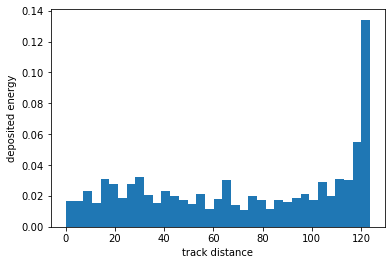

(48000294, 'e+')


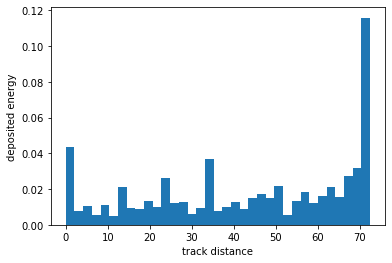

(48000294, 'e-')


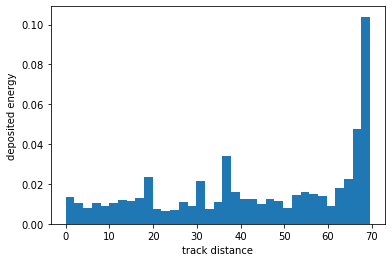

(48000295, 'e-')


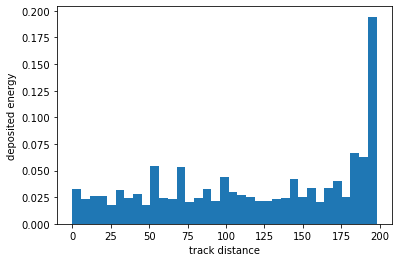

(48000296, 'e-')


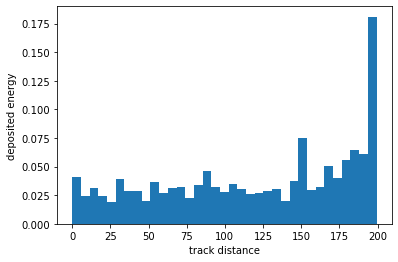

(48000297, 'e+')


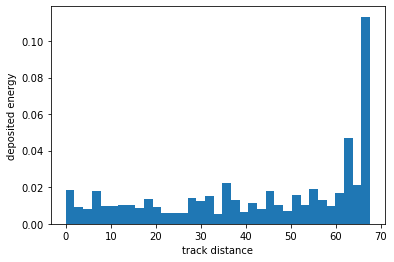

(48000297, 'e-')


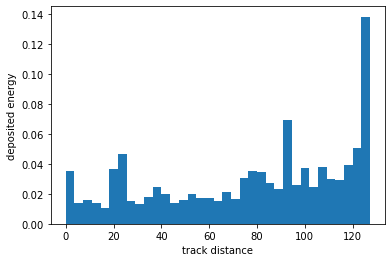

(48000298, 'e-')


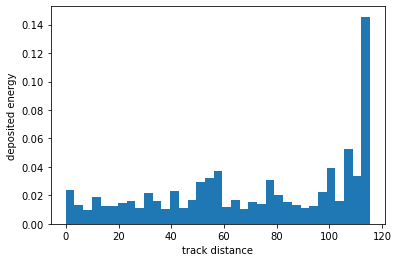

(48000299, 'e-')


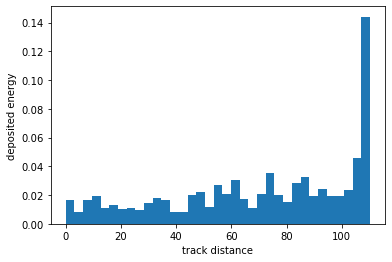

(48000300, 'e+')


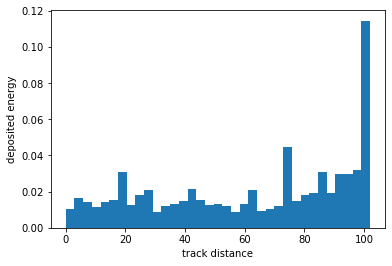

(48000300, 'e-')


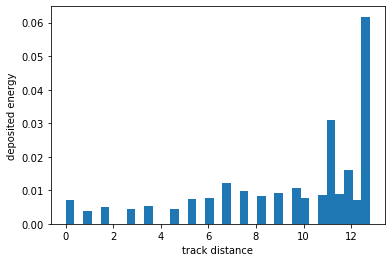

(48000301, 'e-')


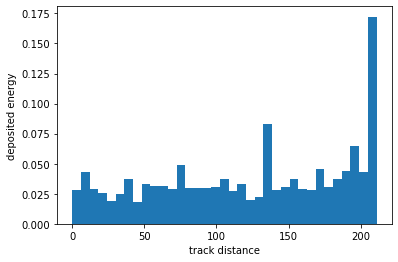

(48000302, 'e-')


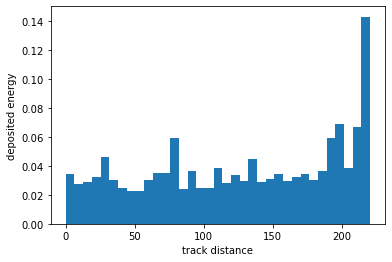

(48000303, 'e-')


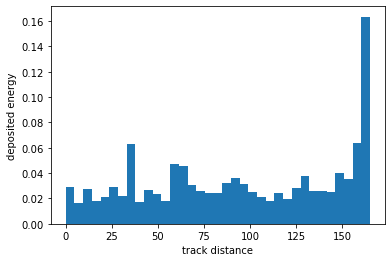

(48000304, 'e+')


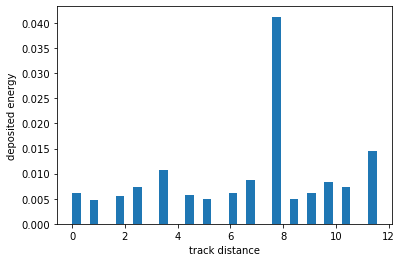

(48000304, 'e-')


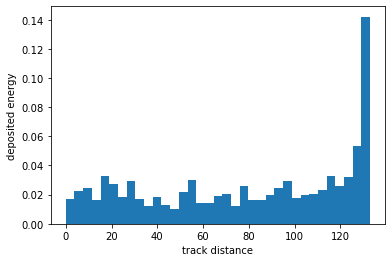

(48000305, 'e-')


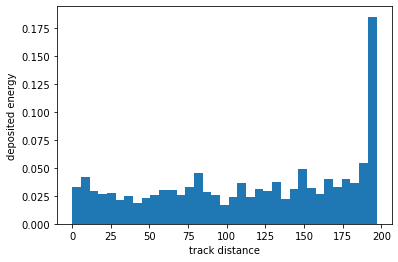

(48000306, 'e-')


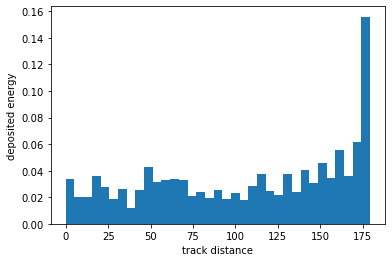

(48000307, 'e-')


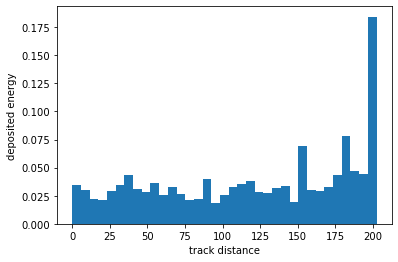

(48000308, 'e-')


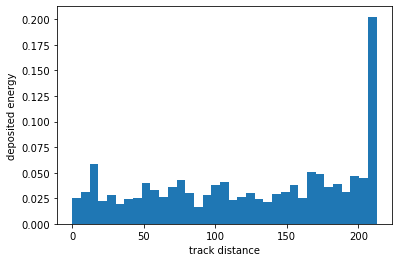

(48000309, 'e-')


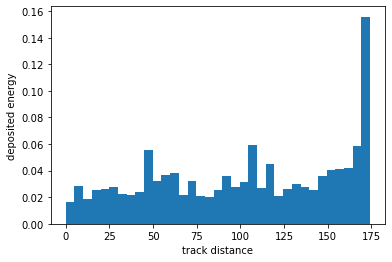

(48000310, 'e-')


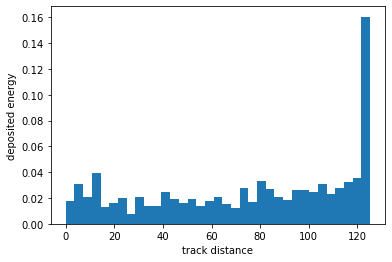

(48000311, 'e+')


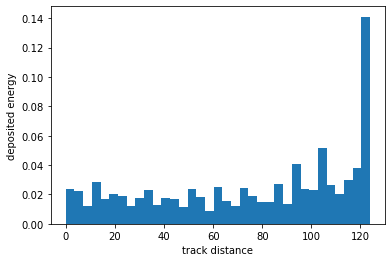

(48000311, 'e-')


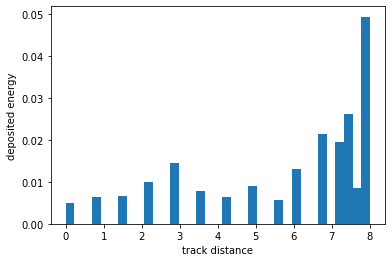

(48000312, 'e-')


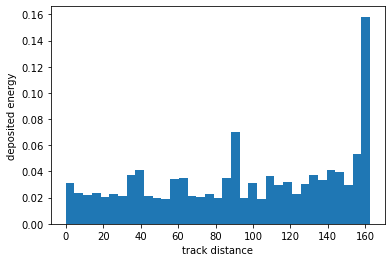

(48000313, 'e-')


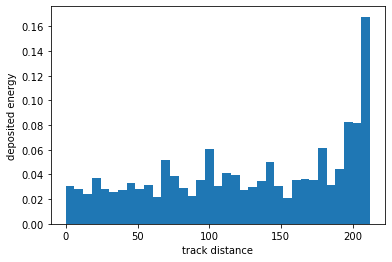

(48000314, 'e-')


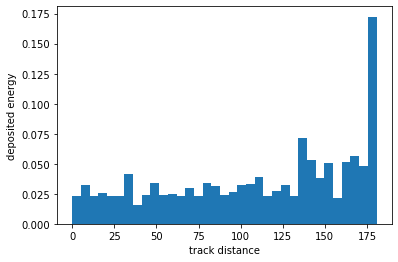

(48000315, 'e-')


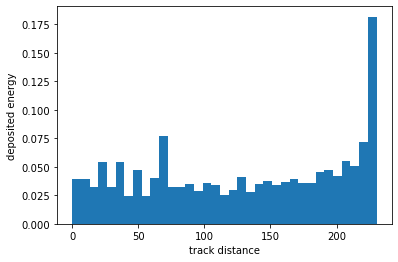

(48000316, 'e-')


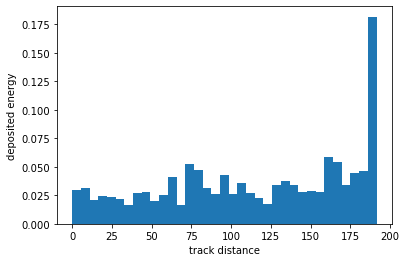

(48000317, 'e-')


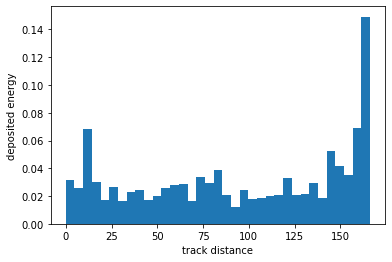

(48000318, 'e+')


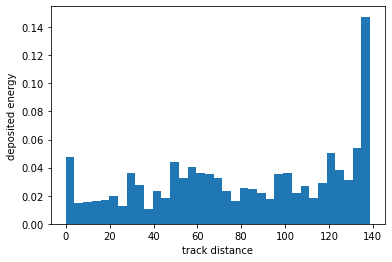

(48000318, 'e-')


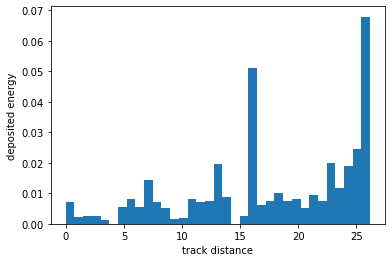

(48000319, 'e-')


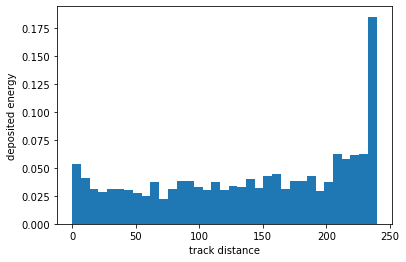

(48000320, 'e-')


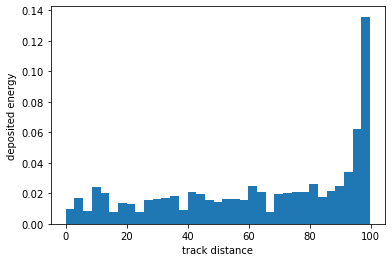

(48000321, 'e-')


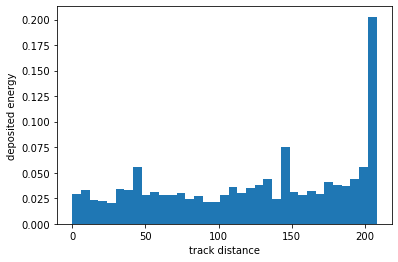

(48000322, 'e+')


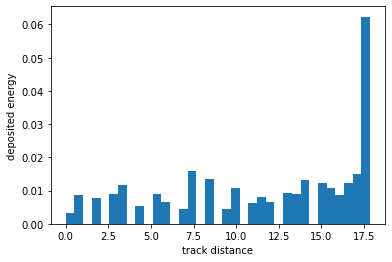

(48000322, 'e-')


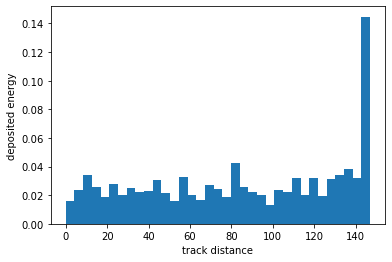

(48000323, 'e-')


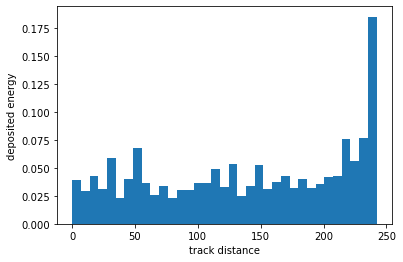

(48000324, 'e-')


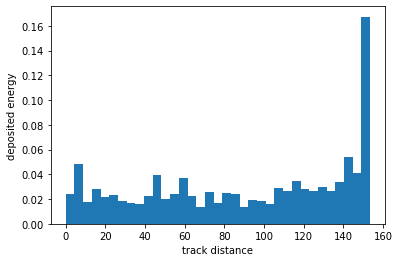

(48000325, 'e+')


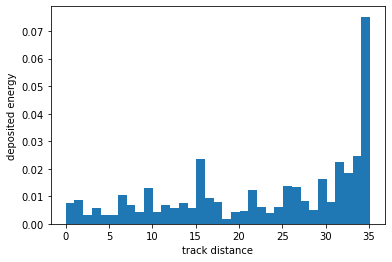

(48000325, 'e-')


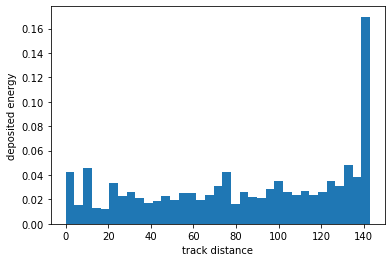

(48000326, 'e-')


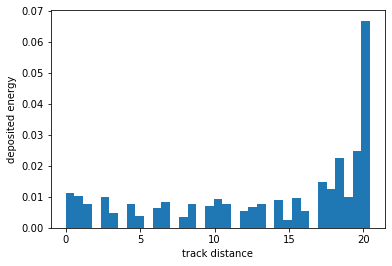

(48000327, 'e-')


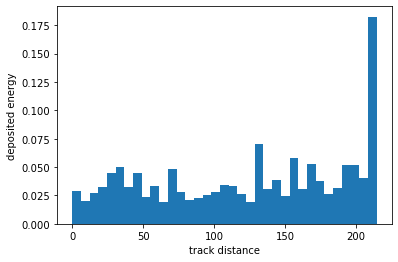

(48000328, 'e-')


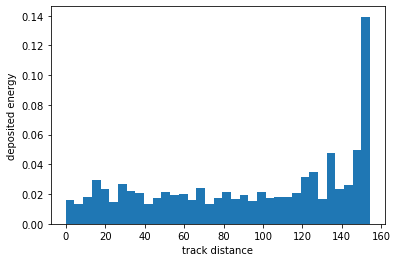

(48000329, 'e+')


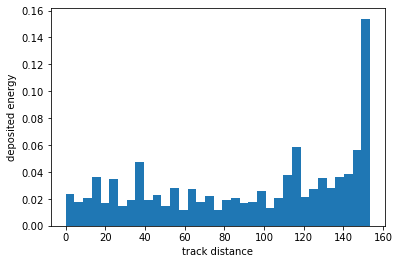

(48000329, 'e-')


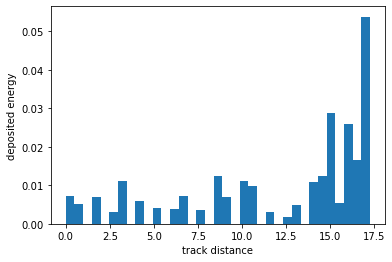

(48000331, 'e+')


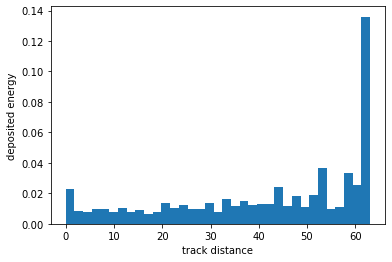

(48000331, 'e-')


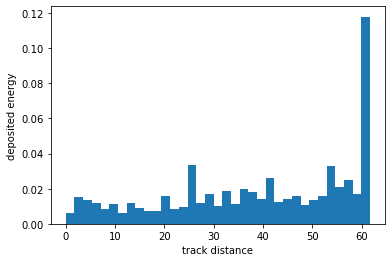

(48000332, 'e-')


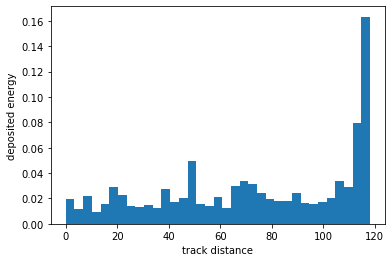

(48000333, 'e-')


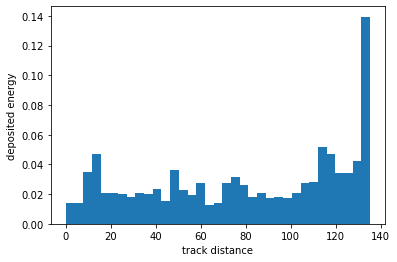

(48000334, 'e-')


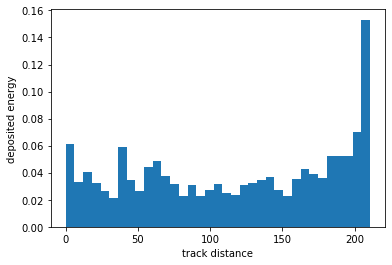

(48000335, 'e-')


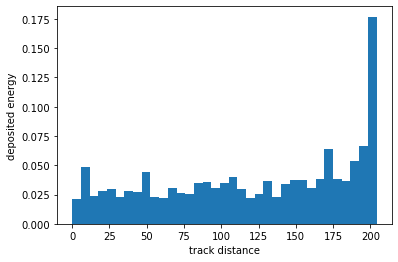

(48000336, 'e-')


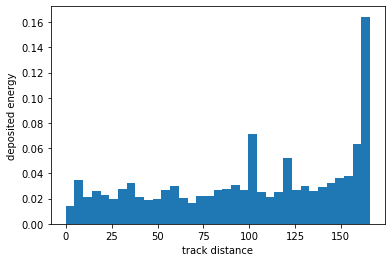

(48000337, 'e-')


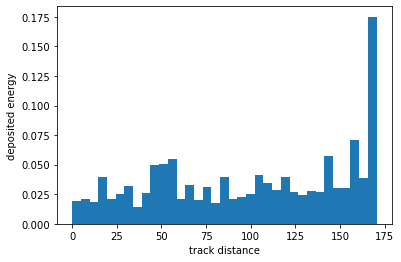

(48000338, 'e-')


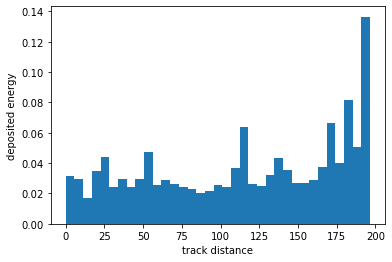

(48000339, 'e-')


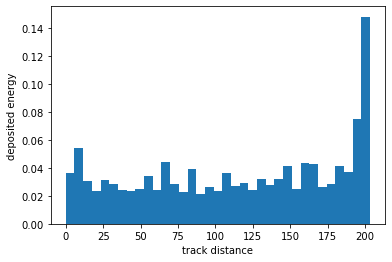

(48000340, 'e-')


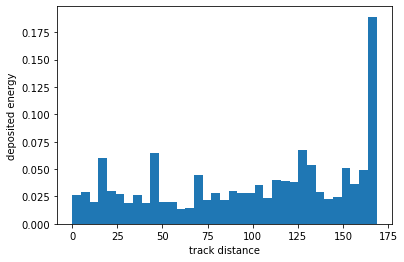

(48000341, 'e+')


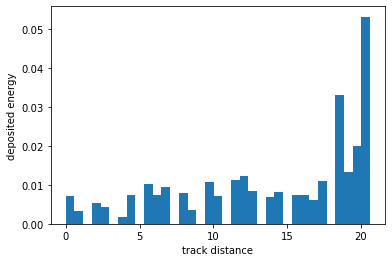

(48000341, 'e-')


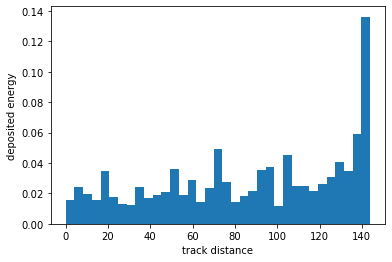

(48000342, 'e-')


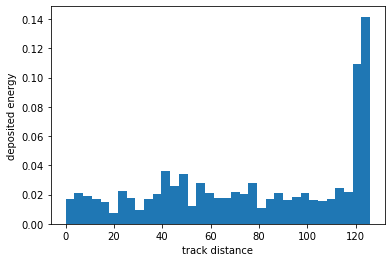

(48000343, 'e-')


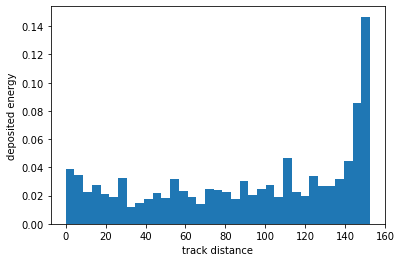

(48000344, 'e+')


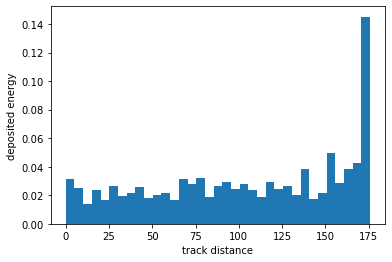

(48000344, 'e-')


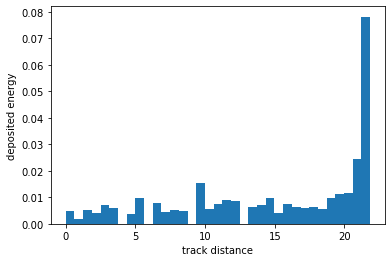

(48000345, 'e-')


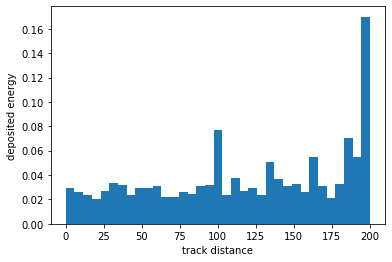

(48000347, 'e-')


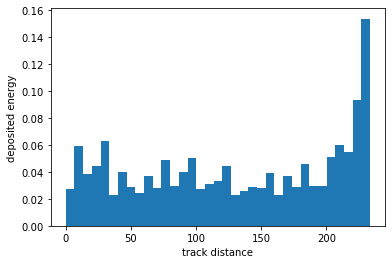

(48000348, 'e-')


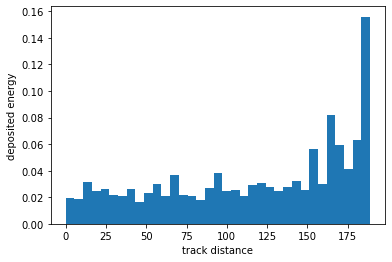

(48000349, 'e-')


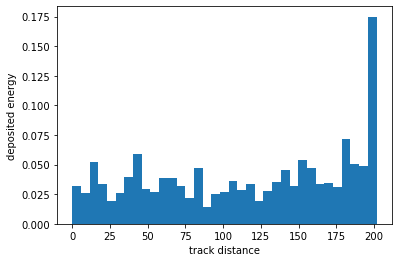

(48000350, 'e-')


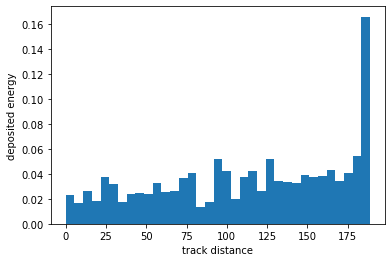

(48000351, 'e+')


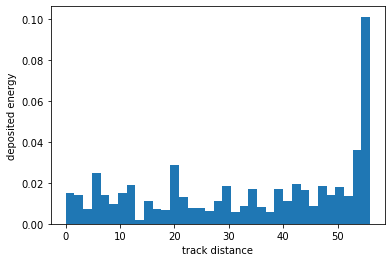

(48000351, 'e-')


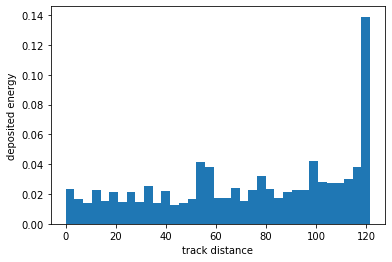

(48000352, 'e-')


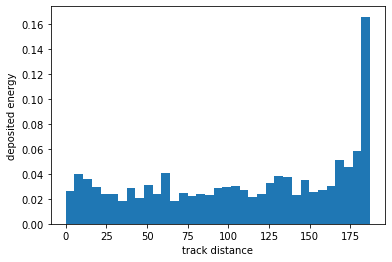

(48000353, 'e-')


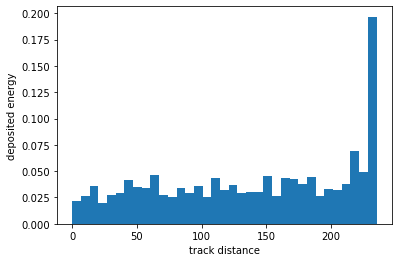

(48000354, 'e-')


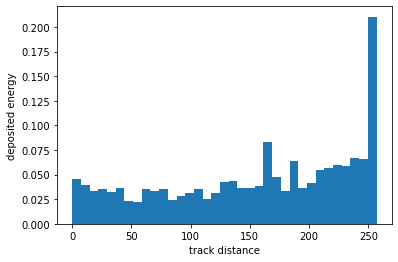

(48000355, 'e-')


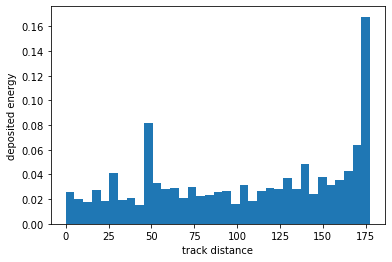

(48000356, 'e-')


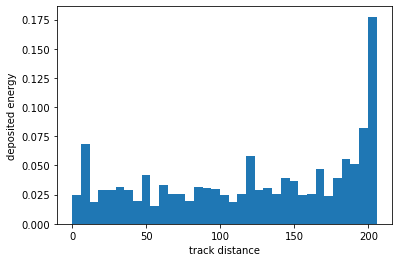

(48000357, 'e+')


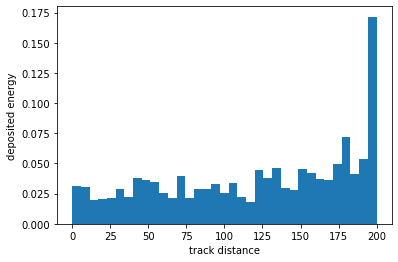

(48000357, 'e-')


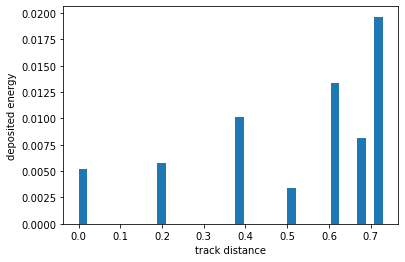

(48000358, 'e-')


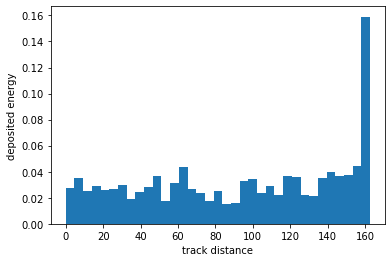

(48000359, 'e-')


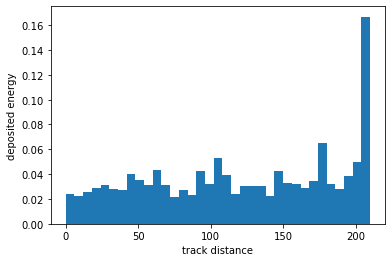

(48000360, 'e+')


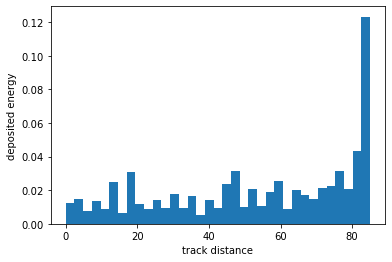

(48000360, 'e-')


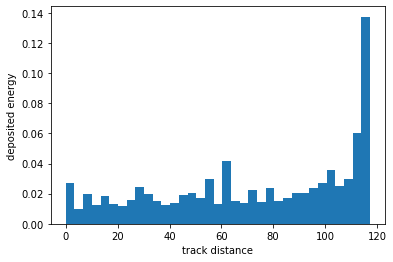

(48000361, 'e-')


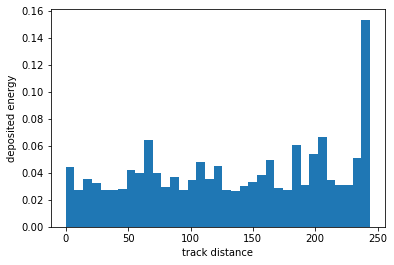

(48000362, 'e-')


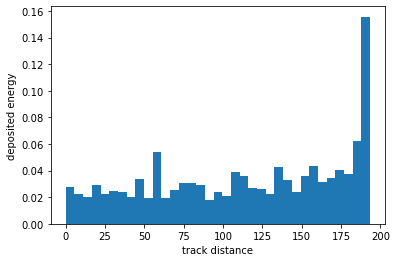

(48000363, 'e+')


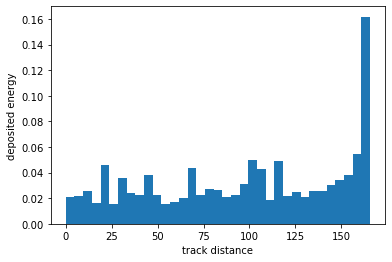

(48000363, 'e-')


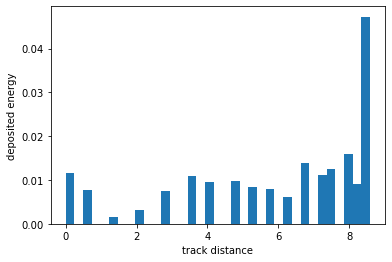

(48000364, 'e-')


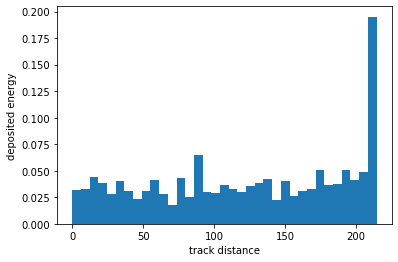

(48000365, 'e-')


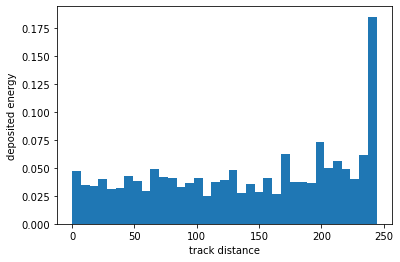

(48000366, 'e-')


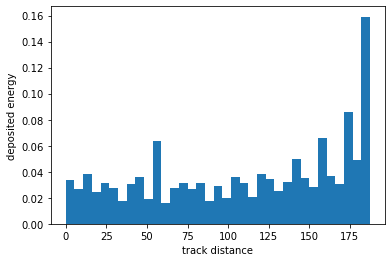

(48000367, 'e-')


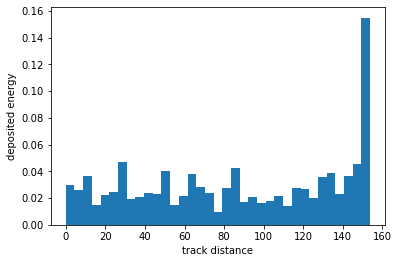

(48000368, 'e-')


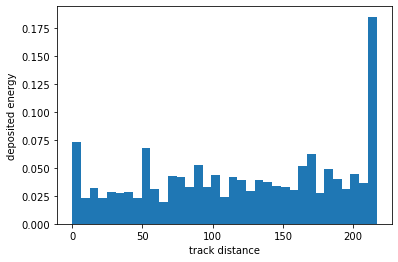

(48000369, 'e-')


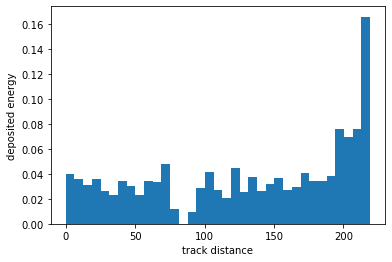

(48000370, 'e+')


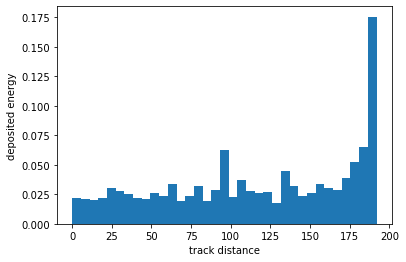

(48000370, 'e-')


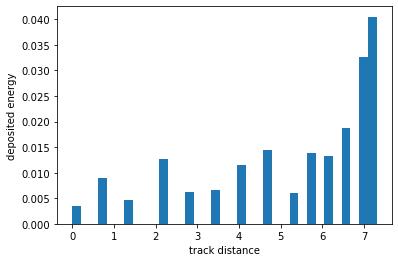

(48000371, 'e+')


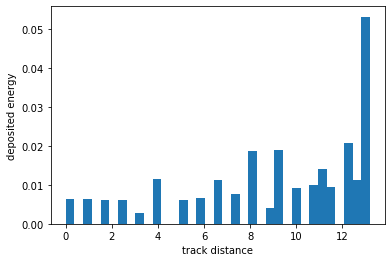

(48000371, 'e-')


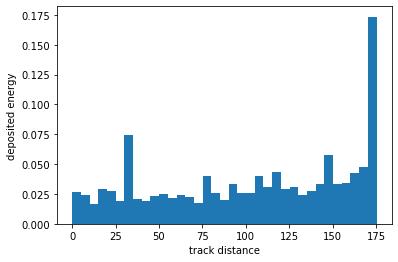

(48000372, 'e-')


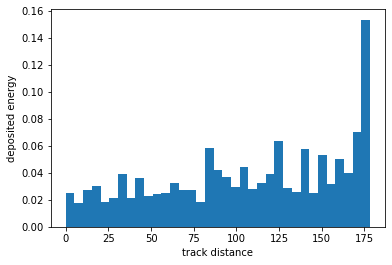

(48000373, 'e-')


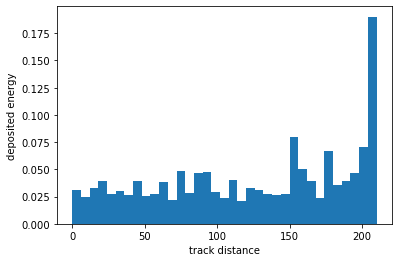

(48000374, 'e-')


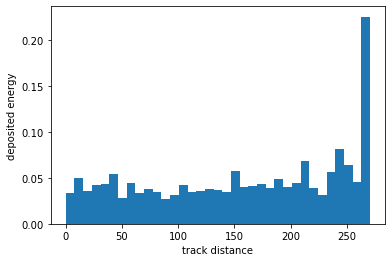

(48000375, 'e+')


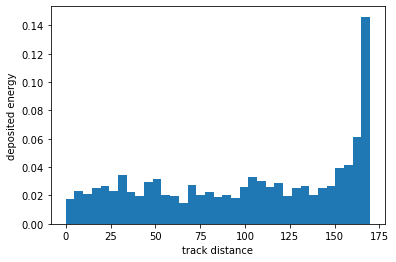

(48000375, 'e-')


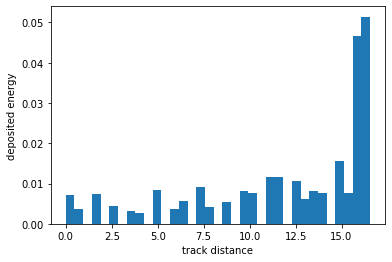

(48000376, 'e+')


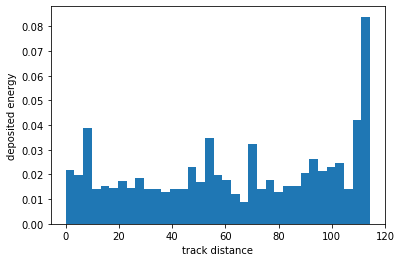

(48000376, 'e-')


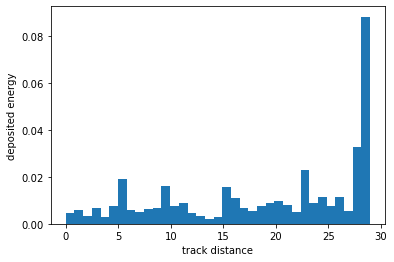

(48000377, 'e-')


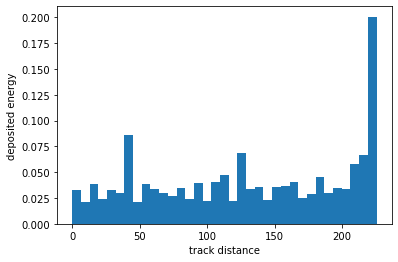

(48000378, 'e-')


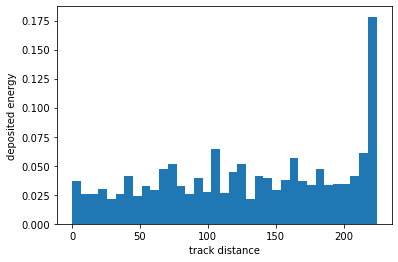

(48000379, 'e+')


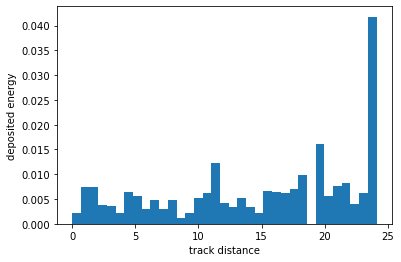

(48000379, 'e-')


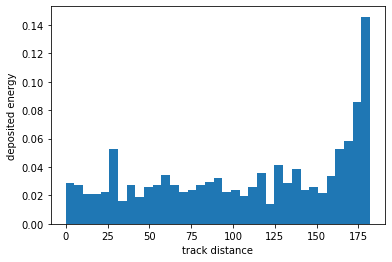

(48000381, 'e-')


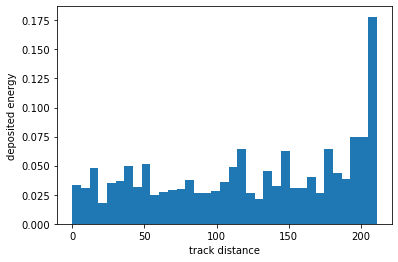

(48000382, 'e-')


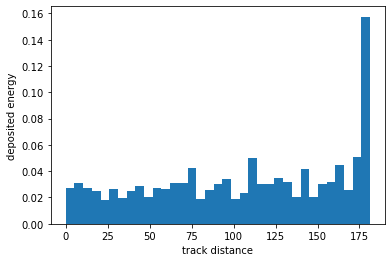

(48000383, 'e-')


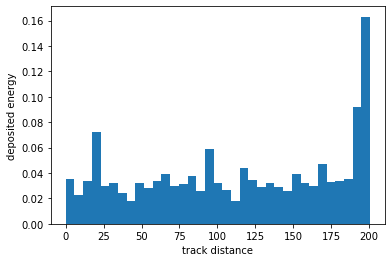

(48000384, 'e-')


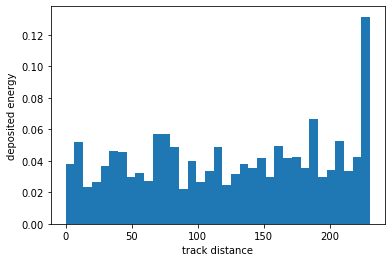

(48000385, 'e-')


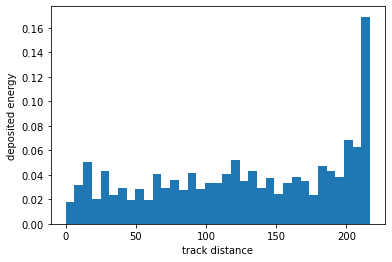

(48000386, 'e-')


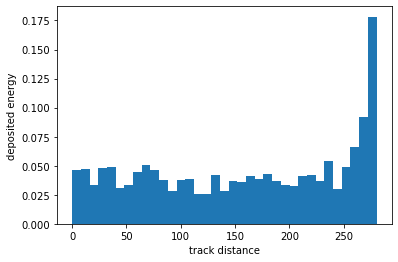

(48000387, 'e-')


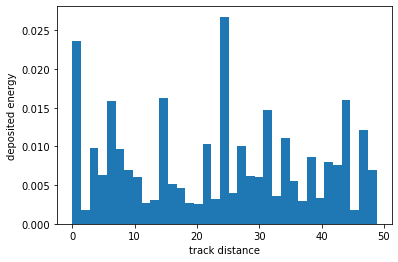

(48000388, 'e+')


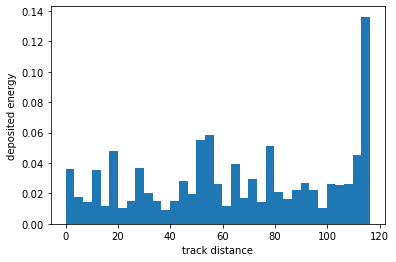

(48000388, 'e-')


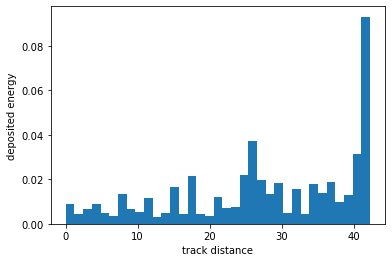

(48000389, 'e-')


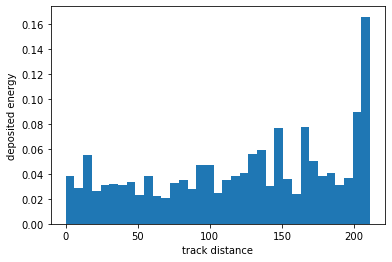

(48000390, 'e-')


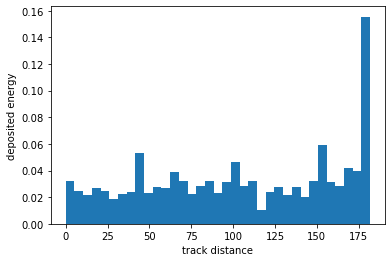

(48000391, 'e-')


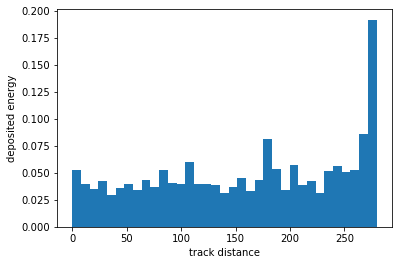

(48000392, 'e+')


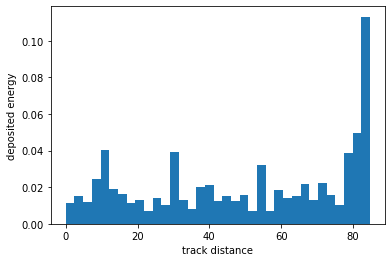

(48000392, 'e-')


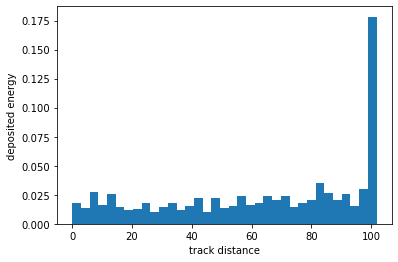

(48000393, 'e-')


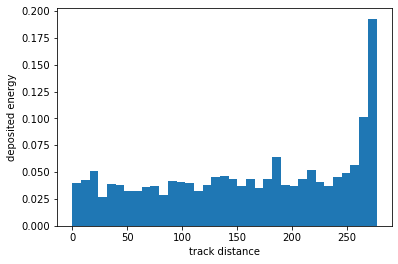

(48000394, 'e-')


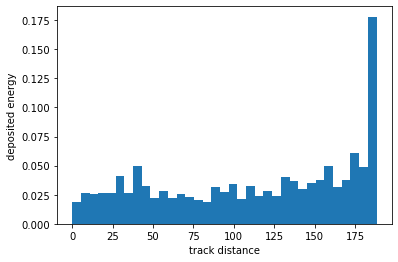

(48000395, 'e-')


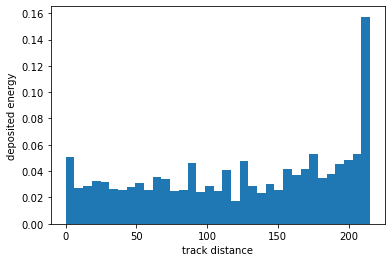

(48000396, 'e+')


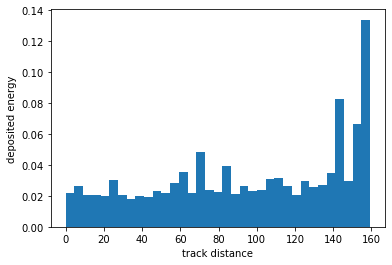

(48000396, 'e-')


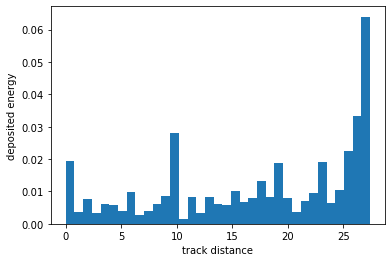

(48000397, 'e+')


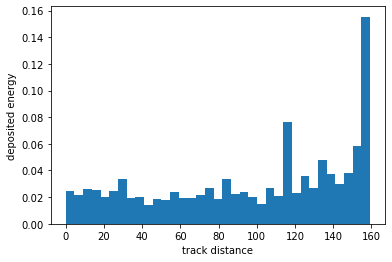

(48000397, 'e-')


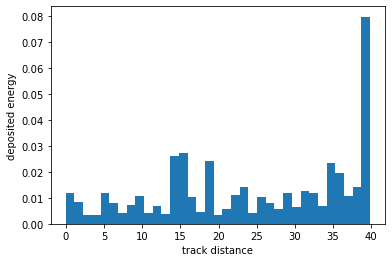

(48000398, 'e-')


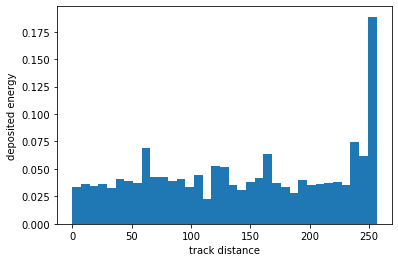

(48000399, 'e-')


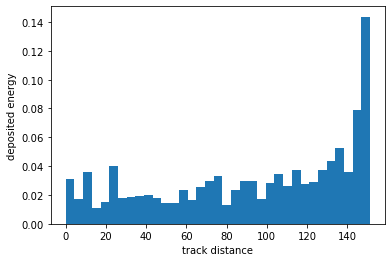

(48000400, 'e-')


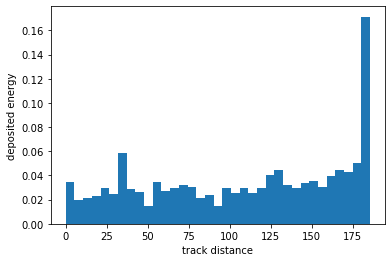

(48000401, 'e+')


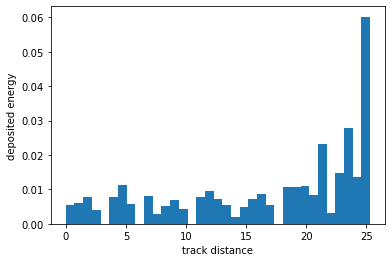

(48000401, 'e-')


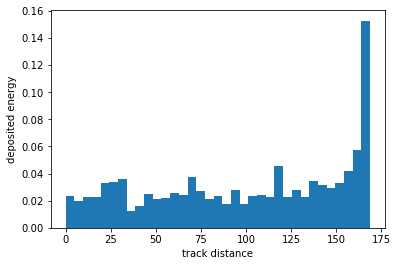

(48000402, 'e-')


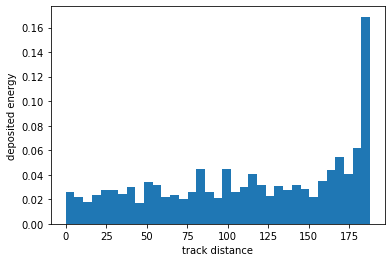

(48000403, 'e+')


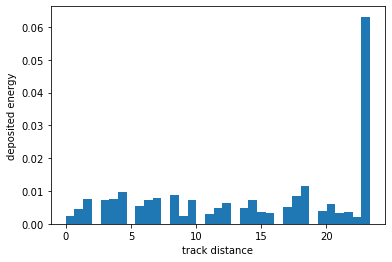

(48000403, 'e-')


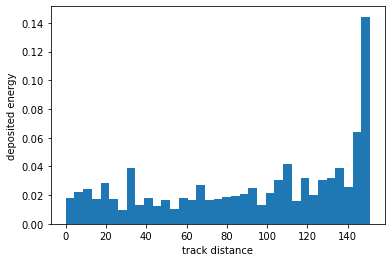

(48000404, 'e+')


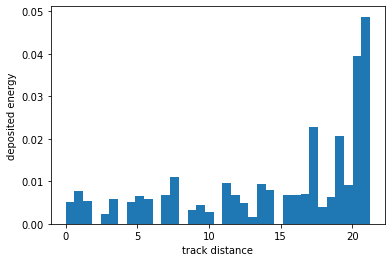

(48000404, 'e-')


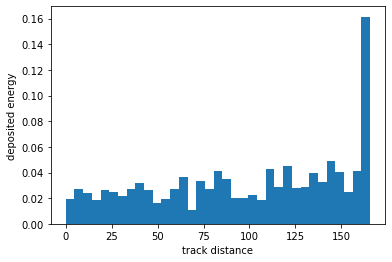

(48000405, 'e+')


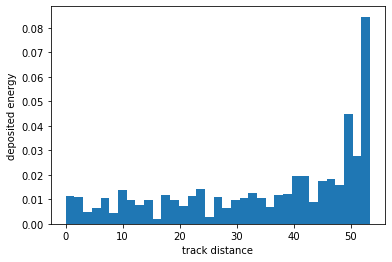

(48000405, 'e-')


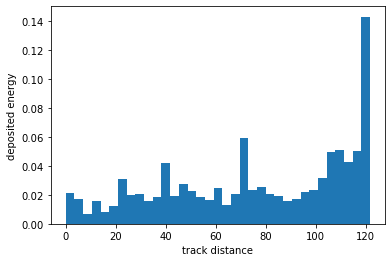

(48000406, 'e+')


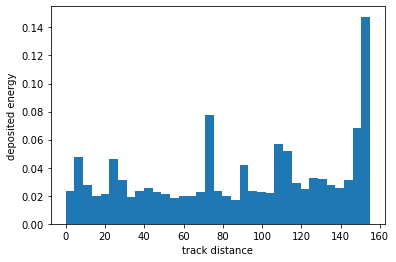

(48000406, 'e-')


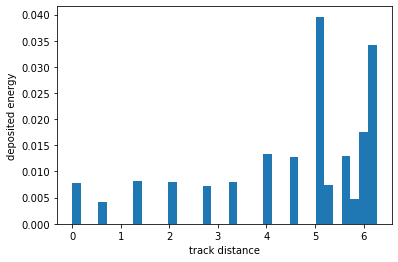

(48000407, 'e-')


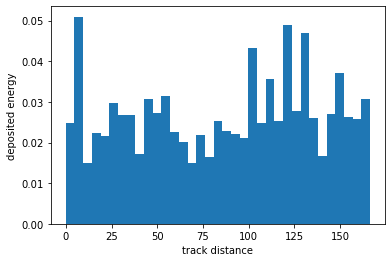

(48000408, 'e-')


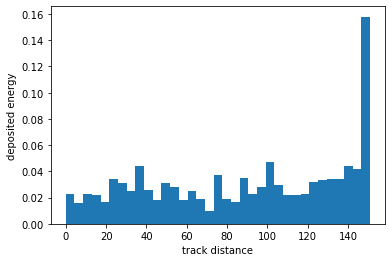

(48000409, 'e+')


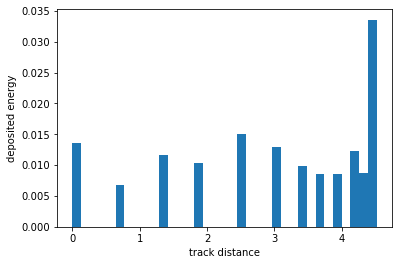

(48000409, 'e-')


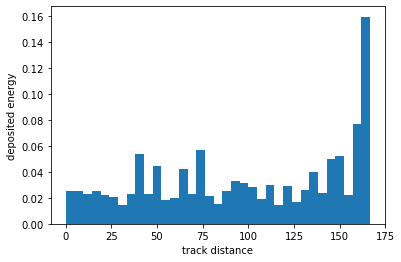

(48000410, 'e-')


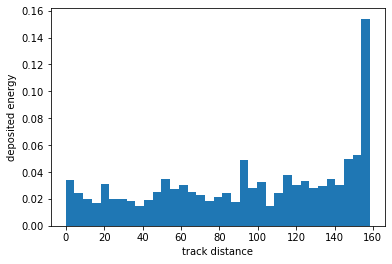

(48000411, 'e-')


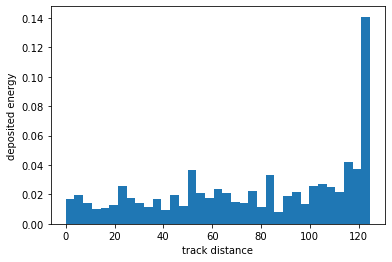

(48000412, 'e-')


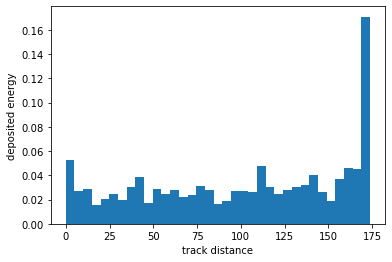

(48000413, 'e-')


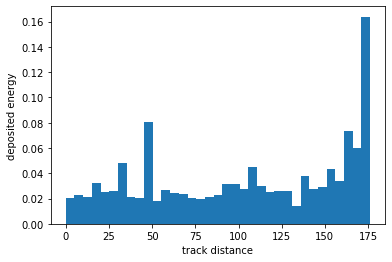

(48000414, 'e-')


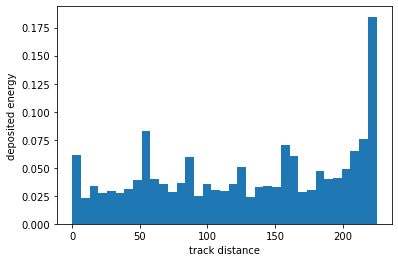

(48000415, 'e-')


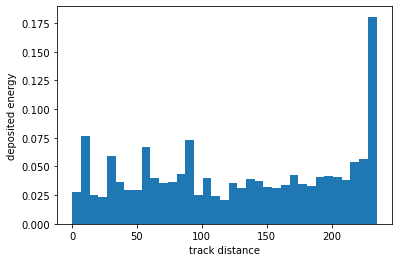

(48000416, 'e+')


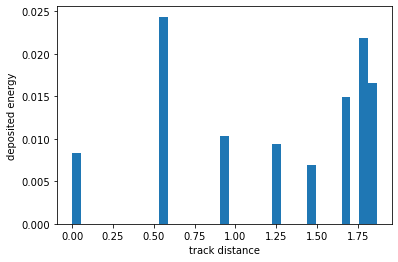

(48000416, 'e-')


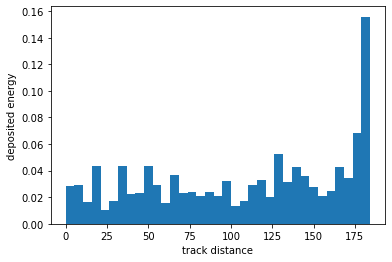

(48000417, 'e-')


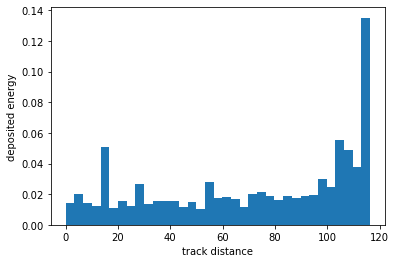

(48000418, 'e-')


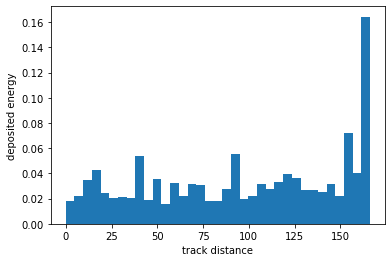

(48000419, 'e-')


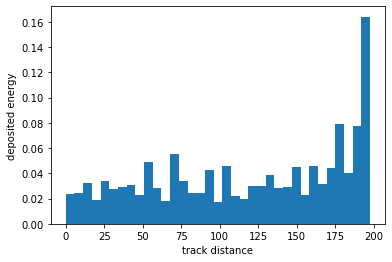

(48000420, 'e-')


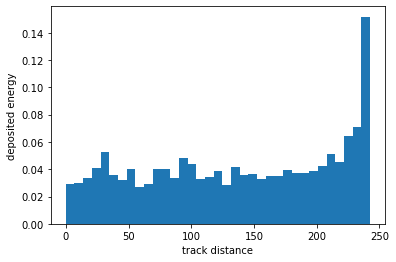

(48000421, 'e-')


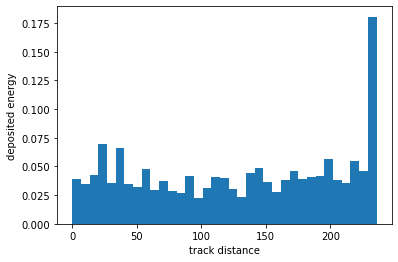

(48000422, 'e-')


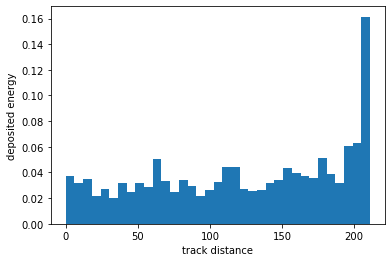

(48000423, 'e-')


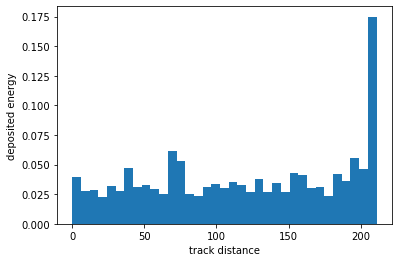

(48000424, 'e-')


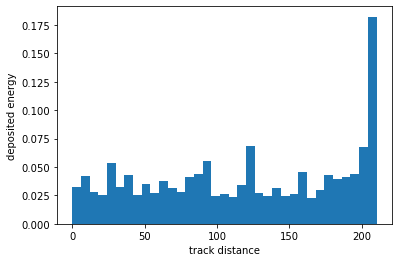

(48000425, 'e-')


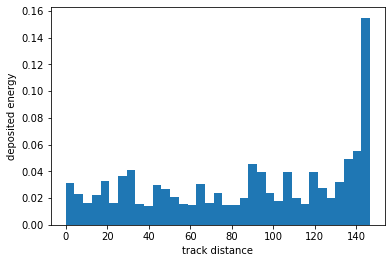

(48000426, 'e+')


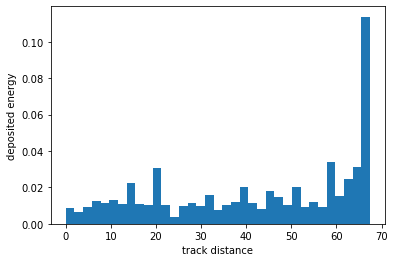

(48000426, 'e-')


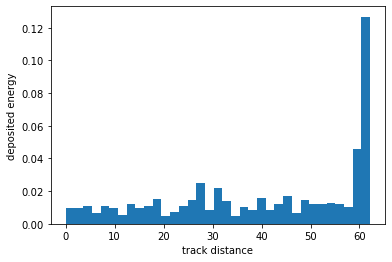

(48000427, 'e-')


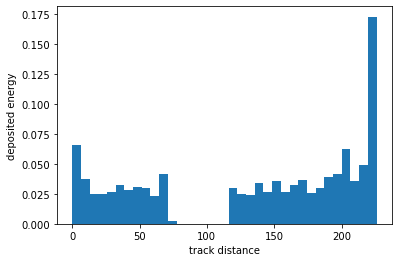

(48000428, 'e-')


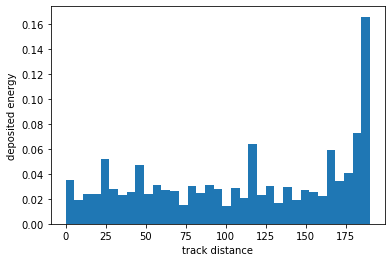

(48000429, 'e-')


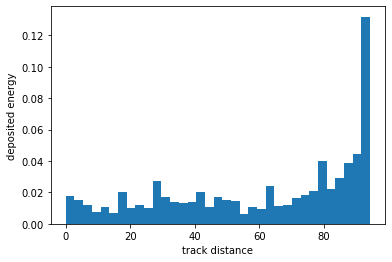

(48000430, 'e-')


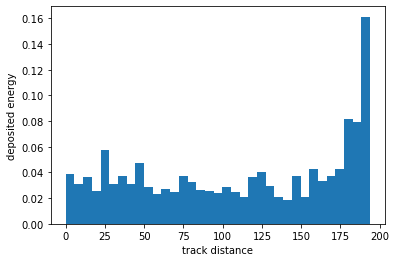

(48000431, 'e-')


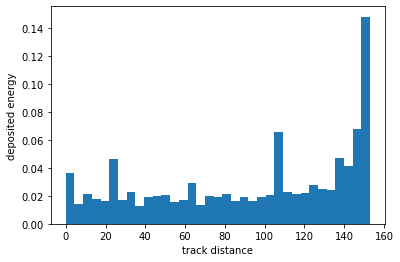

(48000432, 'e-')


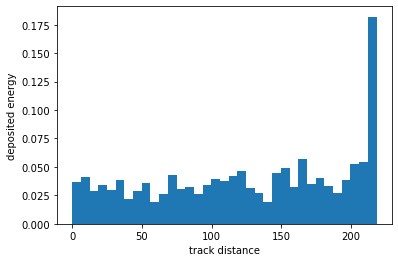

(48000433, 'e+')


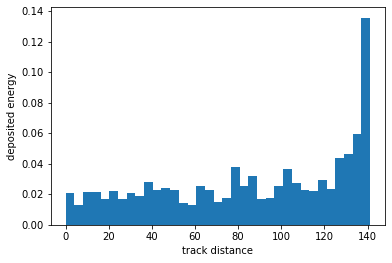

(48000433, 'e-')


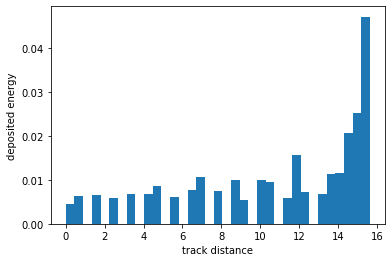

(48000434, 'e-')


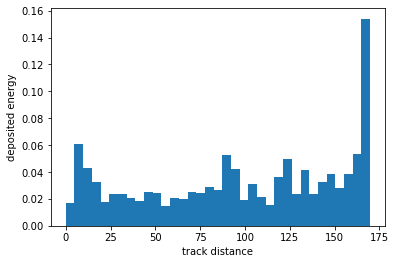

(48000435, 'e-')


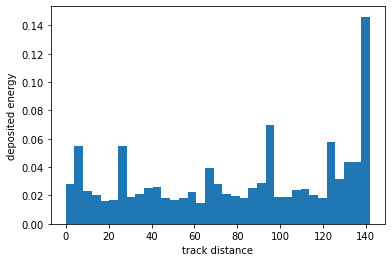

(48000436, 'e-')


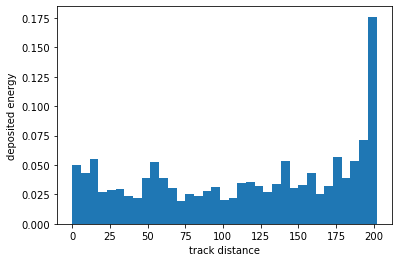

(48000437, 'e-')


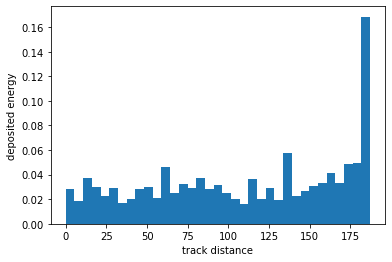

(48000439, 'e-')


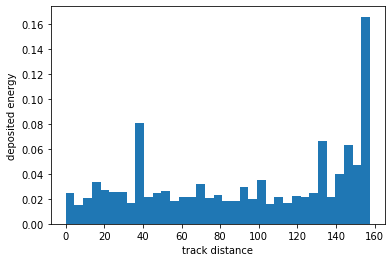

(48000440, 'e-')


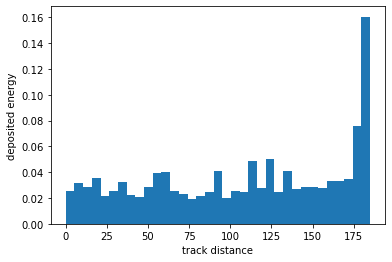

(48000441, 'e-')


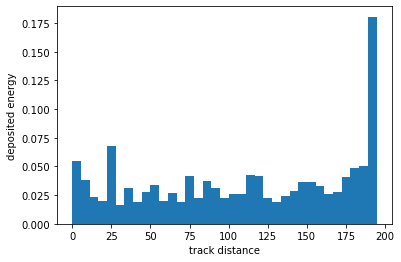

(48000442, 'e-')


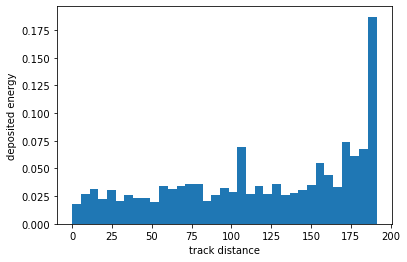

(48000443, 'e+')


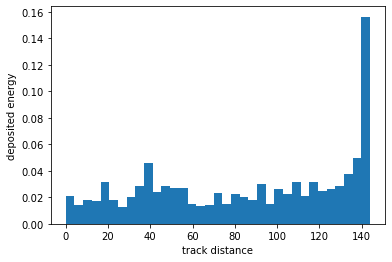

(48000443, 'e-')


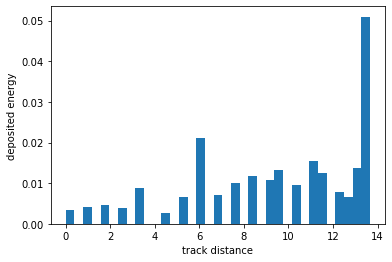

(48000444, 'e+')


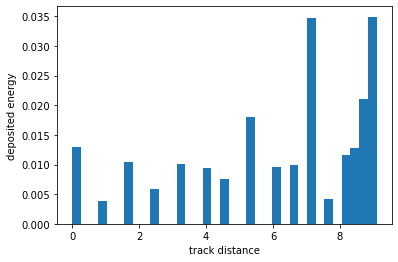

(48000444, 'e-')


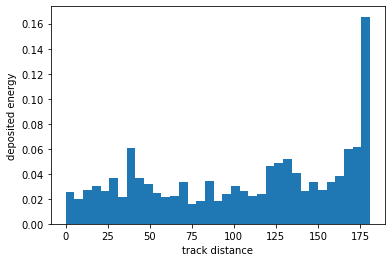

(48000445, 'e-')


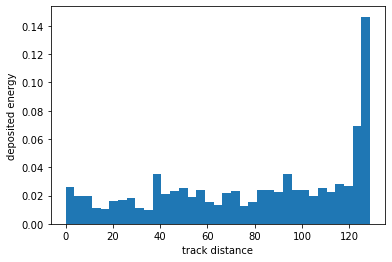

(48000446, 'e-')


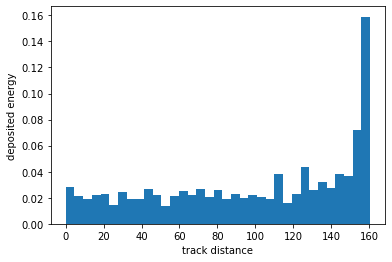

(48000447, 'e-')


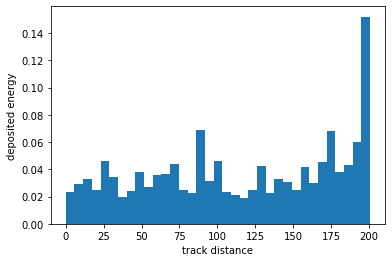

(48000448, 'e-')


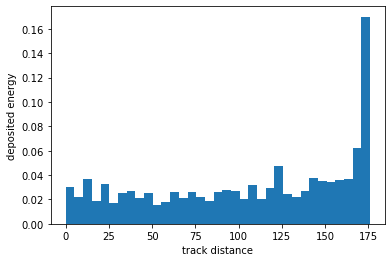

(48000449, 'e-')


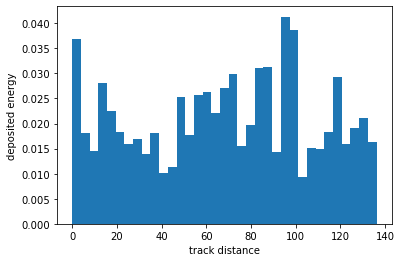

(48000450, 'e+')


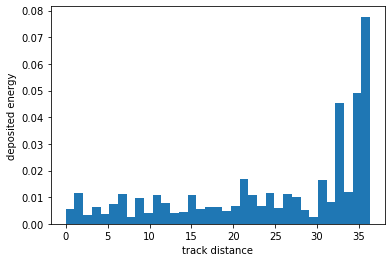

(48000450, 'e-')


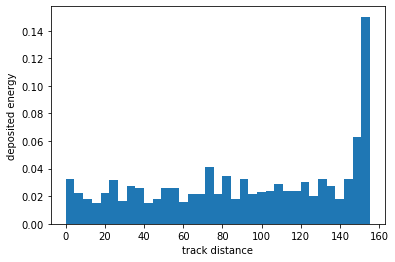

(48000451, 'e+')


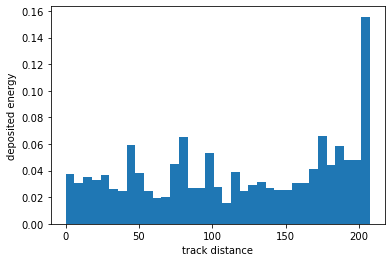

(48000451, 'e-')


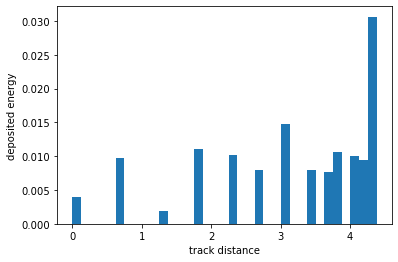

(48000452, 'e-')


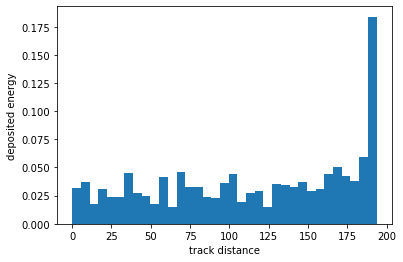

(48000453, 'e+')


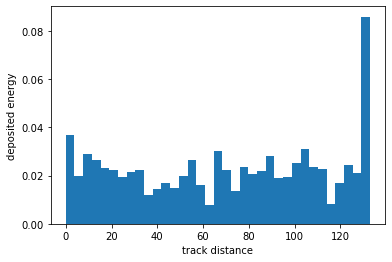

(48000453, 'e-')


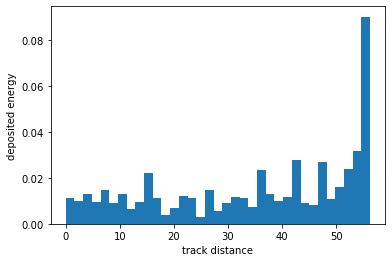

(48000454, 'e+')


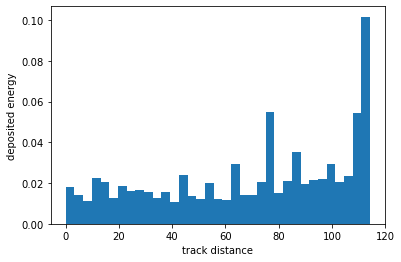

(48000454, 'e-')


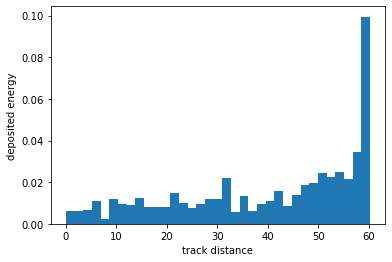

(48000455, 'e+')


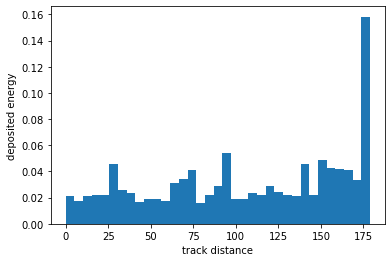

(48000455, 'e-')


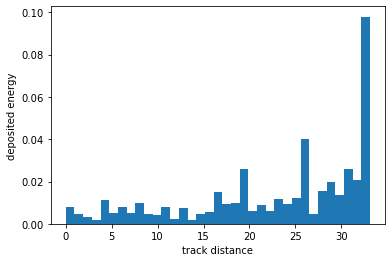

(48000457, 'e-')


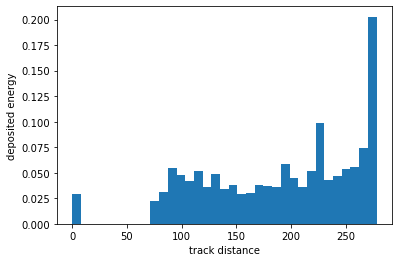

(48000458, 'e-')


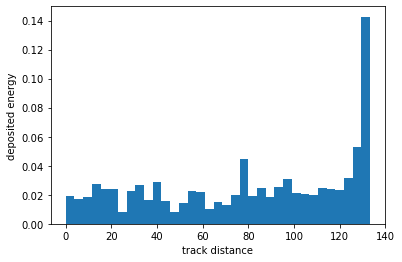

(48000459, 'e-')


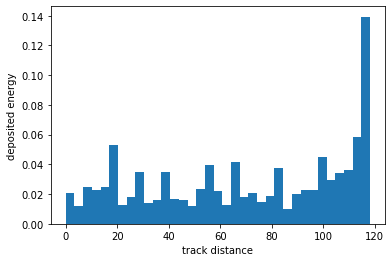

(48000460, 'e+')


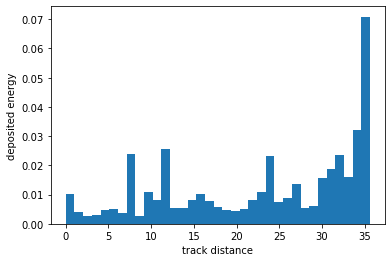

(48000460, 'e-')


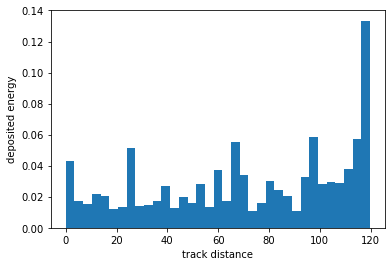

(48000461, 'e-')


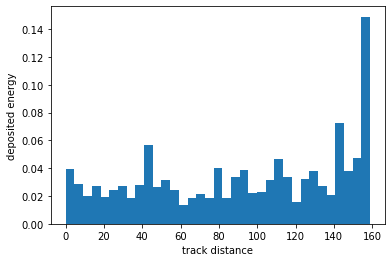

(48000462, 'e+')


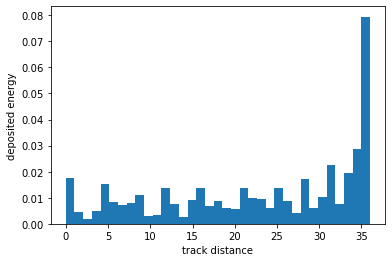

(48000462, 'e-')


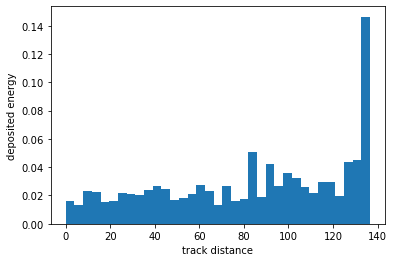

(48000464, 'e+')


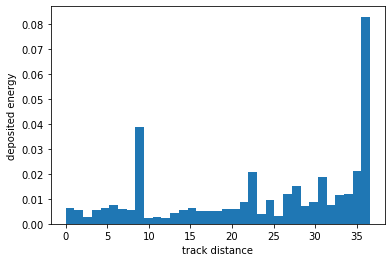

(48000464, 'e-')


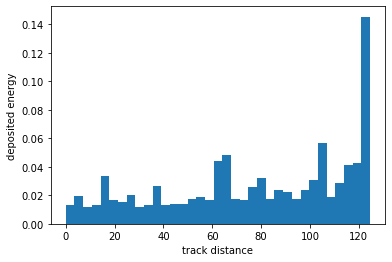

(48000465, 'e-')


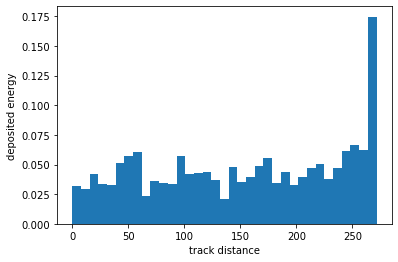

(48000466, 'e-')


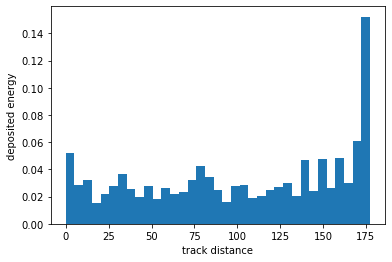

(48000467, 'e-')


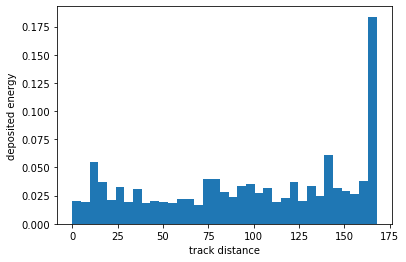

(48000468, 'e-')


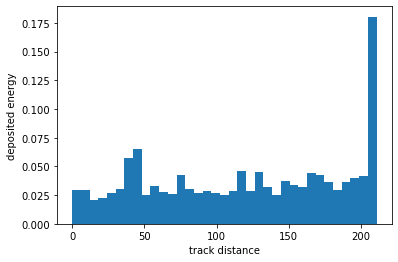

(48000469, 'e+')


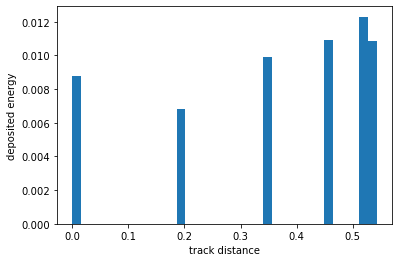

(48000469, 'e-')


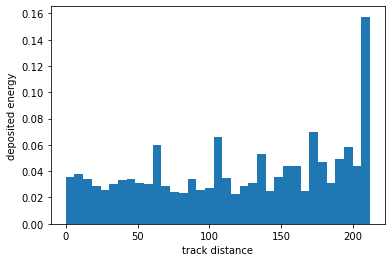

(48000470, 'e+')


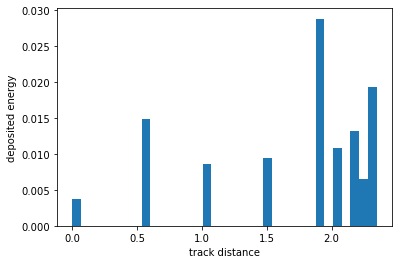

(48000470, 'e-')


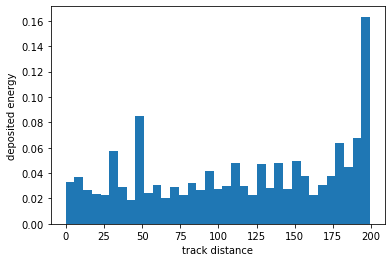

(48000471, 'e+')


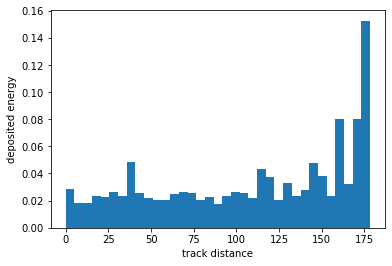

(48000471, 'e-')


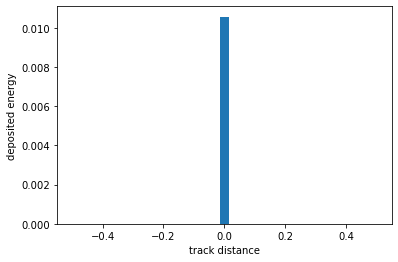

(48000472, 'e+')


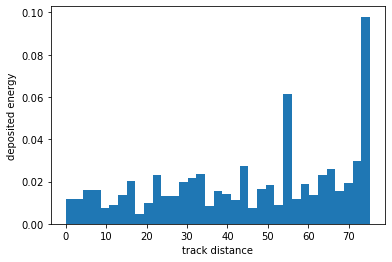

(48000472, 'e-')


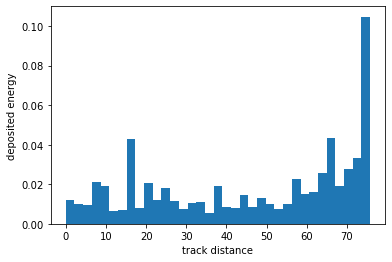

(48000473, 'e-')


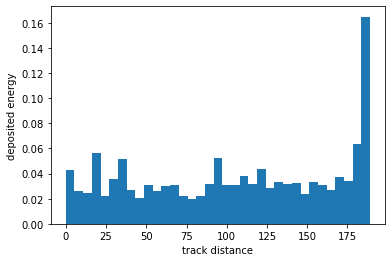

(48000474, 'e+')


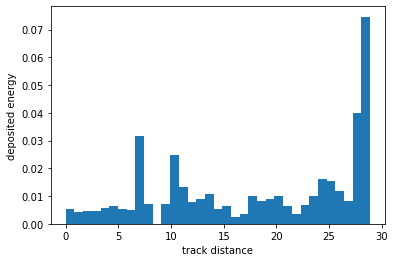

(48000474, 'e-')


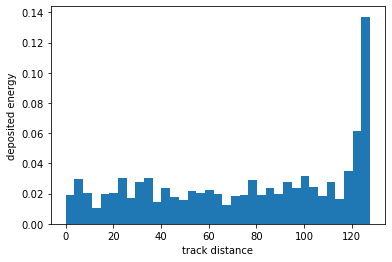

(48000475, 'e-')


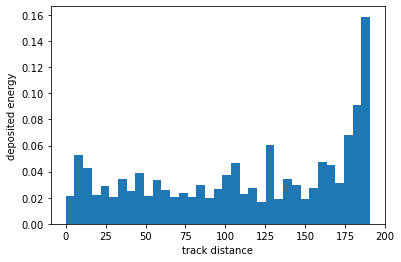

(48000476, 'e-')


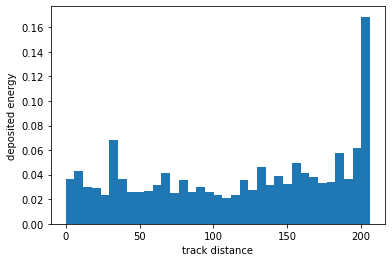

(48000477, 'e+')


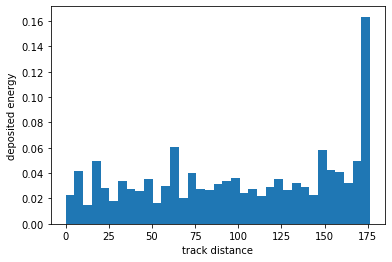

(48000477, 'e-')


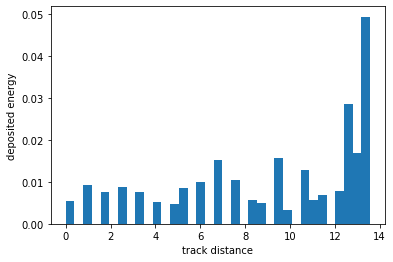

(48000478, 'e-')


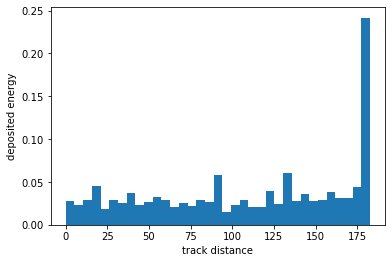

(48000479, 'e-')


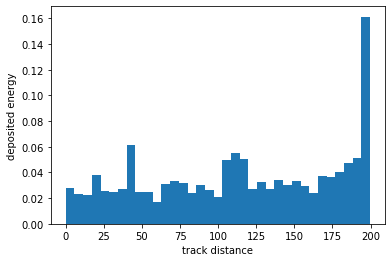

(48000480, 'e-')


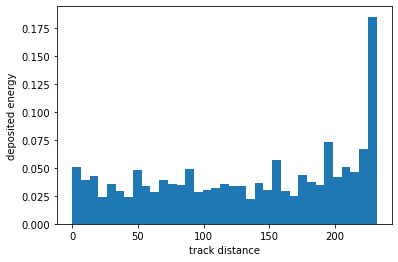

(48000481, 'e-')


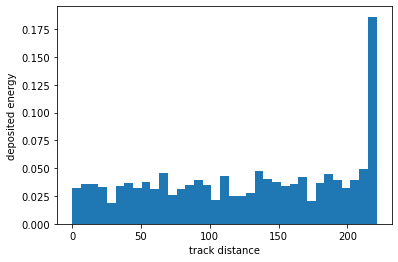

(48000482, 'e+')


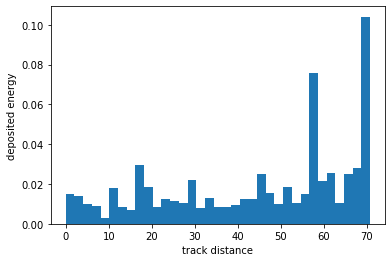

(48000482, 'e-')


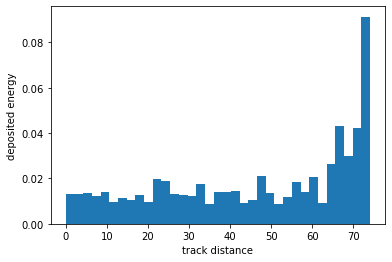

(48000483, 'e+')


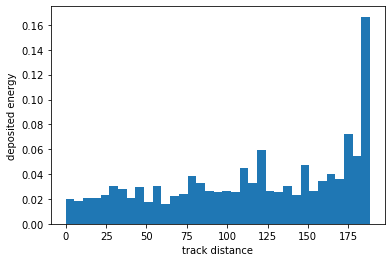

(48000483, 'e-')


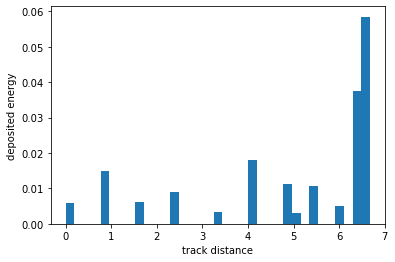

(48000484, 'e-')


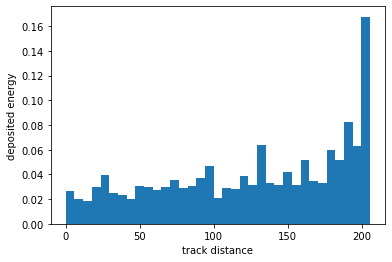

(48000485, 'e-')


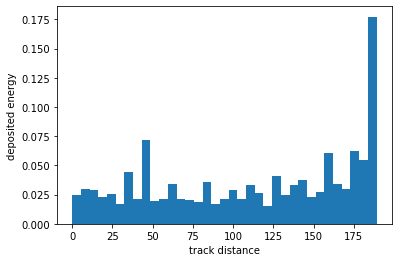

(48000486, 'e-')


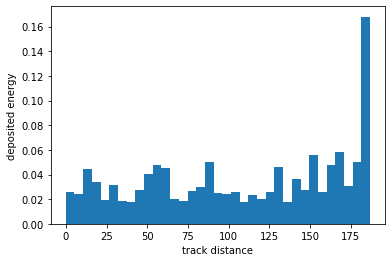

(48000487, 'e-')


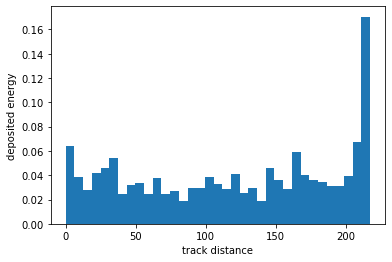

(48000488, 'e-')


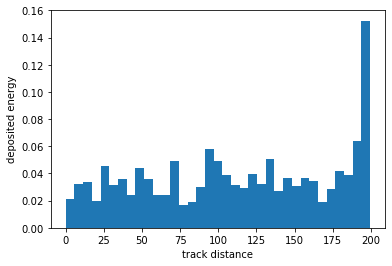

(48000489, 'e+')


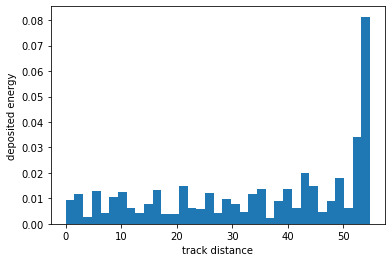

(48000489, 'e-')


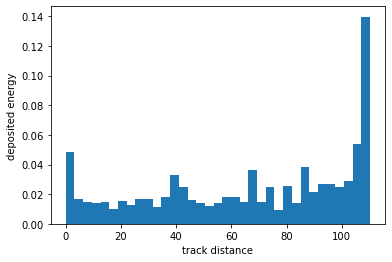

(48000490, 'e-')


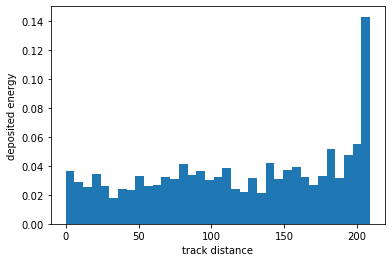

(48000491, 'e-')


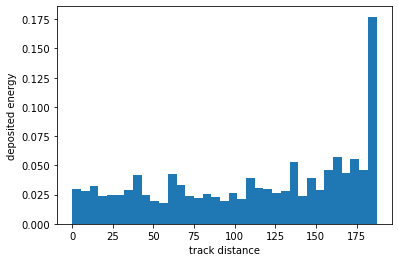

(48000492, 'e-')


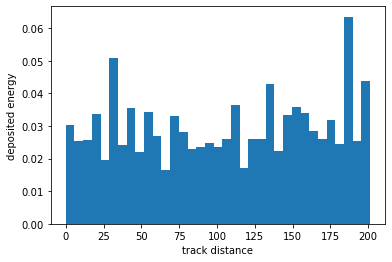

(48000493, 'e-')


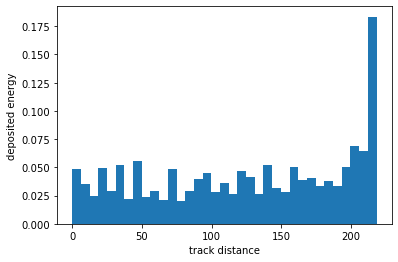

(48000494, 'e+')


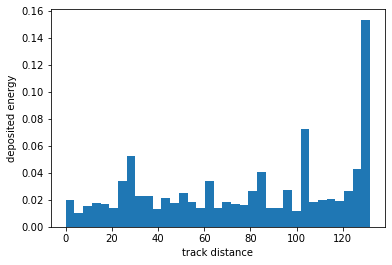

(48000494, 'e-')


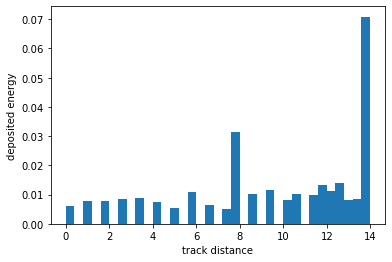

(48000495, 'e-')


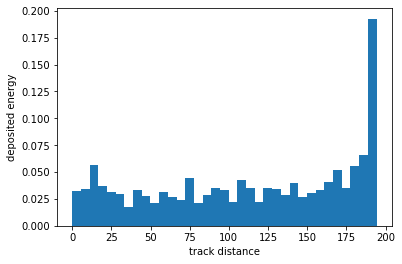

(48000496, 'e-')


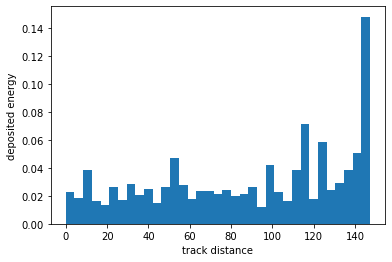

(48000497, 'e-')


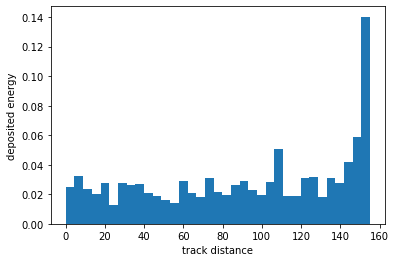

(48000498, 'e-')


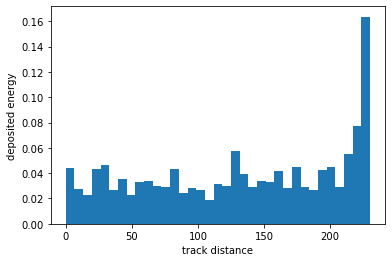

(48000499, 'e-')


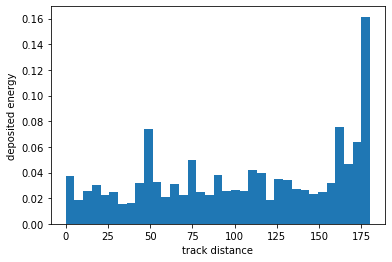

(48000500, 'e-')


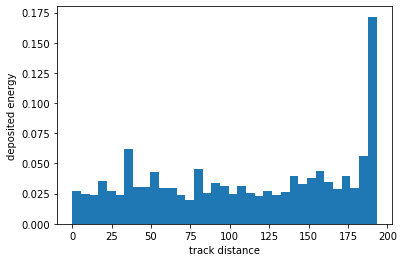

(48000501, 'e+')


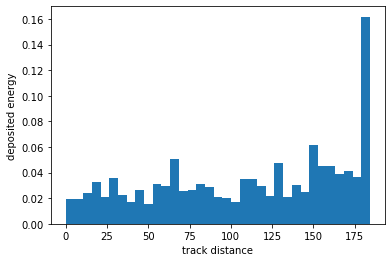

(48000501, 'e-')


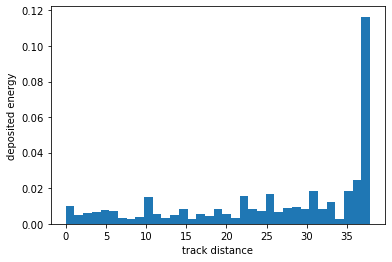

(48000502, 'e-')


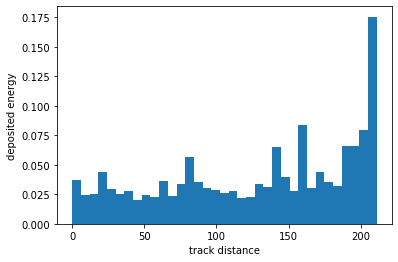

(48000503, 'e-')


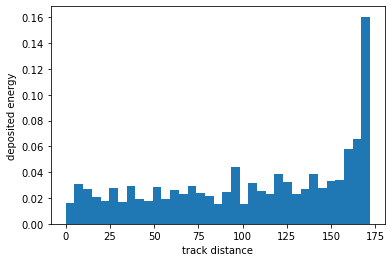

(48000504, 'e-')


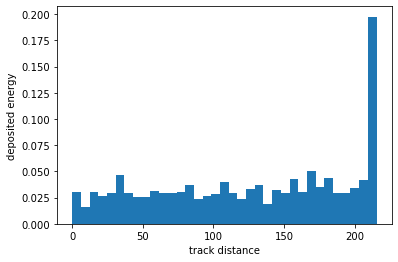

(48000505, 'e-')


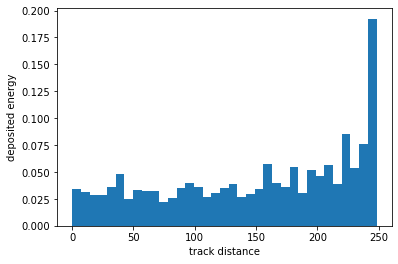

(48000506, 'e-')


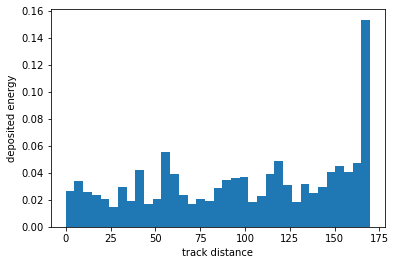

(48000507, 'e-')


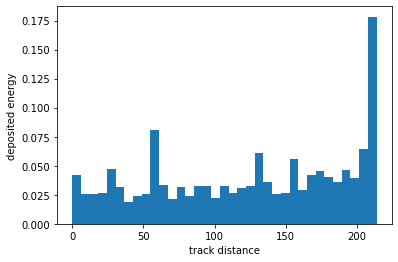

(48000508, 'e+')


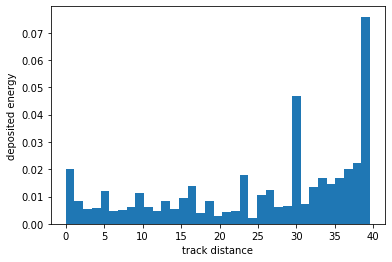

(48000508, 'e-')


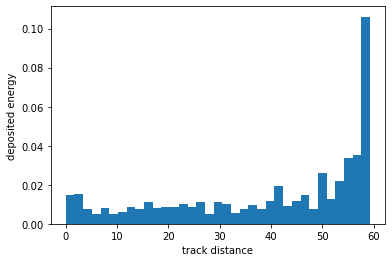

(48000509, 'e+')


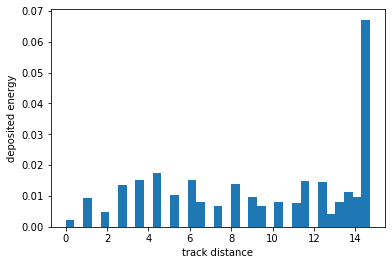

(48000509, 'e-')


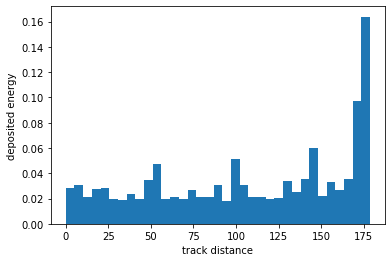

(48000510, 'e+')


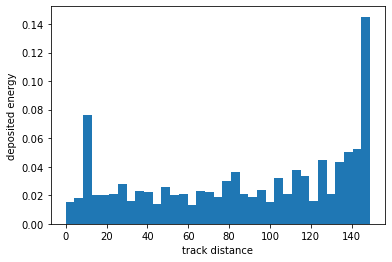

(48000510, 'e-')


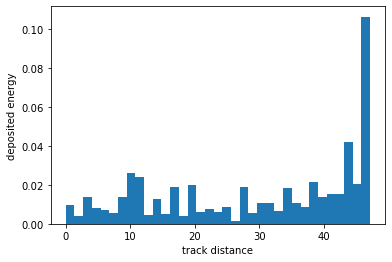

(48000511, 'e-')


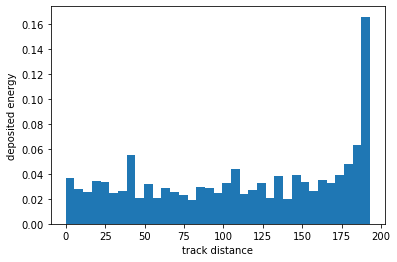

(48000512, 'e-')


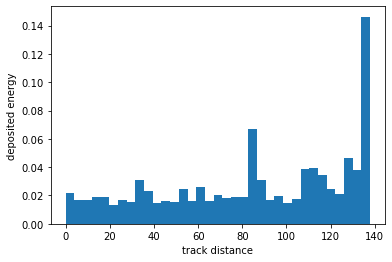

(48000513, 'e-')


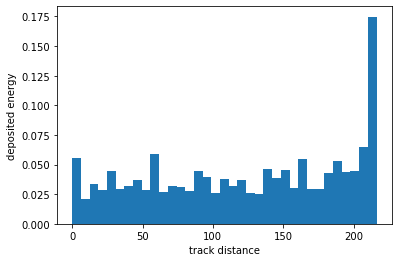

(48000514, 'e-')


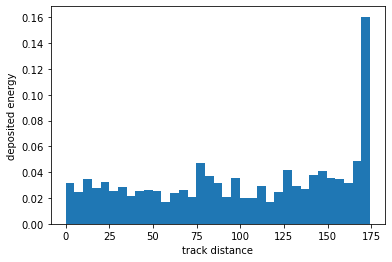

(48000515, 'e-')


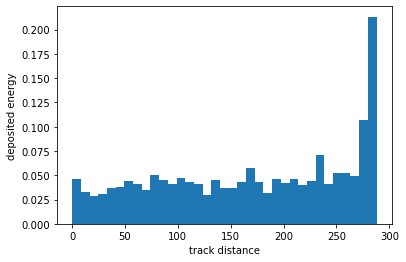

(48000516, 'e-')


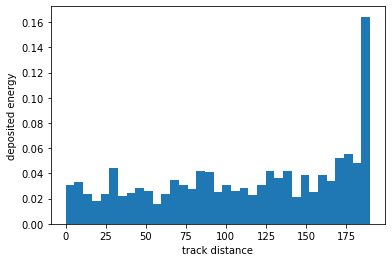

(48000517, 'e-')


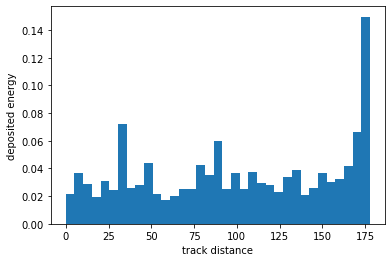

(48000518, 'e-')


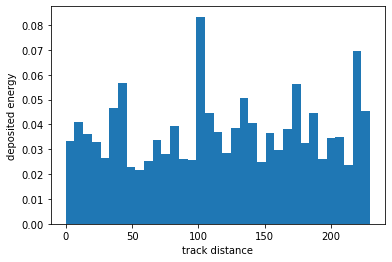

(48000519, 'e-')


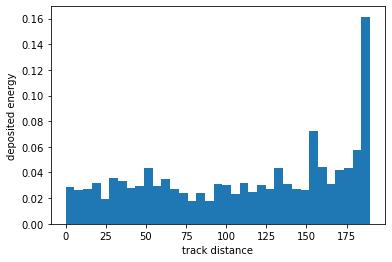

(48000520, 'e-')


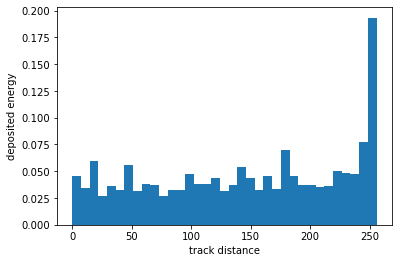

(48000521, 'e-')


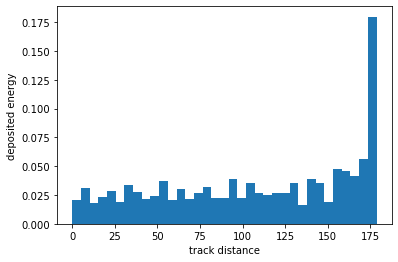

(48000522, 'e-')


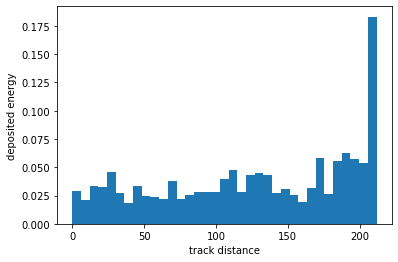

(48000523, 'e-')


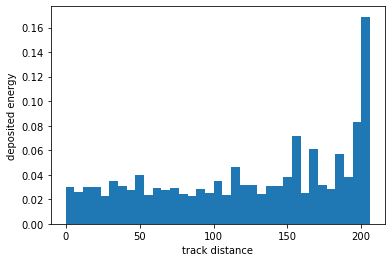

(48000524, 'e+')


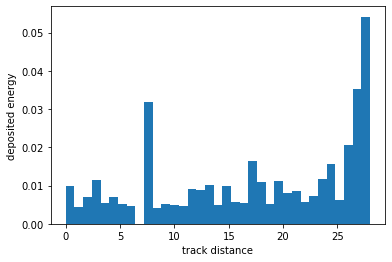

(48000524, 'e-')


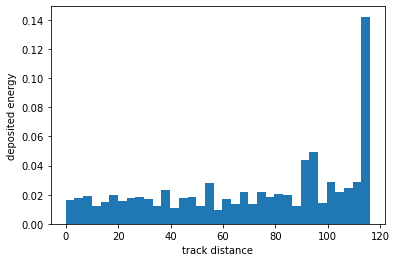

(48000525, 'e+')


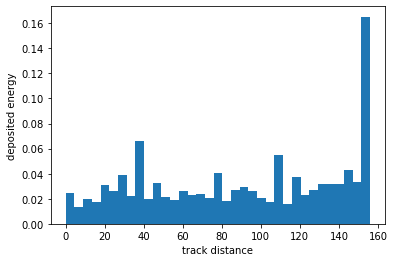

(48000525, 'e-')


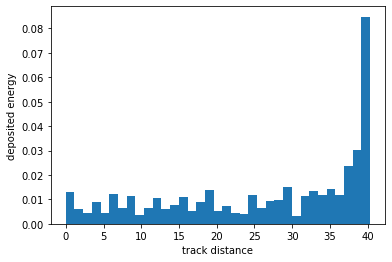

(48000526, 'e+')


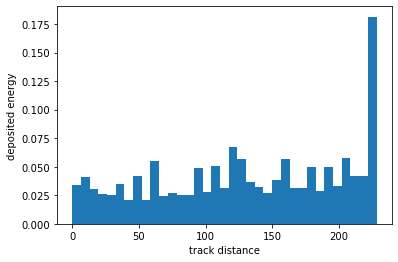

(48000526, 'e-')


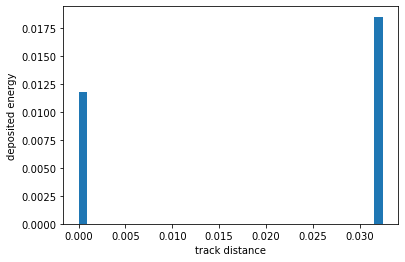

(48000527, 'e-')


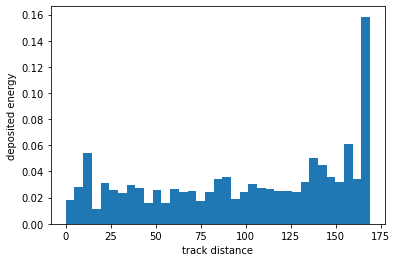

(48000528, 'e+')


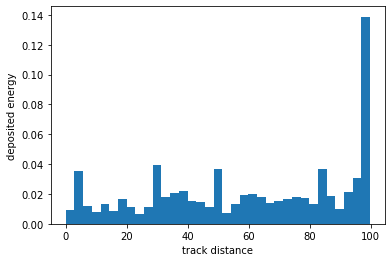

(48000528, 'e-')


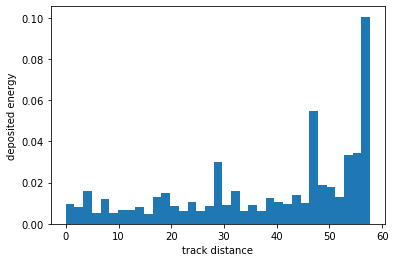

(48000529, 'e-')


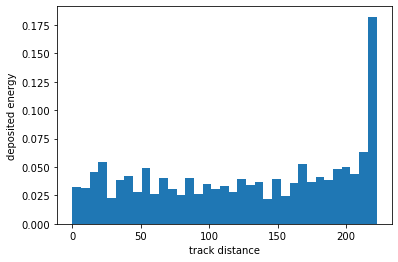

(48000530, 'e-')


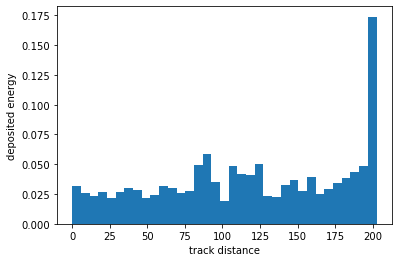

(48000531, 'e-')


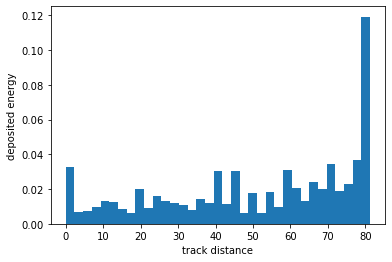

(48000532, 'e-')


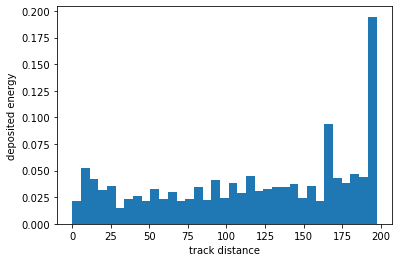

(48000533, 'e-')


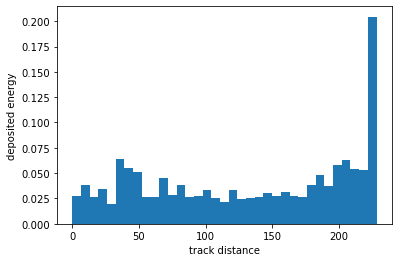

(48000535, 'e-')


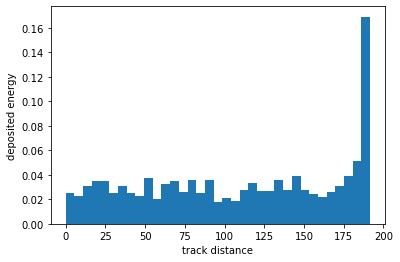

(48000536, 'e-')


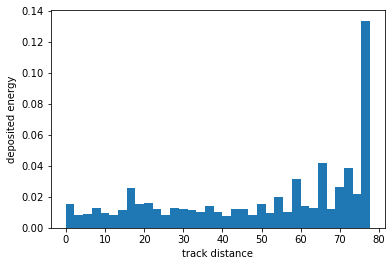

(48000537, 'e-')


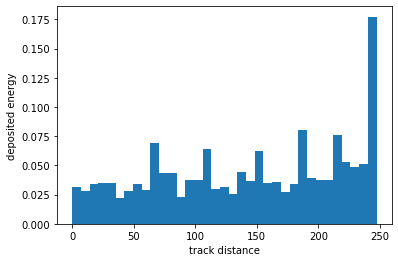

(48000538, 'e+')


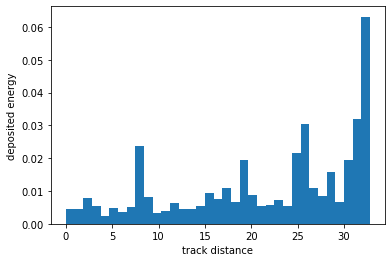

(48000538, 'e-')


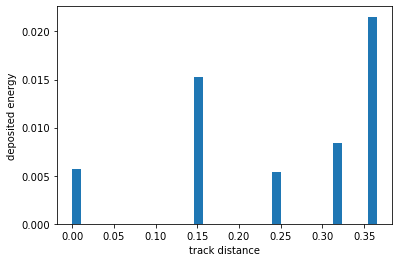

(48000539, 'e-')


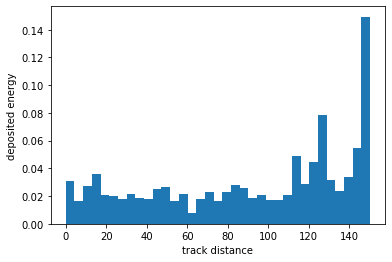

(48000540, 'e-')


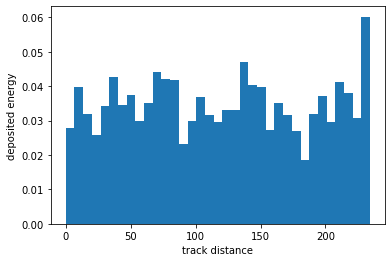

(48000541, 'e-')


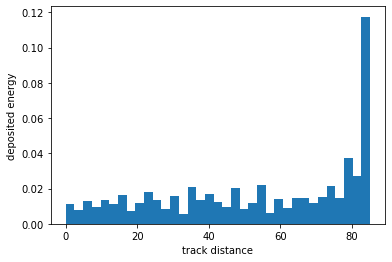

(48000542, 'e-')


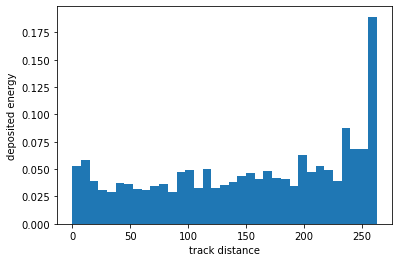

(48000543, 'e-')


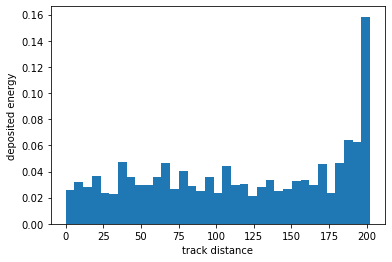

(48000544, 'e+')


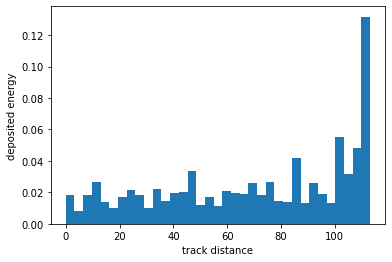

(48000544, 'e-')


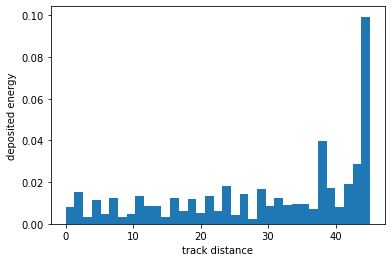

(48000545, 'e+')


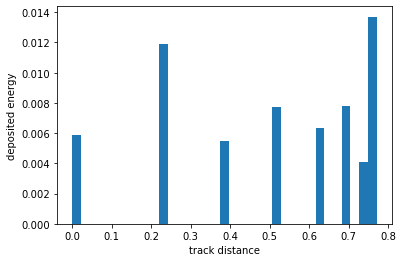

(48000545, 'e-')


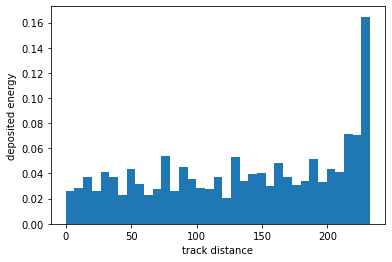

(48000546, 'e-')


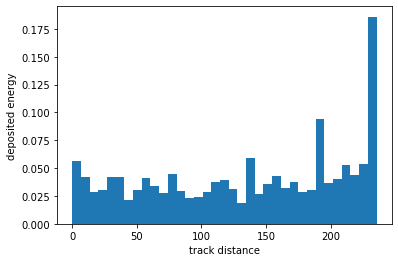

(48000547, 'e-')


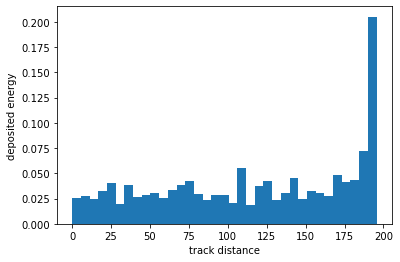

(48000548, 'e+')


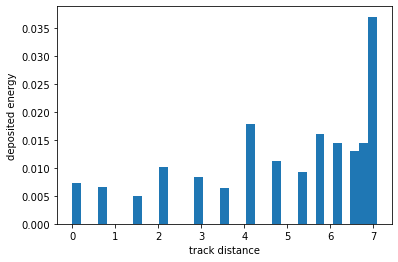

(48000548, 'e-')


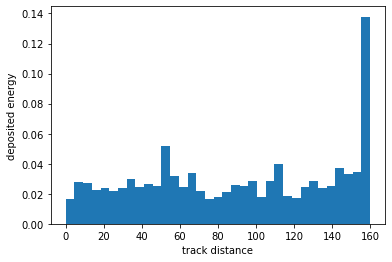

(48000549, 'e+')


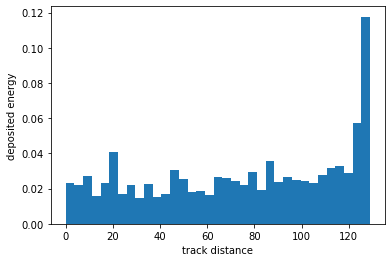

(48000549, 'e-')


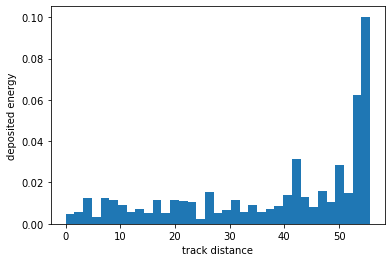

(48000550, 'e-')


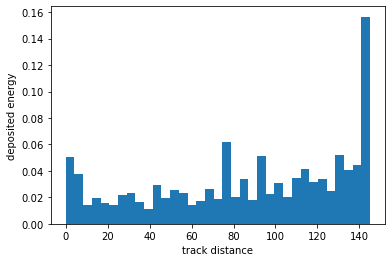

(48000551, 'e+')


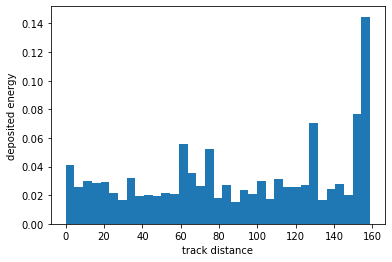

(48000551, 'e-')


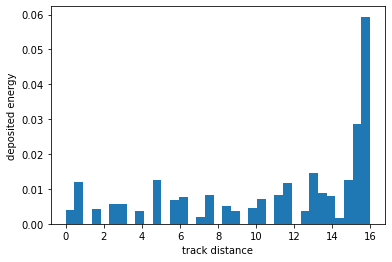

(48000552, 'e+')


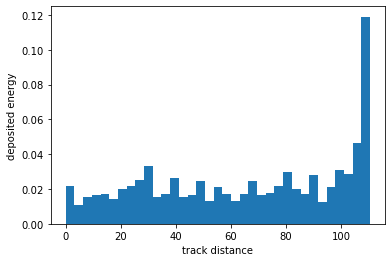

(48000552, 'e-')


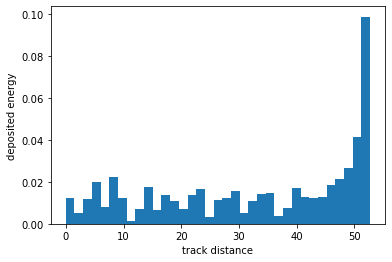

(48000553, 'e+')


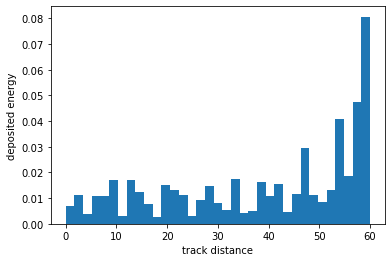

(48000553, 'e-')


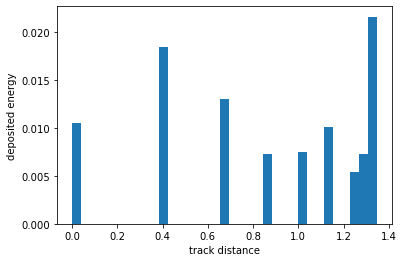

(48000554, 'e-')


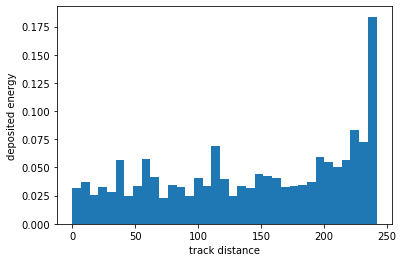

(48000555, 'e+')


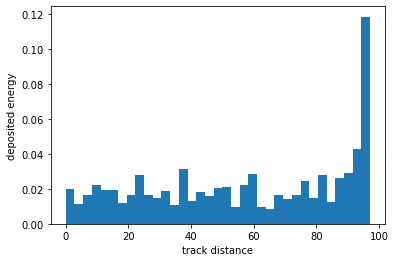

(48000555, 'e-')


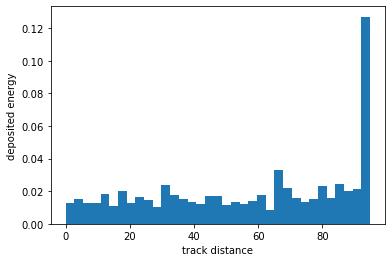

(48000556, 'e-')


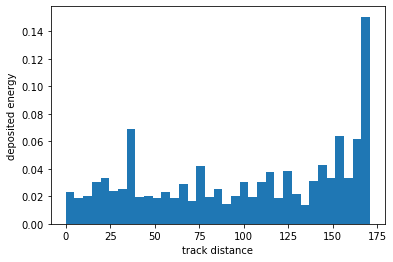

(48000557, 'e-')


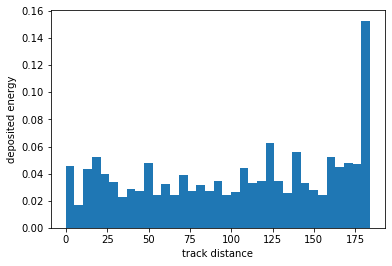

(48000558, 'e-')


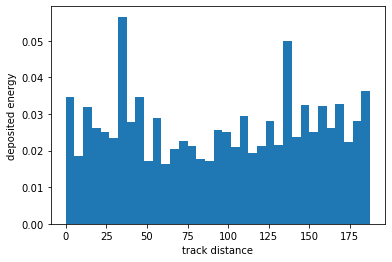

(48000559, 'e+')


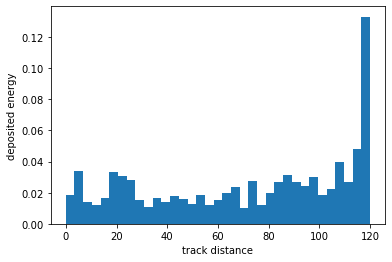

(48000559, 'e-')


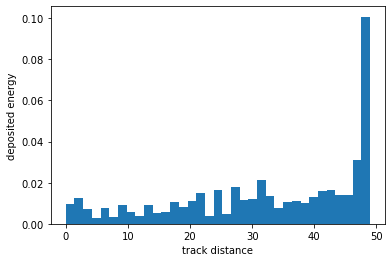

(48000560, 'e-')


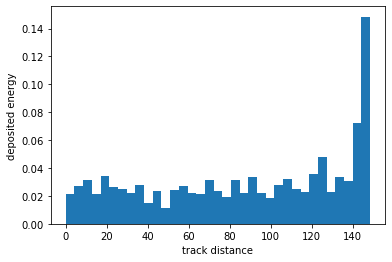

(48000561, 'e+')


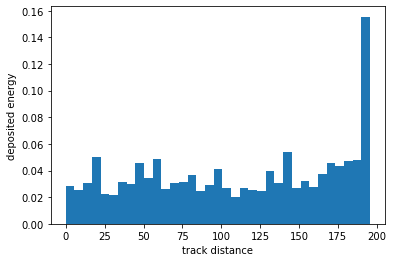

(48000561, 'e-')


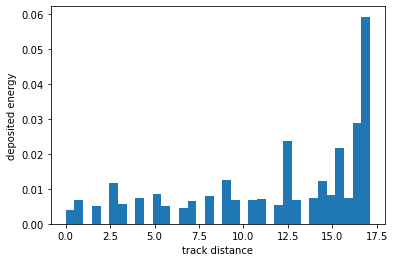

(48000562, 'e-')


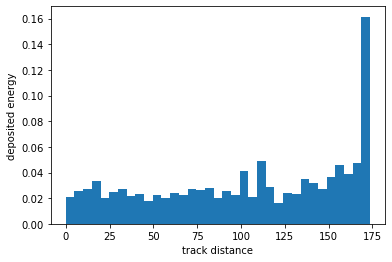

(48000563, 'e+')


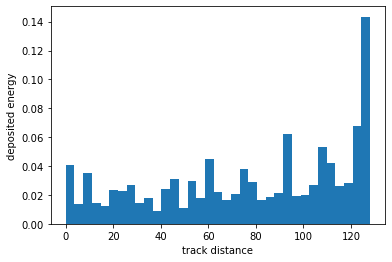

(48000563, 'e-')


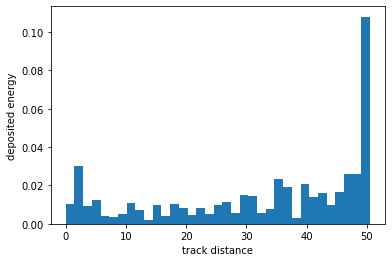

(48000564, 'e+')


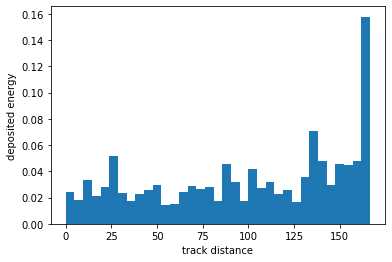

(48000564, 'e-')


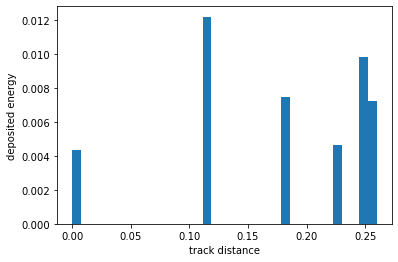

(48000565, 'e-')


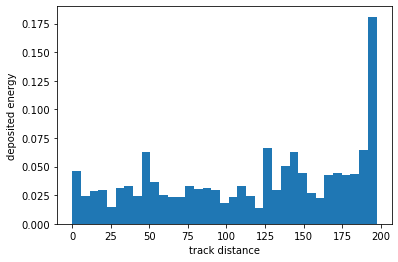

(48000566, 'e+')


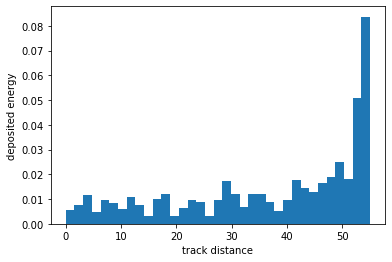

(48000566, 'e-')


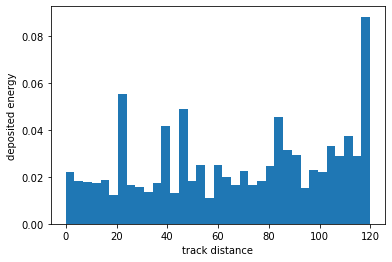

(48000568, 'e-')


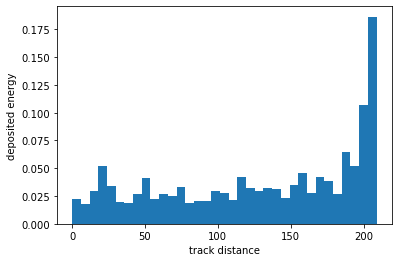

(48000569, 'e-')


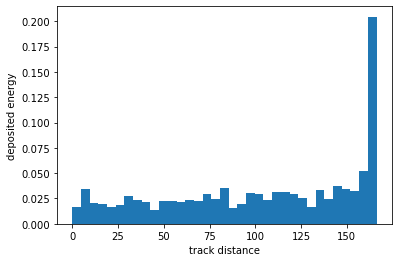

(48000570, 'e-')


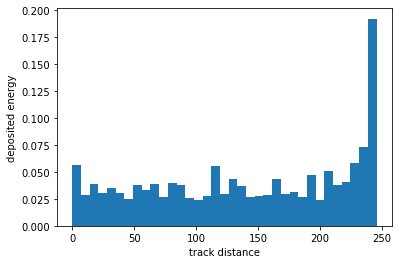

(48000571, 'e-')


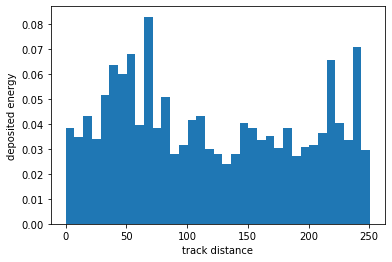

(48000572, 'e-')


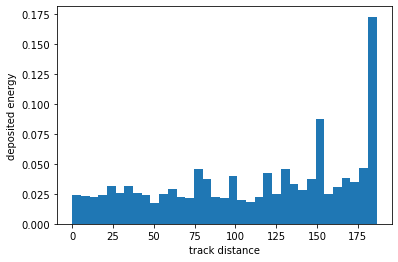

(48000573, 'e+')


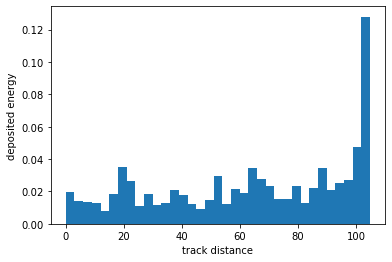

(48000573, 'e-')


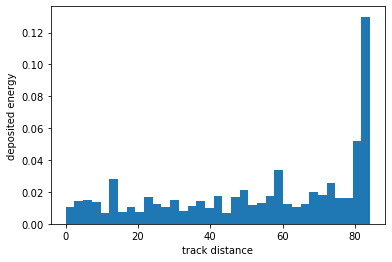

(48000574, 'e+')


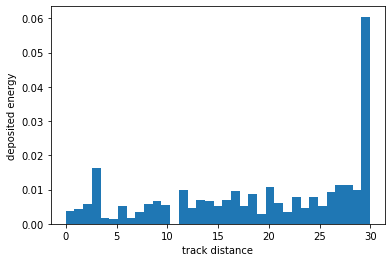

(48000574, 'e-')


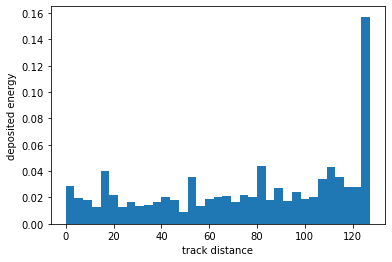

(48000575, 'e-')


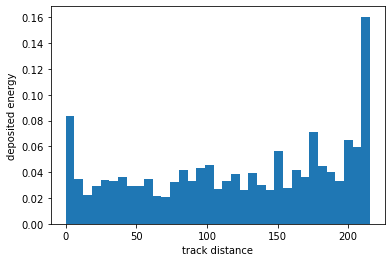

(48000576, 'e-')


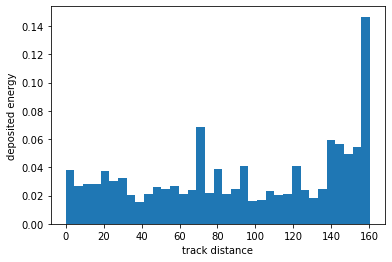

(48000577, 'e-')


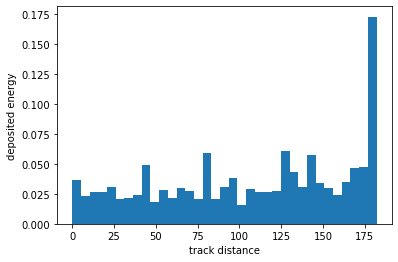

(48000578, 'e+')


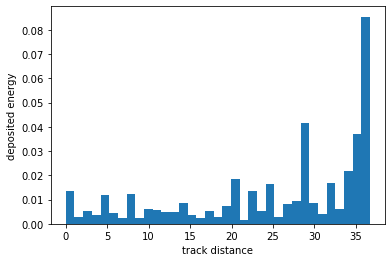

(48000578, 'e-')


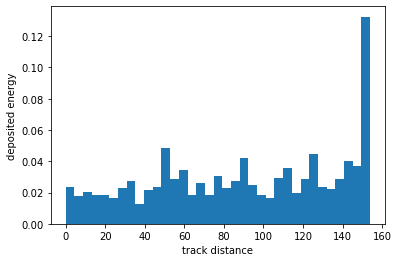

(48000579, 'e-')


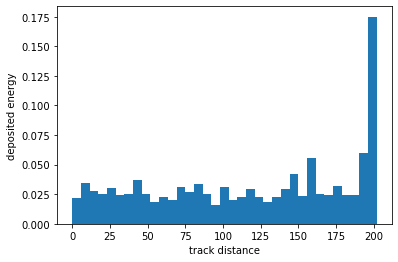

(48000580, 'e-')


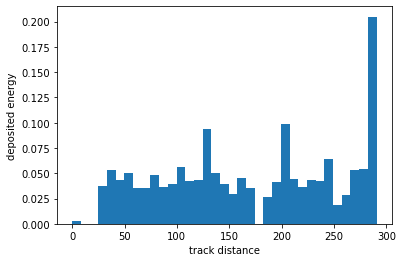

(48000581, 'e-')


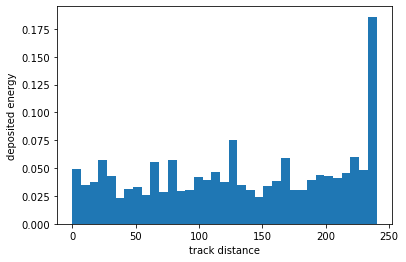

(48000582, 'e-')


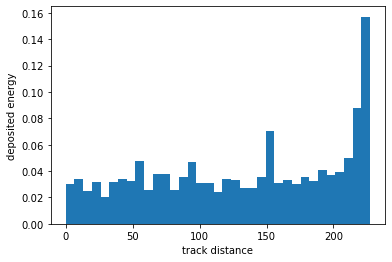

(48000583, 'e+')


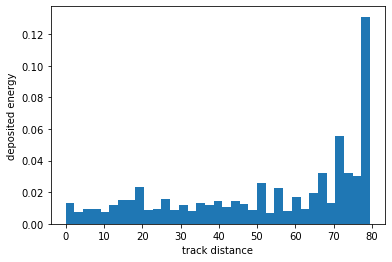

(48000583, 'e-')


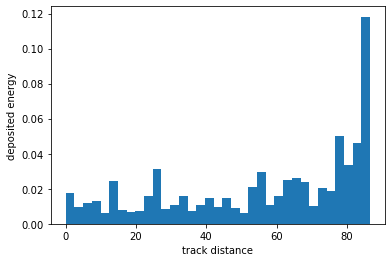

(48000584, 'e-')


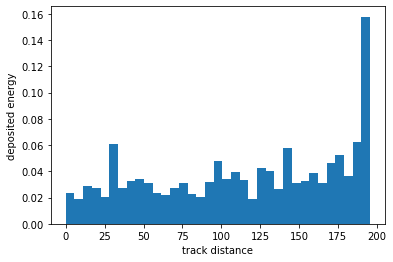

(48000585, 'e-')


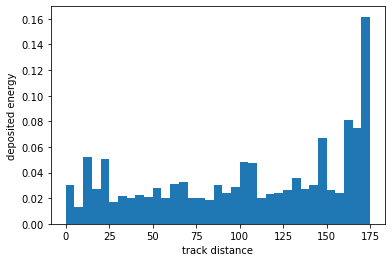

(48000586, 'e-')


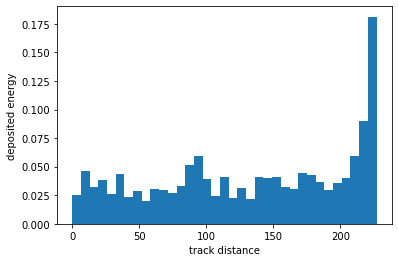

(48000587, 'e+')


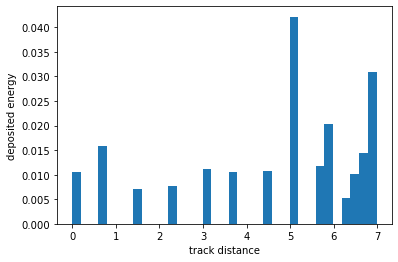

(48000587, 'e-')


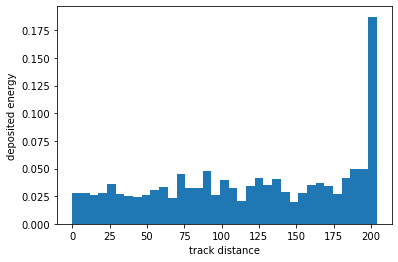

(48000588, 'e-')


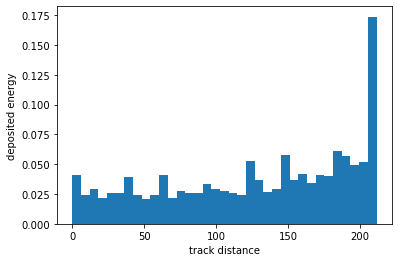

(48000590, 'e-')


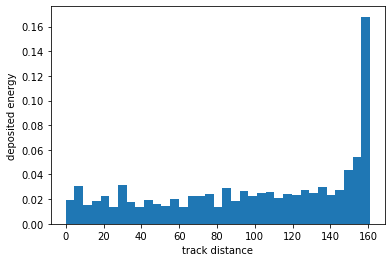

(48000591, 'e-')


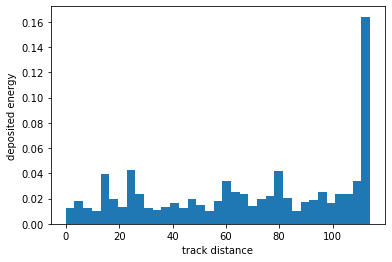

(48000592, 'e+')


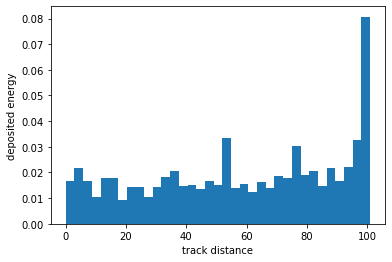

(48000592, 'e-')


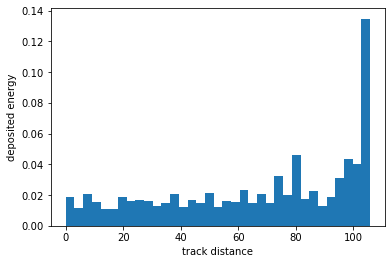

(48000593, 'e-')


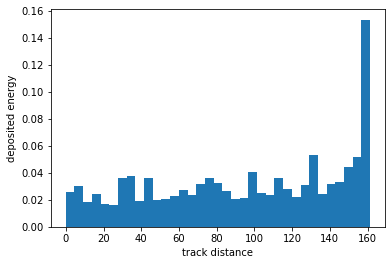

(48000595, 'e+')


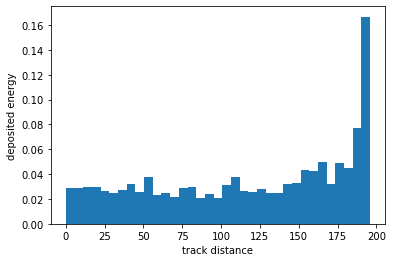

(48000595, 'e-')


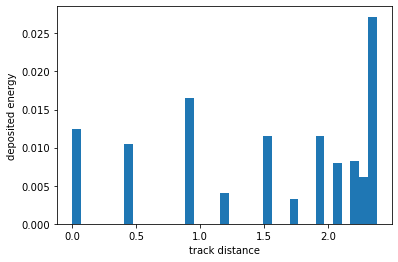

(48000596, 'e-')


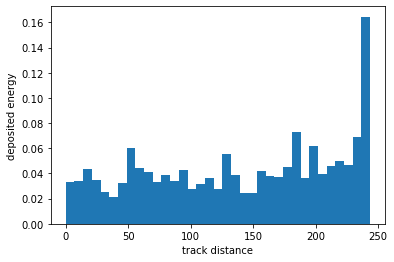

(48000597, 'e-')


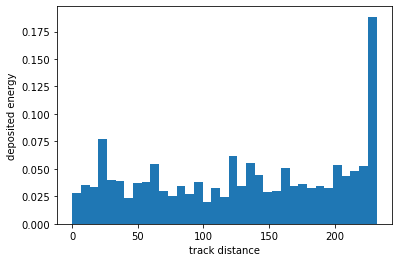

In [18]:
for event_id, df in track_hits.groupby(['event_id', 'particle_name']):
    print(event_id)

    distances, energies = df.cumdist, df.energy
    plt.hist(distances, bins = 35, weights = energies) 
    plt.xlabel('track distance')
    plt.ylabel('deposited energy')
    plt.show()

Lo que veo es que independientemente de la distancia recorrida, si divido en trozos iguales cada distancia más o menos se parecen los espectros de deposición de todas las trazas (al final de la deposición hay una subida de energías clara en los bins, antes de eso hay oscilacion simplemente)

Por ello, creo que lo que nos interesa es ver cómo va la pérdida de energía respecto a la distancia recorrida... rollo al tanto% de distancia recorrida de la total perdió tanto% de energía de la total...

Quizás con esto puedo definir que el blob son aquellos hits del tanto% final de la distancia de la traza, o del tanto% final de la energía perdida si vemos que se mantiene un patrón en todas las trazas

## Añado porcentajes de energía depositada y trayectoria realizada

In [6]:
track_hits

,x,y,z,hit_id,particle_id,energy,segclass,binclass,dist_hits,cumdist,particle_name,creator_proc,group_ener,small_b,dataset_id
1,97.603165,121.327568,352.321014,0,18,0.004391,2.0,0,0.000000,0.000000,e-,compt,1.011980,False,0
2,98.066238,120.641197,352.873383,1,18,0.001886,2.0,0,0.995315,0.995315,e-,compt,1.011980,False,0
3,98.567894,119.942047,353.360535,2,18,0.004887,2.0,0,0.988831,1.984146,e-,compt,1.011980,False,0
4,99.143150,119.331947,353.896667,3,18,0.003480,2.0,0,0.995279,2.979425,e-,compt,1.011980,False,0
5,99.882500,118.914360,354.420746,4,18,0.020594,2.0,0,0.997835,3.977260,e-,compt,1.011980,False,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7168644,-21.902008,140.567673,140.176437,279,10,0.017393,3.0,0,0.187378,260.345428,e-,compt,0.362393,True,28766
7168645,-21.916271,140.672180,140.186264,280,10,0.006517,3.0,0,0.105933,260.451385,e-,compt,0.362393,True,28766
7168646,-21.880135,140.739075,140.158890,281,10,0.009024,3.0,0,0.080809,260.532196,e-,compt,0.362393,True,28766
7168647,-21.924908,140.723190,140.170258,282,10,0.011120,3.0,0,0.048848,260.581024,e-,compt,0.362393,True,28766


In [7]:
#calculo la energía total por traza y la añado a tracks_hits
cosa = track_hits.groupby(['dataset_id', 'particle_id']).agg({'energy':[('totener', sum)]})
cosa.columns = cosa.columns.get_level_values(1)
cosa.reset_index(inplace=True)

In [8]:
track_hits = track_hits.merge(cosa, on = ['dataset_id', 'particle_id'])

In [9]:
#calculo la distancia total por traza y la añado a tracks_hits
cosa = track_hits.groupby(['dataset_id', 'particle_id']).agg({'dist_hits':[('totdist', sum)]})
cosa.columns = cosa.columns.get_level_values(1)
cosa.reset_index(inplace=True)

In [10]:
track_hits = track_hits.merge(cosa, on = ['dataset_id', 'particle_id'])

In [11]:
#hago la cumenergy y cumdist (la cumdist ya estaba hecha pero la cambio porque daba lil errors)
track_hits = track_hits.assign(cumener = track_hits.groupby(['dataset_id', 'particle_id']).energy.cumsum())
track_hits = track_hits.assign(cumdist = track_hits.groupby(['dataset_id', 'particle_id']).dist_hits.cumsum())

In [12]:
track_hits = track_hits.assign(ener_ratio = (track_hits.cumener / track_hits.totener))

In [13]:
track_hits = track_hits.assign(dist_ratio = (track_hits.cumdist / track_hits.totdist))

In [14]:
percent_track_hits = track_hits

In [15]:
percent_track_hits.ener_ratio = percent_track_hits.ener_ratio.fillna(0)
percent_track_hits.dist_ratio = percent_track_hits.dist_ratio.fillna(0)

Para hacer un ajuste lineal me doy una poca de cuenta de que quizás el tema de que el primer hit tenga energía no nula y distancia sí nula puede ser un poco sobo, ya que vamos entonces a tener siempre un término independiente que no va a ser muy justo porque el primer hit de cada track no tiene mucho que ver en esta movida no??

Lo único que se me ocurre es que por evento, a la columna cumener le reste la energía del primer hit, de forma que es como si no contara para el evento pero comparado con el numero de hits por eventos puede que no sea tan malo...

De todas formas tampoco sé si será la mejor forma de hacer esto ya que lo 'práctico' sería más bien hacer como un ajuste sin los valores del final, pero claro al fin y al cabo el objetivo es saber cuales son los valores que quiero excluir... un sobo non?

(48000025, 'e-')


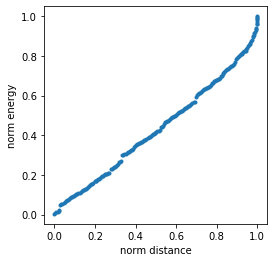

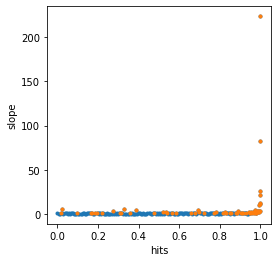

(48000026, 'e-')


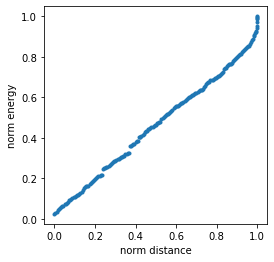

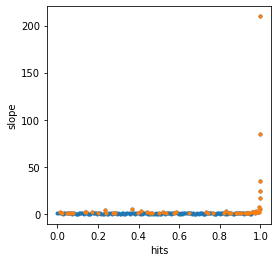

(48000027, 'e-')


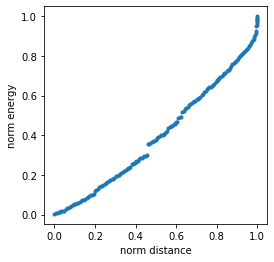

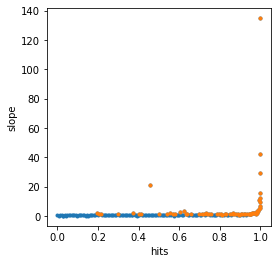

(48000028, 'e-')


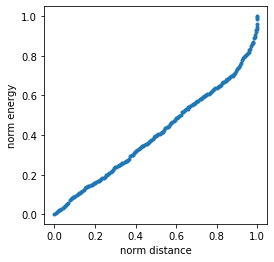

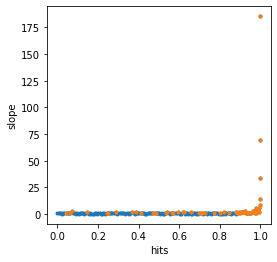

(48000030, 'e-')


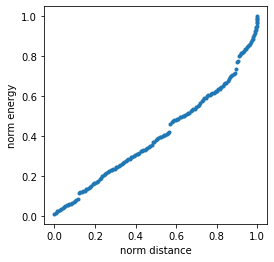

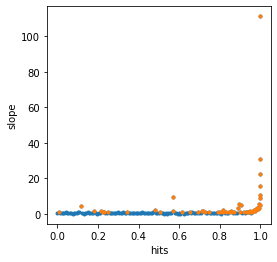

(48000031, 'e-')


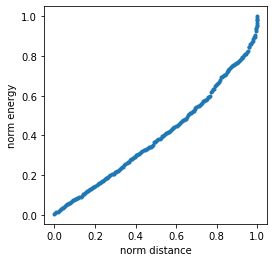

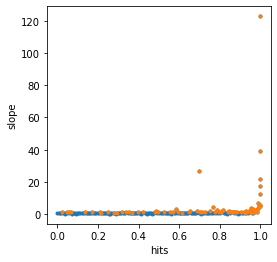

(48000032, 'e-')


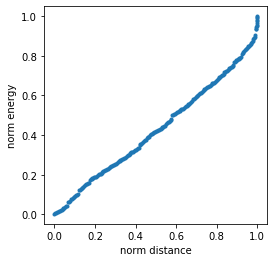

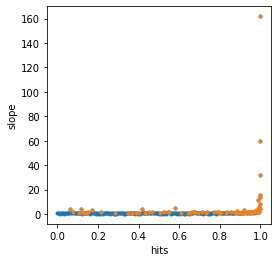

(48000033, 'e-')


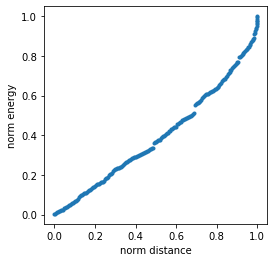

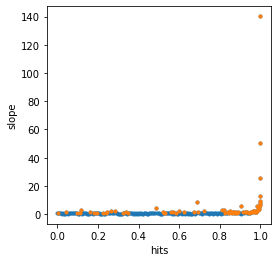

(48000034, 'e-')


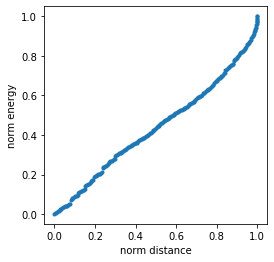

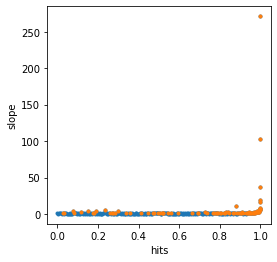

(48000035, 'e-')


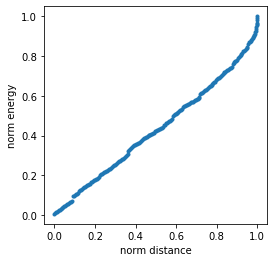

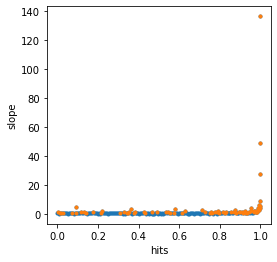

(48000036, 'e-')


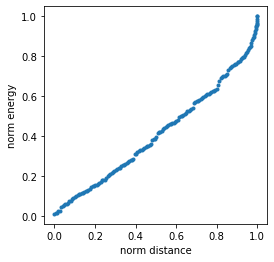

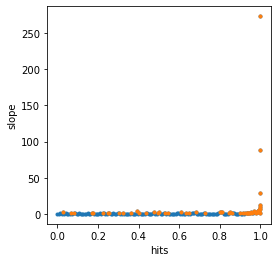

(48000037, 'e-')


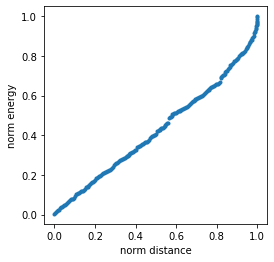

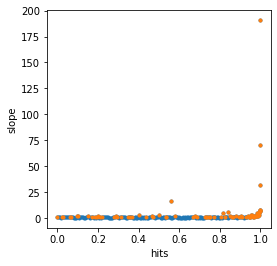

(48000038, 'e-')


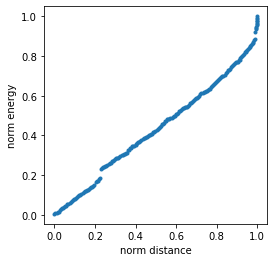

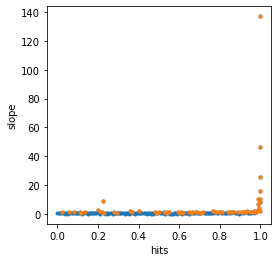

(48000039, 'e-')


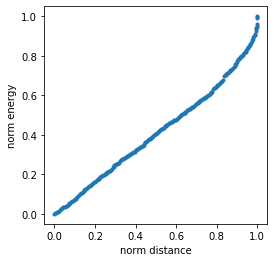

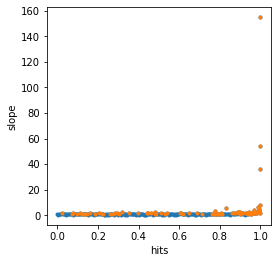

(48000040, 'e+')


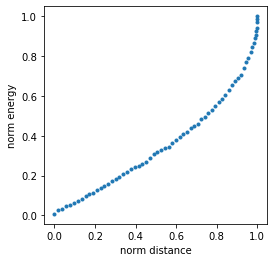

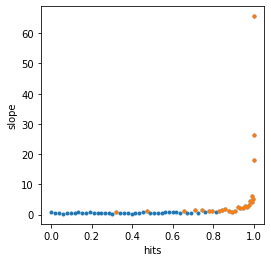

(48000040, 'e-')


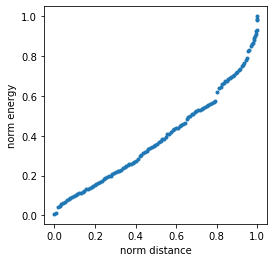

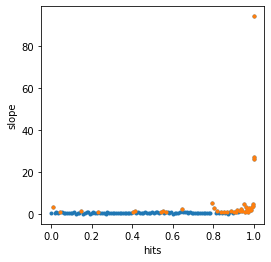

(48000041, 'e-')


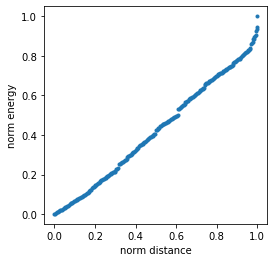

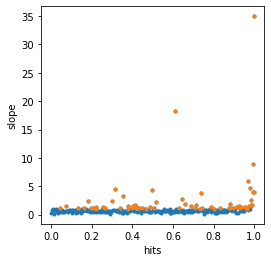

(48000042, 'e-')


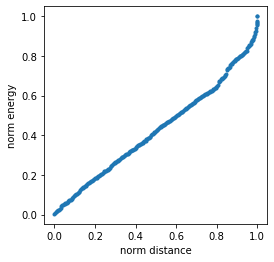

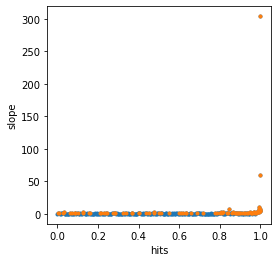

(48000043, 'e+')


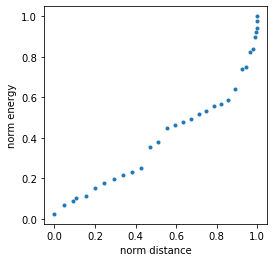

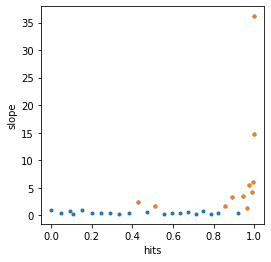

(48000043, 'e-')


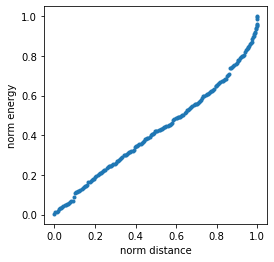

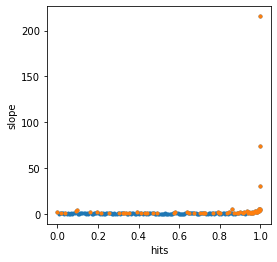

(48000044, 'e-')


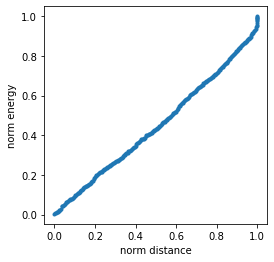

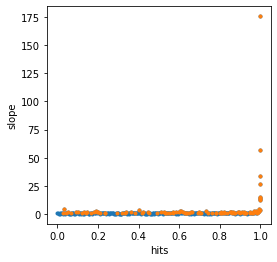

(48000045, 'e-')


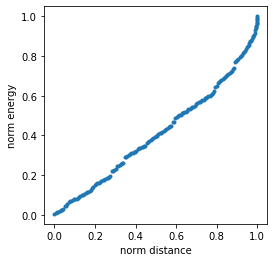

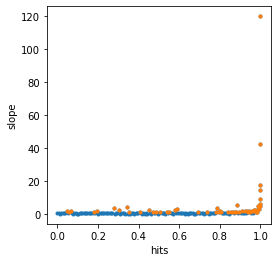

(48000046, 'e-')


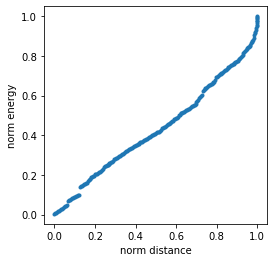

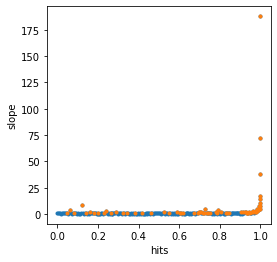

(48000047, 'e-')


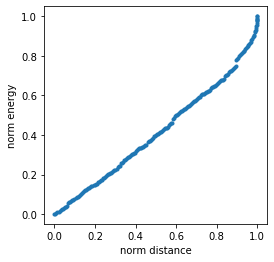

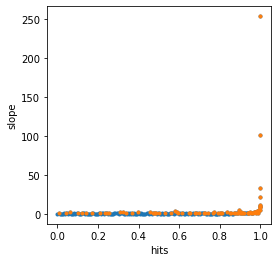

(48000048, 'e-')


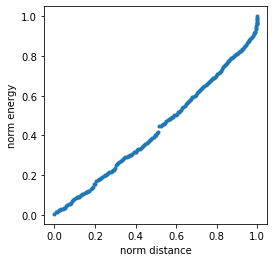

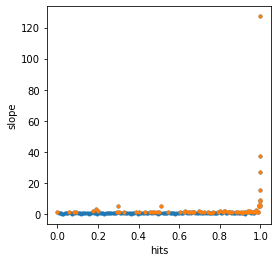

(48000049, 'e-')


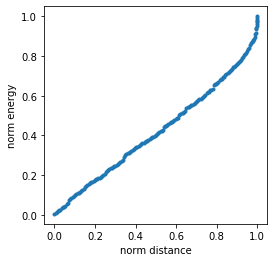

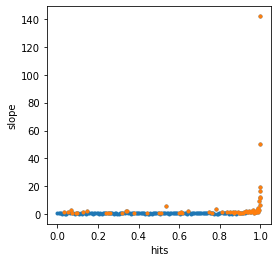

(48000050, 'e-')


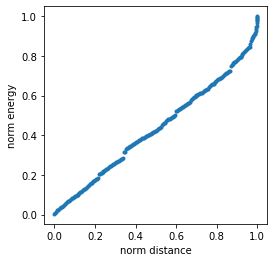

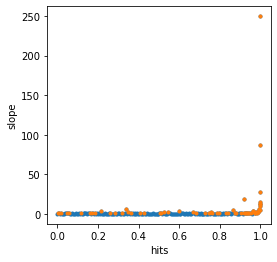

(48000051, 'e-')


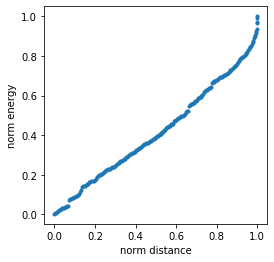

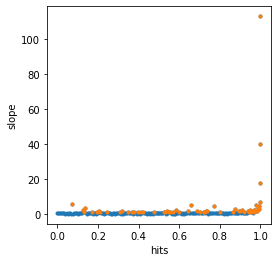

(48000052, 'e-')


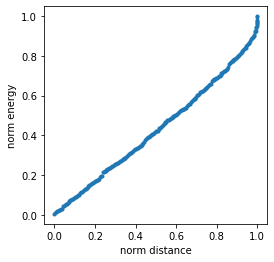

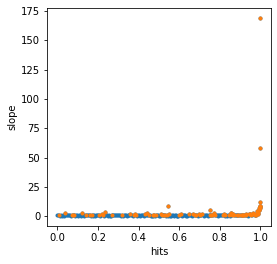

(48000053, 'e+')


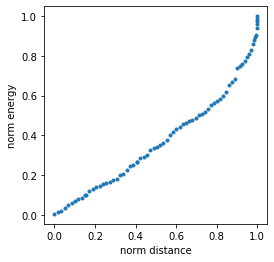

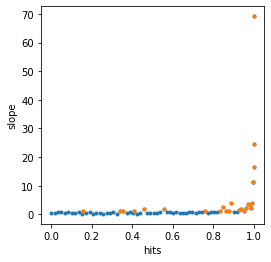

(48000053, 'e-')


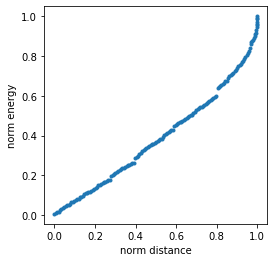

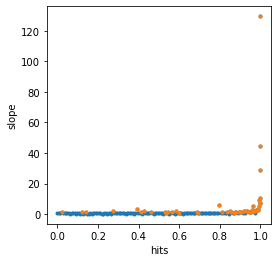

(48000054, 'e-')


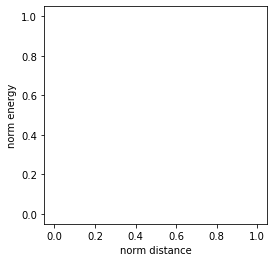

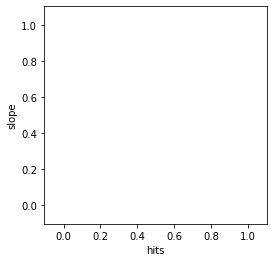

(48000055, 'e-')


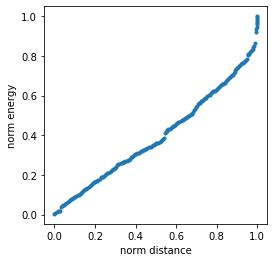

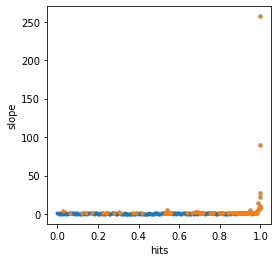

(48000056, 'e-')


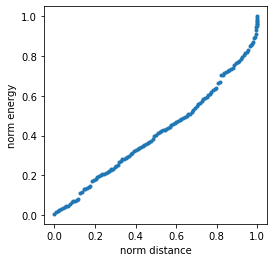

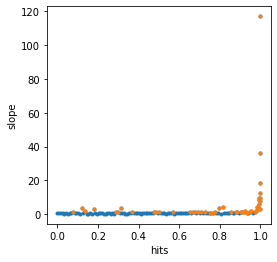

(48000057, 'e-')


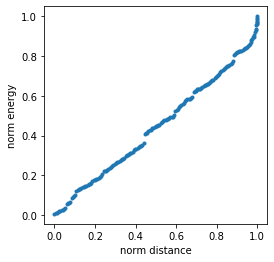

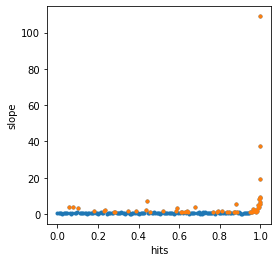

(48000058, 'e+')


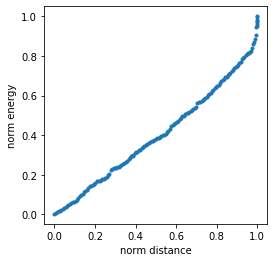

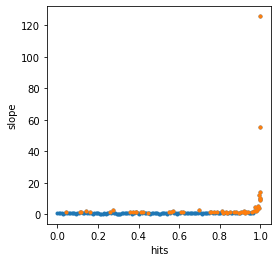

(48000058, 'e-')


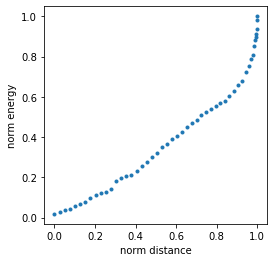

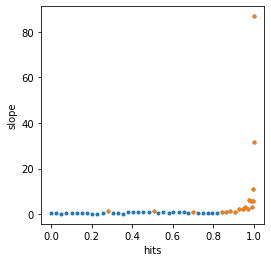

(48000059, 'e-')


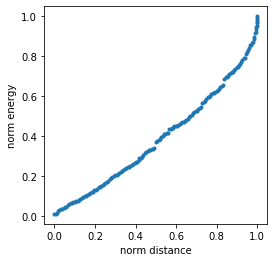

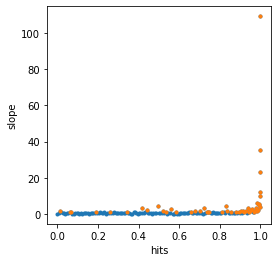

(48000060, 'e+')


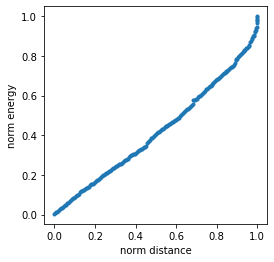

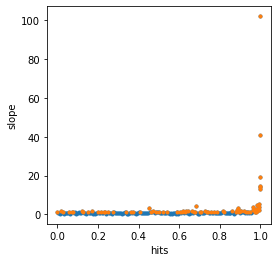

(48000060, 'e-')


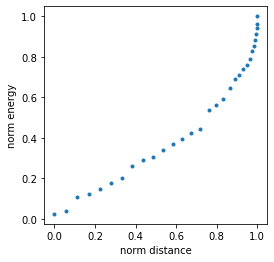

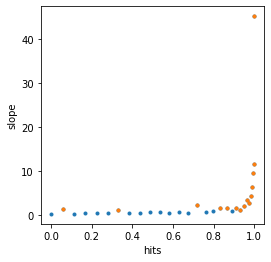

(48000061, 'e-')


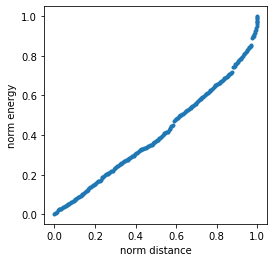

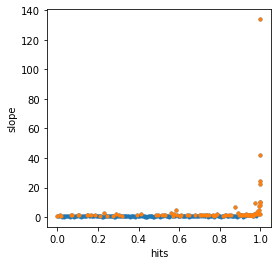

(48000062, 'e-')


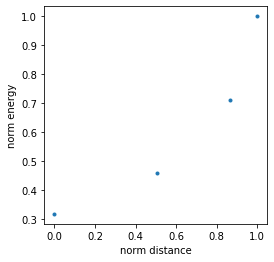

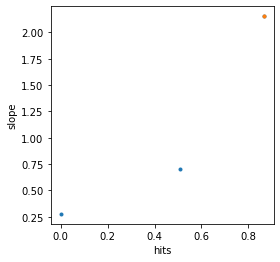

(48000063, 'e-')


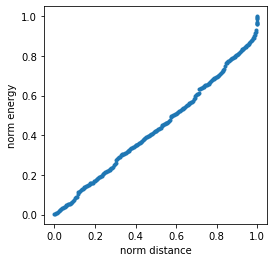

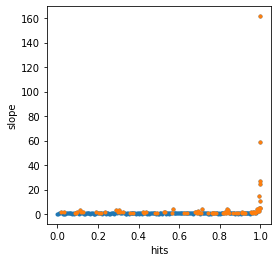

(48000064, 'e+')


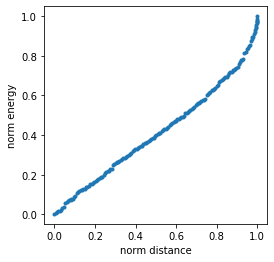

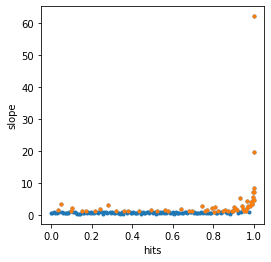

(48000064, 'e-')


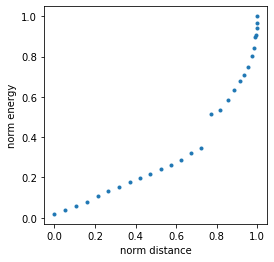

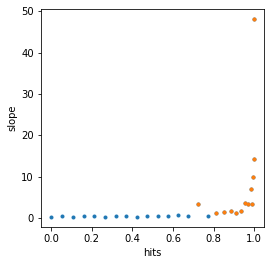

(48000066, 'e+')


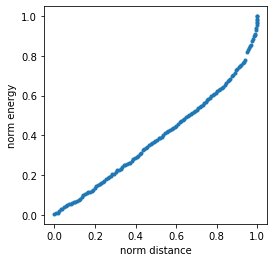

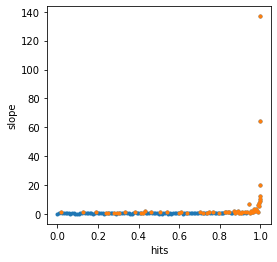

(48000066, 'e-')


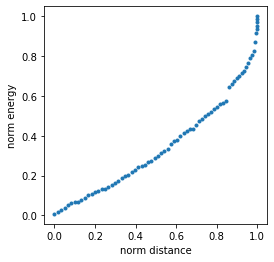

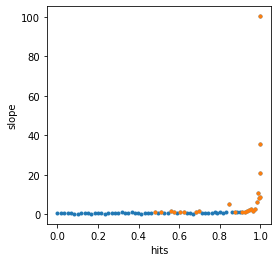

(48000067, 'e-')


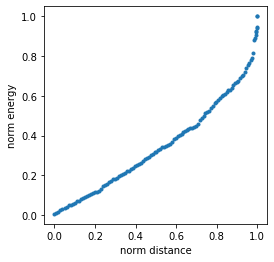

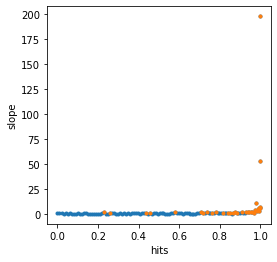

(48000068, 'e+')


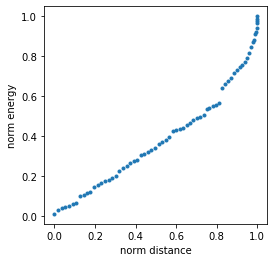

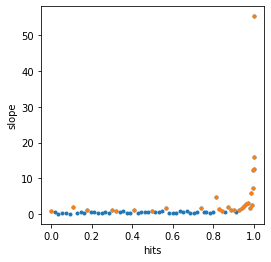

(48000068, 'e-')


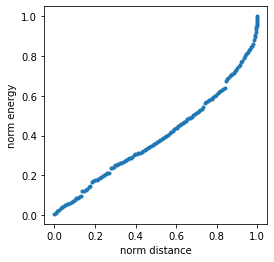

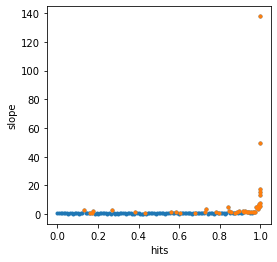

(48000069, 'e+')


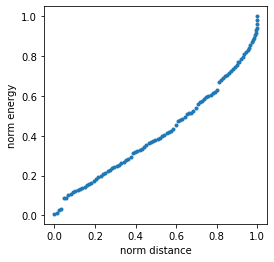

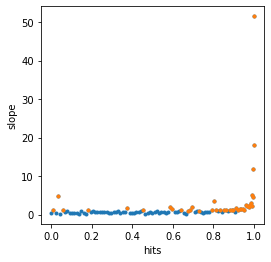

(48000069, 'e-')


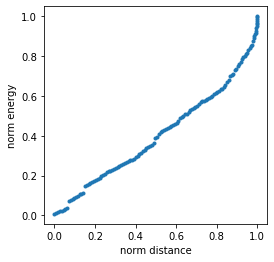

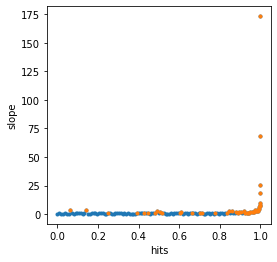

(48000070, 'e+')


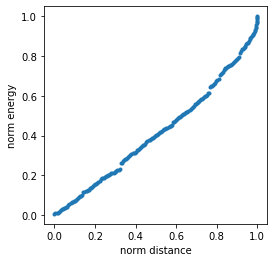

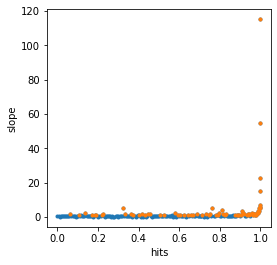

(48000070, 'e-')


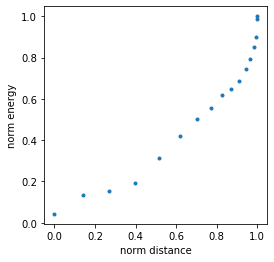

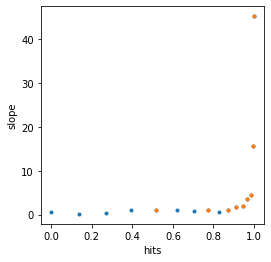

(48000071, 'e+')


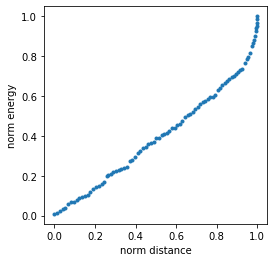

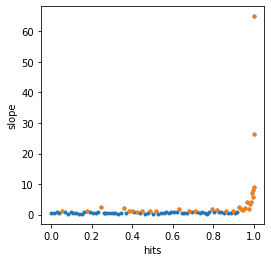

(48000071, 'e-')


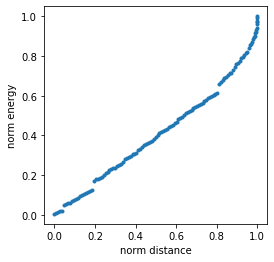

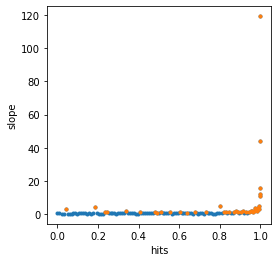

(48000073, 'e-')


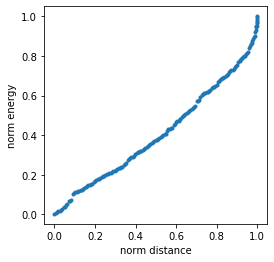

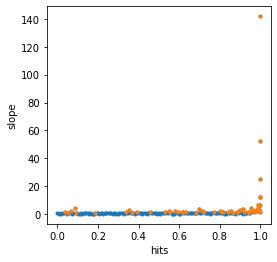

(48000074, 'e-')


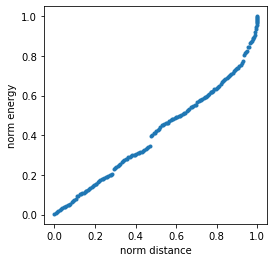

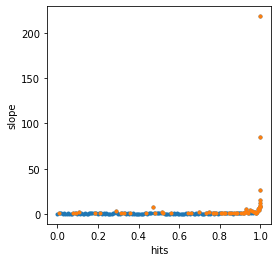

(48000075, 'e-')


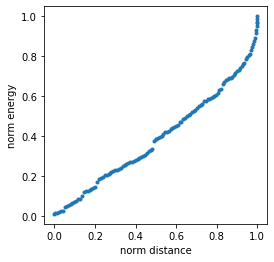

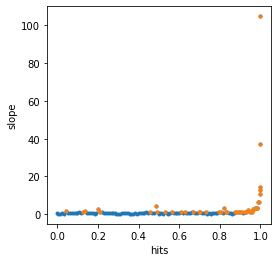

(48000076, 'e+')


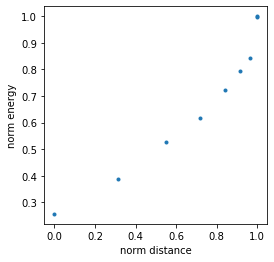

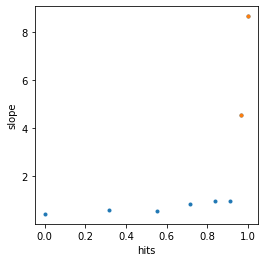

(48000076, 'e-')


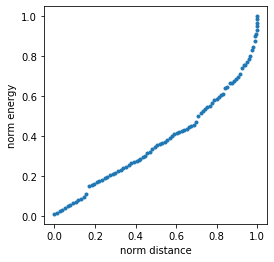

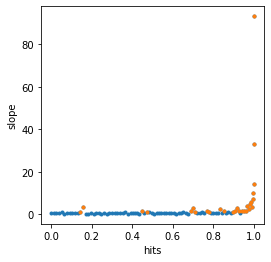

(48000077, 'e-')


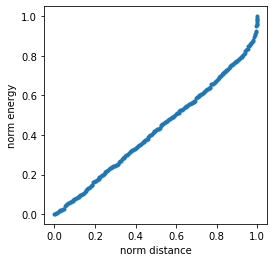

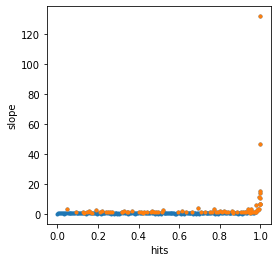

(48000078, 'e-')


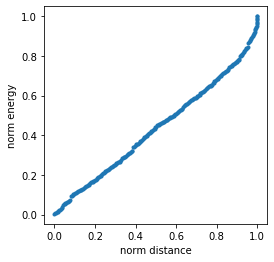

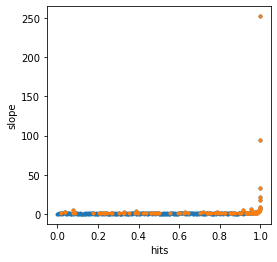

(48000079, 'e+')


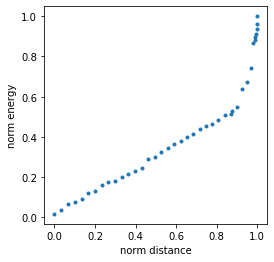

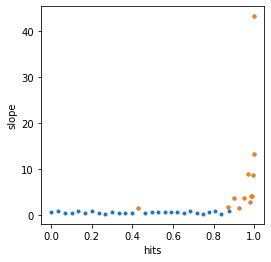

(48000079, 'e-')


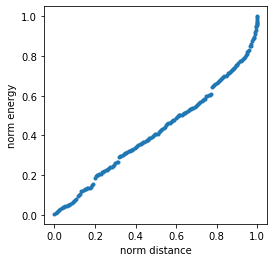

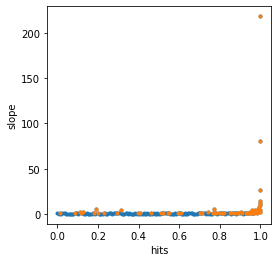

(48000080, 'e-')


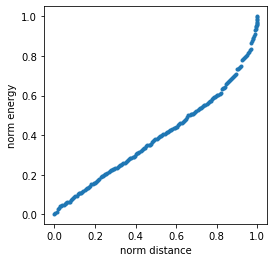

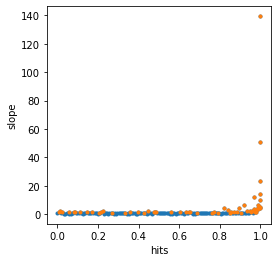

(48000081, 'e+')


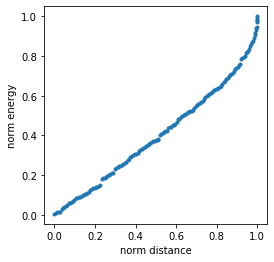

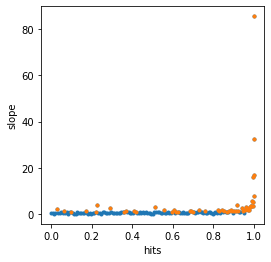

(48000081, 'e-')


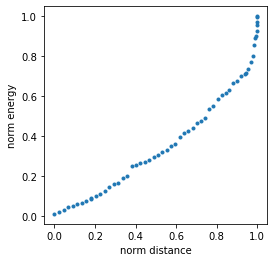

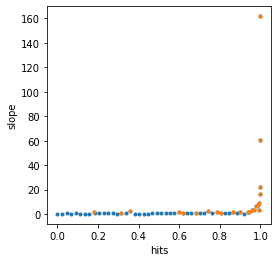

(48000082, 'e-')


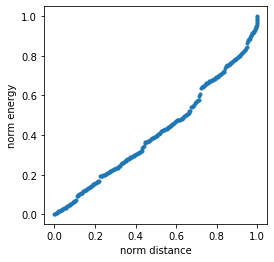

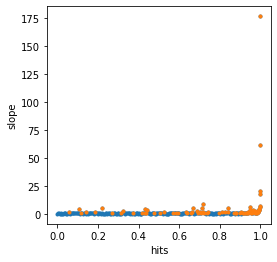

(48000083, 'e+')


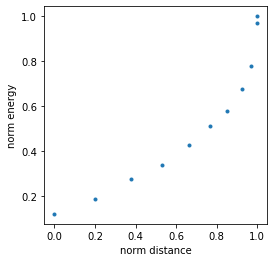

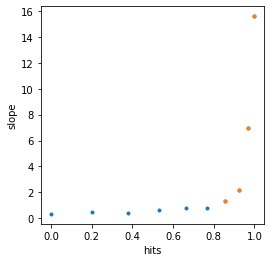

(48000083, 'e-')


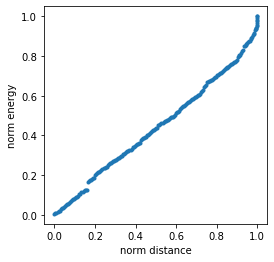

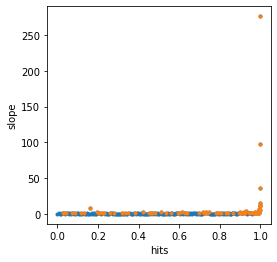

(48000084, 'e-')


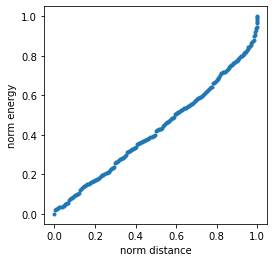

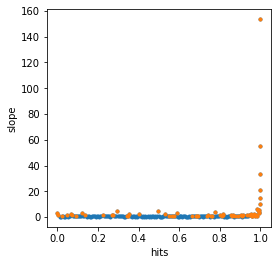

(48000085, 'e-')


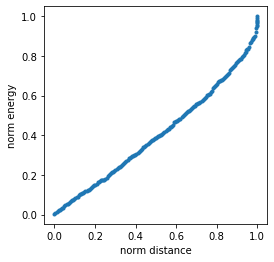

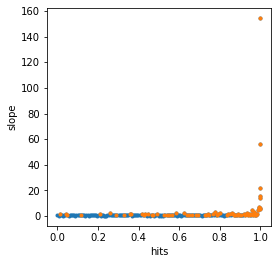

(48000086, 'e-')


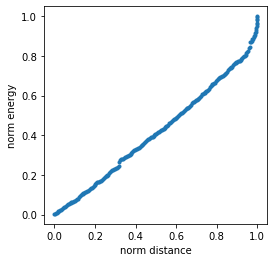

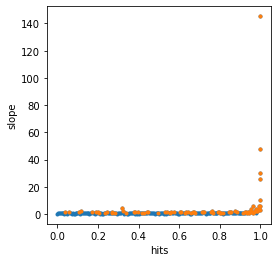

(48000087, 'e+')


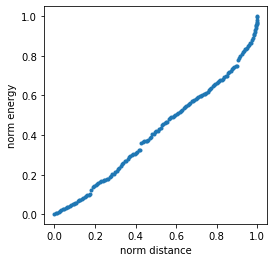

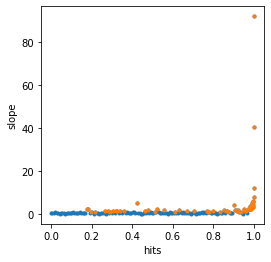

(48000087, 'e-')


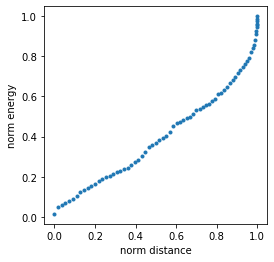

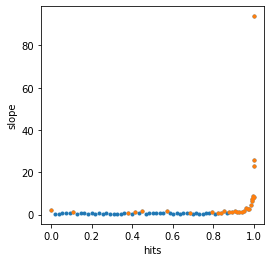

(48000088, 'e-')


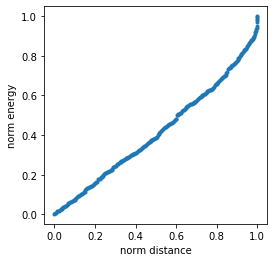

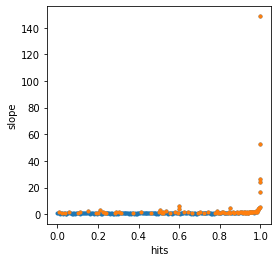

(48000089, 'e-')


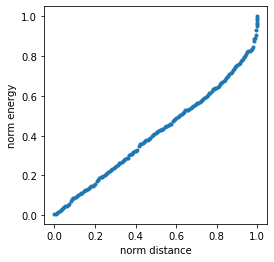

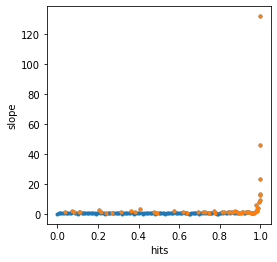

(48000090, 'e-')


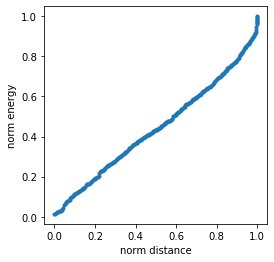

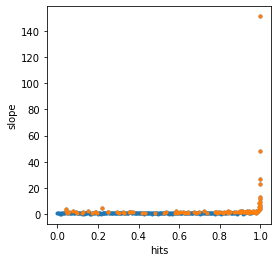

(48000091, 'e-')


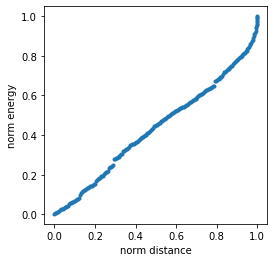

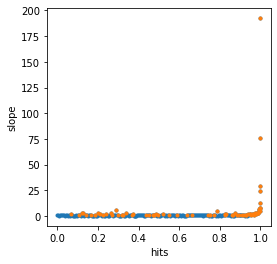

(48000092, 'e-')


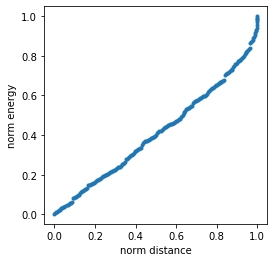

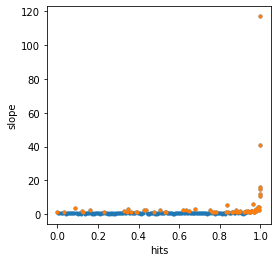

(48000093, 'e+')


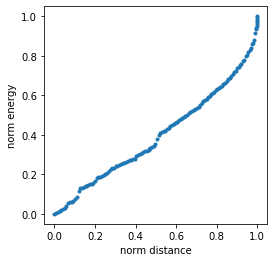

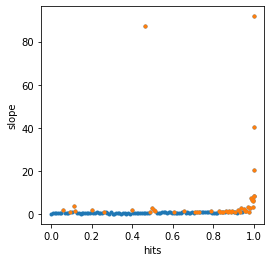

(48000093, 'e-')


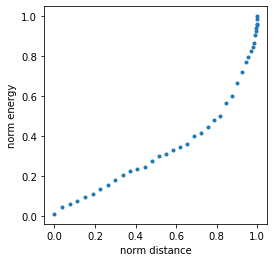

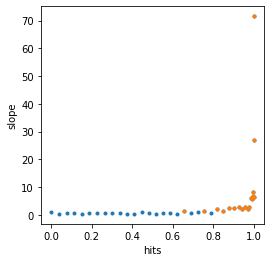

(48000094, 'e-')


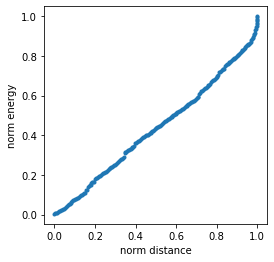

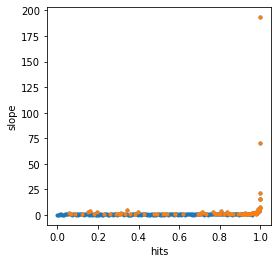

(48000096, 'e+')


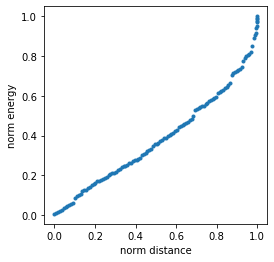

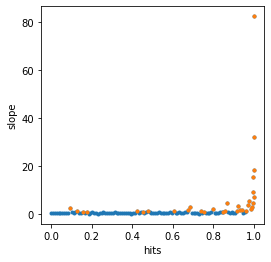

(48000096, 'e-')


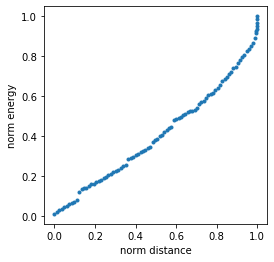

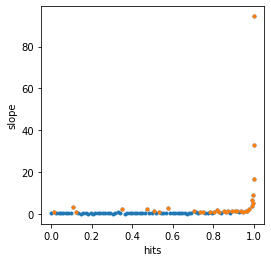

(48000097, 'e-')


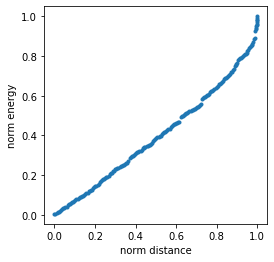

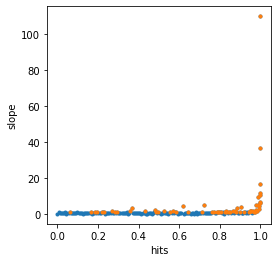

(48000098, 'e+')


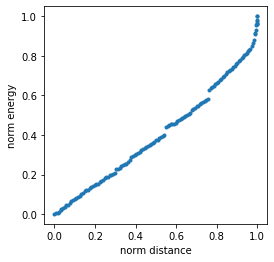

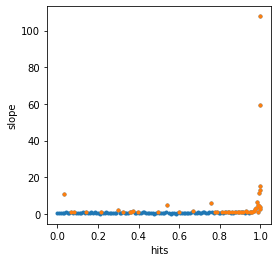

(48000098, 'e-')


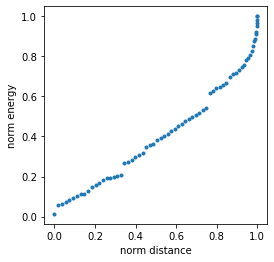

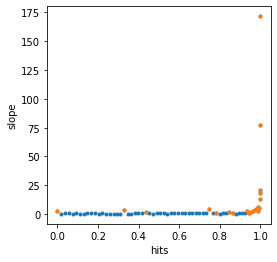

(48000099, 'e-')


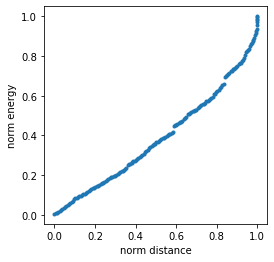

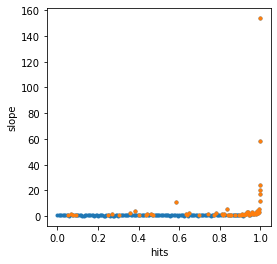

(48000101, 'e-')


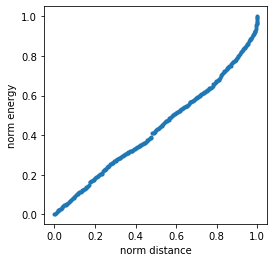

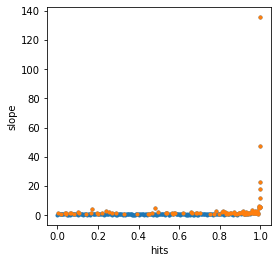

(48000102, 'e+')


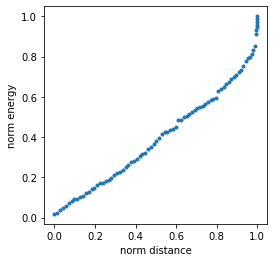

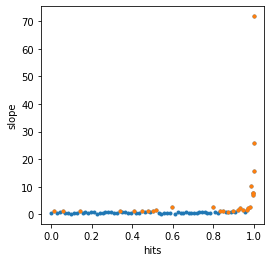

(48000102, 'e-')


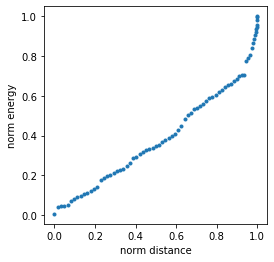

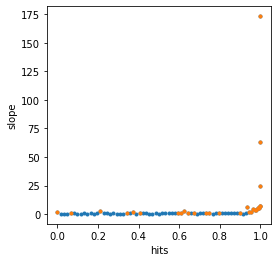

(48000103, 'e-')


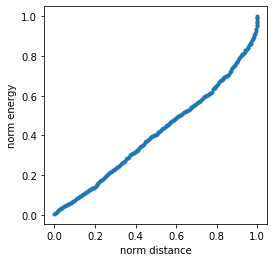

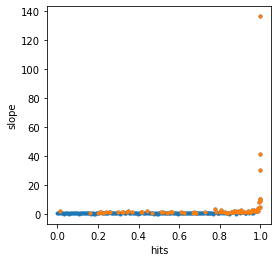

(48000104, 'e-')


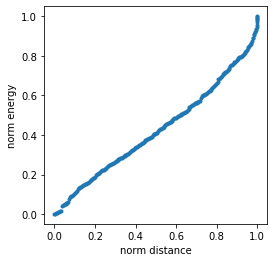

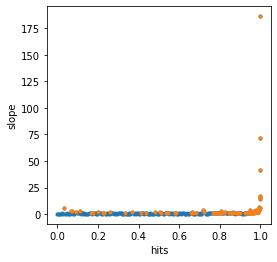

(48000106, 'e-')


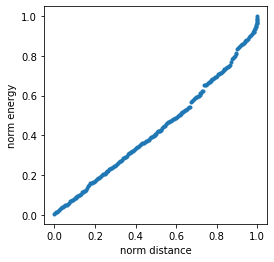

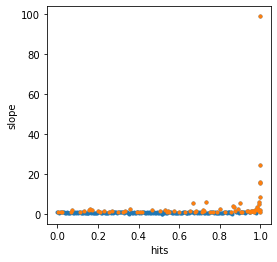

(48000107, 'e-')


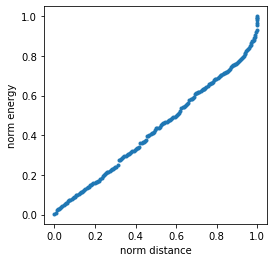

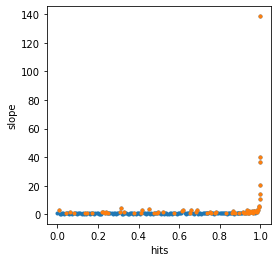

(48000108, 'e-')


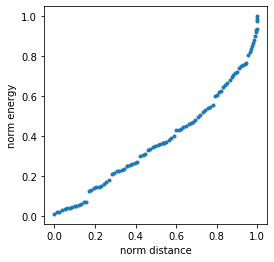

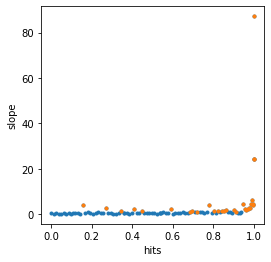

(48000109, 'e-')


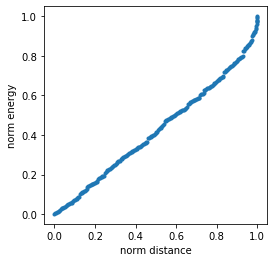

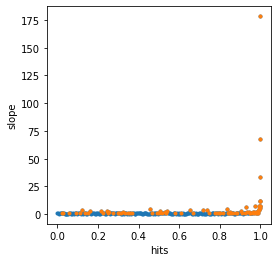

(48000110, 'e-')


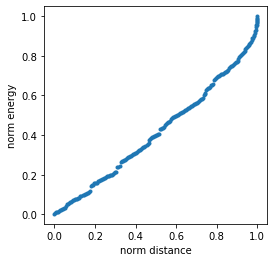

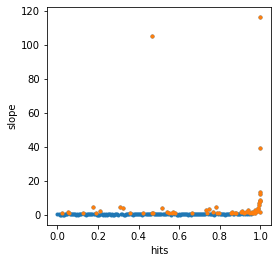

(48000111, 'e-')


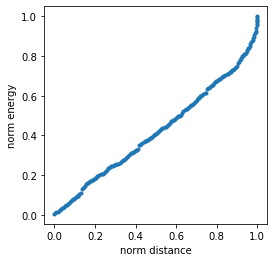

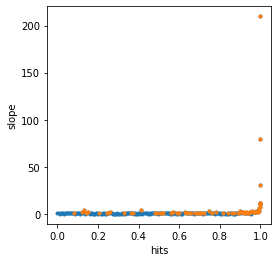

(48000112, 'e+')


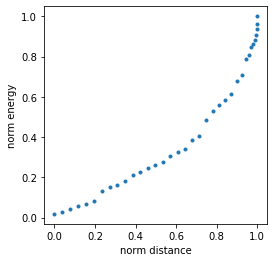

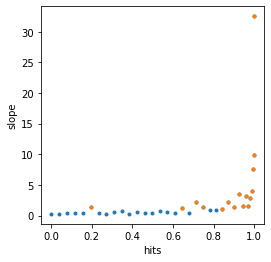

(48000112, 'e-')


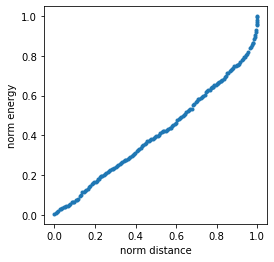

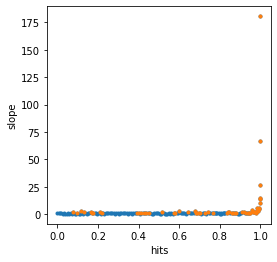

(48000113, 'e-')


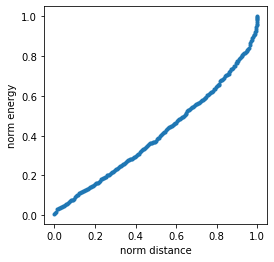

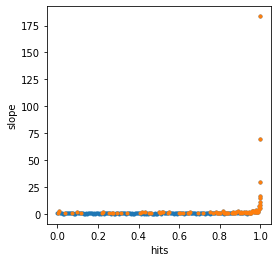

(48000114, 'e-')


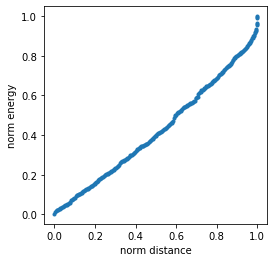

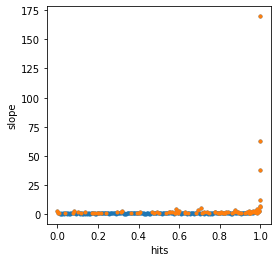

(48000115, 'e-')


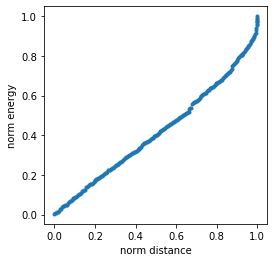

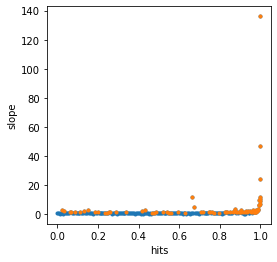

(48000116, 'e-')


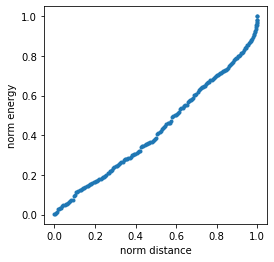

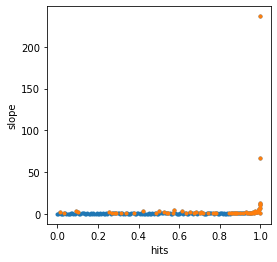

(48000117, 'e-')


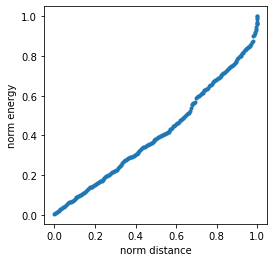

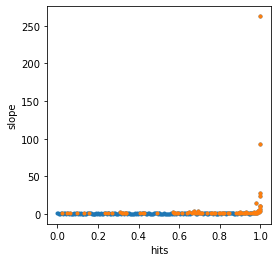

(48000118, 'e-')


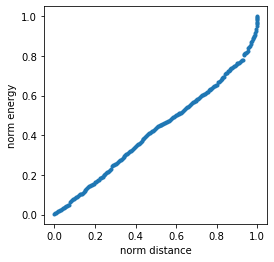

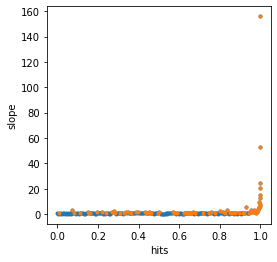

(48000119, 'e-')


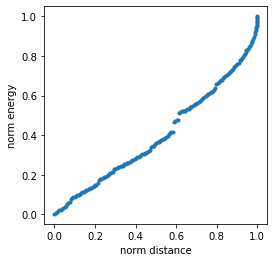

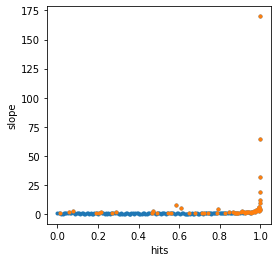

(48000120, 'e+')


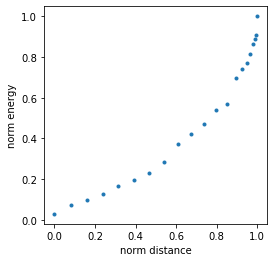

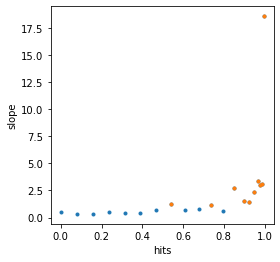

(48000120, 'e-')


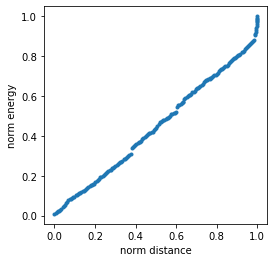

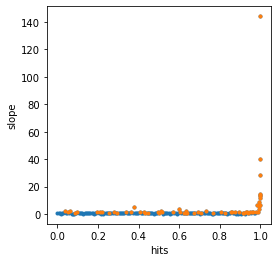

(48000121, 'e-')


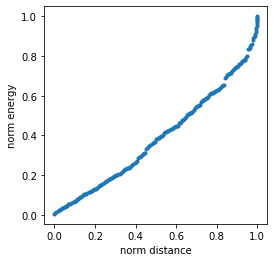

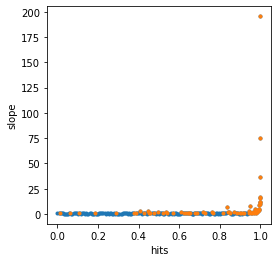

(48000122, 'e+')


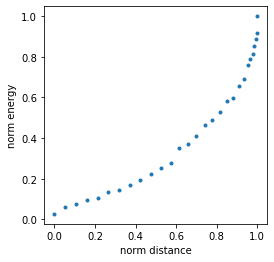

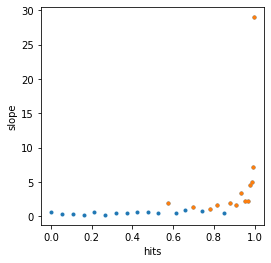

(48000122, 'e-')


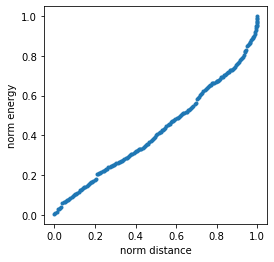

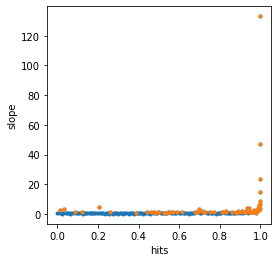

(48000123, 'e-')


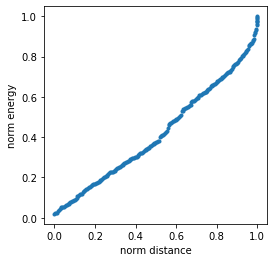

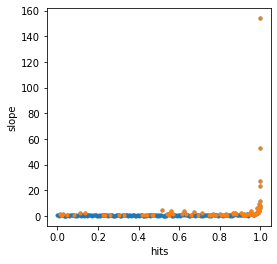

(48000124, 'e+')


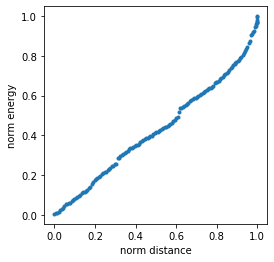

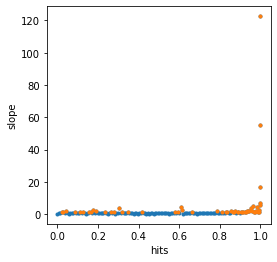

(48000124, 'e-')


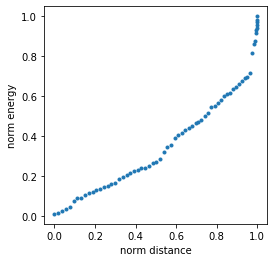

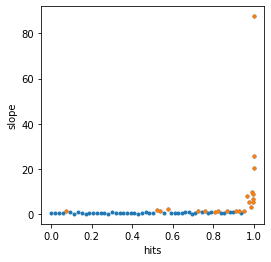

(48000125, 'e-')


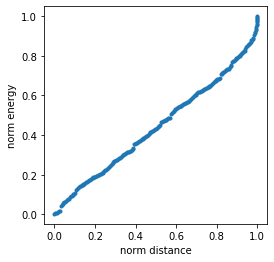

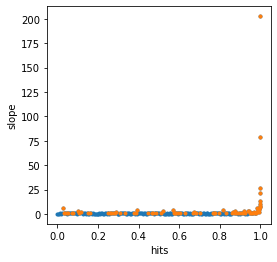

(48000126, 'e-')


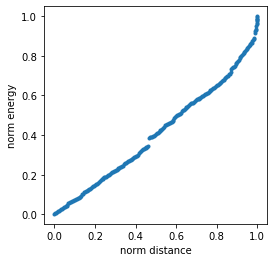

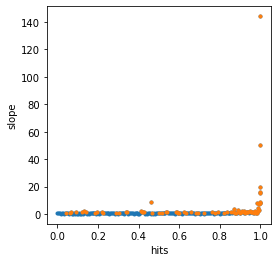

(48000127, 'e-')


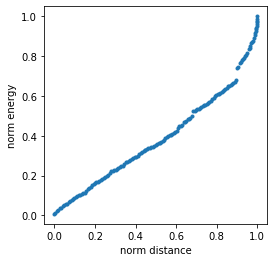

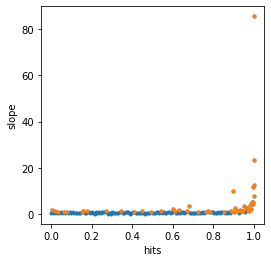

(48000128, 'e-')


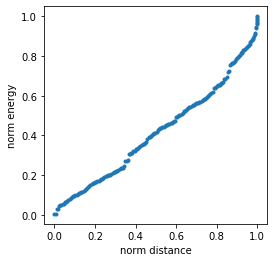

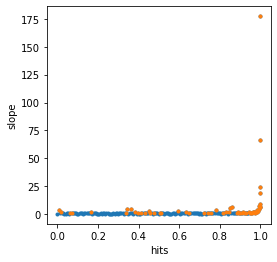

(48000129, 'e+')


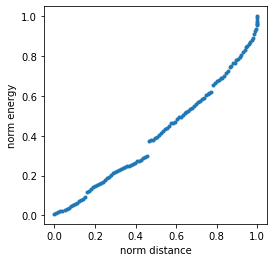

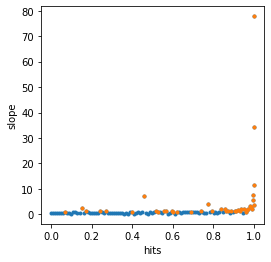

(48000129, 'e-')


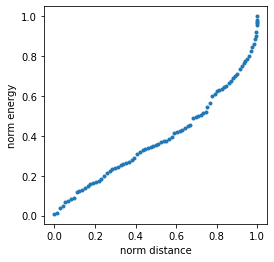

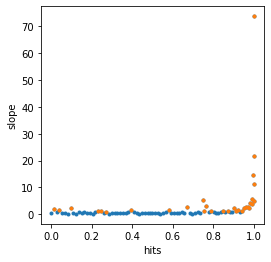

(48000130, 'e-')


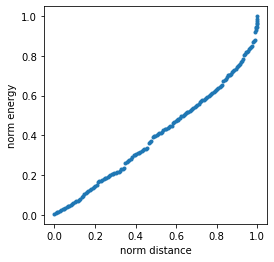

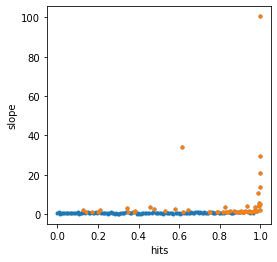

(48000131, 'e+')


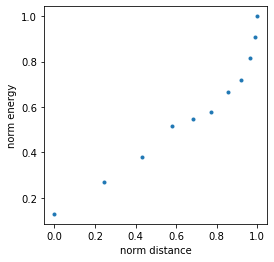

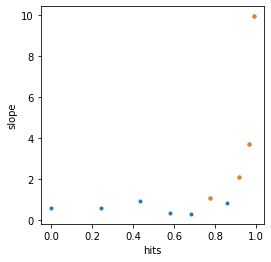

(48000131, 'e-')


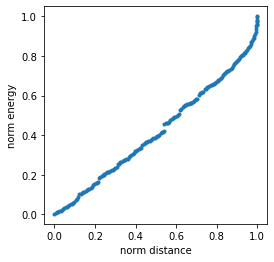

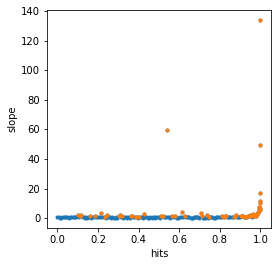

(48000132, 'e-')


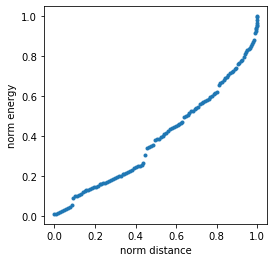

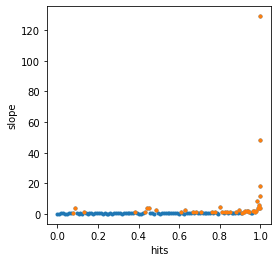

(48000133, 'e-')


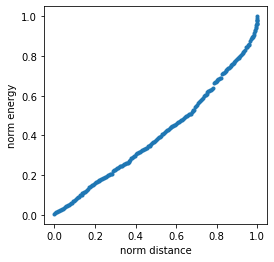

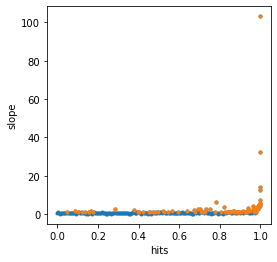

(48000134, 'e-')


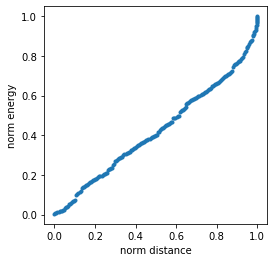

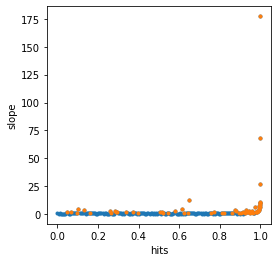

(48000135, 'e-')


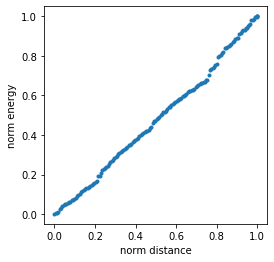

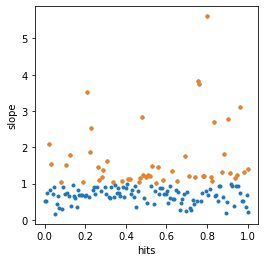

(48000136, 'e-')


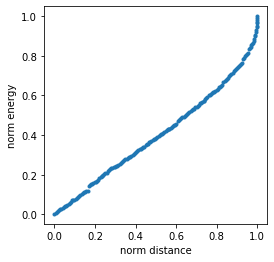

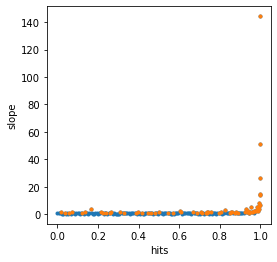

(48000137, 'e-')


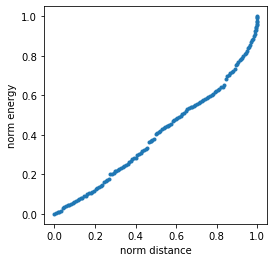

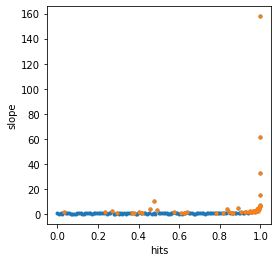

(48000138, 'e-')


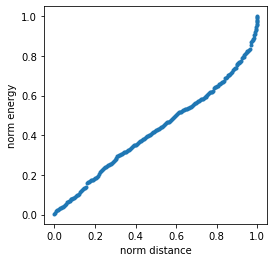

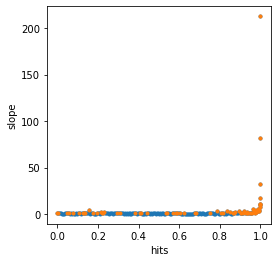

(48000139, 'e-')


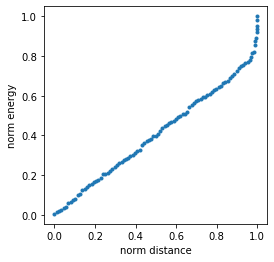

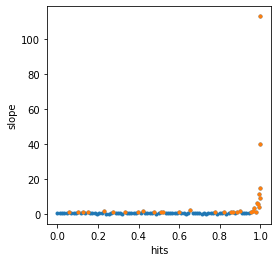

(48000140, 'e-')


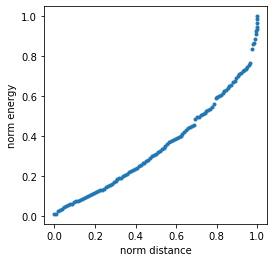

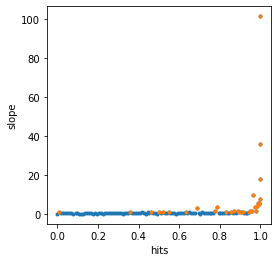

(48000141, 'e-')


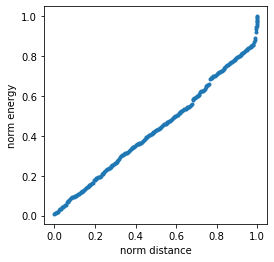

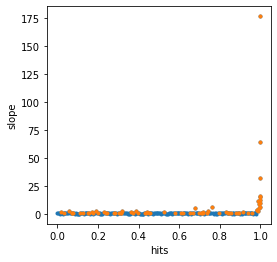

(48000142, 'e-')


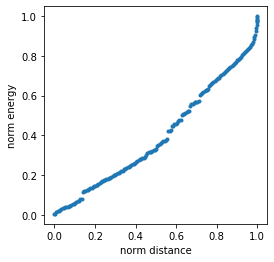

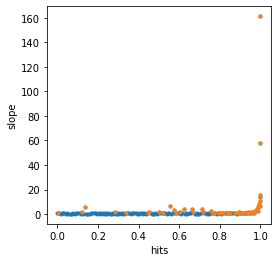

(48000143, 'e-')


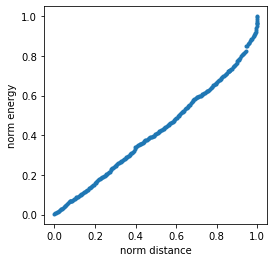

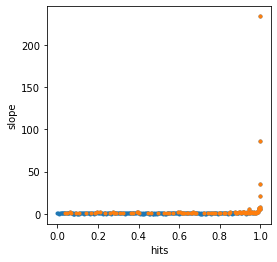

(48000144, 'e+')


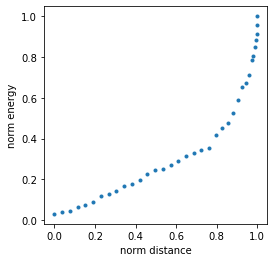

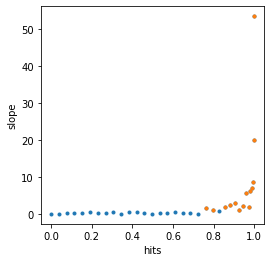

(48000144, 'e-')


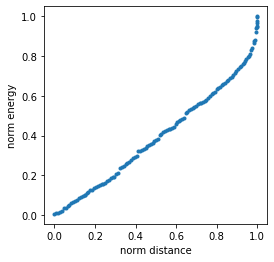

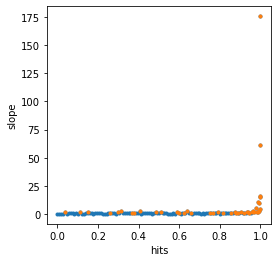

(48000145, 'e+')


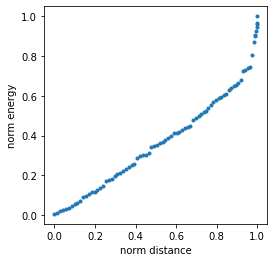

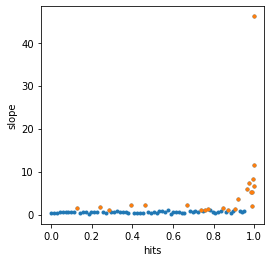

(48000145, 'e-')


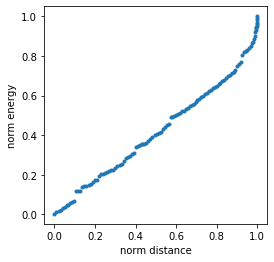

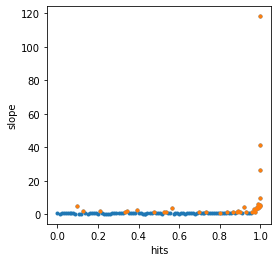

(48000146, 'e-')


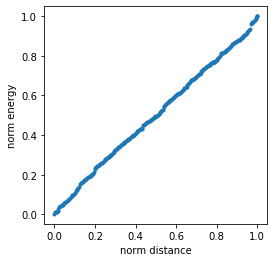

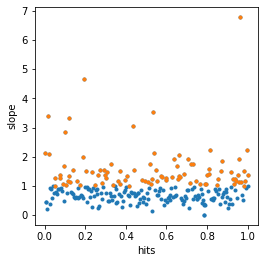

(48000147, 'e-')


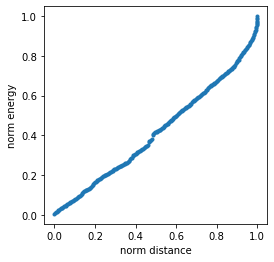

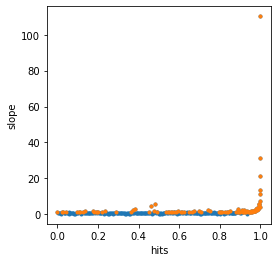

(48000148, 'e-')


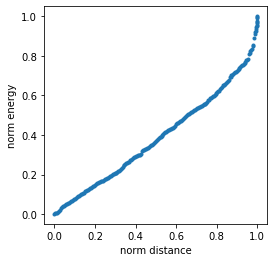

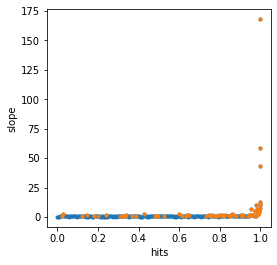

(48000149, 'e-')


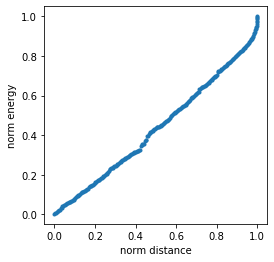

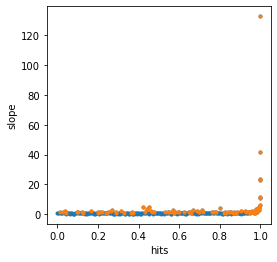

(48000150, 'e-')


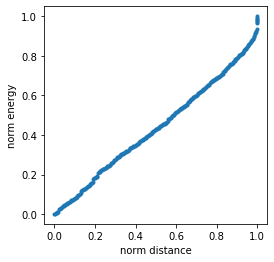

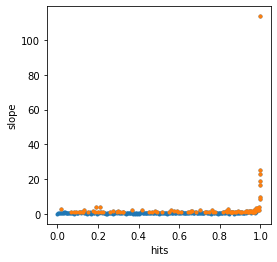

(48000151, 'e+')


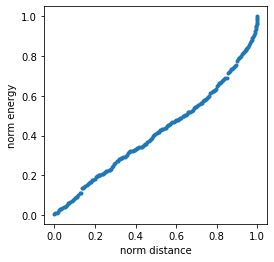

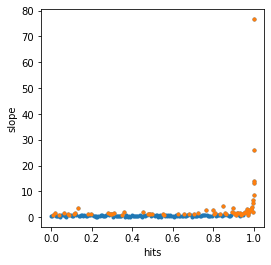

(48000151, 'e-')


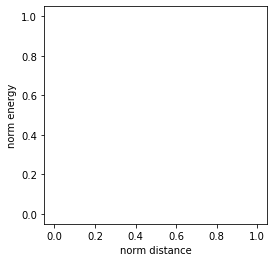

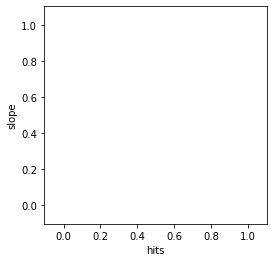

(48000152, 'e+')


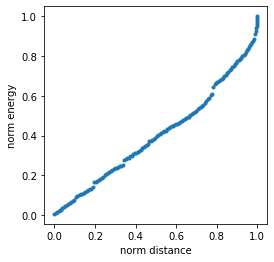

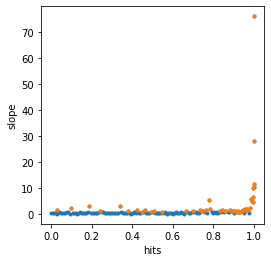

(48000152, 'e-')


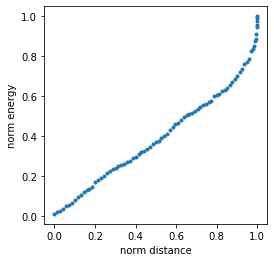

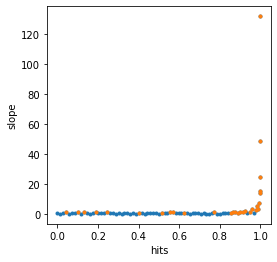

(48000153, 'e+')


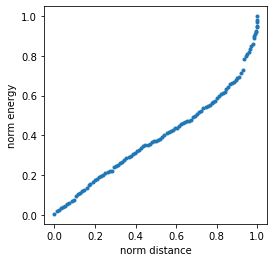

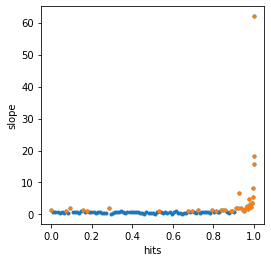

(48000153, 'e-')


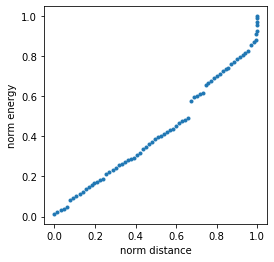

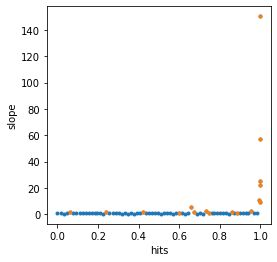

(48000154, 'e+')


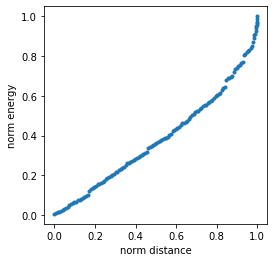

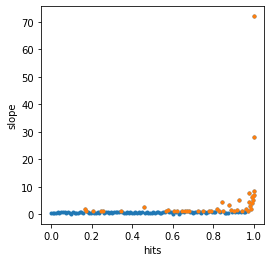

(48000154, 'e-')


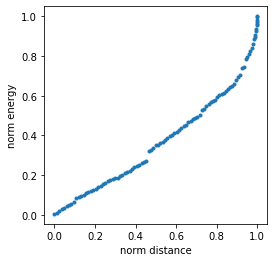

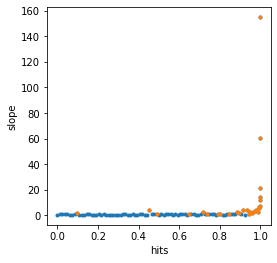

(48000155, 'e-')


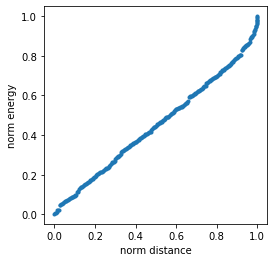

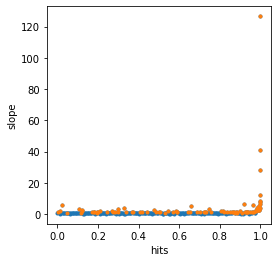

(48000156, 'e-')


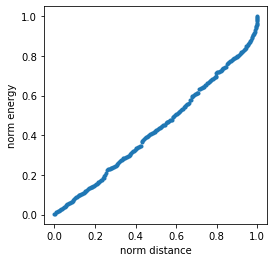

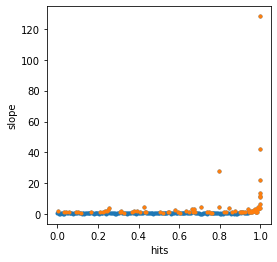

(48000157, 'e-')


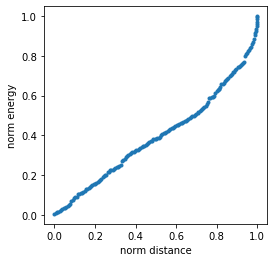

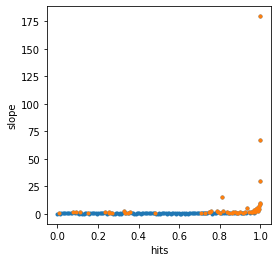

(48000158, 'e+')


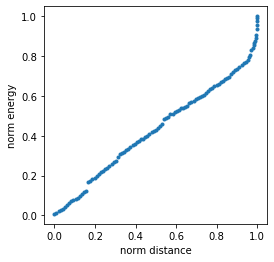

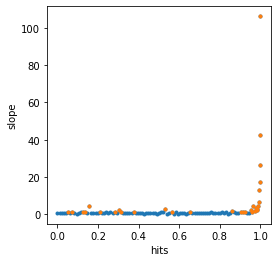

(48000158, 'e-')


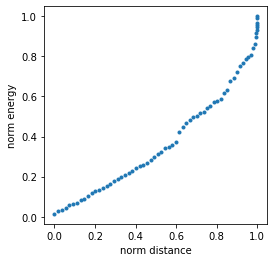

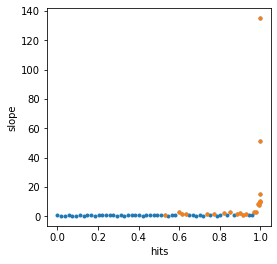

(48000159, 'e-')


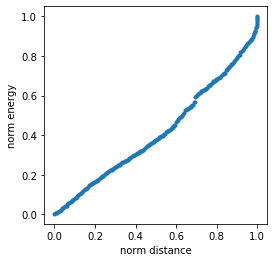

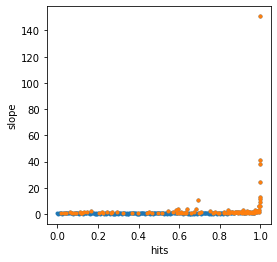

(48000160, 'e-')


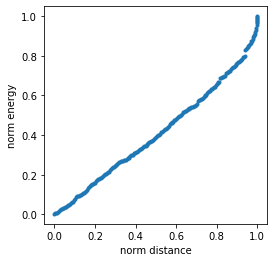

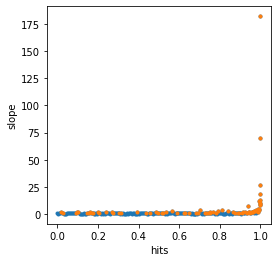

(48000161, 'e-')


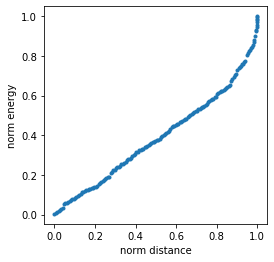

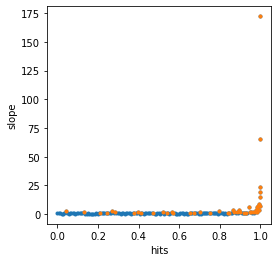

(48000162, 'e-')


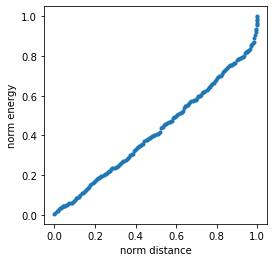

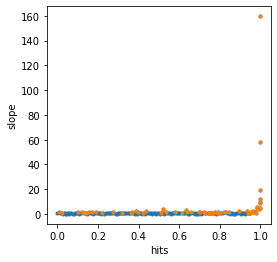

(48000163, 'e+')


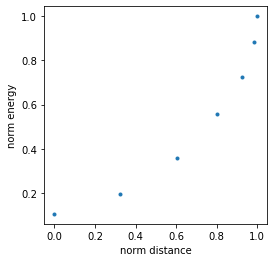

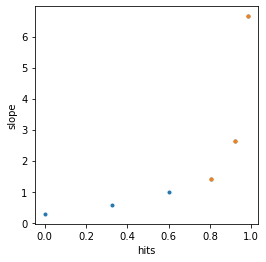

(48000163, 'e-')


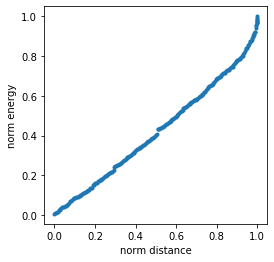

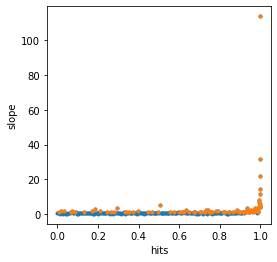

(48000164, 'e-')


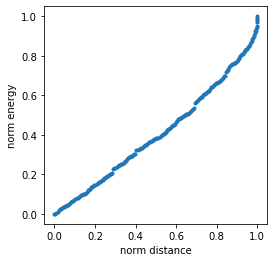

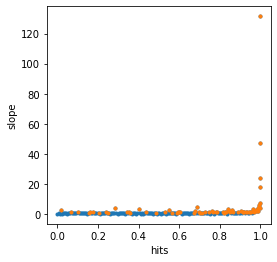

(48000165, 'e-')


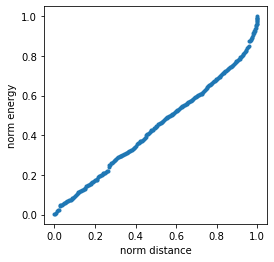

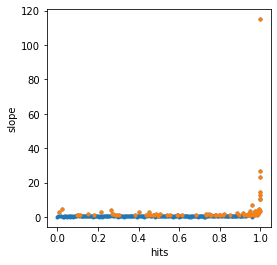

(48000166, 'e-')


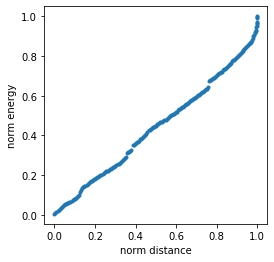

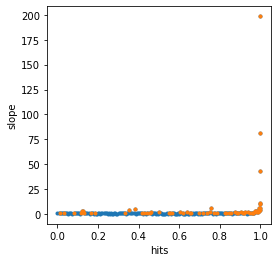

(48000167, 'e-')


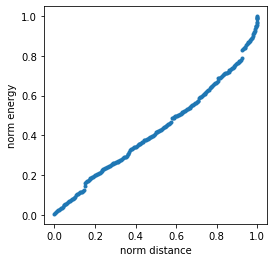

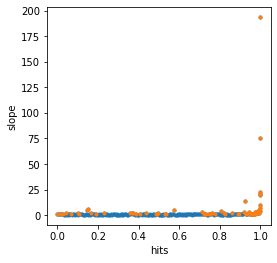

(48000168, 'e+')


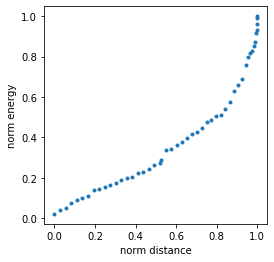

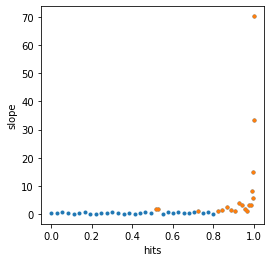

(48000168, 'e-')


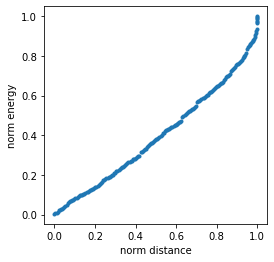

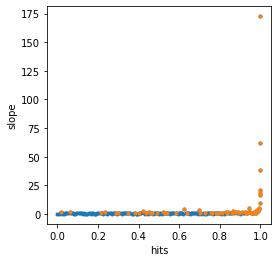

(48000169, 'e+')


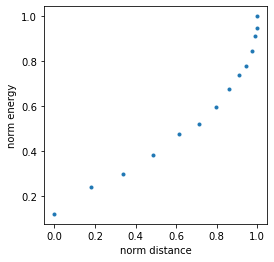

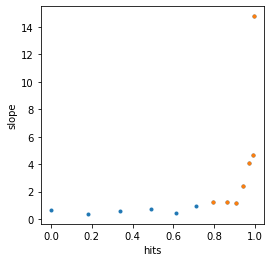

(48000169, 'e-')


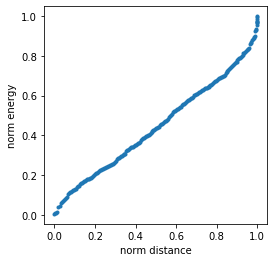

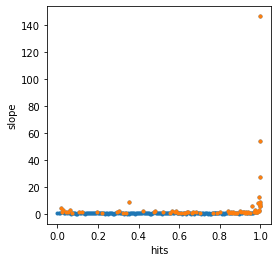

(48000170, 'e+')


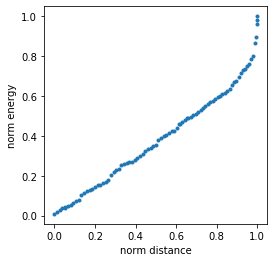

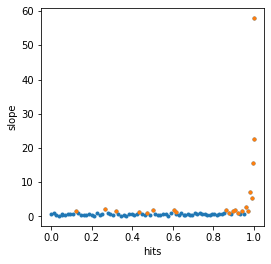

(48000170, 'e-')


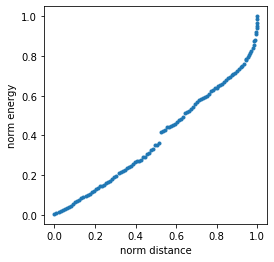

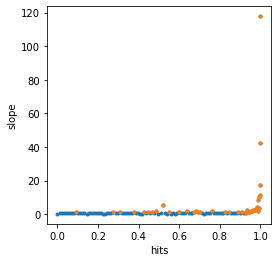

(48000171, 'e+')


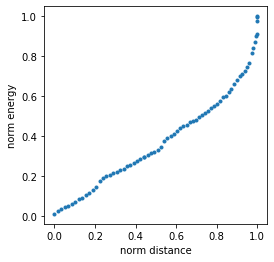

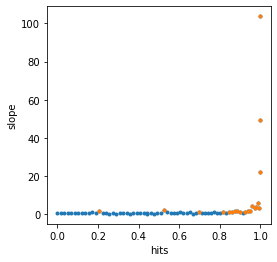

(48000171, 'e-')


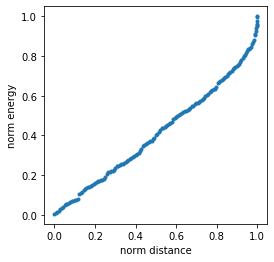

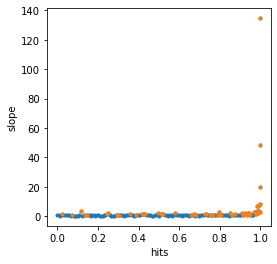

(48000172, 'e-')


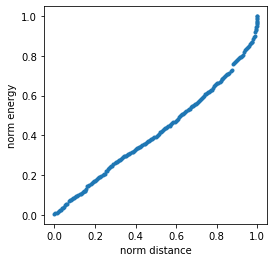

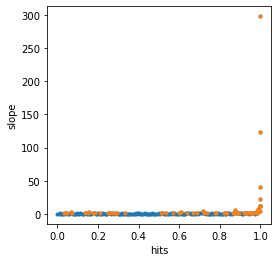

(48000173, 'e-')


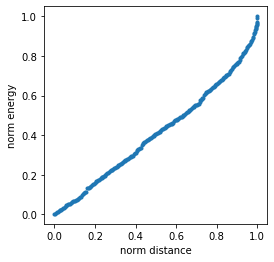

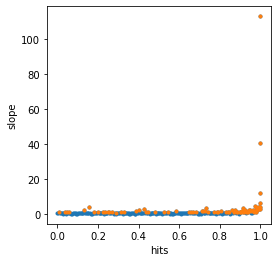

(48000174, 'e+')


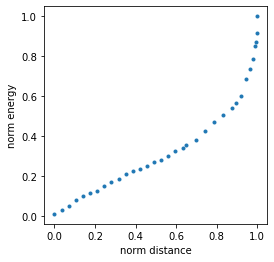

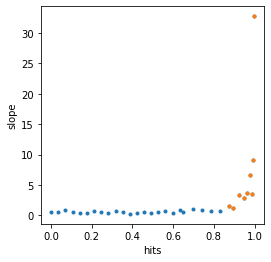

(48000174, 'e-')


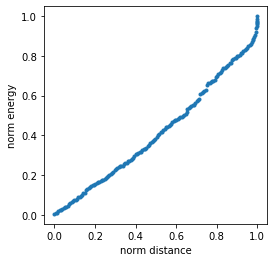

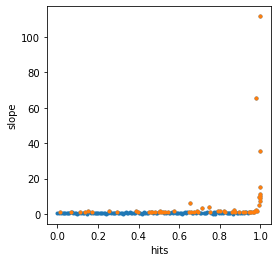

(48000175, 'e-')


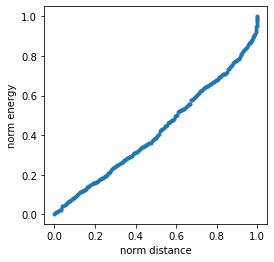

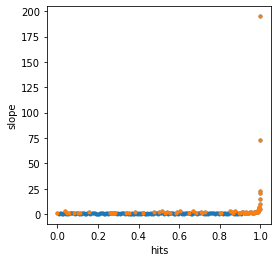

(48000176, 'e-')


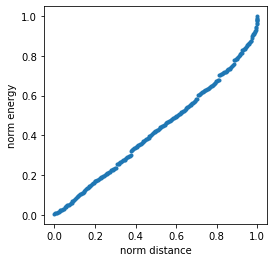

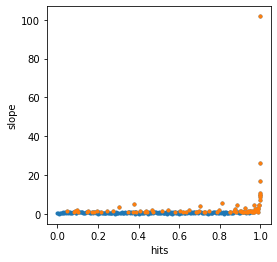

(48000177, 'e-')


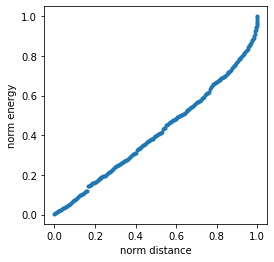

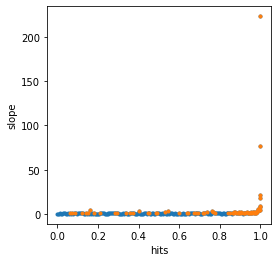

(48000178, 'e+')


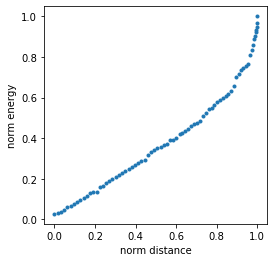

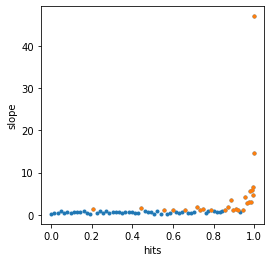

(48000178, 'e-')


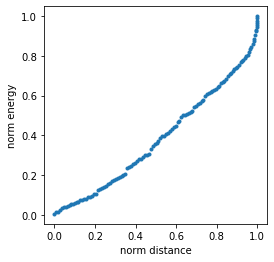

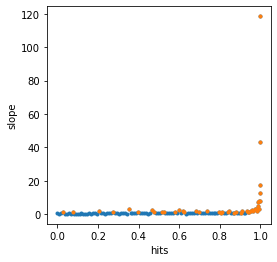

(48000179, 'e-')


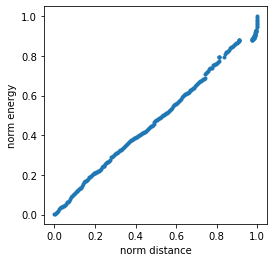

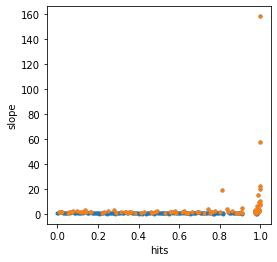

(48000180, 'e-')


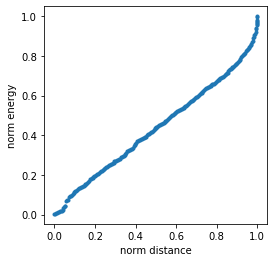

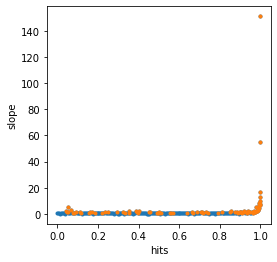

(48000181, 'e+')


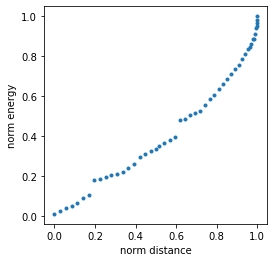

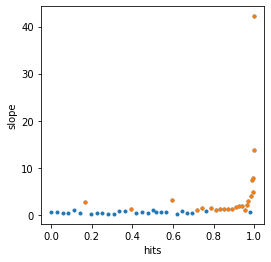

(48000181, 'e-')


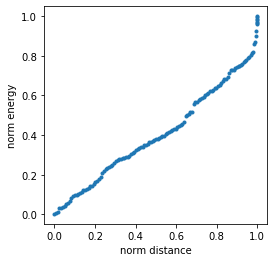

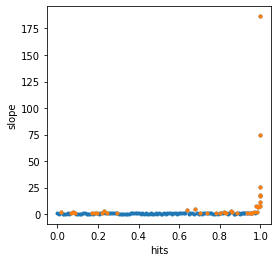

(48000182, 'e-')


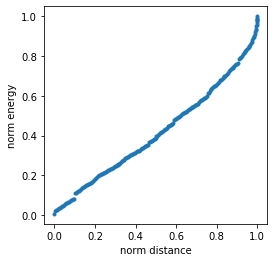

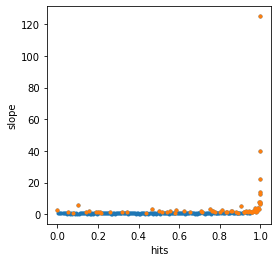

(48000183, 'e-')


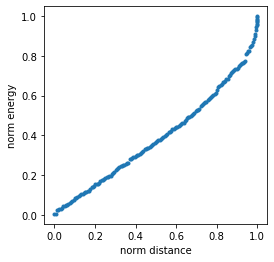

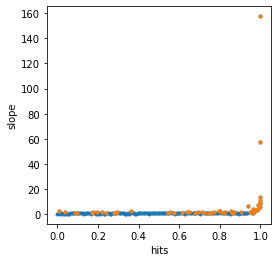

(48000184, 'e+')


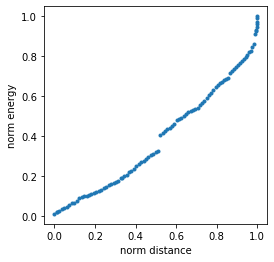

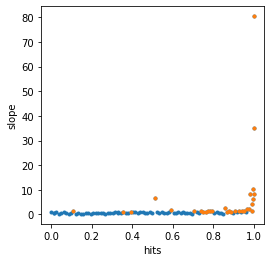

(48000184, 'e-')


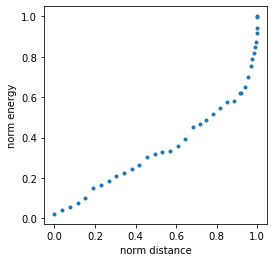

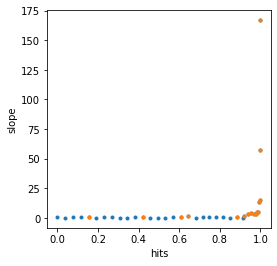

(48000185, 'e+')


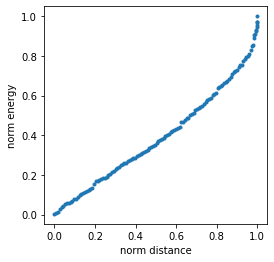

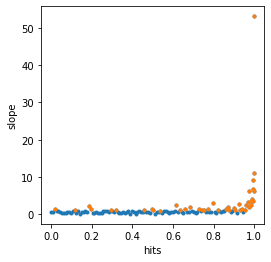

(48000185, 'e-')


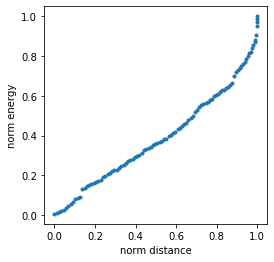

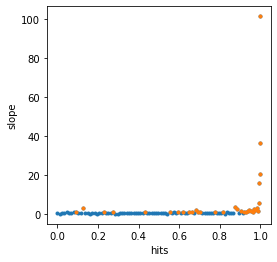

(48000186, 'e-')


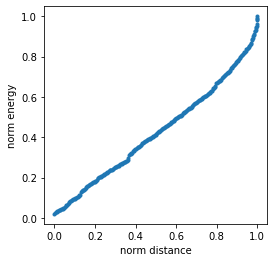

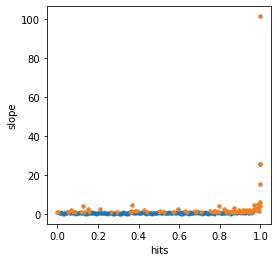

(48000187, 'e+')


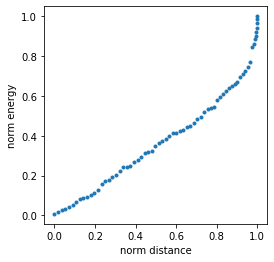

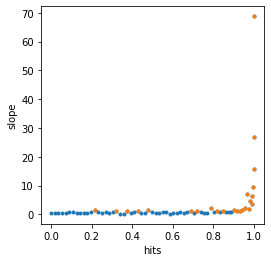

(48000187, 'e-')


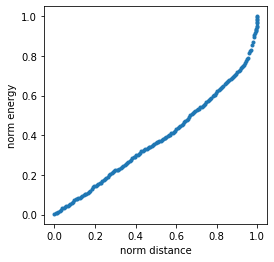

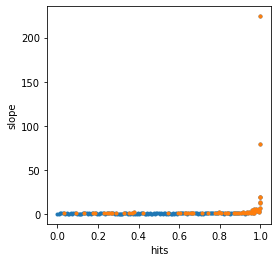

(48000188, 'e+')


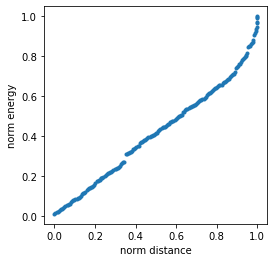

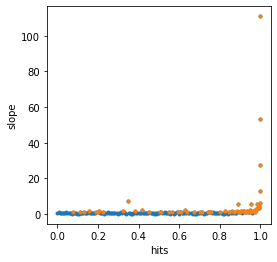

(48000188, 'e-')


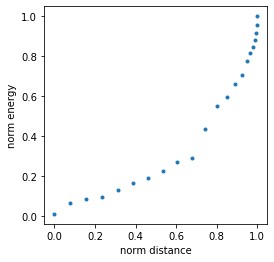

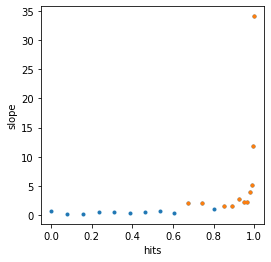

(48000189, 'e-')


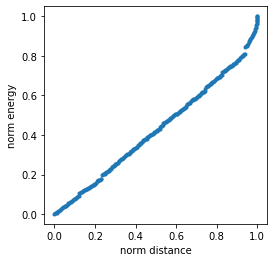

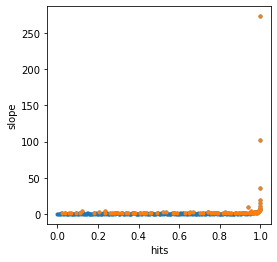

(48000190, 'e-')


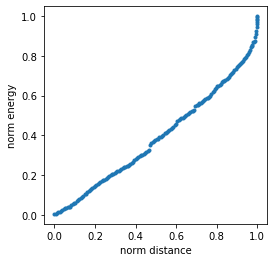

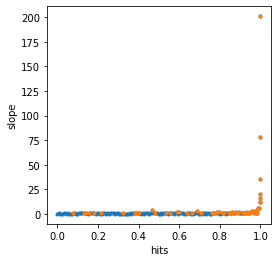

(48000191, 'e+')


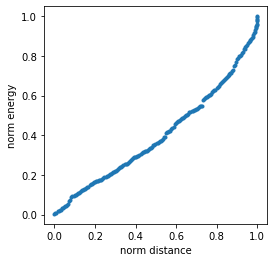

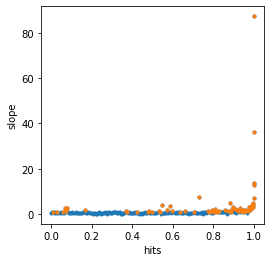

(48000191, 'e-')


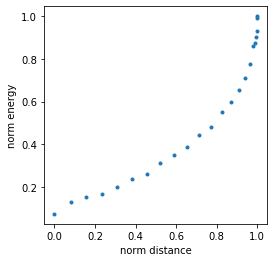

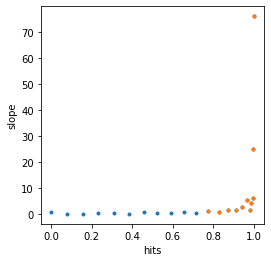

(48000192, 'e+')


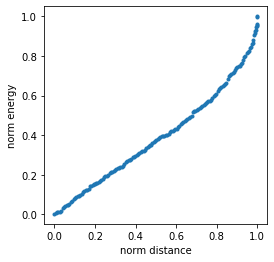

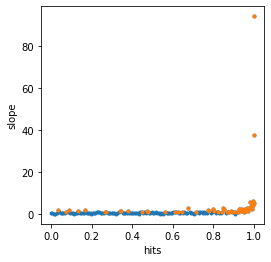

(48000192, 'e-')


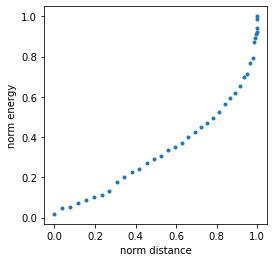

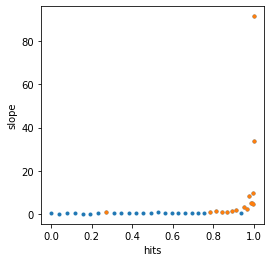

(48000193, 'e-')


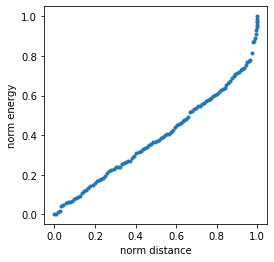

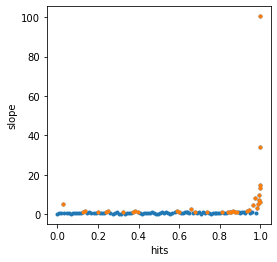

(48000194, 'e-')


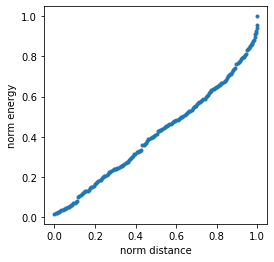

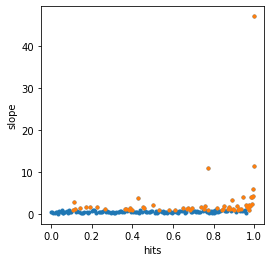

(48000195, 'e-')


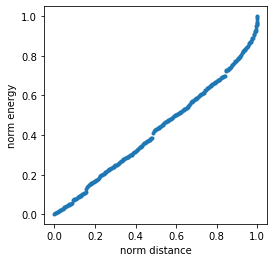

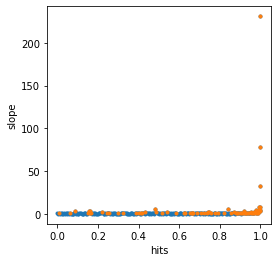

(48000196, 'e-')


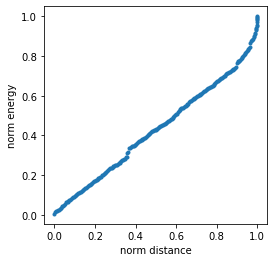

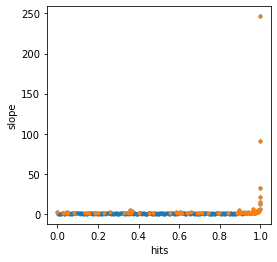

(48000197, 'e-')


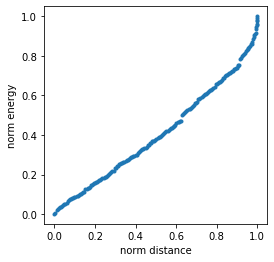

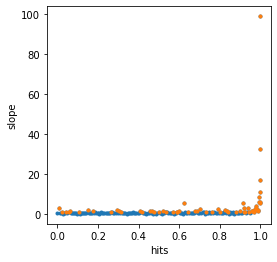

(48000198, 'e-')


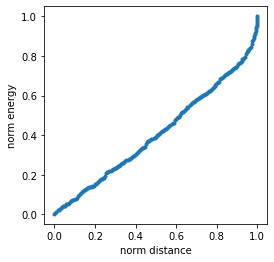

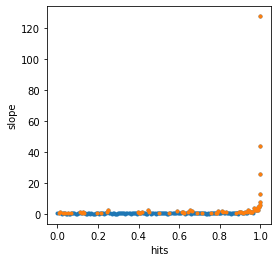

(48000199, 'e-')


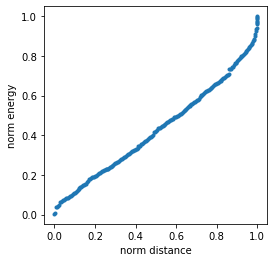

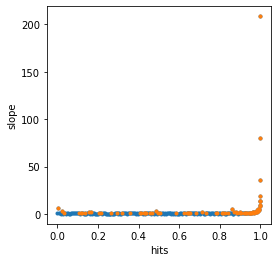

(48000200, 'e-')


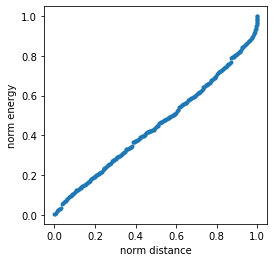

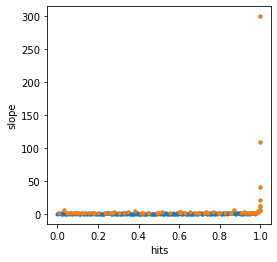

(48000202, 'e-')


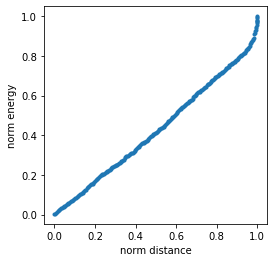

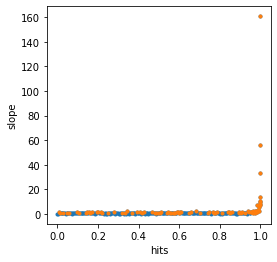

(48000203, 'e-')


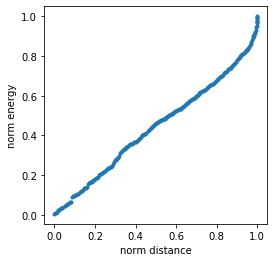

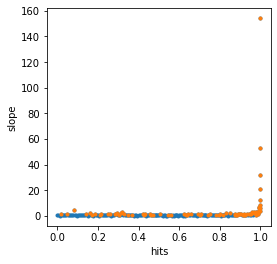

(48000204, 'e-')


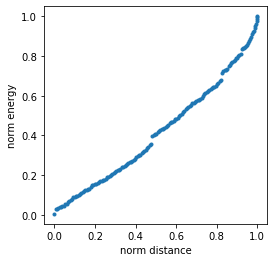

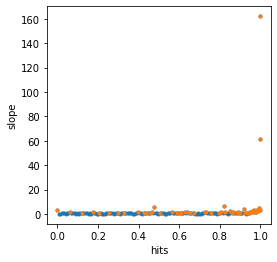

(48000205, 'e-')


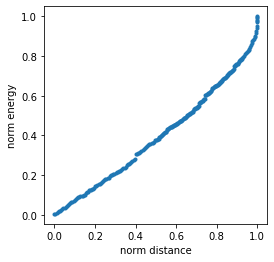

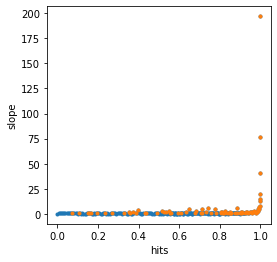

(48000206, 'e-')


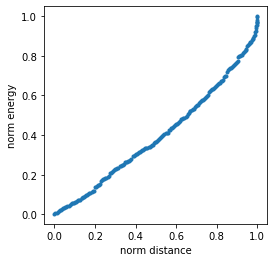

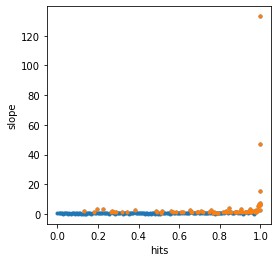

(48000207, 'e-')


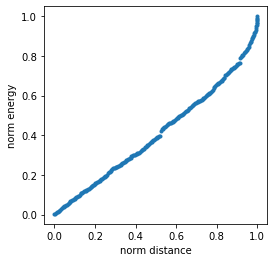

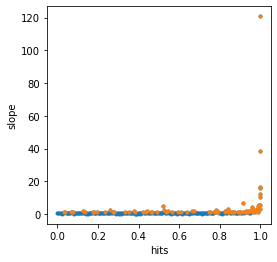

(48000208, 'e-')


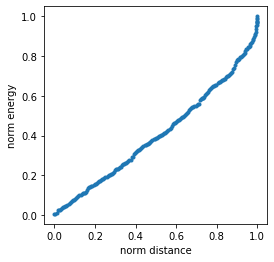

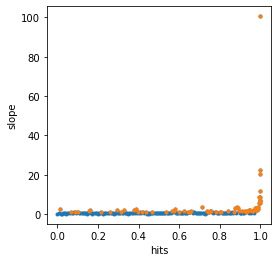

(48000209, 'e-')


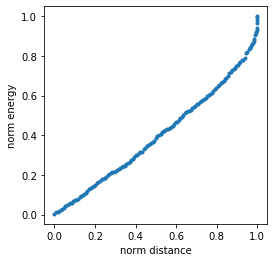

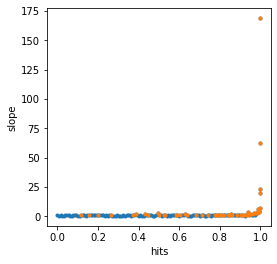

(48000210, 'e-')


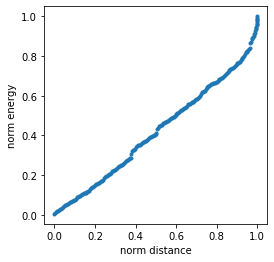

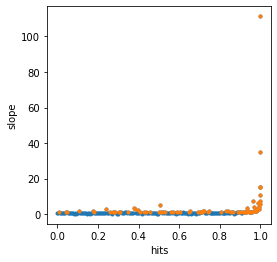

(48000211, 'e-')


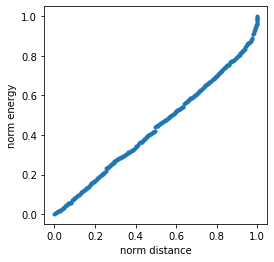

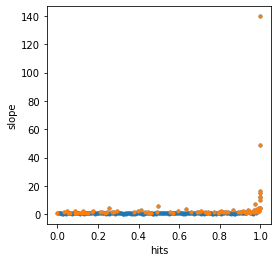

(48000212, 'e-')


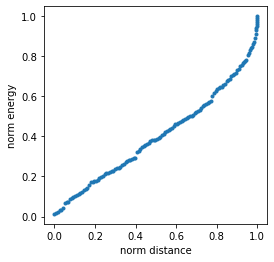

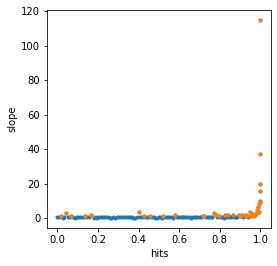

(48000213, 'e-')


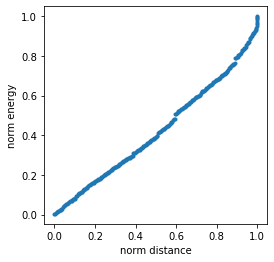

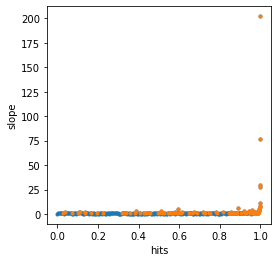

(48000214, 'e-')


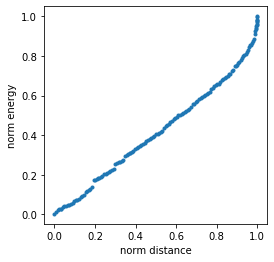

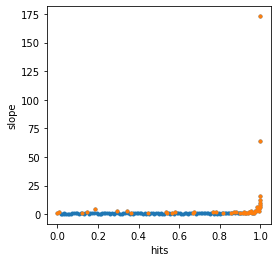

(48000215, 'e-')


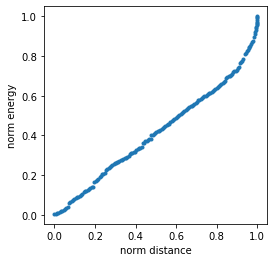

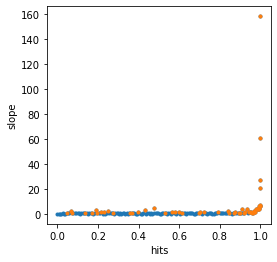

(48000216, 'e-')


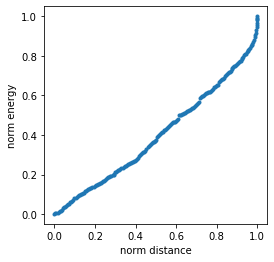

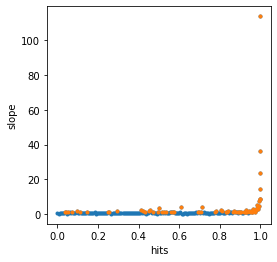

(48000217, 'e+')


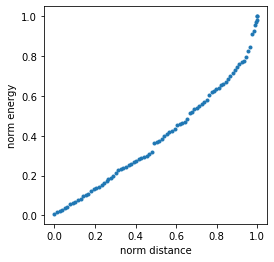

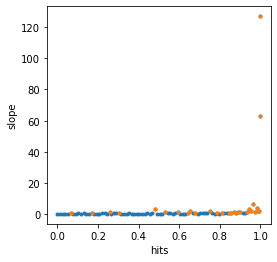

(48000217, 'e-')


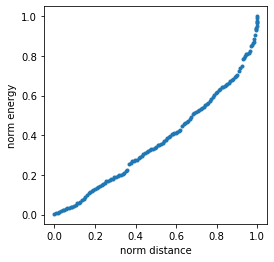

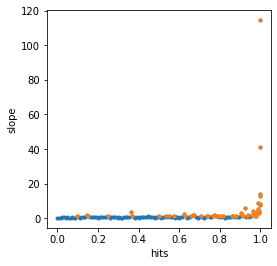

(48000218, 'e-')


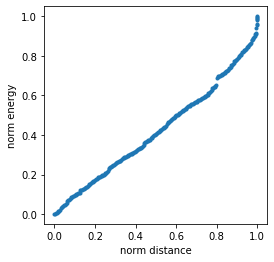

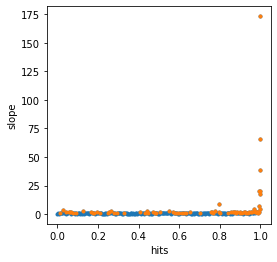

(48000219, 'e-')


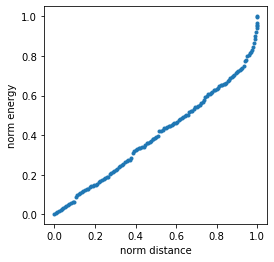

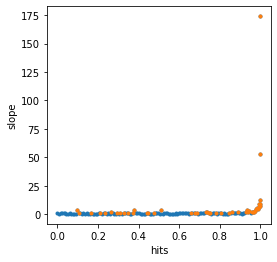

(48000220, 'e-')


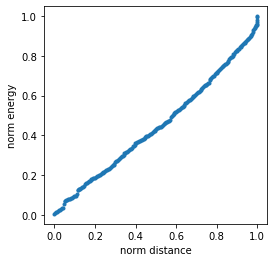

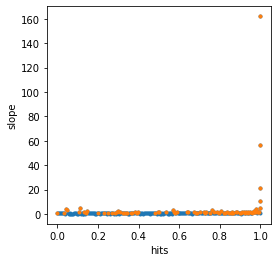

(48000221, 'e+')


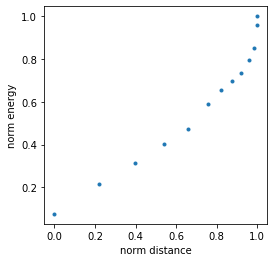

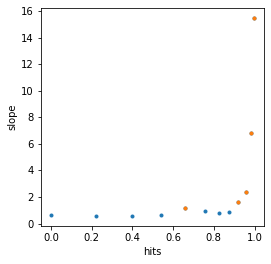

(48000221, 'e-')


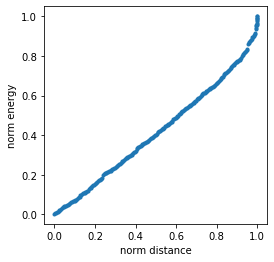

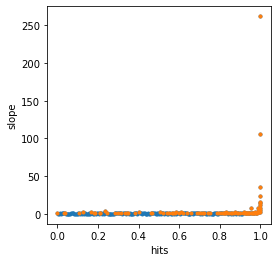

(48000222, 'e+')


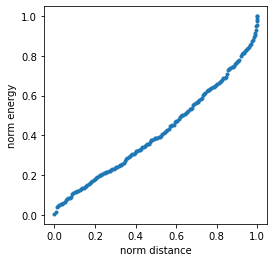

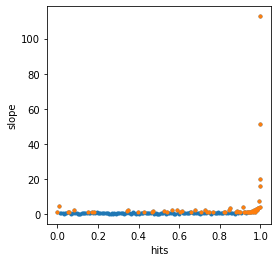

(48000222, 'e-')


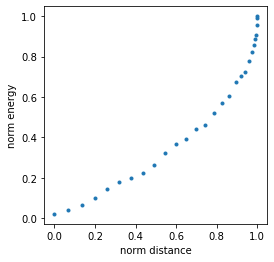

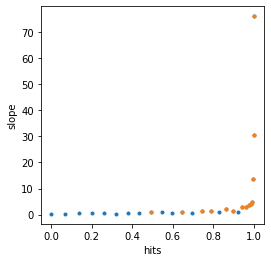

(48000223, 'e-')


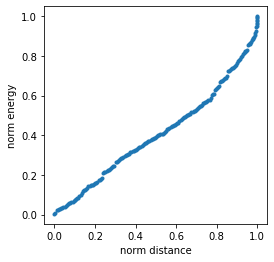

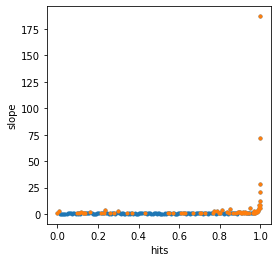

(48000224, 'e-')


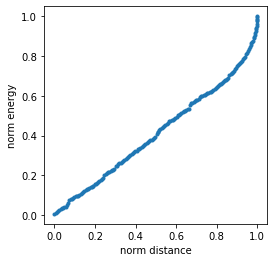

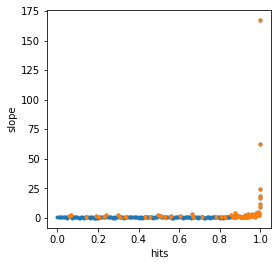

(48000225, 'e+')


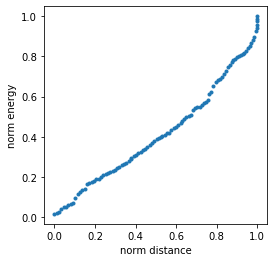

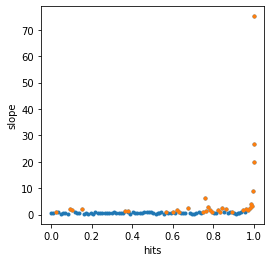

(48000225, 'e-')


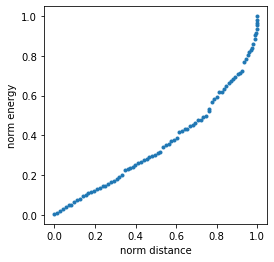

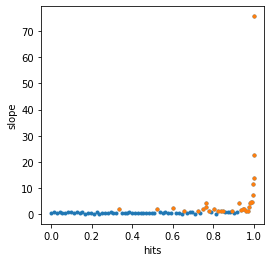

(48000226, 'e-')


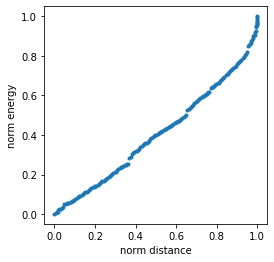

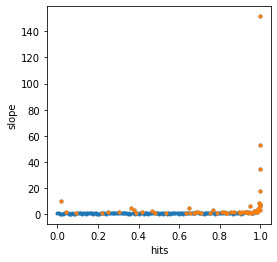

(48000228, 'e-')


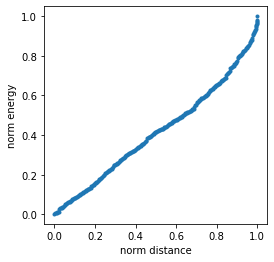

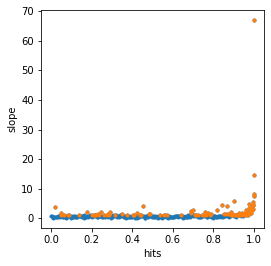

(48000229, 'e-')


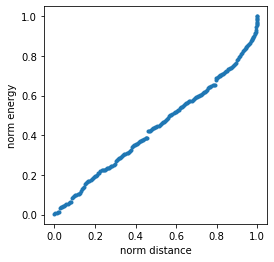

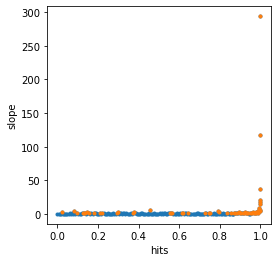

(48000230, 'e-')


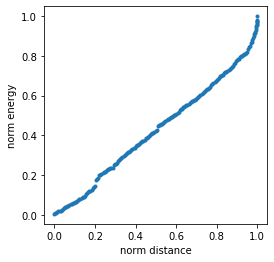

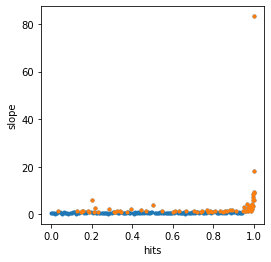

(48000231, 'e-')


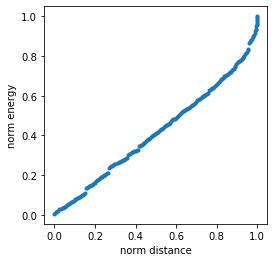

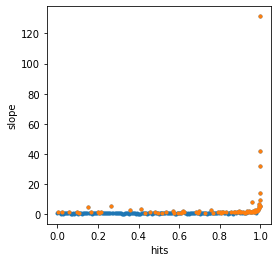

(48000232, 'e-')


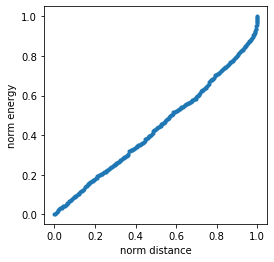

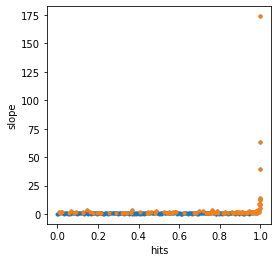

(48000233, 'e-')


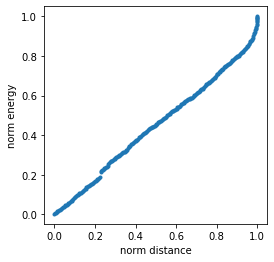

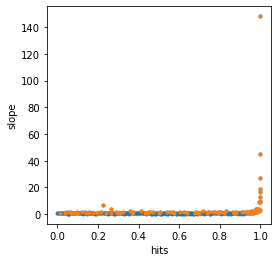

(48000234, 'e-')


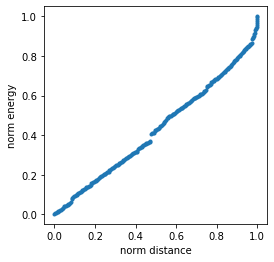

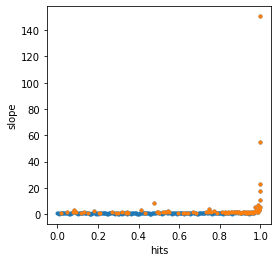

(48000235, 'e+')


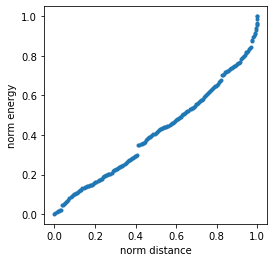

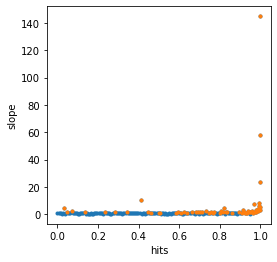

(48000235, 'e-')


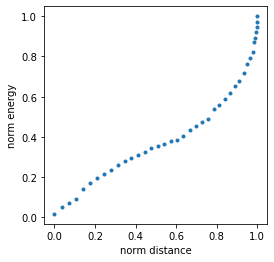

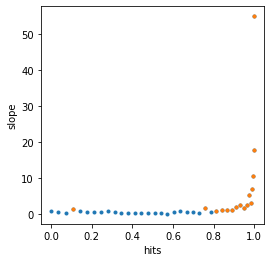

(48000236, 'e+')


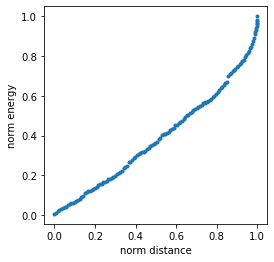

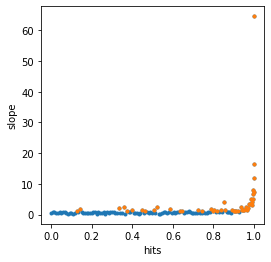

(48000236, 'e-')


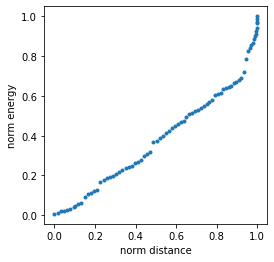

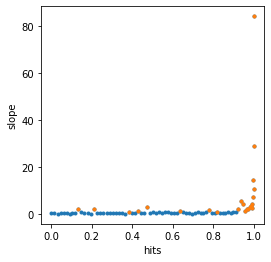

(48000237, 'e-')


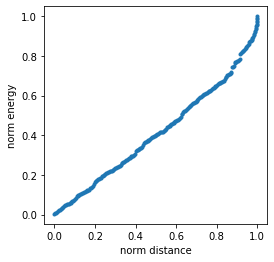

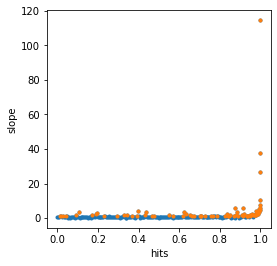

(48000238, 'e-')


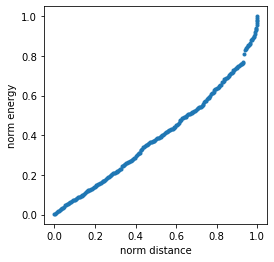

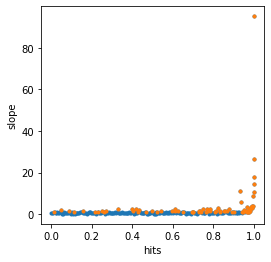

(48000239, 'e-')


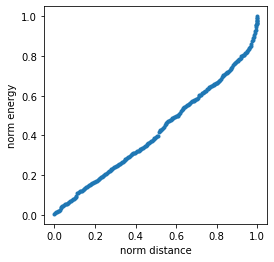

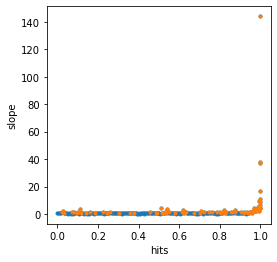

(48000240, 'e-')


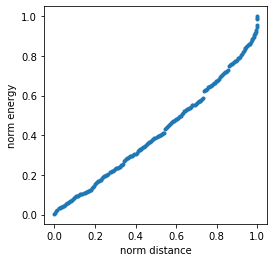

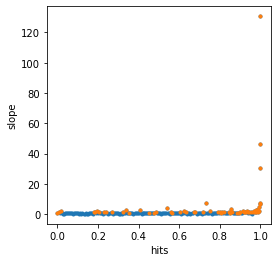

(48000241, 'e-')


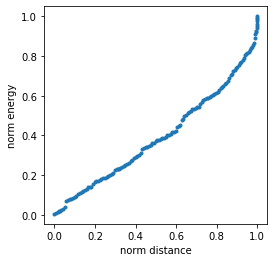

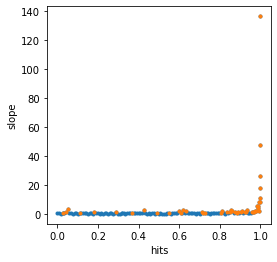

(48000242, 'e-')


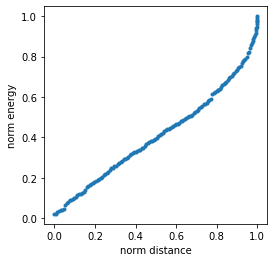

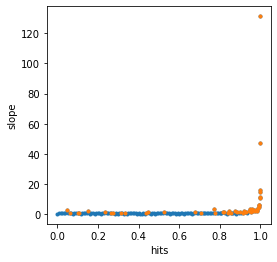

(48000243, 'e+')


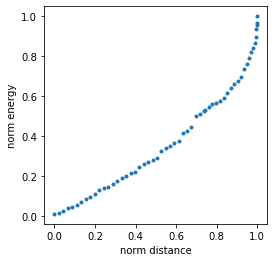

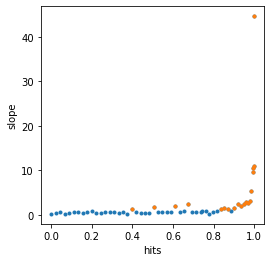

(48000243, 'e-')


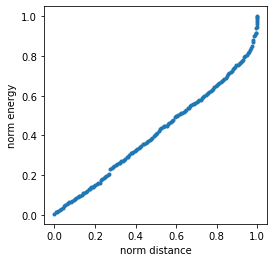

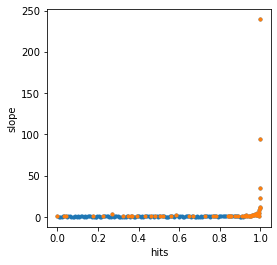

(48000244, 'e-')


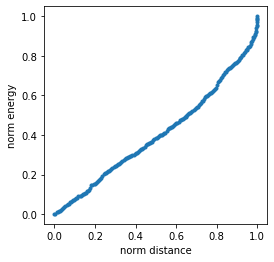

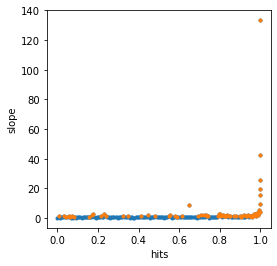

(48000245, 'e-')


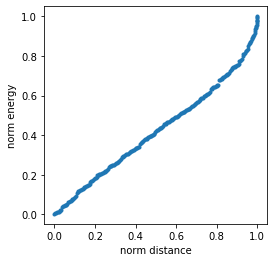

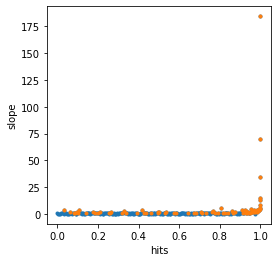

(48000246, 'e-')


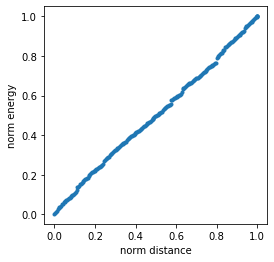

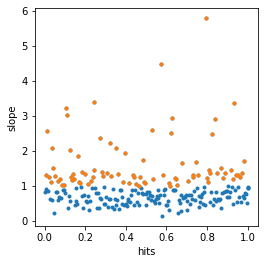

(48000247, 'e-')


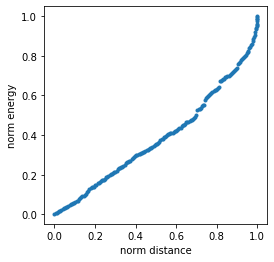

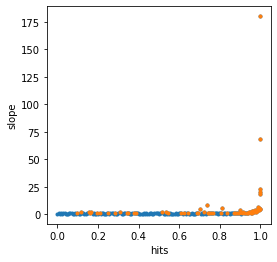

(48000248, 'e-')


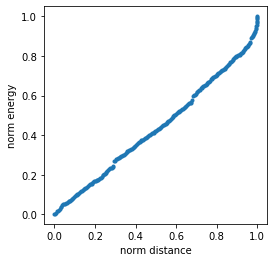

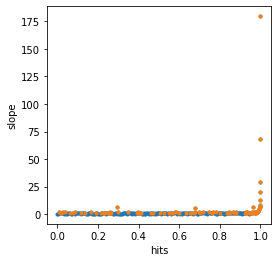

(48000249, 'e-')


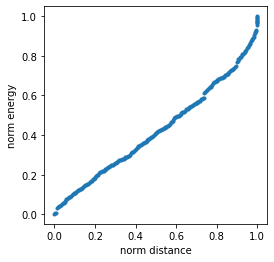

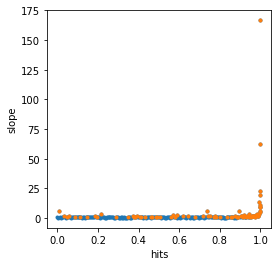

(48000250, 'e-')


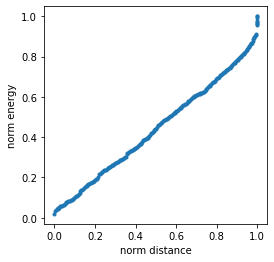

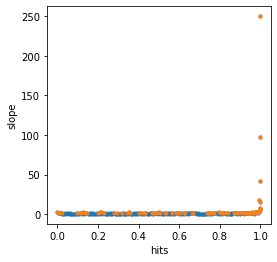

(48000251, 'e-')


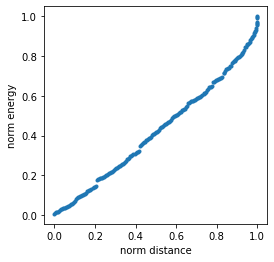

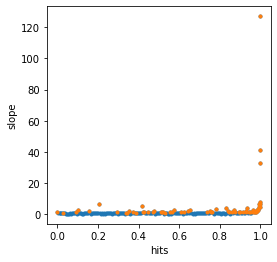

(48000252, 'e+')


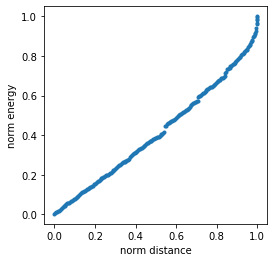

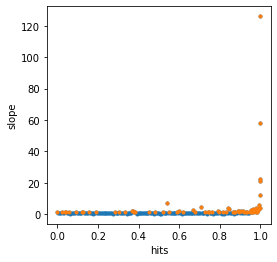

(48000252, 'e-')


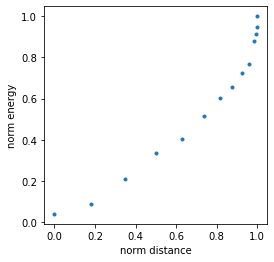

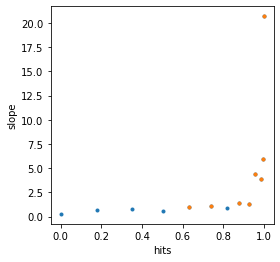

(48000253, 'e-')


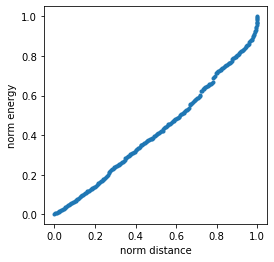

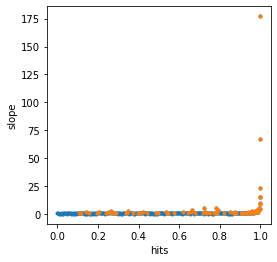

(48000254, 'e-')


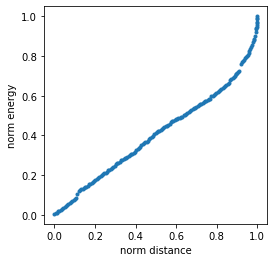

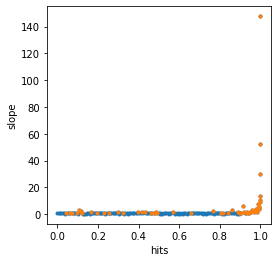

(48000255, 'e-')


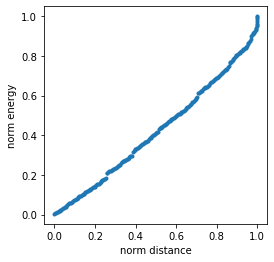

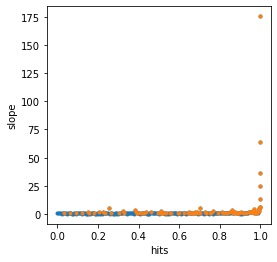

(48000256, 'e-')


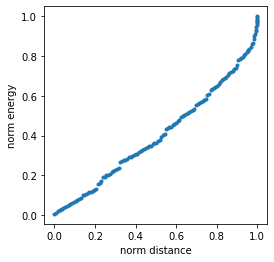

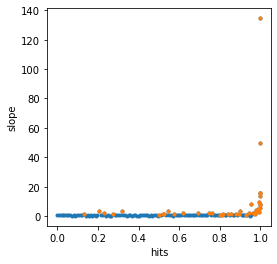

(48000257, 'e-')


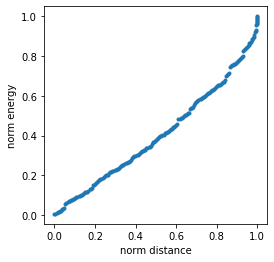

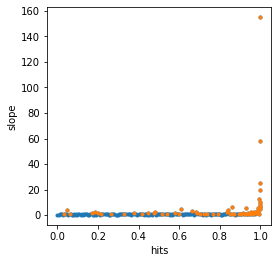

(48000258, 'e-')


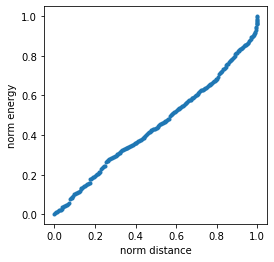

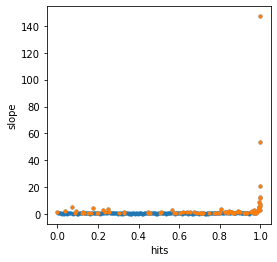

(48000259, 'e-')


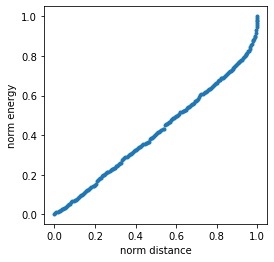

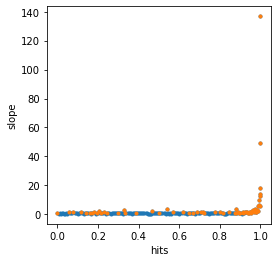

(48000260, 'e-')


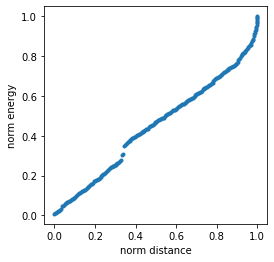

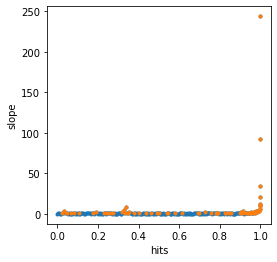

(48000261, 'e-')


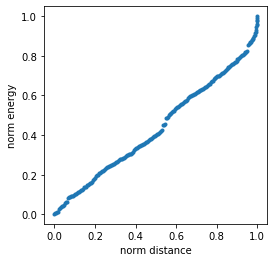

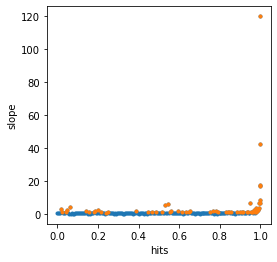

(48000262, 'e-')


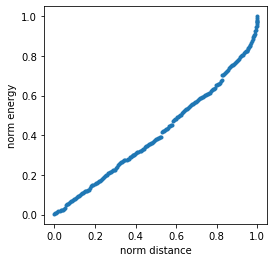

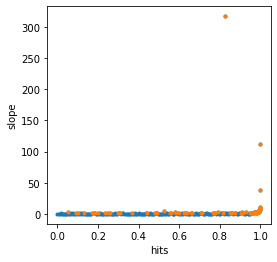

(48000263, 'e-')


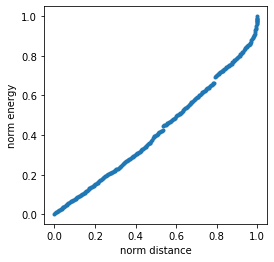

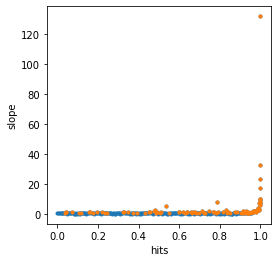

(48000264, 'e-')


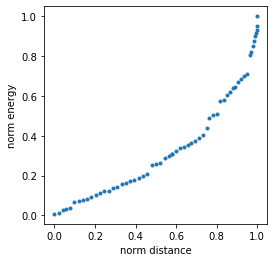

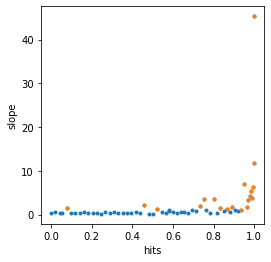

(48000265, 'e-')


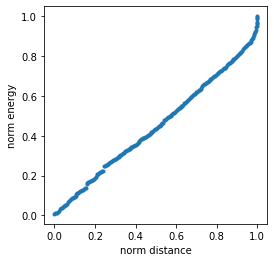

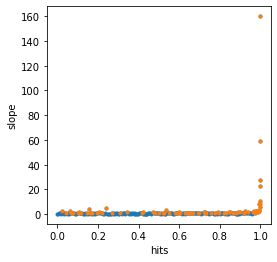

(48000266, 'e-')


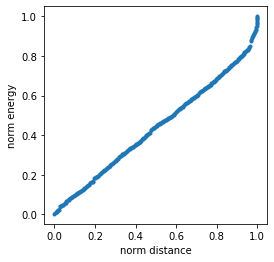

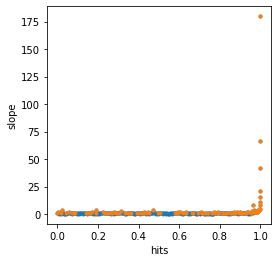

(48000267, 'e+')


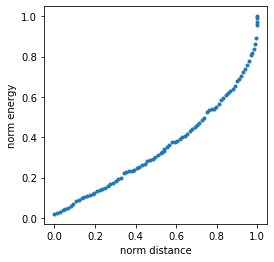

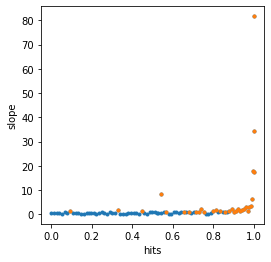

(48000267, 'e-')


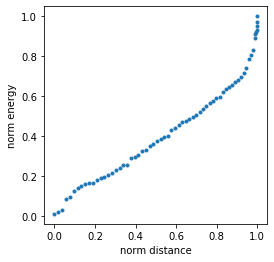

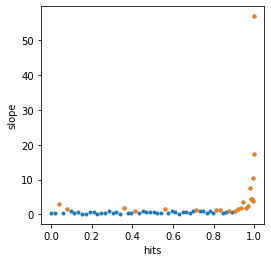

(48000268, 'e-')


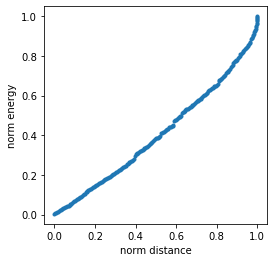

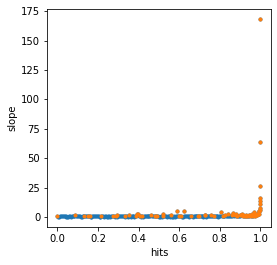

(48000269, 'e-')


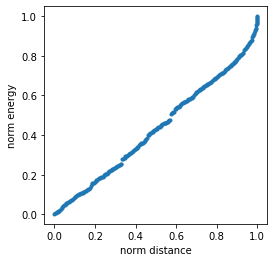

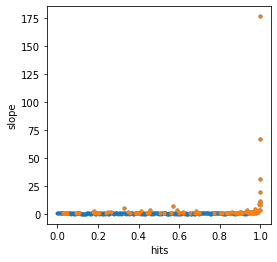

(48000270, 'e+')


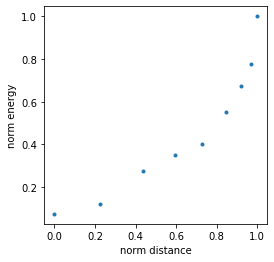

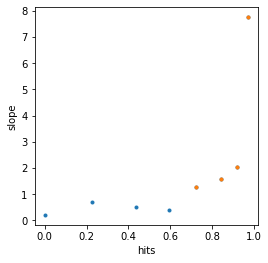

(48000270, 'e-')


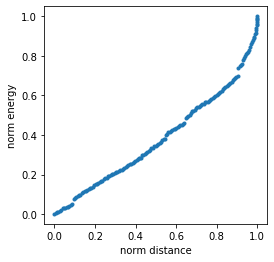

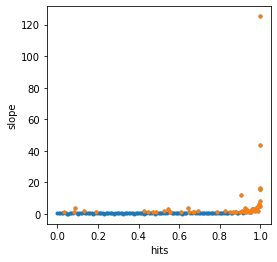

(48000271, 'e-')


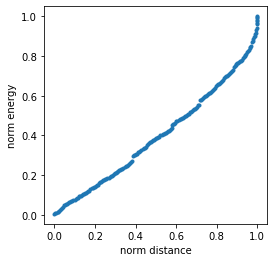

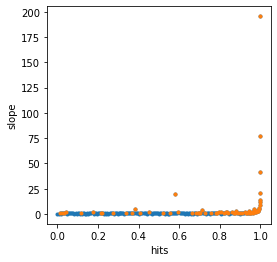

(48000272, 'e+')


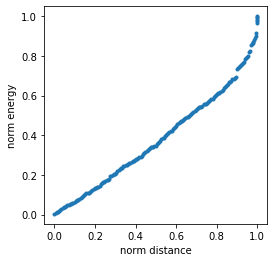

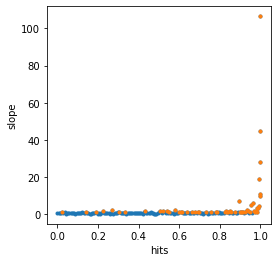

(48000272, 'e-')


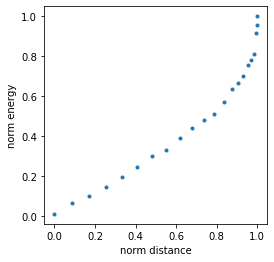

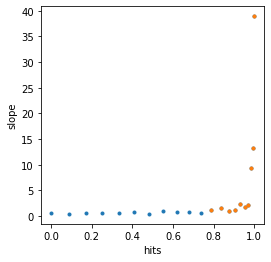

(48000273, 'e-')


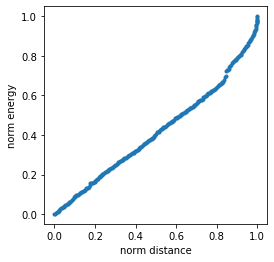

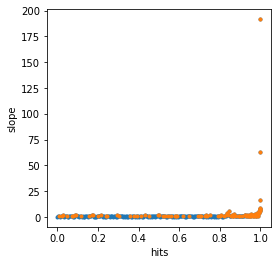

(48000274, 'e-')


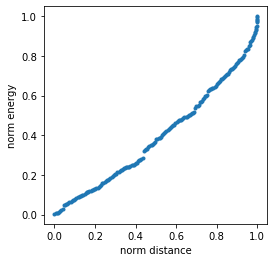

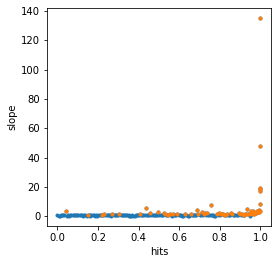

(48000275, 'e+')


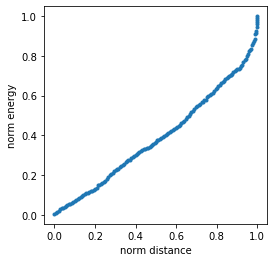

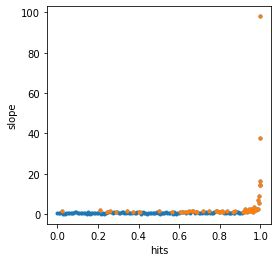

(48000275, 'e-')


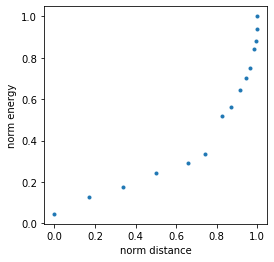

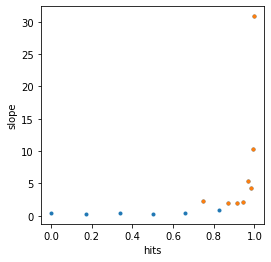

(48000276, 'e-')


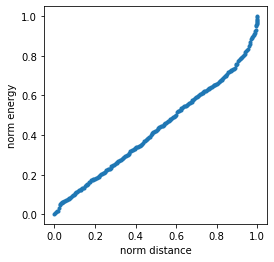

(48000277, 'e-')


(48000278, 'e-')


(48000279, 'e+')


(48000279, 'e-')


(48000280, 'e-')


(48000281, 'e-')


(48000282, 'e-')


(48000283, 'e-')


(48000285, 'e-')


(48000286, 'e-')


(48000287, 'e-')


(48000288, 'e-')


(48000289, 'e+')


(48000289, 'e-')


(48000290, 'e-')


(48000291, 'e-')


(48000292, 'e-')


(48000293, 'e-')


(48000294, 'e+')


(48000294, 'e-')


(48000295, 'e-')


(48000296, 'e-')


(48000297, 'e+')


(48000297, 'e-')


(48000298, 'e-')


(48000299, 'e-')


(48000300, 'e+')


(48000300, 'e-')


(48000301, 'e-')


(48000302, 'e-')


(48000303, 'e-')


(48000304, 'e+')


(48000304, 'e-')


(48000305, 'e-')


(48000306, 'e-')


(48000307, 'e-')


(48000308, 'e-')


(48000309, 'e-')


(48000310, 'e-')


(48000311, 'e+')


(48000311, 'e-')


(48000312, 'e-')


(48000313, 'e-')


(48000314, 'e-')


(48000315, 'e-')


(48000316, 'e-')


(48000317, 'e-')


(48000318, 'e+')


(48000318, 'e-')


(48000319, 'e-')


(48000320, 'e-')


(48000321, 'e-')


(48000322, 'e+')


(48000322, 'e-')


(48000323, 'e-')


(48000324, 'e-')


(48000325, 'e+')


(48000325, 'e-')


(48000326, 'e-')


(48000327, 'e-')


(48000328, 'e-')


(48000329, 'e+')


(48000329, 'e-')


(48000331, 'e+')


(48000331, 'e-')


(48000332, 'e-')


(48000333, 'e-')


(48000334, 'e-')


(48000335, 'e-')


(48000336, 'e-')


(48000337, 'e-')


(48000338, 'e-')


(48000339, 'e-')


(48000340, 'e-')


(48000341, 'e+')


(48000341, 'e-')


(48000342, 'e-')


(48000343, 'e-')


(48000344, 'e+')


(48000344, 'e-')


(48000345, 'e-')


(48000347, 'e-')


(48000348, 'e-')


(48000349, 'e-')


(48000350, 'e-')


(48000351, 'e+')


(48000351, 'e-')


(48000352, 'e-')


(48000353, 'e-')


(48000354, 'e-')


(48000355, 'e-')


(48000356, 'e-')


(48000357, 'e+')


(48000357, 'e-')


(48000358, 'e-')


(48000359, 'e-')


(48000360, 'e+')


(48000360, 'e-')


(48000361, 'e-')


(48000362, 'e-')


(48000363, 'e+')


(48000363, 'e-')


(48000364, 'e-')


(48000365, 'e-')


(48000366, 'e-')


(48000367, 'e-')


(48000368, 'e-')


(48000369, 'e-')


(48000370, 'e+')


(48000370, 'e-')


(48000371, 'e+')


(48000371, 'e-')


(48000372, 'e-')


(48000373, 'e-')


(48000374, 'e-')


(48000375, 'e+')


(48000375, 'e-')


(48000376, 'e+')


(48000376, 'e-')


(48000377, 'e-')


(48000378, 'e-')


(48000379, 'e+')


(48000379, 'e-')


(48000381, 'e-')


(48000382, 'e-')


(48000383, 'e-')


(48000384, 'e-')


(48000385, 'e-')


(48000386, 'e-')


(48000387, 'e-')


(48000388, 'e+')


(48000388, 'e-')


(48000389, 'e-')


(48000390, 'e-')


(48000391, 'e-')


(48000392, 'e+')


(48000392, 'e-')


(48000393, 'e-')


(48000394, 'e-')


(48000395, 'e-')


(48000396, 'e+')


(48000396, 'e-')


(48000397, 'e+')


(48000397, 'e-')


(48000398, 'e-')


(48000399, 'e-')


(48000400, 'e-')


(48000401, 'e+')


(48000401, 'e-')


(48000402, 'e-')


(48000403, 'e+')


(48000403, 'e-')


(48000404, 'e+')


(48000404, 'e-')


(48000405, 'e+')


(48000405, 'e-')


(48000406, 'e+')


(48000406, 'e-')


(48000407, 'e-')


(48000408, 'e-')


(48000409, 'e+')


(48000409, 'e-')


(48000410, 'e-')


(48000411, 'e-')


(48000412, 'e-')


(48000413, 'e-')


(48000414, 'e-')


(48000415, 'e-')


(48000416, 'e+')


(48000416, 'e-')


(48000417, 'e-')


(48000418, 'e-')


(48000419, 'e-')


(48000420, 'e-')


(48000421, 'e-')


(48000422, 'e-')


(48000423, 'e-')


(48000424, 'e-')


(48000425, 'e-')


(48000426, 'e+')


(48000426, 'e-')


(48000427, 'e-')


(48000428, 'e-')


(48000429, 'e-')


(48000430, 'e-')


(48000431, 'e-')


(48000432, 'e-')


(48000433, 'e+')


(48000433, 'e-')


(48000434, 'e-')


(48000435, 'e-')


(48000436, 'e-')


(48000437, 'e-')


(48000439, 'e-')


(48000440, 'e-')


(48000441, 'e-')


(48000442, 'e-')


(48000443, 'e+')


(48000443, 'e-')


(48000444, 'e+')


(48000444, 'e-')


(48000445, 'e-')


(48000446, 'e-')


(48000447, 'e-')


(48000448, 'e-')


(48000449, 'e-')


(48000450, 'e+')


(48000450, 'e-')


(48000451, 'e+')


(48000451, 'e-')


(48000452, 'e-')


(48000453, 'e+')


(48000453, 'e-')


(48000454, 'e+')


(48000454, 'e-')


(48000455, 'e+')


(48000455, 'e-')


(48000457, 'e-')


(48000458, 'e-')


(48000459, 'e-')


(48000460, 'e+')


(48000460, 'e-')


(48000461, 'e-')


(48000462, 'e+')


(48000462, 'e-')


(48000464, 'e+')


(48000464, 'e-')


(48000465, 'e-')


(48000466, 'e-')


(48000467, 'e-')


(48000468, 'e-')


(48000469, 'e+')


(48000469, 'e-')


(48000470, 'e+')


(48000470, 'e-')


(48000471, 'e+')


(48000471, 'e-')


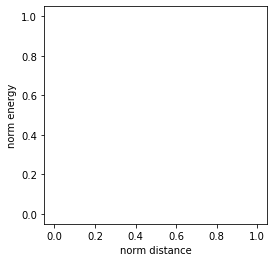

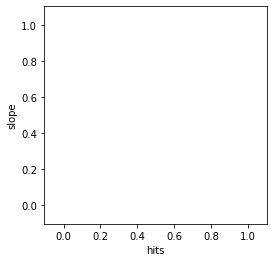

(48000472, 'e+')


(48000472, 'e-')


(48000473, 'e-')


(48000474, 'e+')


(48000474, 'e-')


(48000475, 'e-')


(48000476, 'e-')


(48000477, 'e+')


(48000477, 'e-')


(48000478, 'e-')


(48000479, 'e-')


(48000480, 'e-')


(48000481, 'e-')


(48000482, 'e+')


(48000482, 'e-')


(48000483, 'e+')


(48000483, 'e-')


(48000484, 'e-')


(48000485, 'e-')


(48000486, 'e-')


(48000487, 'e-')


(48000488, 'e-')


(48000489, 'e+')


(48000489, 'e-')


(48000490, 'e-')


(48000491, 'e-')


(48000492, 'e-')


(48000493, 'e-')


(48000494, 'e+')


(48000494, 'e-')


(48000495, 'e-')


(48000496, 'e-')


(48000497, 'e-')


(48000498, 'e-')


(48000499, 'e-')


(48000500, 'e-')


(48000501, 'e+')


(48000501, 'e-')


(48000502, 'e-')


(48000503, 'e-')


(48000504, 'e-')


(48000505, 'e-')


(48000506, 'e-')


(48000507, 'e-')


(48000508, 'e+')


(48000508, 'e-')


(48000509, 'e+')


(48000509, 'e-')


(48000510, 'e+')


(48000510, 'e-')


(48000511, 'e-')


(48000512, 'e-')


(48000513, 'e-')


(48000514, 'e-')


(48000515, 'e-')


(48000516, 'e-')


(48000517, 'e-')


(48000518, 'e-')


(48000519, 'e-')


(48000520, 'e-')


(48000521, 'e-')


(48000522, 'e-')


(48000523, 'e-')


(48000524, 'e+')


(48000524, 'e-')


(48000525, 'e+')


(48000525, 'e-')


(48000526, 'e+')


(48000526, 'e-')


/Users/mperez/Software/miniconda3/envs/IC-3.7-2020-06-16/lib/python3.7/site-packages/scipy/optimize/minpack.py:808: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


(48000527, 'e-')


(48000528, 'e+')


(48000528, 'e-')


(48000529, 'e-')


(48000530, 'e-')


(48000531, 'e-')


(48000532, 'e-')


(48000533, 'e-')


(48000535, 'e-')


(48000536, 'e-')


(48000537, 'e-')


(48000538, 'e+')


(48000538, 'e-')


(48000539, 'e-')


(48000540, 'e-')


(48000541, 'e-')


(48000542, 'e-')


(48000543, 'e-')


(48000544, 'e+')


(48000544, 'e-')


(48000545, 'e+')


(48000545, 'e-')


(48000546, 'e-')


(48000547, 'e-')


(48000548, 'e+')


(48000548, 'e-')


(48000549, 'e+')


(48000549, 'e-')


(48000550, 'e-')


(48000551, 'e+')


(48000551, 'e-')


(48000552, 'e+')


(48000552, 'e-')


(48000553, 'e+')


(48000553, 'e-')


(48000554, 'e-')


(48000555, 'e+')


(48000555, 'e-')


(48000556, 'e-')


(48000557, 'e-')


(48000558, 'e-')


(48000559, 'e+')


(48000559, 'e-')


(48000560, 'e-')


(48000561, 'e+')


(48000561, 'e-')


(48000562, 'e-')


(48000563, 'e+')


(48000563, 'e-')


(48000564, 'e+')


(48000564, 'e-')


(48000565, 'e-')


(48000566, 'e+')


(48000566, 'e-')


(48000568, 'e-')


(48000569, 'e-')


(48000570, 'e-')


(48000571, 'e-')


(48000572, 'e-')


(48000573, 'e+')


(48000573, 'e-')


(48000574, 'e+')


(48000574, 'e-')


(48000575, 'e-')


(48000576, 'e-')


(48000577, 'e-')


(48000578, 'e+')


(48000578, 'e-')


(48000579, 'e-')


(48000580, 'e-')


(48000581, 'e-')


(48000582, 'e-')


(48000583, 'e+')


(48000583, 'e-')


(48000584, 'e-')


(48000585, 'e-')


(48000586, 'e-')


(48000587, 'e+')


(48000587, 'e-')


(48000588, 'e-')


(48000590, 'e-')


(48000591, 'e-')


(48000592, 'e+')


(48000592, 'e-')


(48000593, 'e-')


(48000595, 'e+')


(48000595, 'e-')


(48000596, 'e-')


(48000597, 'e-')


In [121]:
slopes = np.array([])
dists  = np.array([])

for event_id, df in percent_track_hits.groupby(['event_id', 'particle_name']):
    print(event_id)
    plt.figure(figsize=(4, 4))
    plt.plot(df.dist_ratio, df.ener_ratio, '.')
    plt.xlabel('norm distance')
    plt.ylabel('norm energy')
        
    plt.figure(figsize = (4, 4))
    data_slope = np.diff(df.ener_ratio.values)/ np.diff(df.dist_ratio.values)
    
    big_slope = data_slope[data_slope > 1]
    big_slope_dist = df.dist_ratio.values[:-1][data_slope > 1]
    
    slopes, dists = np.append(slopes, big_slope), np.append(dists, big_slope_dist) #to do the density histogram
    
    plt.plot(df.dist_ratio.values[:-1], data_slope, '.')
    plt.plot(big_slope_dist, big_slope, '.')
    plt.xlabel('hits')
    plt.ylabel('slope')
    
    plt.show()
    

Vale, no solo podemos ver la elevación final que hay en el porcentaje de energía. Parece que es algo aproximadamente lineal, con una pendiente por debajo de 1, hasta que llega un punto que se eleva más fuertemente. 

Quizás podríamos buscar el punto en el que abandona esa linealidad para todos los hits, hacer algo de estadística y si coincide entre muchos hits pues establecer como ese porcentaje de energía o de distancia el punto blob!! 

Lo interesante respecto a lo que ya teníamos es que no buscaremos una deposición de energía fija para todos los hits, sino una deposición más personalizada teniendo en cuenta que parece que las energías de traza y sus distancias están estrechamente relacionadas, y por tanto también lo estará el punto donde aparece el blob.

Realmente esto es como "normalizar" cada traza a 1, teniendo en cuenta que nuestros datos tienen tamaños y energías distintos.

También tenemos algunas discontinuidades pero no sé muy bien como afrontarlas más que como que son pérdidas de energía repentinas y al mismo tiempo puntuales, porque la partícula se topó con un obstáculo mayor de lo esperado, pero no por el efecto del pico de bragg.

Lo que hice fue ver la pendiente de estas deposiciones de traza normalizadas, y escojo un límite de pendiente para decir que la pendiente es "grande" (por ahora simplemente fue 1 dicho limite). Ploteo esos puntos encima de todas las pendientes y veo que se congregan al final (aunque hay bastantes que se congregan por el medio, cosas que pasan... pero al final SIEMPRE hay).

La idea ahora es hacer estadística con esto, es decir, un histograma con todos los puntos considerados como que tienen ya una pendiente grande y ver dónde hay la mayor parte de densidad de los mismos: esto será el blob

Lo que no se es si hacer una densidad weighted o simplemente la densidad... quizas weighted da los ultimos bines demasiado tochos

# Busquemos formas de atopar esa subida que se aleja de la linealidad

Quizás lo que hay que hacer para detectar los cambios de linealidad es coger los datos de una traza y agruparlos en pequeños grupitos seguidos de hits, hacer un pequeño ajuste y guardar la pendiente y el término indep... luego ver cómo cambiaron eses valores, ya que al final la pendiente cambiará abruptamente, y poner ahí el límite. No sé si quizás hay algo en python que te haga esto más o menos.... estoy buscando, o sino pregunto...

Voy a probar a hacer algo así con mis datos a ver que pasa...

In [37]:
data_slope = np.diff(df.ener_ratio.values)/ np.diff(df.dist_ratio.values)

In [38]:
plt.plot(data_slope, '.')

In [39]:
plt.plot(np.diff(data_slope), '.') #where the slope changes the most

Hmmm... vemos que es bastante recto, salvo en puntos clave (son los bumps que se ven en la propia data) PERO al final se vuelve más difuso, como a partir de los 200, antes de ya desbaratarse... podría usar algo eso quizás...

Si tomamos todos los datos y cogemos los puntos donde la pendiente es mayor que cierto valor (en nuestro caso tomamos 1 como valor aprox), y luego hacemos un histograma para ver cual es la densidad de esos puntos, hallamos lo siguiente:

In [15]:
slopes = np.array([])
dists  = np.array([])

for event_id, df in percent_track_hits.groupby(['dataset_id', 'particle_name']):
    data_slope = np.diff(df.ener_ratio.values)/ np.diff(df.dist_ratio.values)
    
    big_slope = data_slope[data_slope > 1]
    big_slope_dist = df.dist_ratio.values[:-1][data_slope > 1]
    
    slopes, dists = np.append(slopes, big_slope), np.append(dists, big_slope_dist) #to do the density histogram

/Users/mperez/Software/miniconda3/envs/IC-3.7-2020-06-16/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """
/Users/mperez/Software/miniconda3/envs/IC-3.7-2020-06-16/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in greater
  import sys
/Users/mperez/Software/miniconda3/envs/IC-3.7-2020-06-16/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in greater
  
/Users/mperez/Software/miniconda3/envs/IC-3.7-2020-06-16/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in true_divide
  """


In [16]:
plt.hist(dists, bins = 100)
plt.xlabel('track distance')
plt.ylabel('density of points with big slope')
plt.show()

In [27]:
#con weights no me da tanto xeito
#plt.hist(dists, bins = 100, weights = slopes)
#plt.show()

Hago como una sustracción al 'fondo' de densidad, por llamarlo de alguna forma. Y es que el criterio de puntos con pendiente grande obviamente se le cuelan cosas por todos lados, pero mientras el efecto de las deposiciones finales no tiene lugar, se compensa y aparece más bien como un fondo uniforme que podemos eliminar (aunque tampoco nos sirve de mucho).

In [17]:
values, bins = np.histogram(dists, bins = 100)

In [18]:
values = values - min(values)

In [19]:
plt.hist(bins[:-1], bins = 100, weights = values)
plt.show()

Podríamos decir que el corte está en aprox cuando se recorrió el 70-80% de la traza, y deberíamos hallar ahora a qué pérdida de energía se correspondería eso... o por el contrario, adaptar el código para que escoja la etiqueta de blob en base al porcentaje de distancia recorrida...

### OTRA FORMA MÁS DIRECTA

Otra forma más simple quizás es directamente hacer esto.... welllll q no se me ocurrió vamos, y pienso que se ve perfectamente lo que ilustré conlas pendientes

In [18]:
bkg_tracks = percent_track_hits[percent_track_hits.binclass == 0]
sig_tracks = percent_track_hits[percent_track_hits.binclass == 1]

In [19]:
sig_tracks[['dataset_id', 'particle_id']].drop_duplicates()

,dataset_id,particle_id
217,1,9
283,1,10
428,2,10
504,2,11
1097,6,9
...,...,...
6126157,28763,10
6126369,28764,9
6126419,28764,10
6126562,28765,9


In [50]:
bins = 100
names = ['e$^{-}$', 
         'e$^{-}$ e$^{+}$']

plt.figure(figsize = (7, 5))

for i in (0, 1):
    bin_tracks = percent_track_hits[percent_track_hits.binclass == i]
    
    info = '\nentries {:.0f}'.format(float(len(bin_tracks[['dataset_id', 'particle_id']].drop_duplicates())))
    plt.hist(bin_tracks.dist_ratio, bins = bins, weights = bin_tracks.energy, density = True,
             histtype = 'step', alpha = 0.5, fill = True, linewidth = 2, label = names[i] + info)
    
plt.xlabel('normalized track distance')
plt.ylabel('hits energy')
plt.xticks(np.arange(0, 1.1, 0.1))
plt.legend(loc = 'upper left')
plt.grid()
plt.show()

plt.figure(figsize = (7, 5))
info = '\nentries {:.0f}'.format(float(len(percent_track_hits[['dataset_id', 'particle_id']].drop_duplicates())))
val = plt.hist(percent_track_hits.dist_ratio, bins = bins, weights = percent_track_hits.energy, density = True,
               histtype = 'step', alpha = 0.5, fill = True, linewidth = 2, label = 'All tracks' + info)

plt.xlabel('normalized track distance')
plt.ylabel('hits energy')
plt.legend(loc = 'upper left')
plt.xticks(np.arange(0, 1.1, 0.1))
#plt.yticks(np.arange(0, 9, 1))
plt.grid()
plt.show()


In [40]:
#without the first and last bin (they are overcrowded)
plt.bar(val[1][2:-1], val[0][1:-1], width = 0.01)

<BarContainer object of 98 artists>

The first bin is slightly more populated because all the tracks have a point of the dist_ratio on 0; then the medium distances are equally distributed/populated because they are more or less uniform. The last bin is overpopulated not only because all hits have also a point 1 on the dist_ratio, but also because the last hit energies are also higher (entiendo que si esto segundo no pasara simplemente veríamos una elevación como la del 0, que no sería super destacable ni nada)

Contar los hits por track para ver si el efecto ese en el primer bin pq vamos a ver!!! tiene que ser o algo así o que al ppio de la traza depositan tb más energía (pero era curioso pq aumentando el binado seguía siendo mucho en el primer bin, entonces más que al ppio sería literalmente el primer hit el que hace ese efecto...idk)

In [41]:
nhits = percent_track_hits.groupby(['dataset_id', 'particle_id']).size().reset_index().rename(columns = {0:'ntrack_hits'})



In [42]:
percent_track_hits = percent_track_hits.merge(nhits, on = ['dataset_id', 'particle_id'])

In [45]:
few_hits_tracks = percent_track_hits[percent_track_hits.ntrack_hits == 4]

In [49]:
few_hits_tracks

,x,y,z,hit_id,particle_id,energy,segclass,binclass,dist_hits,cumdist,...,creator_proc,group_ener,small_b,dataset_id,totener,totdist,cumener,ener_ratio,dist_ratio,ntrack_hits
65509,-97.439880,94.872589,185.790161,0,10,0.005510,2.0,1,0.000000,0.000000,...,conv,0.036305,False,311,0.038403,0.136556,0.005510,0.143467,0.000000,4
65510,-97.509064,94.798424,185.814072,1,10,0.019102,2.0,1,0.104204,0.104204,...,conv,0.036305,False,311,0.038403,0.136556,0.024612,0.640892,0.763086,4
65511,-97.514580,94.825653,185.803040,2,10,0.011693,2.0,1,0.029893,0.134097,...,conv,0.036305,False,311,0.038403,0.136556,0.036305,0.945388,0.981989,4
65512,-97.512268,94.826004,185.803802,3,10,0.002097,3.0,1,0.002460,0.136556,...,conv,0.002097,True,311,0.038403,0.136556,0.038403,1.000000,1.000000,4
113784,-47.286442,27.876390,178.094299,0,9,0.005959,2.0,1,0.000000,0.000000,...,conv,0.023905,False,538,0.025193,0.053727,0.005959,0.236543,0.000000,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5485079,83.483818,111.821091,245.487656,3,12,0.005538,3.0,1,0.008464,0.162738,...,conv,0.005538,True,25737,0.048376,0.162738,0.048376,1.000000,1.000000,4
5790782,-47.421146,77.915421,296.462860,0,17,0.006284,3.0,1,0.000000,0.000000,...,conv,0.040720,True,27179,0.040720,0.133252,0.006284,0.154326,0.000000,4
5790783,-47.337578,77.910217,296.441956,1,17,0.016309,3.0,1,0.086301,0.086301,...,conv,0.040720,True,27179,0.040720,0.133252,0.022593,0.554829,0.647648,4
5790784,-47.364193,77.904419,296.426300,2,17,0.006621,3.0,1,0.031418,0.117718,...,conv,0.040720,True,27179,0.040720,0.133252,0.029214,0.717423,0.883426,4


In [48]:
val = plt.hist(few_hits_tracks.dist_ratio, bins = 20, weights = few_hits_tracks.energy)
plt.xlabel('norm dist')
plt.ylabel('hit energy')
plt.show()

A pesar de que empieza a subir a partir del 70%, el cambio más abrupto está en aprox el 90% asín que probaré con eso...

In [54]:
for track_ratio_cut in np.arange(0.8, 1, 0.02):
    
    track_hits_cut = percent_track_hits[percent_track_hits.dist_ratio > track_ratio_cut]

    min_ener_ratio_cut = track_hits_cut.groupby(['dataset_id', 'particle_id']).ener_ratio.min().reset_index()
    ener_ratio_cut, ener_ratio_err = np.mean(min_ener_ratio_cut.ener_ratio), np.std(min_ener_ratio_cut.ener_ratio)
    print(track_ratio_cut, ener_ratio_cut, ener_ratio_err)
    plt.errorbar(track_ratio_cut, ener_ratio_cut, yerr = ener_ratio_err, 
                 capsize = 5, fmt = '.b', markersize = 7)
    plt.xlabel('track length')
    plt.ylabel('deposited energy so far')

0.8 0.64632845 0.056183018
0.8200000000000001 0.6662279 0.05538739
0.8400000000000001 0.68683267 0.054142155
0.8600000000000001 0.70830363 0.052688994
0.8800000000000001 0.73093975 0.05103049
0.9000000000000001 0.755017 0.04879766
0.9200000000000002 0.7809133 0.04584946
0.9400000000000002 0.8097357 0.04187041
0.9600000000000002 0.8435949 0.03640001
0.9800000000000002 0.8879267 0.027810212


In [52]:
min_ener_ratio_cut

,dataset_id,particle_id,ener_ratio
0,0,18,0.909690
1,1,9,0.808523
2,1,10,0.893422
3,2,10,0.860126
4,2,11,0.871030
...,...,...,...
38160,28764,9,0.854610
38161,28764,10,0.911617
38162,28765,9,0.887011
38163,28765,10,0.814410


Pillo la primera ratio energy de cada traza luego de escoger solo los trozos de traza en el tramo mayor al 75% recorrido, para ver el % de energía depositada en ese punto y que me pueda servir como

# RESULTADO ESTIMADO DEL TH PARA EL PORCENTAJE FINAL DE ENERGÍA DE BLOB

In [41]:
print('En mi algoritmo tendré que usar', 1-np.mean(eners),'+-',np.std(eners), 'como threshold de energy loss')

En mi algoritmo tendré que usar 0.24361748532425587 +- 0.046710038233399406 como threshold de energy loss


In [42]:
plt.plot(eners, '.')

## Intro
- Decidí mejorar el threshold para la clase blob, ya que no me parecía del todo práctico escoger los blobs como aquellos hits que sumaran más de cierta energía fijada al final de la traza.
- Por lo que vi en los histogramas, parece que tiene mucho más sentido fijarse en el porcentaje de energía perdido por la partícula respecto a la energía total, es decir, normalizarla.
- Por tanto, adapté mi función de labelling a eso, introduciendo un parámetro que es el porcentaje de energía perdida al final de la traza como threshold.

## Procedimiento:

- Tomé las trazas de los eventos y vi que su espectro de deposición era similar si las histogramaba (es decir, si dividía la traza en el mismo número de pedazos)

- Por ello, decidí "normalizarlas", es decir, pasar distancia y energía depositada absolutas a su tanto% del total de cada traza.
- Al hacer esto se puede apreciar que la distancia recorrida vs la energía depositada en % es aprox lineal (salvo por pequeños saltos, que indican una pérdida de energía mayor pero eventual) hasta el final, donde este aumento se hace abrupto.

- Para cuantificar el punto en el que empezaba a ocurrir esto se me ocurrió calcular la pendiente. Una vez hecho esto, escojo las pendientes mayores a cierto valor (en principio mayores a 1, ya que por lo general veo que la tendencia es a tener una pendiente por debajo de 1).

- Sin embargo, debido a los saltos que hay y otras cosas, estos puntos de pendiente mayor a uno son también frecuentes a lo largo de la traza y no solo al final. Lo que se me ocurrió hacer es entonces coger todos estos valores de "pendiente grande" de todas las trazas e histogramar para ver la densidad de estos puntos.

- El resultado parece que fue bueno, porque a lo largo de toda la distancia de la traza, unos eventos compensan a otros con estos puntos destacados y se crea un background en esta densidad, y es a partir del 70-80% de la traza donde apreciamos una subida grande de la densidad de puntos con pendiente importante. Quizás un poco más adelante, porque sí es cierto que en 70% aprox empieza a subir pero la subida más abrupa es más bien a partir del 90%...
- Con esto conseguimos un corte en el que podamos decir: a partir de este recorrido, la traza es blob.
- Ahora se pueden hacer varias cosas, yo por ahora hice una:
<ul>
<li>Buscar qué % de energía depositada se corresponde con este corte en traza recorrida</li>
<li>Rehacer el análisis pero en vez de sobre la variable de distancia, invertir los ejes y hacerlo sobre la variable de energía depositada, teniendo en cuenta que de esta forma buscamos por el contrario pendientes pequeñas, y así obtener ya el corte en energía</li>
<li>Modificar la función de labelling para que me pueda escoger blob teniendo en cuenta el porcentaje de traza recorrido, es decir, hacer algo análogo a lo que tengo pero con esta variable</li>
</ul>
- Yo en principio hice la primera, simplemente cogí los hits de las trazas que ya habían recorrido el 75% del total y pillé el primer valor de energía depositada en porcentaje, hice la media y me dió que el ~60% +- 5% de energía se había perdido. Esto significa que en mi función de labelling de los hits tendría que poner ~40% de la energía, ya que cuenta desde el final.

Voy a probar a rehacer el analisis cambiando de ejes para ver que histograma me sale venga vamoalla

In [44]:
eners_slope_th = 0.8 #threshold for the energy slope to be considered as strong enough to be important

(48000025, 'e-')


(48000026, 'e-')


(48000027, 'e-')


(48000028, 'e-')


(48000030, 'e-')


(48000031, 'e-')


(48000032, 'e-')


(48000033, 'e-')


(48000034, 'e-')


(48000035, 'e-')


(48000036, 'e-')


(48000037, 'e-')


(48000038, 'e-')


(48000039, 'e-')


(48000040, 'e+')


(48000040, 'e-')


(48000041, 'e-')


(48000042, 'e-')


(48000043, 'e+')


(48000043, 'e-')


(48000044, 'e-')


(48000045, 'e-')


(48000046, 'e-')


(48000047, 'e-')


(48000048, 'e-')


(48000049, 'e-')


(48000050, 'e-')


(48000051, 'e-')


(48000052, 'e-')


(48000053, 'e+')


(48000053, 'e-')


(48000054, 'e-')


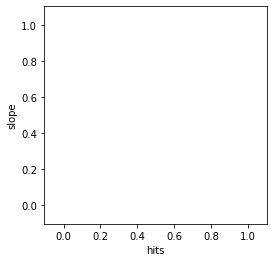

(48000055, 'e-')


(48000056, 'e-')


(48000057, 'e-')


(48000058, 'e+')


(48000058, 'e-')


(48000059, 'e-')


(48000060, 'e+')


(48000060, 'e-')


(48000061, 'e-')


(48000062, 'e-')


(48000063, 'e-')


(48000064, 'e+')


(48000064, 'e-')


(48000066, 'e+')


(48000066, 'e-')


(48000067, 'e-')


(48000068, 'e+')


(48000068, 'e-')


(48000069, 'e+')


(48000069, 'e-')


(48000070, 'e+')


(48000070, 'e-')


(48000071, 'e+')


(48000071, 'e-')


(48000073, 'e-')


(48000074, 'e-')


(48000075, 'e-')


(48000076, 'e+')


(48000076, 'e-')


(48000077, 'e-')


(48000078, 'e-')


(48000079, 'e+')


(48000079, 'e-')


(48000080, 'e-')


(48000081, 'e+')


(48000081, 'e-')


(48000082, 'e-')


(48000083, 'e+')


(48000083, 'e-')


(48000084, 'e-')


(48000085, 'e-')


(48000086, 'e-')


(48000087, 'e+')


(48000087, 'e-')


(48000088, 'e-')


(48000089, 'e-')


(48000090, 'e-')


(48000091, 'e-')


(48000092, 'e-')


(48000093, 'e+')


(48000093, 'e-')


(48000094, 'e-')


(48000096, 'e+')


(48000096, 'e-')


(48000097, 'e-')


(48000098, 'e+')


(48000098, 'e-')


(48000099, 'e-')


(48000101, 'e-')


(48000102, 'e+')


(48000102, 'e-')


(48000103, 'e-')


(48000104, 'e-')


(48000106, 'e-')


(48000107, 'e-')


(48000108, 'e-')


(48000109, 'e-')


(48000110, 'e-')


(48000111, 'e-')


(48000112, 'e+')


(48000112, 'e-')


(48000113, 'e-')


(48000114, 'e-')


(48000115, 'e-')


(48000116, 'e-')


(48000117, 'e-')


(48000118, 'e-')


(48000119, 'e-')


(48000120, 'e+')


(48000120, 'e-')


(48000121, 'e-')


(48000122, 'e+')


(48000122, 'e-')


(48000123, 'e-')


(48000124, 'e+')


(48000124, 'e-')


(48000125, 'e-')


(48000126, 'e-')


(48000127, 'e-')


(48000128, 'e-')


(48000129, 'e+')


(48000129, 'e-')


(48000130, 'e-')


(48000131, 'e+')


(48000131, 'e-')


(48000132, 'e-')


(48000133, 'e-')


(48000134, 'e-')


(48000135, 'e-')


(48000136, 'e-')


(48000137, 'e-')


(48000138, 'e-')


(48000139, 'e-')


(48000140, 'e-')


(48000141, 'e-')


(48000142, 'e-')


(48000143, 'e-')


(48000144, 'e+')


(48000144, 'e-')


(48000145, 'e+')


(48000145, 'e-')


(48000146, 'e-')


/Users/mperez/Software/miniconda3/envs/IC-3.7-2020-06-16/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in true_divide
  if sys.path[0] == '':


(48000147, 'e-')


(48000148, 'e-')


(48000149, 'e-')


(48000150, 'e-')


(48000151, 'e+')


(48000151, 'e-')


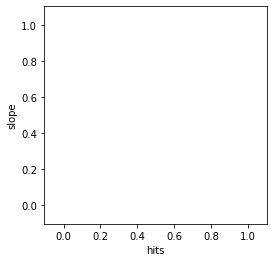

(48000152, 'e+')


(48000152, 'e-')


(48000153, 'e+')


(48000153, 'e-')


(48000154, 'e+')


(48000154, 'e-')


(48000155, 'e-')


(48000156, 'e-')


(48000157, 'e-')


(48000158, 'e+')


(48000158, 'e-')


(48000159, 'e-')


(48000160, 'e-')


(48000161, 'e-')


(48000162, 'e-')


(48000163, 'e+')


(48000163, 'e-')


(48000164, 'e-')


(48000165, 'e-')


(48000166, 'e-')


(48000167, 'e-')


(48000168, 'e+')


(48000168, 'e-')


(48000169, 'e+')


(48000169, 'e-')


(48000170, 'e+')


(48000170, 'e-')


(48000171, 'e+')


(48000171, 'e-')


(48000172, 'e-')


(48000173, 'e-')


(48000174, 'e+')


(48000174, 'e-')


(48000175, 'e-')


(48000176, 'e-')


(48000177, 'e-')


(48000178, 'e+')


(48000178, 'e-')


(48000179, 'e-')


(48000180, 'e-')


(48000181, 'e+')


(48000181, 'e-')


(48000182, 'e-')


(48000183, 'e-')


(48000184, 'e+')


(48000184, 'e-')


(48000185, 'e+')


(48000185, 'e-')


(48000186, 'e-')


(48000187, 'e+')


(48000187, 'e-')


(48000188, 'e+')


(48000188, 'e-')


(48000189, 'e-')


(48000190, 'e-')


(48000191, 'e+')


(48000191, 'e-')


(48000192, 'e+')


(48000192, 'e-')


(48000193, 'e-')


(48000194, 'e-')


(48000195, 'e-')


(48000196, 'e-')


(48000197, 'e-')


(48000198, 'e-')


(48000199, 'e-')


(48000200, 'e-')


(48000202, 'e-')


(48000203, 'e-')


(48000204, 'e-')


(48000205, 'e-')


(48000206, 'e-')


(48000207, 'e-')


(48000208, 'e-')


(48000209, 'e-')


(48000210, 'e-')


(48000211, 'e-')


(48000212, 'e-')


(48000213, 'e-')


(48000214, 'e-')


(48000215, 'e-')


(48000216, 'e-')


(48000217, 'e+')


(48000217, 'e-')


(48000218, 'e-')


(48000219, 'e-')


(48000220, 'e-')


(48000221, 'e+')


(48000221, 'e-')


(48000222, 'e+')


(48000222, 'e-')


(48000223, 'e-')


(48000224, 'e-')


(48000225, 'e+')


(48000225, 'e-')


(48000226, 'e-')


(48000228, 'e-')


(48000229, 'e-')


(48000230, 'e-')


(48000231, 'e-')


(48000232, 'e-')


(48000233, 'e-')


(48000234, 'e-')


(48000235, 'e+')


(48000235, 'e-')


(48000236, 'e+')


(48000236, 'e-')


(48000237, 'e-')


(48000238, 'e-')


(48000239, 'e-')


(48000240, 'e-')


(48000241, 'e-')


(48000242, 'e-')


(48000243, 'e+')


(48000243, 'e-')


(48000244, 'e-')


(48000245, 'e-')


(48000246, 'e-')


(48000247, 'e-')


(48000248, 'e-')


(48000249, 'e-')


(48000250, 'e-')


(48000251, 'e-')


(48000252, 'e+')


(48000252, 'e-')


(48000253, 'e-')


(48000254, 'e-')


(48000255, 'e-')


(48000256, 'e-')


(48000257, 'e-')


(48000258, 'e-')


(48000259, 'e-')


(48000260, 'e-')


(48000261, 'e-')


(48000262, 'e-')


(48000263, 'e-')


(48000264, 'e-')


(48000265, 'e-')


(48000266, 'e-')


(48000267, 'e+')


(48000267, 'e-')


(48000268, 'e-')


(48000269, 'e-')


(48000270, 'e+')


(48000270, 'e-')


(48000271, 'e-')


(48000272, 'e+')


(48000272, 'e-')


(48000273, 'e-')


(48000274, 'e-')


(48000275, 'e+')


(48000275, 'e-')


(48000276, 'e-')


(48000277, 'e-')


(48000278, 'e-')


(48000279, 'e+')


(48000279, 'e-')


(48000280, 'e-')


(48000281, 'e-')


(48000282, 'e-')


(48000283, 'e-')


(48000285, 'e-')


(48000286, 'e-')


(48000287, 'e-')


(48000288, 'e-')


(48000289, 'e+')


(48000289, 'e-')


(48000290, 'e-')


(48000291, 'e-')


(48000292, 'e-')


(48000293, 'e-')


(48000294, 'e+')


(48000294, 'e-')


(48000295, 'e-')


(48000296, 'e-')


(48000297, 'e+')


(48000297, 'e-')


(48000298, 'e-')


(48000299, 'e-')


(48000300, 'e+')


(48000300, 'e-')


(48000301, 'e-')


(48000302, 'e-')


(48000303, 'e-')


(48000304, 'e+')


(48000304, 'e-')


(48000305, 'e-')


(48000306, 'e-')


(48000307, 'e-')


(48000308, 'e-')


(48000309, 'e-')


(48000310, 'e-')


(48000311, 'e+')


(48000311, 'e-')


(48000312, 'e-')


(48000313, 'e-')


(48000314, 'e-')


(48000315, 'e-')


(48000316, 'e-')


(48000317, 'e-')


(48000318, 'e+')


(48000318, 'e-')


(48000319, 'e-')


(48000320, 'e-')


(48000321, 'e-')


(48000322, 'e+')


(48000322, 'e-')


(48000323, 'e-')


(48000324, 'e-')


(48000325, 'e+')


(48000325, 'e-')


(48000326, 'e-')


(48000327, 'e-')


(48000328, 'e-')


(48000329, 'e+')


(48000329, 'e-')


(48000331, 'e+')


(48000331, 'e-')


(48000332, 'e-')


(48000333, 'e-')


(48000334, 'e-')


(48000335, 'e-')


(48000336, 'e-')


(48000337, 'e-')


(48000338, 'e-')


(48000339, 'e-')


(48000340, 'e-')


(48000341, 'e+')


(48000341, 'e-')


(48000342, 'e-')


(48000343, 'e-')


(48000344, 'e+')


(48000344, 'e-')


(48000345, 'e-')


(48000347, 'e-')


(48000348, 'e-')


(48000349, 'e-')


(48000350, 'e-')


(48000351, 'e+')


(48000351, 'e-')


(48000352, 'e-')


(48000353, 'e-')


(48000354, 'e-')


(48000355, 'e-')


(48000356, 'e-')


(48000357, 'e+')


(48000357, 'e-')


(48000358, 'e-')


(48000359, 'e-')


(48000360, 'e+')


(48000360, 'e-')


(48000361, 'e-')


(48000362, 'e-')


(48000363, 'e+')


(48000363, 'e-')


(48000364, 'e-')


(48000365, 'e-')


(48000366, 'e-')


(48000367, 'e-')


(48000368, 'e-')


(48000369, 'e-')


(48000370, 'e+')


(48000370, 'e-')


(48000371, 'e+')


(48000371, 'e-')


(48000372, 'e-')


(48000373, 'e-')


(48000374, 'e-')


(48000375, 'e+')


(48000375, 'e-')


(48000376, 'e+')


(48000376, 'e-')


(48000377, 'e-')


(48000378, 'e-')


(48000379, 'e+')


(48000379, 'e-')


(48000381, 'e-')


(48000382, 'e-')


(48000383, 'e-')


(48000384, 'e-')


(48000385, 'e-')


(48000386, 'e-')


(48000387, 'e-')


(48000388, 'e+')


(48000388, 'e-')


(48000389, 'e-')


(48000390, 'e-')


(48000391, 'e-')


(48000392, 'e+')


(48000392, 'e-')


(48000393, 'e-')


(48000394, 'e-')


(48000395, 'e-')


(48000396, 'e+')


(48000396, 'e-')


(48000397, 'e+')


(48000397, 'e-')


(48000398, 'e-')


(48000399, 'e-')


(48000400, 'e-')


(48000401, 'e+')


(48000401, 'e-')


(48000402, 'e-')


(48000403, 'e+')


(48000403, 'e-')


(48000404, 'e+')


(48000404, 'e-')


(48000405, 'e+')


(48000405, 'e-')


(48000406, 'e+')


(48000406, 'e-')


(48000407, 'e-')


(48000408, 'e-')


(48000409, 'e+')


(48000409, 'e-')


(48000410, 'e-')


(48000411, 'e-')


(48000412, 'e-')


(48000413, 'e-')


(48000414, 'e-')


(48000415, 'e-')


(48000416, 'e+')


(48000416, 'e-')


(48000417, 'e-')


(48000418, 'e-')


(48000419, 'e-')


(48000420, 'e-')


(48000421, 'e-')


(48000422, 'e-')


(48000423, 'e-')


(48000424, 'e-')


(48000425, 'e-')


(48000426, 'e+')


(48000426, 'e-')


(48000427, 'e-')


(48000428, 'e-')


(48000429, 'e-')


(48000430, 'e-')


(48000431, 'e-')


(48000432, 'e-')


(48000433, 'e+')


(48000433, 'e-')


(48000434, 'e-')


(48000435, 'e-')


(48000436, 'e-')


(48000437, 'e-')


(48000439, 'e-')


(48000440, 'e-')


(48000441, 'e-')


(48000442, 'e-')


(48000443, 'e+')


(48000443, 'e-')


(48000444, 'e+')


(48000444, 'e-')


(48000445, 'e-')


(48000446, 'e-')


(48000447, 'e-')


(48000448, 'e-')


(48000449, 'e-')


(48000450, 'e+')


(48000450, 'e-')


(48000451, 'e+')


(48000451, 'e-')


(48000452, 'e-')


(48000453, 'e+')


(48000453, 'e-')


(48000454, 'e+')


(48000454, 'e-')


(48000455, 'e+')


(48000455, 'e-')


(48000457, 'e-')


(48000458, 'e-')


(48000459, 'e-')


(48000460, 'e+')


(48000460, 'e-')


(48000461, 'e-')


(48000462, 'e+')


(48000462, 'e-')


(48000464, 'e+')


(48000464, 'e-')


(48000465, 'e-')


(48000466, 'e-')


(48000467, 'e-')


(48000468, 'e-')


(48000469, 'e+')


(48000469, 'e-')


(48000470, 'e+')


(48000470, 'e-')


(48000471, 'e+')


(48000471, 'e-')


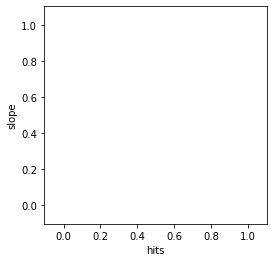

(48000472, 'e+')


(48000472, 'e-')


(48000473, 'e-')


(48000474, 'e+')


(48000474, 'e-')


(48000475, 'e-')


(48000476, 'e-')


(48000477, 'e+')


(48000477, 'e-')


(48000478, 'e-')


(48000479, 'e-')


(48000480, 'e-')


(48000481, 'e-')


(48000482, 'e+')


(48000482, 'e-')


(48000483, 'e+')


(48000483, 'e-')


(48000484, 'e-')


(48000485, 'e-')


(48000486, 'e-')


(48000487, 'e-')


(48000488, 'e-')


(48000489, 'e+')


(48000489, 'e-')


(48000490, 'e-')


(48000491, 'e-')


(48000492, 'e-')


(48000493, 'e-')


(48000494, 'e+')


(48000494, 'e-')


(48000495, 'e-')


(48000496, 'e-')


(48000497, 'e-')


(48000498, 'e-')


(48000499, 'e-')


(48000500, 'e-')


(48000501, 'e+')


(48000501, 'e-')


(48000502, 'e-')


(48000503, 'e-')


(48000504, 'e-')


(48000505, 'e-')


(48000506, 'e-')


(48000507, 'e-')


(48000508, 'e+')


(48000508, 'e-')


(48000509, 'e+')


(48000509, 'e-')


(48000510, 'e+')


(48000510, 'e-')


(48000511, 'e-')


(48000512, 'e-')


(48000513, 'e-')


(48000514, 'e-')


(48000515, 'e-')


(48000516, 'e-')


(48000517, 'e-')


(48000518, 'e-')


(48000519, 'e-')


(48000520, 'e-')


(48000521, 'e-')


(48000522, 'e-')


(48000523, 'e-')


(48000524, 'e+')


(48000524, 'e-')


(48000525, 'e+')


(48000525, 'e-')


(48000526, 'e+')


(48000526, 'e-')


(48000527, 'e-')


(48000528, 'e+')


(48000528, 'e-')


(48000529, 'e-')


(48000530, 'e-')


(48000531, 'e-')


(48000532, 'e-')


(48000533, 'e-')


(48000535, 'e-')


(48000536, 'e-')


(48000537, 'e-')


(48000538, 'e+')


(48000538, 'e-')


(48000539, 'e-')


(48000540, 'e-')


(48000541, 'e-')


(48000542, 'e-')


(48000543, 'e-')


(48000544, 'e+')


(48000544, 'e-')


(48000545, 'e+')


(48000545, 'e-')


(48000546, 'e-')


(48000547, 'e-')


(48000548, 'e+')


(48000548, 'e-')


(48000549, 'e+')


(48000549, 'e-')


(48000550, 'e-')


(48000551, 'e+')


(48000551, 'e-')


(48000552, 'e+')


(48000552, 'e-')


(48000553, 'e+')


(48000553, 'e-')


(48000554, 'e-')


(48000555, 'e+')


(48000555, 'e-')


(48000556, 'e-')


(48000557, 'e-')


(48000558, 'e-')


(48000559, 'e+')


(48000559, 'e-')


(48000560, 'e-')


(48000561, 'e+')


(48000561, 'e-')


(48000562, 'e-')


(48000563, 'e+')


(48000563, 'e-')


(48000564, 'e+')


(48000564, 'e-')


(48000565, 'e-')


(48000566, 'e+')


(48000566, 'e-')


(48000568, 'e-')


(48000569, 'e-')


(48000570, 'e-')


(48000571, 'e-')


(48000572, 'e-')


(48000573, 'e+')


(48000573, 'e-')


(48000574, 'e+')


(48000574, 'e-')


(48000575, 'e-')


(48000576, 'e-')


(48000577, 'e-')


(48000578, 'e+')


(48000578, 'e-')


(48000579, 'e-')


(48000580, 'e-')


(48000581, 'e-')


(48000582, 'e-')


(48000583, 'e+')


(48000583, 'e-')


(48000584, 'e-')


(48000585, 'e-')


(48000586, 'e-')


(48000587, 'e+')


(48000587, 'e-')


(48000588, 'e-')


(48000590, 'e-')


(48000591, 'e-')


(48000592, 'e+')


(48000592, 'e-')


(48000593, 'e-')


(48000595, 'e+')


(48000595, 'e-')


(48000596, 'e-')


(48000597, 'e-')


In [114]:
slopes_invert = np.array([])
eners_invert  = np.array([])

for event_id, df in percent_track_hits.groupby(['event_id', 'particle_name']):
    print(event_id)
    plt.figure(figsize=(4, 4))
    plt.plot(df.ener_ratio, df.dist_ratio, '.')
    plt.ylabel('norm distance')
    plt.xlabel('norm energy')
        
    plt.figure(figsize = (4, 4))
    data_slope = np.diff(df.dist_ratio.values) / np.diff(df.ener_ratio.values)
    
    small_slope       = data_slope[data_slope < eners_slope_th]
    small_slope_eners = df.ener_ratio.values[:-1][data_slope < eners_slope_th]
    
    slopes_invert, eners_invert = np.append(slopes_invert, small_slope), np.append(eners_invert, small_slope_eners) #to do the density histogram
    
    plt.plot(df.ener_ratio.values[:-1], data_slope, '.')
    plt.plot(small_slope_eners, small_slope, '.')
    plt.xlabel('hits')
    plt.ylabel('slope')
    
    plt.show()

In [45]:
slopes_invert = np.array([])
eners_invert  = np.array([])

for event_id, df in percent_track_hits.groupby(['event_id', 'particle_name']):
    data_slope = np.diff(df.dist_ratio.values) / np.diff(df.ener_ratio.values)
    
    small_slope       = data_slope[data_slope < eners_slope_th]
    small_slope_eners = df.ener_ratio.values[:-1][data_slope < eners_slope_th]
    
    slopes_invert, eners_invert = np.append(slopes_invert, small_slope), np.append(eners_invert, small_slope_eners) #to do the density histogram

/Users/mperez/Software/miniconda3/envs/IC-3.7-2020-06-16/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in true_divide
  """


In [46]:
plt.hist(eners_invert, bins = 100)
plt.xlabel('deposited energy')
plt.ylabel('density of points with big slope')
plt.show()

Podemos decir q está en buen agreement... Más o menos el rising empieza en 0.6... pero el cambio mas abrupto será sobre 0.7 (en el caso de 0.9 de track, me daba 0.75 +- 0.04 así que aceptamos barco no?)

Veo q hay un pico más pronunciado cara el final, y uno menos algo antes pero boeno... supongo que habrá algún tipo de distinción rollo que las trazas cortas pierden la energía justísimo al final, pero las más largas tienen más el pico de bragg definido algo antes... quizás puedo comprobar esto haciendo algún tipo de separación (quitar las largas o las cortas...) y ver este histograma que sale (no sé si será necesario hacerlo en verdad pero bueno, queda aquí como posible cosa)

# Probando labelling final

## Incluso esto último no se si es indiferente para la red neuronal porque yo lo que le meto básicamente son coordenadas, entonces quizás le es mejor tener como tenía marija, es decir, los voxeles de 1 en 1... o también mejor para hacer como todo el tema de grafos (contaje de blob) y tal...hmmm

# Creo que llegué a la conclusión de que sí será mejor convertir los voxeles a 'puntos' de 1 en 1. Rollo el labelling de MC a la salida tenerlo así. Luego en la parte de clouds, lo suyo sería voxelizar el espacio igualmente de 5mm (digo 5mm pero luego se verá que tamaño...) y antes de ponernos a etiquetar, haríamos la conversión una vez más. Ahí haríamos la correspondencia con los voxeles de MC ya etiquetados y finalmente haríamos lo de mirar vecinos etc... 

## Aunque bueno, mirar vecinos tb se puede hacer con los voxeles normales y adaptando... o quizás no cunde mucho porque eso está guay si los voxeles son cuadrados, pero si no ya es más cuadro, y poniéndolos de 1 en 1 no habría ese problema pienso

Probamos a ver que tal va la función de labelling final con el nuevo threshold (aunque el valor por ahora fue mirado a ojo)

In [55]:
labelled_voxels = labelling_MC(directory, total_size, voxel_size, start_bin, blob_ener_loss_th = 0.25)

In [56]:
labelled_voxels

,event_id,x,y,z,ener,ratio,segclass,binclass
0,48000024,-1,33,57,0.029452,1.0,1,0
1,48000024,3,32,55,0.004629,1.0,1,0
2,48000024,3,32,56,0.022082,1.0,1,0
3,48000024,3,33,56,0.015947,1.0,1,0
4,48000024,3,33,57,0.026925,1.0,1,0
...,...,...,...,...,...,...,...,...
57,48000597,8,-6,60,0.004106,1.0,2,0
58,48000597,8,-5,60,0.028640,1.0,2,0
59,48000597,8,-4,59,0.011978,1.0,2,0
60,48000597,8,-4,60,0.008966,1.0,2,0


También miramos la comparación con el labelling que usaba antes, el de la energía del final...

In [59]:
labelled_voxels_ener = labelling_MC(directory, total_size, voxel_size, start_bin, blob_ener_th = 0.4)

In [60]:
labelled_voxels_ener

,event_id,x,y,z,ener,ratio,segclass,binclass
0,48000024,-1,33,57,0.029452,1.0,1,0
1,48000024,3,32,55,0.004629,1.0,1,0
2,48000024,3,32,56,0.022082,1.0,1,0
3,48000024,3,33,56,0.015947,1.0,1,0
4,48000024,3,33,57,0.026925,1.0,1,0
...,...,...,...,...,...,...,...,...
57,48000597,8,-6,60,0.004106,1.0,2,0
58,48000597,8,-5,60,0.028640,1.0,2,0
59,48000597,8,-4,59,0.011978,1.0,2,0
60,48000597,8,-4,60,0.008966,1.0,2,0


Me estoy dando cuenta de que quizás el frame reductor lo podía hacer más sencillo?? Puede q no porque en la funcion de plot se hace la reducción una vez tienes los voxeles, y yo lo estaba haciendo en mi fram reductor luego de tener los voxeles... entonces quizás no tenía ni que hacerlo antes de los voxeles, podía hacerlo después de hacer el primer histograma y sacar las coordenadas de los voxeles... nonsei

In [57]:
for i, voxel in labelled_voxels.groupby('event_id'):
    pass

In [58]:
plot_3d_vox(voxel, value = 'segclass')

In [61]:
for i, voxel in labelled_voxels_ener.groupby('event_id'):
    pass

In [62]:
plot_3d_vox(voxel, value = 'segclass')

Parece que con el nuevo threshold hacemos unos blobs un poco más acotados non?

Al contrario, parece q se hacen más brutos...nonsei